# Coursework: Age regression from brain MRI

Predicting the age of patient from a brain MRI scan can have diagnostic value for a number of diseases that may cause structural changes and potential damage to the brain. A discrepancy between the predicted age and the real, chronological age of a patient might indicate the presence of disease. This requires an accurate predictor of brain age which may be learned from a set of healthy reference subjects, given their brain MRI data and their actual age.

The objective for the coursework is to implement different supervised learning approaches for age regression from brain MRI. We provided data from a total of 652 healthy subjects, that is split into different development sets and a held-out test set on which you will evaluate your final prediction accuracy.

Each approach will require a processing pipeline with different components that you will need to implement using methods that were discussed in the lectures and tutorials. There are three dedicated parts in the Jupyter notebook for each approach which contain some detailed instructions and some helper code.

You may find some useful ideas and implementations in the tutorial notebooks. Once you have implemented all approaches and obtained results from your experiments, we ask you to write a short summary report. The reports should contain a short introduction, description of each of your methods and the individual processing steps, your results with a brief discussion. The report should also include some figures and plots to support your findings.

#### Read the text descriptions and the provided code cells carefully and look out for the cells marked with 'TASK' and 'ADD YOUR CODE HERE'.

### Getting started and familiarise ourselves with the data

The following cells provide some helper functions to load the data, and provide some overview and visualisation of the statistics over the total population of 652 subjects. The data will be split into different subsets to be used for different parts of the coursework. There is a set of 52 subjects to be used in part A to develop an image segmentation method (47 for training, 5 for validation). We then use 500 subjects for training and cross-validation of age regression approaches in part A, B and C. A remaining set of 100 subjects is used to test the final age prediction accuracy and will be made available towards the end of the coursework.

### Running on Colab or Azure

In [1]:
# ! pip install SimpleITK==1.2.2 
# ! wget https://www.doc.ic.ac.uk/~bglocker/teaching/notebooks/brainage-data.zip
# ! unzip brainage-data.zip
# ! pip install scikit-learn

# data directory
data_dir = 'data/brain_age/'

### Running on DoC lab machines

In [ ]:
# data directory
data_dir = '/vol/lab/course/416/data/brain_age/'

Let's start by loading the meta data of the entire population, that is the data containing information about the subject IDs, their age, and gender.

In [2]:
# Read the meta data using pandas
import pandas as pd

meta_data_all = pd.read_csv(data_dir + 'meta/meta_data_all.csv')
meta_data_all.head() # show the first five data entries

,subject_id,age,gender_code,gender_text
0,CC110033,24,1,MALE
1,CC110037,18,1,MALE
2,CC110045,24,2,FEMALE
3,CC110056,22,2,FEMALE
4,CC110062,20,1,MALE


Let's have a look at some population statistics.

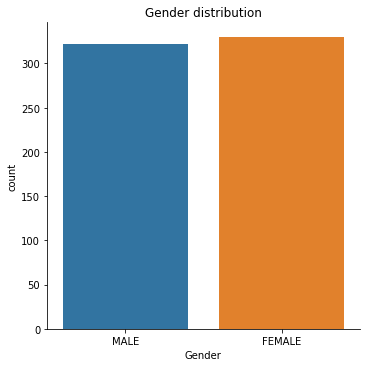

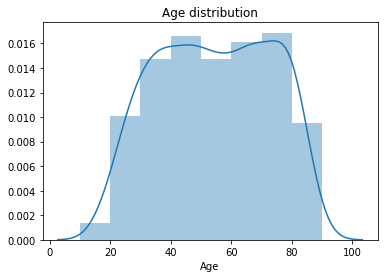

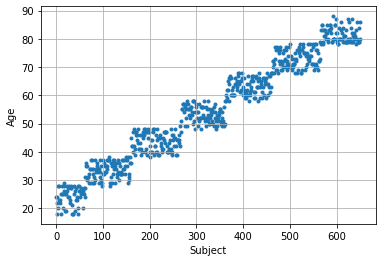

In [3]:
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn as sns

meta_data = meta_data_all

sns.catplot(x="gender_text", data=meta_data, kind="count")
plt.title('Gender distribution')
plt.xlabel('Gender')
plt.show()

sns.distplot(meta_data['age'], bins=[10,20,30,40,50,60,70,80,90])
plt.title('Age distribution')
plt.xlabel('Age')
plt.show()

plt.scatter(range(len(meta_data['age'])),meta_data['age'], marker='.')
plt.grid()
plt.xlabel('Subject')
plt.ylabel('Age')
plt.show()

### Set up a simple medical image viewer and import SimpleITK

In [4]:
import numpy as np
import SimpleITK as sitk
import matplotlib.pyplot as plt

from ipywidgets import interact, fixed
from IPython.display import display

# Calculate parameters low and high from window and level
def wl_to_lh(window, level):
    low = level - window/2
    high = level + window/2
    return low,high

def display_image(img, x=None, y=None, z=None, window=None, level=None, colormap='gray', crosshair=False):
    # Convert SimpleITK image to NumPy array
    img_array = sitk.GetArrayFromImage(img)
    
    # Get image dimensions in millimetres
    size = img.GetSize()
    spacing = img.GetSpacing()
    width  = size[0] * spacing[0]
    height = size[1] * spacing[1]
    depth  = size[2] * spacing[2]
    
    if x is None:
        x = np.floor(size[0]/2).astype(int)
    if y is None:
        y = np.floor(size[1]/2).astype(int)
    if z is None:
        z = np.floor(size[2]/2).astype(int)
    
    if window is None:
        window = np.max(img_array) - np.min(img_array)
    
    if level is None:
        level = window / 2 + np.min(img_array)
    
    low,high = wl_to_lh(window,level)

    # Display the orthogonal slices
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 4))

    ax1.imshow(img_array[z,:,:], cmap=colormap, clim=(low, high), extent=(0, width, height, 0))
    ax2.imshow(img_array[:,y,:], origin='lower', cmap=colormap, clim=(low, high), extent=(0, width,  0, depth))
    ax3.imshow(img_array[:,:,x], origin='lower', cmap=colormap, clim=(low, high), extent=(0, height, 0, depth))

    # Additionally display crosshairs
    if crosshair:
        ax1.axhline(y * spacing[1], lw=1)
        ax1.axvline(x * spacing[0], lw=1)
        ax2.axhline(z * spacing[2], lw=1)
        ax2.axvline(x * spacing[0], lw=1)
        ax3.axhline(z * spacing[2], lw=1)
        ax3.axvline(y * spacing[1], lw=1)

    plt.show()
    
def interactive_view(img):
    size = img.GetSize() 
    img_array = sitk.GetArrayFromImage(img)
    interact(display_image,img=fixed(img),
             x=(0, size[0] - 1),
             y=(0, size[1] - 1),
             z=(0, size[2] - 1),
             window=(0,np.max(img_array) - np.min(img_array)),
             level=(np.min(img_array),np.max(img_array)));

### Imaging data

Let's check out the imaging data that is available for each subject. This cell also shows how to retrieve data given a particular subject ID from the meta data.

Imaging data of subject CC110033 with age 24

MR Image (used in part A)


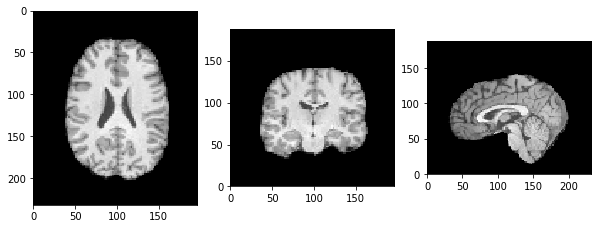

Brain mask (used in part A)


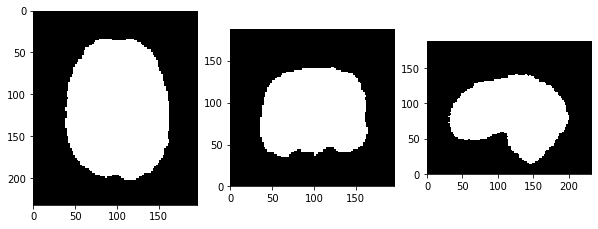

Spatially normalised grey matter maps (used in part B and C)


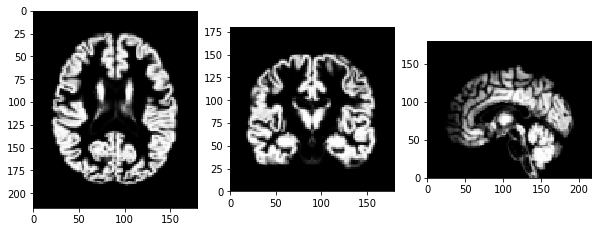

In [5]:
# Subject with index 0
def print_with_ID(id):
  ID = meta_data['subject_id'][id]
  age = meta_data['age'][id]

  # Image
  image_filename = data_dir + 'images/sub-' + ID + '_T1w_unbiased.nii.gz'
  img = sitk.ReadImage(image_filename)

  # Mask
  mask_filename = data_dir + 'masks/sub-' + ID + '_T1w_brain_mask.nii.gz'
  msk = sitk.ReadImage(mask_filename)

  # Grey matter map
  gm_filename = data_dir + 'greymatter/wc1sub-' + ID + '_T1w.nii.gz'
  gm = sitk.ReadImage(gm_filename)

  print('Imaging data of subject ' + ID + ' with age ' + str(age))

  print('\nMR Image (used in part A)')
  display_image(img, window=400, level=200)

  print('Brain mask (used in part A)')
  display_image(msk)

  print('Spatially normalised grey matter maps (used in part B and C)')
  display_image(gm)

print_with_ID(0)

## Part A: Volume-based regression using brain structure segmentation

The first approach aims to regress the age of a subject using the volumes of brain tissues as features. The brain structures include grey matter (GM), white matter (WM), and cerebrospinal fluid (CSF). It is known that with increasing age the ventricles enlarge (filled with CSF), while it is assumed that grey and white matter volume may decrease over time. However, as overall brain volume varies across individuals, taking the absolute volumes of tissues might not be predictive. Instead, relative volumes need to be computed as the ratios between each tissue volume and overall brain volume. To this end, a four-class (GM, WM, CSF, and background) brain segmentation needs to be implemented which will be trained using a total of 52 subjects (47 for training, 5 for validation). The segmentation method is then applied to the remaining 600 brain scans which will be used to train and test the age regression. Brain masks are provided which have been generated with a state-of-the-art neuroimaging brain extraction tool.

Different regression techniques should be explored, and it might be beneficial to investigate what the best set of features is for this task. Are all volume features equally useful, or is it even better to combine some of them and create new features. How does a simple linear regression perform compared to a model with higher order polynomials? Do you need regularisation? How about other regression methods such as regression trees, SVMs or neural networks? The accuracy of different methods should be evaluated using two-fold cross-validation on the set of 500 subjects, and average age prediction accuracy should be compared and reported appropriately. The final prediction accuracy will be evaluated on a hold-out set of 100 subjects.

*Note:* For part A, only the MR images and the brain masks should be used from the imaging data. The spatially normalised grey matter maps are used in part B and C only. If you struggle with task A-1, you can continue with A-2 using the provided reference segmentations in subfolder `segs_refs`.

### TASK A-1: Brain tissue segmentation

Implement a CNN model for brain tissue segmentation which can provide segmentations of GM, WM, and CSF. For this task (and only for this task), we provide a subset of 52 subjects which are split into 47 images for training and 5 for validation. The template code below has the data handling and main training routines already implemented, so you can focus on implementing a suitable CNN model. A simple model is provided, but this won't perform very well.

Once your model is trained and you are happy with the results on the validation data you should apply it to the 500 subjects later used for training the age regressor. We provide reference segmentations in a subfolder `segs_refs` for all subjects. Calculate Dice similarity coefficients per tissue when comparing your predicted segmentations to the reference segmentations. Summarise the statistics of the 500 Dice scores for each tissue class in [box-and-whisker-plots](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.boxplot.html).

*Note:* Implementing a full-fledged machine learning pipeline with training and testing procedures in Jupyter notebooks is a bit cumbersome and a pain to debug. Also, running bigger training tasks can be unstable. The code below should work as is on your VM. However, if you want to get a bit more serious about implementing an advanced CNN approach for image segmentation, you may want to move code into separate Python scripts and run these from the terminal.

#### Imports

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
from sklearn import metrics

#### Data Helpers

In [9]:
def zero_mean_unit_var(image, mask):
    """Normalizes an image to zero mean and unit variance."""

    img_array = sitk.GetArrayFromImage(image)
    img_array = img_array.astype(np.float32)

    msk_array = sitk.GetArrayFromImage(mask)

    mean = np.mean(img_array[msk_array>0])
    std = np.std(img_array[msk_array>0])

    if std > 0:
        img_array = (img_array - mean) / std
        img_array[msk_array==0] = 0

    image_normalised = sitk.GetImageFromArray(img_array)
    image_normalised.CopyInformation(image)

    return image_normalised


def resample_image(image, out_spacing=(1.0, 1.0, 1.0), out_size=None, is_label=False, pad_value=0):
    """Resamples an image to given element spacing and output size."""

    original_spacing = np.array(image.GetSpacing())
    original_size = np.array(image.GetSize())

    if out_size is None:
        out_size = np.round(np.array(original_size * original_spacing / np.array(out_spacing))).astype(int)
    else:
        out_size = np.array(out_size)

    original_direction = np.array(image.GetDirection()).reshape(len(original_spacing),-1)
    original_center = (np.array(original_size, dtype=float) - 1.0) / 2.0 * original_spacing
    out_center = (np.array(out_size, dtype=float) - 1.0) / 2.0 * np.array(out_spacing)

    original_center = np.matmul(original_direction, original_center)
    out_center = np.matmul(original_direction, out_center)
    out_origin = np.array(image.GetOrigin()) + (original_center - out_center)

    resample = sitk.ResampleImageFilter()
    resample.SetOutputSpacing(out_spacing)
    resample.SetSize(out_size.tolist())
    resample.SetOutputDirection(image.GetDirection())
    resample.SetOutputOrigin(out_origin.tolist())
    resample.SetTransform(sitk.Transform())
    resample.SetDefaultPixelValue(pad_value)

    if is_label:
        resample.SetInterpolator(sitk.sitkNearestNeighbor)
    else:
        resample.SetInterpolator(sitk.sitkBSpline)

    return resample.Execute(image)


class ImageSegmentationDataset(Dataset):
    """Dataset for image segmentation."""

    def __init__(self, file_list_img, file_list_seg, file_list_msk, img_spacing, img_size):
        self.samples = []
        self.img_names = []
        self.seg_names = []
        for idx, _ in enumerate(tqdm(range(len(file_list_img)), desc='Loading Data')):
            img_path = file_list_img[idx]
            seg_path = file_list_seg[idx]
            msk_path = file_list_msk[idx]

            img = sitk.ReadImage(img_path, sitk.sitkFloat32)

            seg = sitk.ReadImage(seg_path, sitk.sitkInt64)

            msk = sitk.ReadImage(msk_path, sitk.sitkUInt8)

            #pre=processing
            img = zero_mean_unit_var(img, msk)
            img = resample_image(img, img_spacing, img_size, is_label=False)
            seg = resample_image(seg, img_spacing, img_size, is_label=True)
            msk = resample_image(msk, img_spacing, img_size, is_label=True)

            sample = {'img': img, 'seg': seg, 'msk': msk}

            self.samples.append(sample)
            self.img_names.append(os.path.basename(img_path))
            self.seg_names.append(os.path.basename(seg_path))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, item):
        sample = self.samples[item]

        image = torch.from_numpy(sitk.GetArrayFromImage(sample['img'])).unsqueeze(0)
        seg = torch.from_numpy(sitk.GetArrayFromImage(sample['seg'])).unsqueeze(0)
        msk = torch.from_numpy(sitk.GetArrayFromImage(sample['msk'])).unsqueeze(0)

        return {'img': image, 'seg': seg, 'msk': msk}

    def get_sample(self, item):
        return self.samples[item]

    def get_img_name(self, item):
        return self.img_names[item]

    def get_seg_name(self, item):
        return self.seg_names[item]


#### Check that the GPU is up and running

In [10]:
cuda_dev = '0' #GPU device 0 (can be changed if multiple GPUs are available)

use_cuda = torch.cuda.is_available()
device = torch.device("cuda:" + cuda_dev if use_cuda else "cpu")

print('Device: ' + str(device))
if use_cuda:
    print('GPU: ' + str(torch.cuda.get_device_name(int(cuda_dev))))        

Device: cuda:0
GPU: Vega 10 XT [Radeon RX Vega 64]


#### Config and hyper-parameters

Here we set some default hyper-parameters and a starting configuration for the image resolution and others.

**TASK: This needs to be revisited to optimise these values. In particular, you may want to run your final model on higher resolution images.**

In [11]:
rnd_seed = 42 #fixed random seed

img_size = [64, 64, 64]
img_spacing = [3, 3, 3]

num_epochs = 100
learning_rate = 0.001
batch_size = 2
val_interval = 10

num_classes = 4

out_dir = './output'

# Create output directory
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

#### Loading and pre-processing of training and validation data

In [12]:
meta_data_seg_train = pd.read_csv(data_dir + 'meta/meta_data_seg_train.csv')
ids_seg_train = list(meta_data_seg_train['subject_id'])
files_seg_img_train = [data_dir + 'images/sub-' + f + '_T1w_unbiased.nii.gz' for f in ids_seg_train]
files_seg_seg_train = [data_dir + 'segs_refs/sub-' + f + '_T1w_seg.nii.gz' for f in ids_seg_train]
files_seg_msk_train = [data_dir + 'masks/sub-' + f + '_T1w_brain_mask.nii.gz' for f in ids_seg_train]

meta_data_seg_val = pd.read_csv(data_dir + 'meta/meta_data_seg_val.csv')
ids_seg_val = list(meta_data_seg_val['subject_id'])
files_seg_img_val = [data_dir + 'images/sub-' + f + '_T1w_unbiased.nii.gz' for f in ids_seg_val]
files_seg_seg_val = [data_dir + 'segs_refs/sub-' + f + '_T1w_seg.nii.gz' for f in ids_seg_val]
files_seg_msk_val = [data_dir + 'masks/sub-' + f + '_T1w_brain_mask.nii.gz' for f in ids_seg_val]

We apply some standard pre-processing on the data such as intensity normalization (zero mean unit variance) and downsampling according to the configuration above.

**You may want to use initially the validation data with 5 subjects for training which is more efficient when debugging your training routine and model implementation. Make sure to later train your final model on the actual training data.**

In [13]:
# LOAD ACTUAL TRAINING DATA
dataset_train = ImageSegmentationDataset(files_seg_img_train, files_seg_seg_train, files_seg_msk_train, img_spacing, img_size)
# LOAD VALIDATION DATA AS TRAINING FOR QUICK DEBUGGING
#dataset_train = ImageSegmentationDataset(files_seg_img_val, files_seg_seg_val, files_seg_msk_val, img_spacing, img_size)
dataloader_train = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, shuffle=True)

dataset_val = ImageSegmentationDataset(files_seg_img_val, files_seg_seg_val, files_seg_msk_val, img_spacing, img_size)
dataloader_val = torch.utils.data.DataLoader(dataset_val, batch_size=1, shuffle=False)

Loading Data: 100%|██████████| 5/5 [00:00<00:00,  7.22it/s]


#### Visualise training example

Just to check how a training image looks like after pre-processing.

Image: sub-CC221040_T1w_unbiased.nii.gz


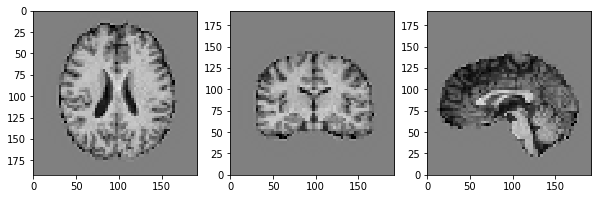

Segmentation


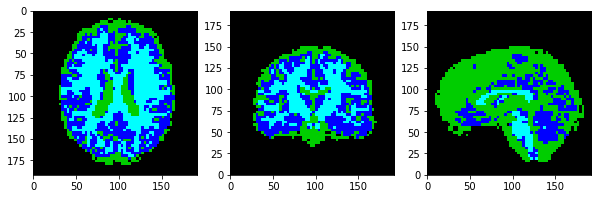

Mask


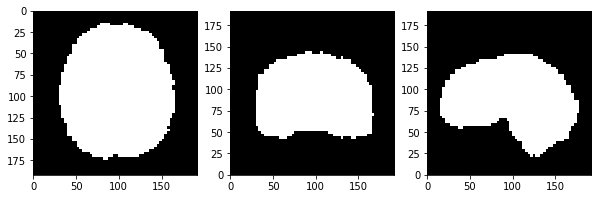

In [14]:
sample = dataset_train.get_sample(0)
img_name = dataset_train.get_img_name(0)
seg_name = dataset_train.get_seg_name(0)
print('Image: ' + img_name)
display_image(sample['img'], window=5, level=0)
print('Segmentation')
display_image(sitk.LabelToRGB(sample['seg']))
print('Mask')
display_image(sample['msk'])

#### The Model

**TASK:** This is the **key part of task A-1** where you have to design a suitable CNN model for brain segmentation. The simple model provided below works to some degree (it let's you run through the upcoming cells), but it will not perform very well. Use what you learned in the lectures to come up with a good architecture. Start with a simple, shallow model and only increase complexity (e.g., number of layers) if needed.

In [15]:
class SimpleNet3D(nn.Module):

    def __init__(self, num_classes):
        super(SimpleNet3D, self).__init__()
        self.conv1 = nn.Conv3d(1, 4, kernel_size=3, padding=1)
        self.conv2 = nn.Conv3d(4, 8, kernel_size=3, padding=1)
        self.conv3 = nn.Conv3d(8, 4, kernel_size=3, padding=1)
        self.conv4 = nn.Conv3d(4, num_classes, kernel_size=3, padding=1)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = self.conv4(x)
        print("x len is:" + str(x.shape))
        return F.softmax(x, dim=1)

In [17]:
def outputSize(in_size, kernel_size, stride, padding):
        output = int((in_size - kernel_size + 2*(padding)) / stride) + 1
        return(output)

In [18]:
########################################
# Better model:
# a) Use log_softmax instead of softmax
########################################

class ModSimpleNet3D(nn.Module):

    def __init__(self, num_classes):
        super(ModSimpleNet3D, self).__init__()
        self.conv1 = nn.Conv3d(1, 4, kernel_size=3, padding=1)
        self.conv2 = nn.Conv3d(4, 8, kernel_size=3, padding=1)
        self.conv3 = nn.Conv3d(8, 4, kernel_size=3, padding=1)
        self.conv4 = nn.Conv3d(4, num_classes, kernel_size=3, padding=1)

    def forward(self, x):
        # print("x intial shape is " + str(x.shape)) # 2, 1, 64, 64, 64        
        x = F.relu(self.conv1(x))
        # print("x after first is  " + str(x.shape)) # 2, 4, 64, 64, 64        
        x = F.relu(self.conv2(x))
        # print("x after second is " + str(x.shape)) # 2, 8, 64, 64, 64   
        x = F.relu(self.conv3(x))
        # print("x after third is " + str(x.shape)) # 2, 4, 64, 64, 64  
        x = self.conv4(x)
        # print("x after forth is " + str(x.shape)) # 2, 4, 64, 64, 64
        res =  F.log_softmax(x, dim=1)
        # print("x before ret is " + str(res.shape)) # 2, 4, 64, 64, 64
        return res

In [0]:
class InClassCNN(nn.Module):
    def __init__(self, num_classes):
        super(InClassCNN, self).__init__()
        self.conv1 = nn.Conv3d(1, 18, kernel_size=3, stride=1, padding=1)
        self.pool1 = nn.MaxPool3d(kernel_size=2, stride=1, padding=1)
        self.conv2 = nn.Conv3d(18, 36, kernel_size=3, stride=1, padding=1)
        self.pool2 = nn.MaxPool3d(kernel_size=2, stride=1, padding=0)
        self.conv3 = nn.Conv3d(36, 18, kernel_size=3, stride=1, padding=1)
        self.pool3 = nn.MaxPool3d(kernel_size=2, stride=1, padding=1)        
        self.conv4 = nn.Conv3d(18, num_classes, kernel_size=3, stride=1, padding=1)
        self.pool4 = nn.MaxPool3d(kernel_size=2, stride=1, padding=0)        

        #self.fc1 = nn.Linear(18 * 64 * 64 * 64, 32)
        #self.fc2 = nn.Linear(32, num_classes)

    def forward(self, x):
        #Computes the activation of the first convolution
        #print("x intial shape is " + str(x.shape)) # 2, 1, 64, 64, 64        
        x = F.relu(self.conv1(x))
        #print("x shape is " + str(x.shape)) # 2, 18, 64, 64, 64
        x = self.pool1(x)
        #print("x shape after pool is " + str(x.shape)) # 2, 18, 64, 64, 64
        x = F.relu(self.conv2(x))
        x = self.pool2(x)
        x = F.relu(self.conv3(x))
        x = self.pool3(x)
        x = F.relu(self.conv4(x))
        x = self.pool4(x)
        #Reshape data to input to the input layer of the neural net
        #Size changes from (18, 16, 16) to (1, 4608)
        #Recall that the -1 infers this dimension from the other given dimension
        #x = x.view(-1, 18 * 32 * 32 * 32)
        #print("x shape after view " + str(x.shape)) # 2, 589824
        #Computes the activation of the first fully connected layer
        #Size changes from (1, 4608) to (1, 64)
        #x = F.relu(self.fc1(x))
        #print("x shape after relu " + str(x.shape)) # 2, 32
        
        #Computes the second fully connected layer (activation applied later)
        #Size changes from (1, 64) to (1, 10)
        #x = self.fc2(x)
        #print("x shape after fc2 " + str(x.shape)) # 2, 4
        return F.log_softmax(x, dim=1)

#### TRAINING

Below is an implementation of a full training procedure including a loop for intermediate evaluation of the model on the validation data. Feel free to modify this procedure. For example, in addition to the loss you may want to monitor precision, recall and Dice scores (or others).

START TRAINING...
+ TRAINING 	Epoch: 1 	Loss: 0.832558 	f1: 0.3699080357617952
--------------------------------------------------
+ VALIDATE 	Epoch: 1 	Loss: 0.806343 	F1_score: 0.36354919518483464


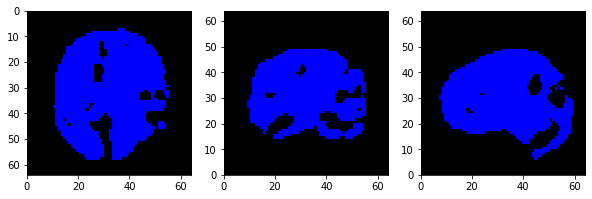

--------------------------------------------------
+ TRAINING 	Epoch: 2 	Loss: 0.311744 	f1: 0.47103690689761885
+ TRAINING 	Epoch: 3 	Loss: 0.238503 	f1: 0.7163895720966381
+ TRAINING 	Epoch: 4 	Loss: 0.219101 	f1: 0.7170863983356986
+ TRAINING 	Epoch: 5 	Loss: 0.202046 	f1: 0.7537215099968235
+ TRAINING 	Epoch: 6 	Loss: 0.191161 	f1: 0.7276241765462019
+ TRAINING 	Epoch: 7 	Loss: 0.189383 	f1: 0.7655180970022695
+ TRAINING 	Epoch: 8 	Loss: 0.208978 	f1: 0.7580725917739896
+ TRAINING 	Epoch: 9 	Loss: 0.181230 	f1: 0.7315447327205888
+ TRAINING 	Epoch: 10 	Loss: 0.169647 	f1: 0.7713021136655536
--------------------------------------------------
+ VALIDATE 	Epoch: 10 	Loss: 0.186907 	F1_score: 0.7710243989220281


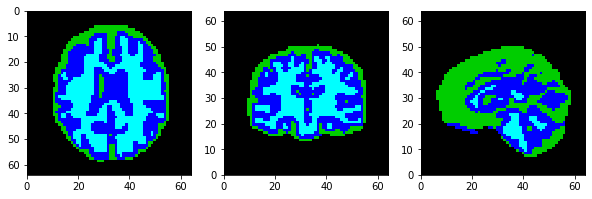

--------------------------------------------------
+ TRAINING 	Epoch: 11 	Loss: 0.170762 	f1: 0.77196584301162
+ TRAINING 	Epoch: 12 	Loss: 0.230101 	f1: 0.749109953726028
+ TRAINING 	Epoch: 13 	Loss: 0.195141 	f1: 0.7762170715964531
+ TRAINING 	Epoch: 14 	Loss: 0.193799 	f1: 0.7670290034351668
+ TRAINING 	Epoch: 15 	Loss: 0.189432 	f1: 0.7851925438155813
+ TRAINING 	Epoch: 16 	Loss: 0.186151 	f1: 0.7841378066439193
+ TRAINING 	Epoch: 17 	Loss: 0.196032 	f1: 0.7692163564482464
+ TRAINING 	Epoch: 18 	Loss: 0.156927 	f1: 0.7883399639186897
+ TRAINING 	Epoch: 19 	Loss: 0.175956 	f1: 0.8013294176198233
+ TRAINING 	Epoch: 20 	Loss: 0.181461 	f1: 0.7948747129687601
--------------------------------------------------
+ VALIDATE 	Epoch: 20 	Loss: 0.167380 	F1_score: 0.7905215091425568


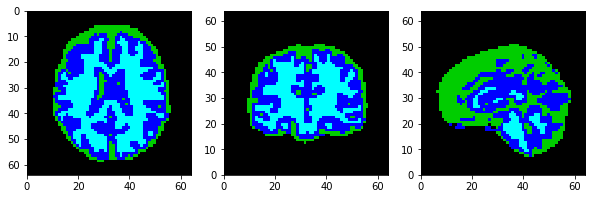

--------------------------------------------------
+ TRAINING 	Epoch: 21 	Loss: 0.157600 	f1: 0.7973883873794259
+ TRAINING 	Epoch: 22 	Loss: 0.190106 	f1: 0.7782713502193394
+ TRAINING 	Epoch: 23 	Loss: 0.170634 	f1: 0.7985333437565381
+ TRAINING 	Epoch: 24 	Loss: 0.146584 	f1: 0.7897673153453932
+ TRAINING 	Epoch: 25 	Loss: 0.149077 	f1: 0.792088107478042
+ TRAINING 	Epoch: 26 	Loss: 0.146687 	f1: 0.7994628164641842
+ TRAINING 	Epoch: 27 	Loss: 0.149667 	f1: 0.793518023497883
+ TRAINING 	Epoch: 28 	Loss: 0.150510 	f1: 0.8028931659630479
+ TRAINING 	Epoch: 29 	Loss: 0.185606 	f1: 0.7795502563880877
+ TRAINING 	Epoch: 30 	Loss: 0.158468 	f1: 0.812681984679835
--------------------------------------------------
+ VALIDATE 	Epoch: 30 	Loss: 0.155968 	F1_score: 0.8061785649568615


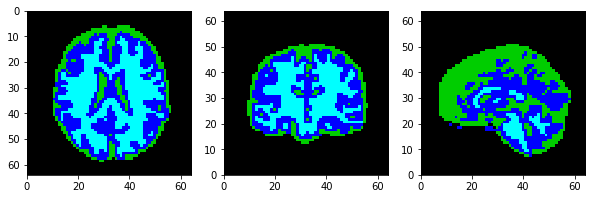

--------------------------------------------------
+ TRAINING 	Epoch: 31 	Loss: 0.161208 	f1: 0.8017384956580211
+ TRAINING 	Epoch: 32 	Loss: 0.138412 	f1: 0.8120407468704597
+ TRAINING 	Epoch: 33 	Loss: 0.168173 	f1: 0.8028044224155345
+ TRAINING 	Epoch: 34 	Loss: 0.168299 	f1: 0.8200383001449507
+ TRAINING 	Epoch: 35 	Loss: 0.172717 	f1: 0.8038151689036231
+ TRAINING 	Epoch: 36 	Loss: 0.143582 	f1: 0.7910412341107411
+ TRAINING 	Epoch: 37 	Loss: 0.145026 	f1: 0.8186905627669059
+ TRAINING 	Epoch: 38 	Loss: 0.179405 	f1: 0.8158309756684684
+ TRAINING 	Epoch: 39 	Loss: 0.169823 	f1: 0.8061396696823521
+ TRAINING 	Epoch: 40 	Loss: 0.132817 	f1: 0.8217479392587915
--------------------------------------------------
+ VALIDATE 	Epoch: 40 	Loss: 0.146375 	F1_score: 0.822182159642324


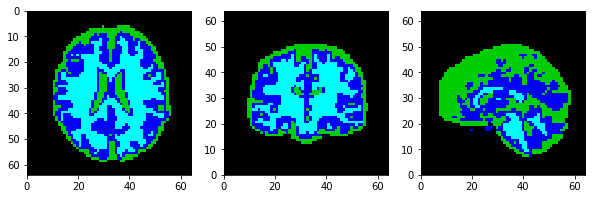

--------------------------------------------------
+ TRAINING 	Epoch: 41 	Loss: 0.158706 	f1: 0.8143447970773393
+ TRAINING 	Epoch: 42 	Loss: 0.186681 	f1: 0.8140791576544916
+ TRAINING 	Epoch: 43 	Loss: 0.131738 	f1: 0.8297920132600631
+ TRAINING 	Epoch: 44 	Loss: 0.156673 	f1: 0.823719142816971
+ TRAINING 	Epoch: 45 	Loss: 0.156544 	f1: 0.8160536581011545
+ TRAINING 	Epoch: 46 	Loss: 0.158604 	f1: 0.814882583651168
+ TRAINING 	Epoch: 47 	Loss: 0.127983 	f1: 0.8284534262905261
+ TRAINING 	Epoch: 48 	Loss: 0.127097 	f1: 0.8385639258611717
+ TRAINING 	Epoch: 49 	Loss: 0.147437 	f1: 0.8255846606432786
+ TRAINING 	Epoch: 50 	Loss: 0.147711 	f1: 0.8424827079645754
--------------------------------------------------
+ VALIDATE 	Epoch: 50 	Loss: 0.139592 	F1_score: 0.8311331923853906


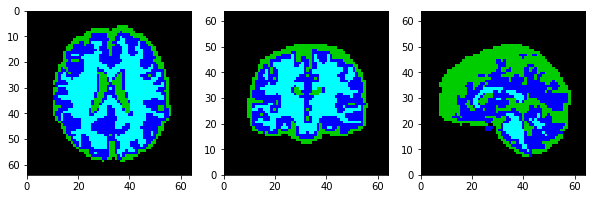

--------------------------------------------------

Finished TRAINING.


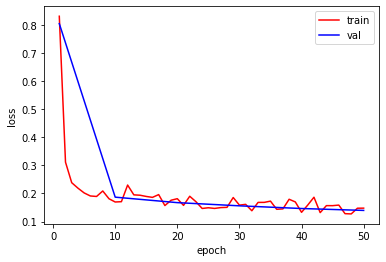

In [19]:
#img has size (2, 1, 64, 64, 64) = (B- batch size, N - number of channels, W, H, D)
model_dir = os.path.join(out_dir, 'model')
if not os.path.exists(model_dir):
    os.makedirs(model_dir)

torch.manual_seed(rnd_seed) #fix random seed

model = ModSimpleNet3D(num_classes=num_classes).to(device)
model.train()
    
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

loss_train_log = []
loss_val_log = []
epoch_val_log = []
num_epochs = 50
print('START TRAINING...')
for epoch in range(1, num_epochs + 1):

    # Training
    for batch_idx, batch_samples in enumerate(dataloader_train):
        img, seg = batch_samples['img'].to(device), batch_samples['seg'].to(device)
        optimizer.zero_grad()
        #print("img size is" + str(img.shape))
        prd = model(img)
        prd_flat = prd.view(prd.size(0), prd.size(1), -1) # (2, 4, 262144) - (N, C=no_classes, )
        seg_flat = seg.view(seg.size(0), seg.size(1), -1)
        #print("seg is" + str(seg_flat.squeeze(1).shape) + "prd is: " + str(prd_flat.shape))

        loss = F.cross_entropy(prd_flat, seg_flat.squeeze(1))  # seg_flat.squeeze(1) - (1, 262144)
        loss.backward()
        optimizer.step()

    loss_train_log.append(loss.item())
    
    prd = torch.argmax(prd, dim=1)
    f1_prd = prd.view(-1).detach().cpu().numpy()
    f1_seg = seg.view(-1).detach().cpu().numpy()
    f1_train = metrics.f1_score(f1_seg, f1_prd,  average='macro')
    print('+ TRAINING \tEpoch: {} \tLoss: {:.6f} \tf1: {}'.format(epoch, loss.item(), f1_train))

    #print("seg is" + str(seg_flat.squeeze(1).shape) + "prd is: " + str(prd_flat.shape))
    # print('+ TRAINING \tEpoch: {} \tLoss: {:.6f}'.format(epoch, loss.item()))
    
    # Validation
    if epoch == 1 or epoch % val_interval == 0:
        loss_val = 0
        sum_pts = 0
        with torch.no_grad():
            for data_sample in dataloader_val:
                img, seg = data_sample['img'].to(device), data_sample['seg'].to(device)
                prd = model(img)
                prd_flat = prd.view(prd.size(0), prd.size(1), -1)
                seg_flat = seg.view(seg.size(0), seg.size(1), -1)
                
                loss_val += F.cross_entropy(prd_flat, seg_flat.squeeze(1), reduction='sum').item()
                sum_pts += seg_flat.size(2)
                
        prd = torch.argmax(prd, dim=1)
        prediction = sitk.GetImageFromArray(prd.cpu().squeeze().numpy().astype(np.uint8))
        f1_prd = prd.view(-1).cpu().numpy()
        f1_seg = seg.view(-1).cpu().numpy()
        # print(seg)
        # print(f1_seg)
        f1_val = metrics.f1_score(f1_seg, f1_prd,  average='macro')

        loss_val /= sum_pts

        loss_val_log.append(loss_val)
        epoch_val_log.append(epoch)

        
        # ==== Report training loss and accuracy ======
        # y_pred and loss can be either np.array, or torch.tensor (see later). If tensor, make it np.array.
        #y_pred_numpy = y_pred if type(y_pred) is np.ndarray else y_pred.detach().numpy()
        #y_pred_lbls = np.argmax(y_pred_numpy, axis=1) # y_pred is soft/probability. Make it a hard one-hot label.
        #y_real_lbls = np.argmax(y_real, axis=1)
        
        #acc_train = np.mean(y_pred_lbls == y_real_lbls) * 100. # percentage
        
        #loss_numpy = loss if type(loss) is type(float) else loss.item()
        #print("[iter:", t, "]: Training Loss: {0:.2f}".format(loss), "\t Accuracy: {0:.2f}".format(acc_train))


        print('--------------------------------------------------')
        print('+ VALIDATE \tEpoch: {} \tLoss: {:.6f} \tF1_score: {}'.format(epoch, loss_val, f1_val))
        display_image(sitk.LabelToRGB(prediction))
        print('--------------------------------------------------')

torch.save(model.state_dict(), os.path.join(model_dir, 'model.pt'))

print('\nFinished TRAINING.')

plt.plot(range(1, num_epochs + 1), loss_train_log, c='r', label='train')
plt.plot(epoch_val_log, loss_val_log, c='b', label='val')
plt.legend(loc='upper right')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show()

#### Loading and pre-processing of testing data

Now that we have trained a model, the next cells are about applying that model to the 500 subjects that are used for training the age regressor. Note, at a later stage you will also need to run the model on the 100 subjects from the hold-out set, once these have been made available. Before testing on the full set, you may want to initially just test on the 5 validation subjects to check everything is working fine.

In [16]:
meta_data_reg_train = pd.read_csv(data_dir + 'meta/meta_data_reg_train.csv')
ids_seg_test = list(meta_data_reg_train['subject_id'])
files_seg_img_test = [data_dir + 'images/sub-' + f + '_T1w_unbiased.nii.gz' for f in ids_seg_test]
files_seg_seg_test = [data_dir + 'segs_refs/sub-' + f + '_T1w_seg.nii.gz' for f in ids_seg_test]
files_seg_msk_test = [data_dir + 'masks/sub-' + f + '_T1w_brain_mask.nii.gz' for f in ids_seg_test]

dataset_test = ImageSegmentationDataset(files_seg_img_test, files_seg_seg_test, files_seg_msk_test, img_spacing, img_size)
dataloader_test = torch.utils.data.DataLoader(dataset_test, batch_size=1, shuffle=False)

Loading Data: 100%|██████████| 500/500 [01:07<00:00,  7.44it/s]


#### Visualise testing example

Just to check how a testing image looks like after pre-processing.

Image: sub-CC520745_T1w_unbiased.nii.gz


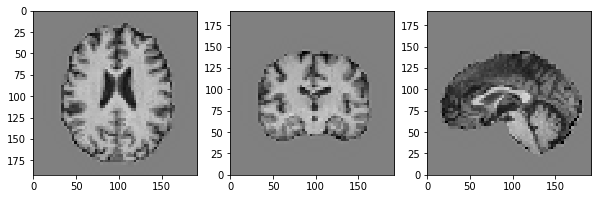

Segmentation


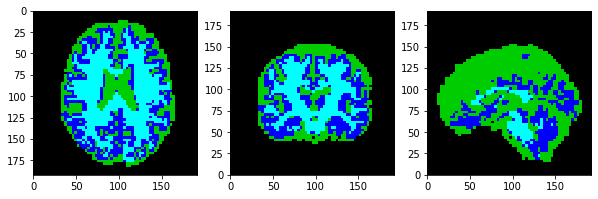

Mask


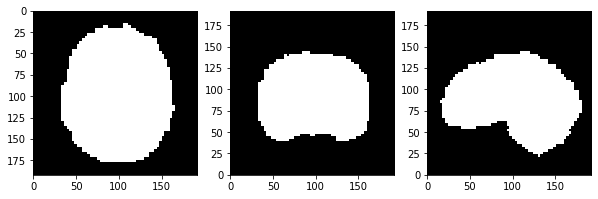

In [17]:
sample = dataset_test.get_sample(0)
img_name = dataset_test.get_img_name(0)
seg_name = dataset_test.get_seg_name(0)
print('Image: ' + img_name)
display_image(sample['img'], window=5, level=0)
print('Segmentation')
display_image(sitk.LabelToRGB(sample['seg']))
print('Mask')
display_image(sample['msk'])

#### TESTING

Below is an implementation of a full testing procedure that saves the segmentations in an output folder. Feel free to modify this procedure.

**TASK: You will need to add the calculations of Dice scores (and possibly others) to evaluate the segmentation performance.**

In [18]:
pred_dir = os.path.join(out_dir, 'pred')
if not os.path.exists(pred_dir):
    os.makedirs(pred_dir)

model = ModSimpleNet3D(num_classes=num_classes)
model.load_state_dict(torch.load(os.path.join(model_dir, 'model.pt')))
model.to(device)
model.eval()
    
print('START TESTING...')

loss_test = 0
sum_pts = 0
idx_test = 0
f1_scores = []
with torch.no_grad():
    for data_sample in dataloader_test:
        img, seg = data_sample['img'].to(device), data_sample['seg'].to(device)
        prd = model(img)
        prd_flat = prd.view(prd.size(0), prd.size(1), -1)
        seg_flat = seg.view(seg.size(0), seg.size(1), -1)
        loss_test += F.cross_entropy(prd_flat, seg_flat.squeeze(1), reduction='sum').item()
        sum_pts += seg_flat.size(2)        
        
        prd = torch.argmax(prd, dim=1)
        f1_prd = prd.view(-1).cpu().numpy()
        f1_seg = seg.view(-1).cpu().numpy()
        f1_val = metrics.f1_score(f1_seg, f1_prd,  average='macro')
        f1_scores.append(f1_val)
        sample = dataset_test.get_sample(idx_test)
        name = dataset_test.get_seg_name(idx_test)
        prediction = sitk.GetImageFromArray(prd.cpu().squeeze().numpy().astype(np.uint8))
        prediction.CopyInformation(sample['seg'])
        sitk.WriteImage(prediction, os.path.join(pred_dir, name))
        
        idx_test += 1
        

loss_test /= sum_pts
fig1, ax1 = plt.subplots()
ax1.set_title('f1 box plot')
ax1.boxplot(f1_scores)
plt.show()

print('+ TESTING \tLoss: {:.6f}, \tF1_score: {}'.format(loss_test, f1_val))

# Show last testing sample as an example
print('\n\nReference segmentation')
display_image(sitk.LabelToRGB(sample['seg']))
print('Predicted segmentation')
display_image(sitk.LabelToRGB(prediction))

print('\nFinished TESTING.')

NameError: name 'ModSimpleNet3D' is not defined

### TASK A-2: Feature calculation

Start by calculating the three absolute tissue volumes for each subject. Plot the volumes against the subjects' ages. Taking the absolute volumes of tissues as features, however, might not be predictive. Instead, relative volumes need to be computed as the ratios between each tissue volume and overall brain volume. But you might also want to explore using different combinations or even polynomial features.

Implement a function that constructs a big matrix $X$ with a row for each subject and features across the columns. Start with just calculating three simple features of relative tissue volumes for GM, WM and CSF, and compare these to the absolute volumes plotted above.

*Note:* If you are struggling with the previous task on image segmentation, or if you prefer to work on this and the following tasks first, you can continue here using the provided reference segmentations which can be found in a subfolder `segs_refs`.

In [23]:
## CALCULATE ABSOLUTE TISSUE VOLUMES

import os

# USE THIS TO RUN THE CALCULATIONS ON YOUR SEGMENTATONS
#seg_dir = './output/pred/'

# USE THIS TO RUN THE CALCULATIONS ON OUR REFERENCE SEGMENTATIONS
seg_dir = data_dir + 'segs_refs/'

meta_data_reg_train = pd.read_csv(data_dir + 'meta/meta_data_reg_train.csv')
ids_reg_train = list(meta_data_reg_train['subject_id'])
files_reg_seg_train = [seg_dir + 'sub-' + f + '_T1w_seg.nii.gz' for f in ids_reg_train]

# THIS MATRIX WILL STORE THE VOLUMES PER TISSUE CLASS
vols = np.zeros((3,len(files_reg_seg_train)))

for idx, _ in enumerate(tqdm(range(len(files_reg_seg_train)), desc='Calculating Features')):
    
    seg_filename = files_reg_seg_train[idx]
    
    if os.path.exists(seg_filename):
        seg = sitk.ReadImage(seg_filename)
        img_array = sitk.GetArrayFromImage(seg)
        GM = 0
        WM = 0
        CSF = 0
        for cell in img_array.flat:
            if cell == 1:
                CSF += 1
            elif cell == 2:
                GM += 1
            elif cell == 3:
                WM += 1
        vols[0][idx] = CSF
        vols[1][idx] = GM
        vols[2][idx] = WM

Calculating Features: 100%|██████████| 500/500 [36:04<00:00,  4.35s/it]


Plot features versus age.

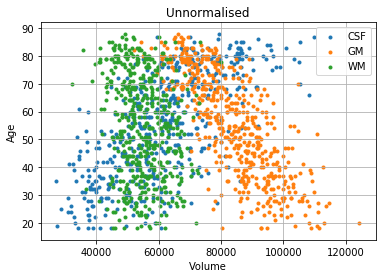

In [24]:
plt.scatter(vols[0,:],meta_data_reg_train['age'], marker='.')
plt.scatter(vols[1,:],meta_data_reg_train['age'], marker='.')
plt.scatter(vols[2,:],meta_data_reg_train['age'], marker='.')
plt.grid()
plt.title('Unnormalised')
plt.xlabel('Volume')
plt.ylabel('Age')
plt.legend(('CSF','GM','WM'))
plt.show()

In [25]:
## CALCULATE RELATIVE TISSUE VOLUMES

vols_normalised = np.zeros((3,len(files_reg_seg_train)))

for idx, _ in enumerate(tqdm(range(len(files_reg_seg_train)), desc='Calculating Features')):
    CSF = vols[0][idx]
    GM = vols[1][idx]
    WM = vols[2][idx]
    nonBackground = CSF + GM + WM
    vols_normalised[0][idx] = CSF / nonBackground
    vols_normalised[1][idx] = GM / nonBackground
    vols_normalised[2][idx] = WM / nonBackground    

Calculating Features: 100%|██████████| 500/500 [00:00<00:00, 217253.91it/s]


Plot normalised features versus age.

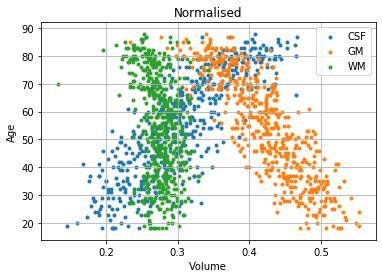

In [26]:
plt.scatter(vols_normalised[0,:],meta_data_reg_train['age'], marker='.')
plt.scatter(vols_normalised[1,:],meta_data_reg_train['age'], marker='.')
plt.scatter(vols_normalised[2,:],meta_data_reg_train['age'], marker='.')
plt.grid()
plt.title('Normalised')
plt.xlabel('Volume')
plt.ylabel('Age')
plt.legend(('CSF','GM','WM'))
plt.show()

Final data for age regression

In [27]:
X = vols_normalised.T
y = meta_data_reg_train['age'].values.reshape(-1,1)

print(X.shape)
print(y.shape)

(500, 3)
(500, 1)


### TASK A-3: Age regression and cross-validation

Experiment with different regression methods from the [scikit-learn toolkit](http://scikit-learn.org/stable/supervised_learning.html#supervised-learning). Remember to construct the output vectur $y$ containing the age for each of the subjects.

Evaluate the methods using two-fold [cross-validation](http://scikit-learn.org/stable/modules/cross_validation.html#cross-validation) where the dataset of 500 subjects is split into two equally sized sets $(X_1,y_1)$ and $(X_2,y_2)$ which are used for training and testing in an alternating way (so each set is used as $(X_{\text{train}},y_{\text{train}})$ and $(X_{\text{test}},y_{\text{test}})$ exactly once).

Try using at least three different regression methods, and generate a plot allows easy comparison of the performance of the three methods. Useful [error metrics](https://scikit-learn.org/stable/modules/model_evaluation.html#regression-metrics) to report include mean absolute error and r2 score. You might also want to plot the real vs predicted ages.

*Note:* These [scikit-learn examples](https://scikit-learn.org/stable/auto_examples/) might serve as an inspiration.

*Hint:* Be careful how you split the dataset into two folds. Take into account the data characteristics shown at the top of the notebook.

Error calculation and plotting

In [0]:
def plot(y, predicted):
  print('mean absolute error: {0}'.format(mean_absolute_error(y,predicted)))
  print('r2 score: {0}'.format(r2_score(y,predicted)))

  fig, ax = plt.subplots()
  ax.scatter(y, predicted, marker='.')
  ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)
  ax.set_xlabel('Real Age')
  ax.set_ylabel('Predicted Age')
  plt.show()

mean absolute error: 8.652155844611823
r2 score: 0.6831862628660744


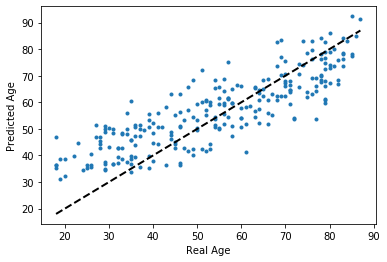

mean absolute error: 8.322625458690661
r2 score: 0.6751139233561488


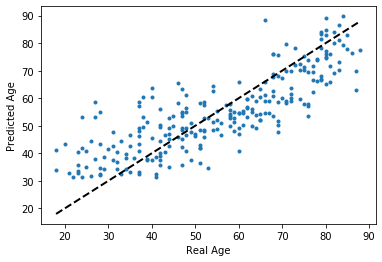

mean age error using Neural Network regression is 8.487390651651243


In [29]:
########################################
# ADD YOUR CODE HERE
########################################

from sklearn.pipeline import make_pipeline
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import GridSearchCV
import statistics
from sklearn import svm

kf = KFold(n_splits=2)

# NN regression model
est = make_pipeline(MLPRegressor(hidden_layer_sizes=(150, 50, 50, 50 ,10),
                                  learning_rate_init=0.005,
                                  early_stopping=True))
nn_err = 0
for train, test in kf.split(X):
  X_train, y_train, X_test, y_test = X[train], y[train], X[test], y[test]
  y_train = np.reshape(y_train, (1, -1))[0]
  y_test = np.reshape(y_test, (1, -1))[0]

  est.fit(X_train, y_train)
  nn_y_pred = est.predict(X_test)
  nn_err += mean_absolute_error(nn_y_pred, y_test)
  plot(y_test, nn_y_pred)

nn_mean_age_err = nn_err / 2
print("mean age error using Neural Network regression is {}".format(nn_mean_age_err))

mean absolute error: 8.44637929523429
r2 score: 0.6925277850475215


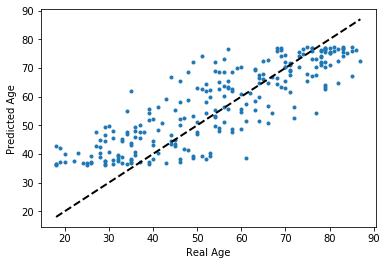

mean absolute error: 8.103156178252513
r2 score: 0.6959736305912734


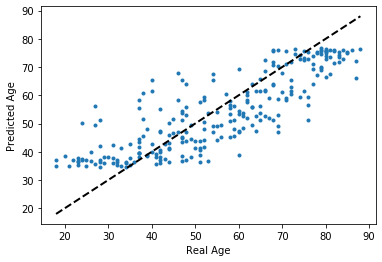

mean age error using support vector regression is 8.274767736743403


In [30]:
# SVR regression model

kf = KFold(n_splits=2)

clf = svm.SVR()
svr_err = 0

for train, test in kf.split(X):
  X_train, y_train, X_test, y_test = X[train], y[train], X[test], y[test]
  y_train = np.reshape(y_train, (1, -1))[0]
  y_test = np.reshape(y_test, (1, -1))[0]
  
  clf.fit(X_train, y_train)
  svr_y_pred = clf.predict(X_test)
  svr_err += mean_absolute_error(svr_y_pred, y_test)
  plot(y_test, svr_y_pred)

svr_mean_age_err = svr_err /2
print("mean age error using support vector regression is {}".format(svr_mean_age_err))

mean absolute error: 8.564718733507053
r2 score: 0.6670085377737425


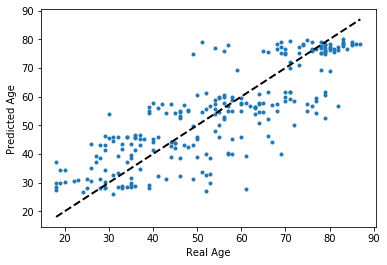

mean absolute error: 8.138938844898261
r2 score: 0.676452784453581


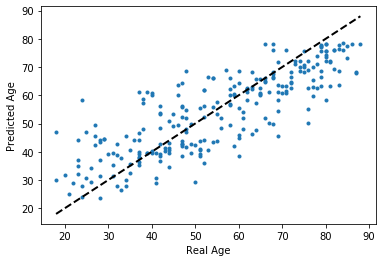

mean age error using decision tree with adaboost regression is 8.351828789202656


In [38]:
#decision tree with adaboost regression model
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor

kf = KFold(n_splits=2)
rng = np.random.RandomState(1)
# dt_reg = DecisionTreeRegressor(max_depth=4)
ada_reg = AdaBoostRegressor(DecisionTreeRegressor(max_depth=4),
                          n_estimators=300, random_state=rng)
ensemble_err = 0

for train, test in kf.split(X):
  X_train, y_train, X_test, y_test = X[train], y[train], X[test], y[test]
  y_train = np.reshape(y_train, (1, -1))[0]
  y_test = np.reshape(y_test, (1, -1))[0]
  
  # dt_reg.fit(X_train, y_train)
  ada_reg.fit(X_train, y_train)
  # dt_y_pred = dt_reg.predict(X_test)
  ada_y_pred = ada_reg.predict(X_test)
  ensemble_err += mean_absolute_error(ada_y_pred, y_test)
  plot(y_test, ada_y_pred)

ada_mean_age_err = ensemble_err /2
print("mean age error using decision tree with adaboost regression is {}".format(ada_mean_age_err))

## Part B: PCA-based regression using grey matter maps

The second approach will make use of grey matter maps that have been already extracted from the MRI scans and aligned to a common reference space to obtain spatially normalised maps. For this, we have used an advanced, state-of-the-art neuroimaging toolkit, called SPM12. The reference space corresponds to the commonly used MNI atlas as seen in the lecture on image segmentation.

Because these grey matter maps are spatially normalised (ie., registered), voxel locations across images from different subjects roughly correspond to the same anatomical locations. This means that each voxel location in the grey matter maps can be treated as an individual feature. Because those maps are quite large at their full resolution there would be a very large number of features to deal with (more than 850,000). A dimensionality reduction may need to be performed before training a suitable regressor on the low-dimensional feature representation. We will use Principal Component Analysis (PCA) to do the dimensionality reduction. It might also be beneficial to apply some pre-processing (downsampling, smoothing, etc.) before running PCA, which should be explored. The implemented pipeline should be evaluated using two-fold cross-validation using the same data splits as in part A for the 500 subjects, so the two different approaches can be directly compared in terms average age prediction accuracy.

*Note:* For part B, only the spatially normalised grey matter maps should be used.

### TASK B-1: Pre-processing

Before running PCA to reduce the dimensionality of the feature space for grey matter maps, it might be beneficial to run some pre-processing on the maps. In voxel-based analysis where each voxel location is a feature, it is common to apply some smoothing beforehand. This is to reduce noise and to compensate for errors of the spatial normalisation.

Because the maps are quite large, it might also be worthwile to explore whether downsampling could be performed even before PCA. This would further reduce the dimensionality, and might be even needed in the case where PCA on the orignial resolution runs into memory issues. You may want to consider other ways of pre-processing and you can find insipiration in the notebook on medical image computing `02-Intro-Medical-Image-Computing.ipynb`.

Implement a function that performs suitable pre-processing on each grey matter map.

*Hint:* You may want to save the pre-processed maps using `sitk.WriteImage` to avoid recomputation each time you run the notebook.

In [2]:
def downsample(img, factor=3):
  smoothed = sitk.DiscreteGaussian(img, (.5 * factor) ** 2)   
  return smoothed[::factor, ::factor, ::factor]

def normalise(arr):
  return arr / np.linalg.norm(arr)

def scale(arr):
  scaler = sklearn.preprocessing.StandardScaler()
  return scaler.fit_transform(arr)

def hist_eq(data, nbins=None):
  shape = data.shape
  data_min, data_max = data.min(), data.max()
  data = data.flatten()

  # nbins defaults to the integer range of values

  if nbins is None:
    nbins = int(data_max - data_min)

  # Compute image histogram
  counts, bins = np.histogram(data, bins=nbins)

  # Compute cumulative distribution function (CDF)
  cdf = counts.cumsum() / counts.sum()

  # Use linear interpolation of CDF to find new intensity values
  data_eq = np.interp(data, bins[:-1], (data_max - data_min) * cdf + data_min)

  return data_eq.reshape(shape)

def hist_eq_img(img, nbins=None):
  data = sitk.GetArrayFromImage(img)
  data_eq = hist_eq(data, nbins)
  img_eq = sitk.GetImageFromArray(data_eq)
  img_eq.CopyInformation(img)
  return img_eq

def sharpen(img, scale=1, strength=2):    
  # Apply unsharp masking
  img_smooth = sitk.DiscreteGaussian(img, scale)
  img_sharpened = img + (img - img_smooth) * strength
  return img_sharpened

def preprocess_image(image, enabled={}, options={'c':10, 'gamma':3, 'factor':2, 'variance': 1, 'scale': 1, 'strength': 2}):
  processed = image
  processed = gamma_correction(image, options['c'], options['gamma'])
  processed = downsample(processed, options['factor'])
  processed = sitk.DiscreteGaussian(processed, options['variance'])
  processed = hist_eq_img(processed)
  processed = sharpen(processed, options['scale'], options['strength'])
  return processed

def process_images(image_ids, enabled, options, save_cache=True, load_cached=False):
  filepath_unprocessed = lambda id: data_dir + 'greymatter/wc1sub-' + id + '_T1w.nii.gz'
  filepath_preprocessed = lambda id: data_dir + 'greymatter/wc1sub-' + id + '_processed_T1w.nii.gz'
  filepath_mask = lambda id: data_dir + 'masks/sub-' + id + '_T1w_brain_mask.nii.gz'

  if load_cached:
    return [sitk.ReadImage(filepath_preprocessed(id)) for id in image_ids]

  processed_images = []
  for id in image_ids:
    image = sitk.ReadImage(filepath_unprocessed(id))
    processed_image = preprocess_image(image, enabled, options) #mask, enabled, options)
    if save_cache:
      sitk.WriteImage(processed_image, filepath_preprocessed(id))
    processed_images.append(processed_image)
  
  processed_images = convert_img_arr_to_numpy(processed_images)
  
  # Normalise and Scale array
  processed_images = scale(normalise(processed_images))
  
  return convert_np_arr_to_img(processed_images)

def convert_img_arr_to_numpy(images):
  return np.array([sitk.GetArrayFromImage(img) for img in images])

def convert_np_arr_to_img(arr):
  return [sitk.GetImageFromArray(numpyarr) for numpyarr in arr]

# Load data 
train_ids = list(meta_data_reg_train['subject_id'])
processed_images = process_images(train_ids)
unprocessed_images = [sitk.ReadImage(data_dir + 'greymatter/wc1sub-' + f + '_T1w.nii.gz') for f in train_ids]

# Display images
img_data = convert_img_arr_to_numpy(processed_images)
gm = unprocessed_images[0]
gmp = processed_images[0]
display_image(gm)
display_image(gmp)

NameError: name 'meta_data_reg_train' is not defined

In [20]:
X = img_data
y = meta_data_reg_train['age'].values.reshape(-1,1)

print(img_size)
print(X.shape)
print(y.shape)

NameError: name 'img_data' is not defined

### TASK B-2: Dimensionality reduction

Implement dimensionality reduction for grey matter maps using [scitkit-learn's PCA](http://scikit-learn.org/stable/modules/decomposition.html#pca). PCA has an option to set the percentage of variance to be preserved (by setting the parameter `n_components` to a value between 0 and 1). The number of principal modes, that is the new dimensionality of the data, is then automatically determined. Try initially to preserve 95% of the variance (`n_components=0.95`).

*Note:* When dimensionality reduction is used as pre-processing step for supervised learning, as in this case, it is important that PCA is fitted to the training data only, but then applied to both the training and testing data. So make sure your implementation consists of two separate steps, 1) fitting the PCA model to $X_{\text{train}}$ (using the `fit` function), and 2) applying dimensionality reduction to $X_{\text{train}}$ and $X_{\text{test}}$ using the `transform` function.

In [21]:
from sklearn.decomposition import PCA
def reshape_for_PCA(dataset):
  n, x, y, z = dataset.shape
  return dataset.reshape(n, x*y*z)

def reshape_after_PCA(dataset, original_shape):
  return dataset.reshape(original_shape)

def apply_PCA(train, test, n_components=0.95):
  pca = PCA(n_components=n_components)
  reshaped_train = reshape_for_PCA(train)
  reshaped_test = reshape_for_PCA(test)
  pca.fit(reshaped_train)
  X_train = pca.transform(reshaped_train)
  X_test = pca.transform(reshaped_test)
  return X_train, X_test, pca

### TASK B-3: Age regression and cross-validation

Experiment with different regression methods from the [scikit-learn toolkit](http://scikit-learn.org/stable/supervised_learning.html#supervised-learning). Evaluate the methods using two-fold [cross-validation](http://scikit-learn.org/stable/modules/cross_validation.html#cross-validation) in the same way as for your approach in Part A so results can be directly compared. Generate the similar plots.

Try using at least three different regression methods.

*Hint:* Remember, when you use cross-validation where you swap training and testing sets in each fold, you need to fit PCA to the training set of each fold.

------ Processing #1 ------
(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8511368983666195 set 2 0.8362790591412572 avg 0.8437079787539383
svm set 1 0.6564745217248216 set 2 0.6672868883413345 avg 0.661880705033078
mlp set 1 -0.9695451046766848 set 2 -0.6477124730555217 avg -0.8086287888661032
Average set 1 0.17935543847158542 set 2 0.28528449147569 total 0.23231996497363772
Visualisation of Preprocessing:


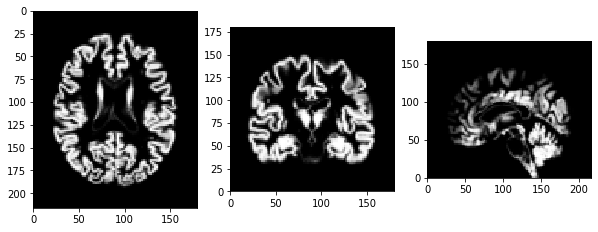

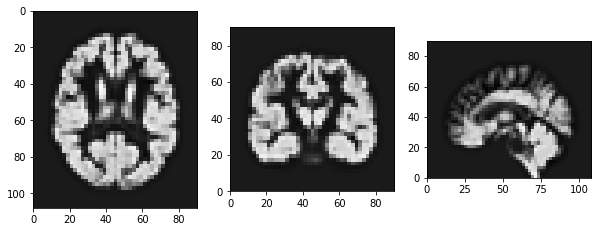

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8545317232396844 set 2 0.8425207969337616 avg 0.8485262600867229
svm set 1 0.6324855651884291 set 2 0.5370857805043652 avg 0.5847856728463972
mlp set 1 -1.4218887128825806 set 2 -1.1317164303772724 avg -1.2768025716299265
Average set 1 0.021709525181844363 set 2 0.08263004902028477 total 0.05216978710106457
Visualisation of Preprocessing:


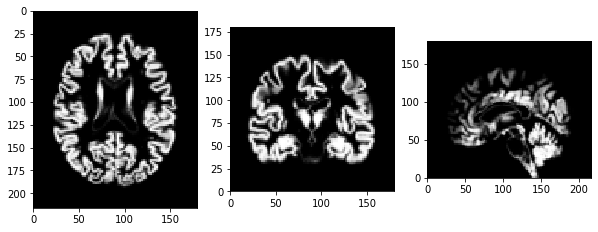

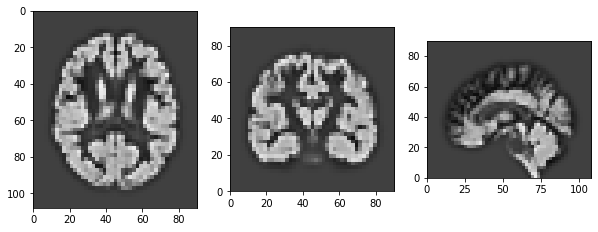

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8539298412791562 set 2 0.8314667506394094 avg 0.8426982959592828
svm set 1 0.5186547291104245 set 2 0.35342877701254505 avg 0.4360417530614848
mlp set 1 -1.531377280462145 set 2 -1.541174651861831 avg -1.536275966161988
Average set 1 -0.05293090335752145 set 2 -0.1187597080699588 total -0.08584530571374012
Visualisation of Preprocessing:


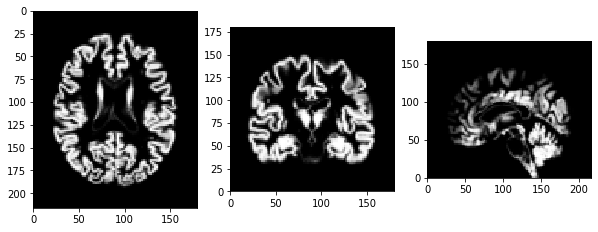

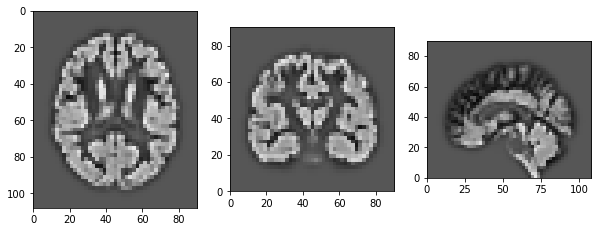

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8494365125394312 set 2 0.84411496428115 avg 0.8467757384102905
svm set 1 0.5700927124793157 set 2 0.6636352286250412 avg 0.6168639705521785
mlp set 1 -1.048365163606983 set 2 -0.8657758160192802 avg -0.9570704898131317
Average set 1 0.12372135380392131 set 2 0.21399145896230365 total 0.16885640638311247
Visualisation of Preprocessing:


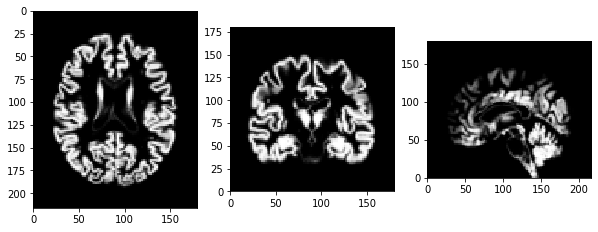

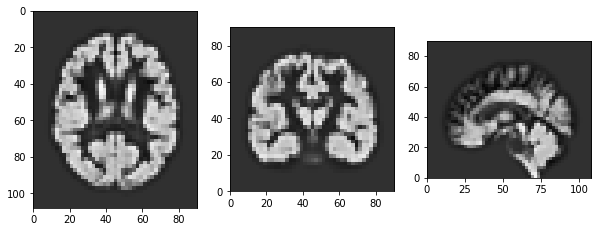

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8657218444718884 set 2 0.8416194807519968 avg 0.8536706626119426
svm set 1 0.5210141052389707 set 2 0.5428170090875628 avg 0.5319155571632668
mlp set 1 -1.4055478339752483 set 2 -1.163154908819223 avg -1.2843513713972357
Average set 1 -0.006270628088129726 set 2 0.07376052700677886 total 0.03374494945932457
Visualisation of Preprocessing:


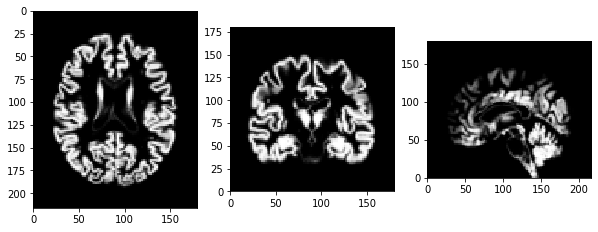

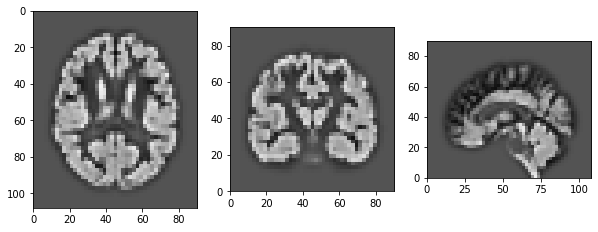

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8112045252834588 set 2 0.8534840583841723 avg 0.8323442918338155
svm set 1 0.28304740427876474 set 2 0.4998541773479799 avg 0.3914507908133723
mlp set 1 -1.7578710501433668 set 2 -1.32038291758334 avg -1.5391269838633534
Average set 1 -0.22120637352704775 set 2 0.010985106049604084 total -0.10511063373872183
Visualisation of Preprocessing:


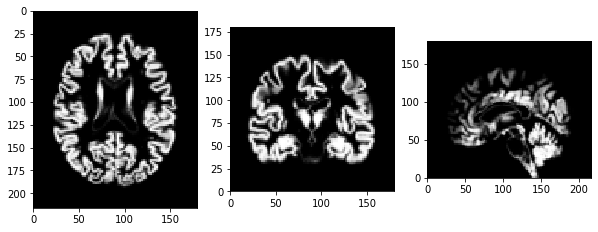

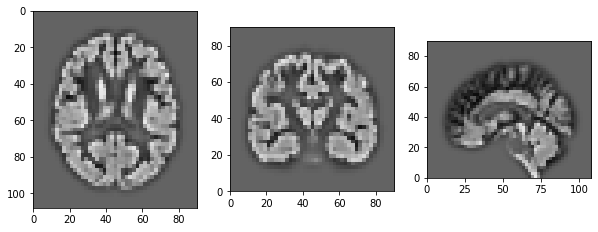

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8432383442856204 set 2 0.8362560470297358 avg 0.8397471956576781
svm set 1 0.5809214564282346 set 2 0.6437462738375941 avg 0.6123338651329143
mlp set 1 -0.8833274128246557 set 2 -1.0666829288303386 avg -0.9750051708274972
Average set 1 0.1802774626297331 set 2 0.1377731306789971 total 0.1590252966543651
Visualisation of Preprocessing:


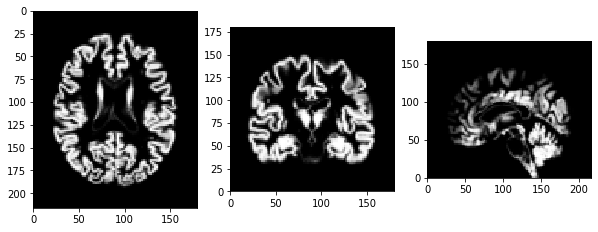

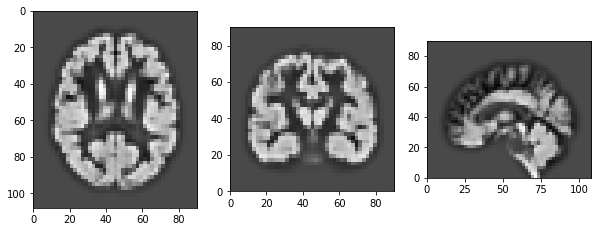

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8402460727031823 set 2 0.8557018356557526 avg 0.8479739541794675
svm set 1 0.5535801235633433 set 2 0.4857096009018892 avg 0.5196448622326162
mlp set 1 -1.294377746475457 set 2 -1.184019865879082 avg -1.2391988061772694
Average set 1 0.03314948326368953 set 2 0.05246385689285334 total 0.042806670078271436
Visualisation of Preprocessing:


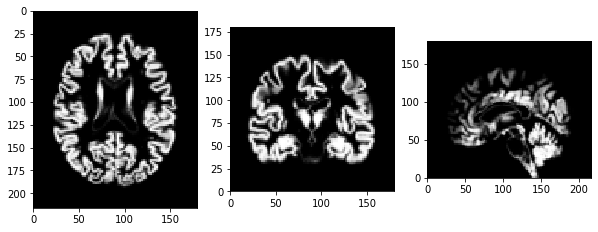

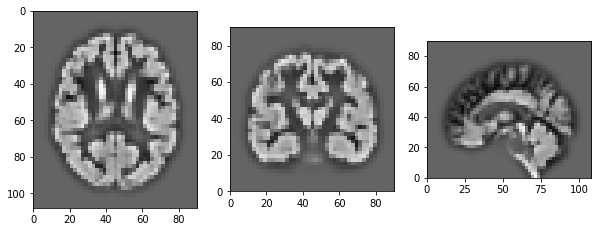

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8404383149317747 set 2 0.8413253487181008 avg 0.8408818318249378
svm set 1 0.4950530179593774 set 2 0.4389667922110185 avg 0.4670099050851979
mlp set 1 -1.6064924514886156 set 2 -1.3846418310439415 avg -1.4955671412662785
Average set 1 -0.09033370619915448 set 2 -0.03478323003827407 total -0.06255846811871428
Visualisation of Preprocessing:


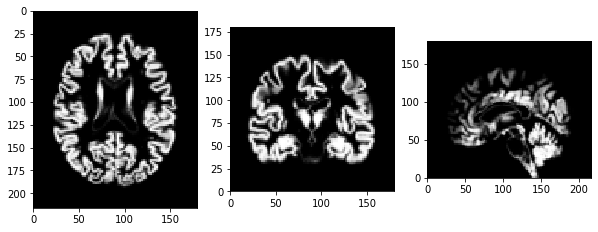

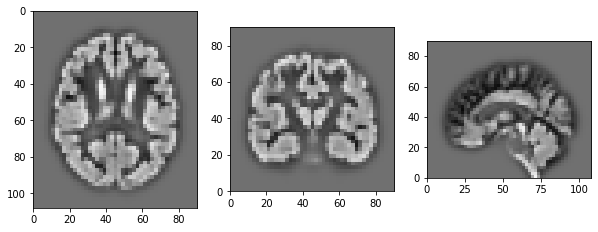

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8605110946993197 set 2 0.8485911071235067 avg 0.8545511009114133
svm set 1 0.6496709997724652 set 2 0.5983972616948865 avg 0.6240341307336759
mlp set 1 -0.6624953823539852 set 2 -0.30302902830631995 avg -0.48276220533015257
Average set 1 0.28256223737259994 set 2 0.3813197801706911 total 0.33194100877164556
Visualisation of Preprocessing:


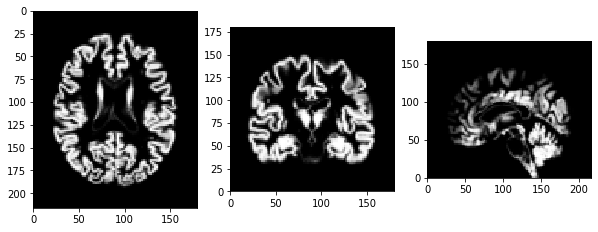

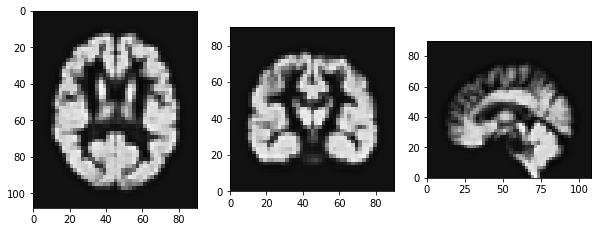

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8370128813810508 set 2 0.8605140528918486 avg 0.8487634671364497
svm set 1 0.5349998190048526 set 2 0.6359088259068637 avg 0.5854543224558582
mlp set 1 -0.9791570753556316 set 2 -0.7227137585525252 avg -0.8509354169540784
Average set 1 0.13095187501009056 set 2 0.2579030400820624 total 0.1944274575460765
Visualisation of Preprocessing:


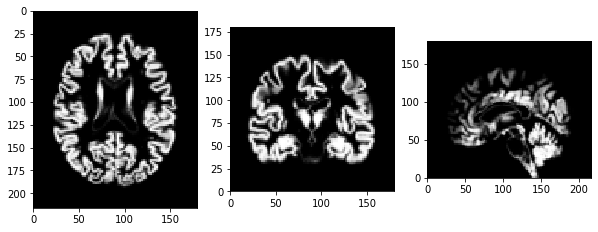

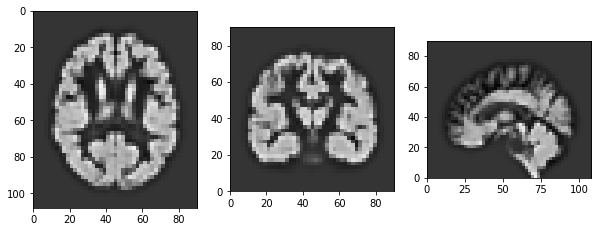

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.816855246301179 set 2 0.8631506133228682 avg 0.8400029298120236
svm set 1 0.4451903407375954 set 2 0.5413185493949672 avg 0.49325444506628124
mlp set 1 -1.003393515686136 set 2 -1.407501033264571 avg -1.2054472744753535
Average set 1 0.08621735711754612 set 2 -0.001010623515578531 total 0.0426033668009838
Visualisation of Preprocessing:


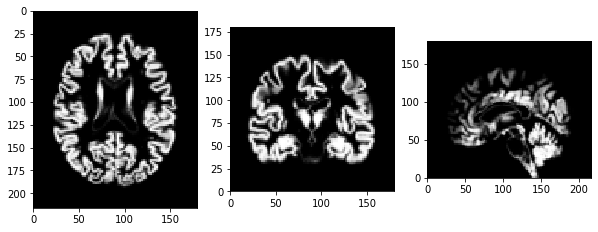

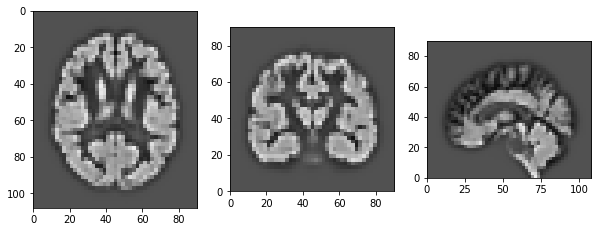

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8247073466014986 set 2 0.8413079632116658 avg 0.8330076549065821
svm set 1 0.6643533617511852 set 2 0.568770683254008 avg 0.6165620225025966
mlp set 1 -1.0093250752148437 set 2 -0.5001089869080981 avg -0.7547170310614709
Average set 1 0.1599118777126134 set 2 0.30332321985252525 total 0.23161754878256932
Visualisation of Preprocessing:


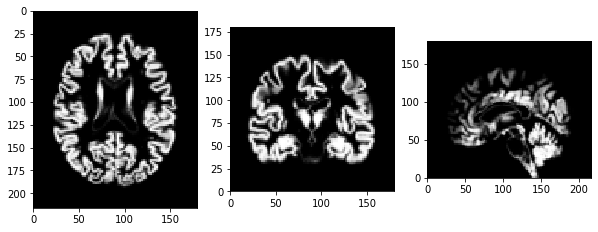

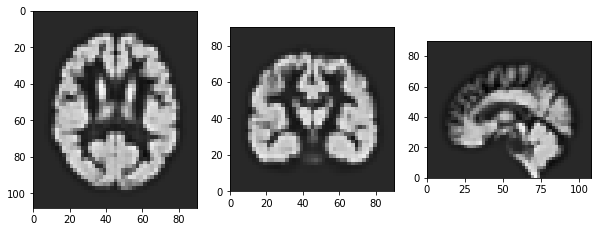

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8619579803170045 set 2 0.8294597590119921 avg 0.8457088696644983
svm set 1 0.5318091097528201 set 2 0.5495608390337126 avg 0.5406849743932663
mlp set 1 -1.0394730759835191 set 2 -1.0690365634027104 avg -1.0542548196931147
Average set 1 0.11809800469543519 set 2 0.10332801154766476 total 0.11071300812154997
Visualisation of Preprocessing:


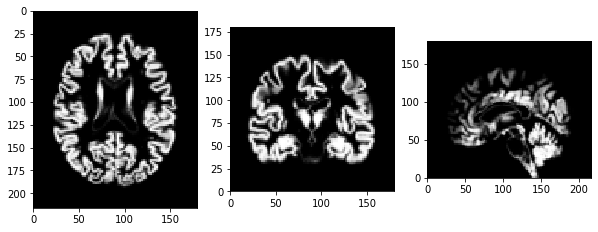

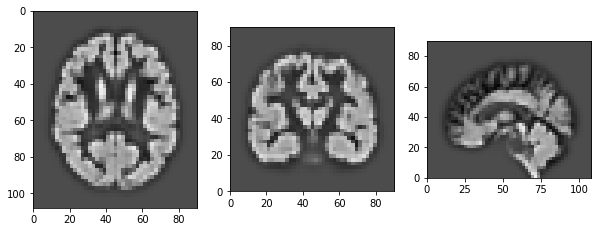

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.853660211054869 set 2 0.8476214809216976 avg 0.8506408459882833
svm set 1 0.48449458937590534 set 2 0.4638652435967054 avg 0.47417991648630536
mlp set 1 -1.366872983213137 set 2 -1.338469062397805 avg -1.352671022805471
Average set 1 -0.009572727594120867 set 2 -0.008994112626467357 total -0.009283420110294111
Visualisation of Preprocessing:


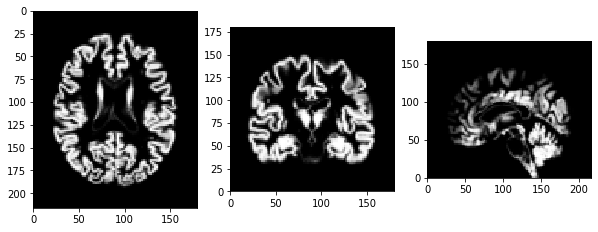

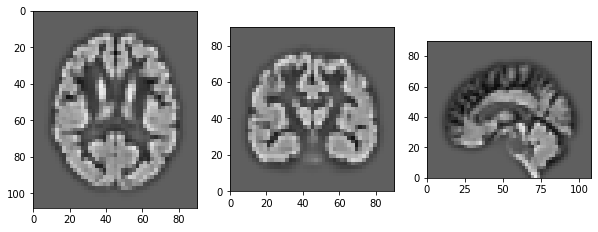

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.852750846238942 set 2 0.8504414996035521 avg 0.8515961729212471
svm set 1 0.588085664592096 set 2 0.6302906800134765 avg 0.6091881723027863
mlp set 1 -0.8394837273179505 set 2 -0.5710338200844893 avg -0.7052587737012199
Average set 1 0.2004509278376958 set 2 0.3032327865108464 total 0.2518418571742711
Visualisation of Preprocessing:


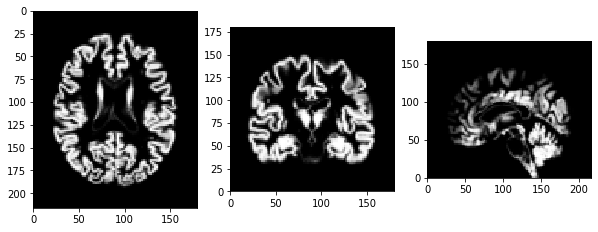

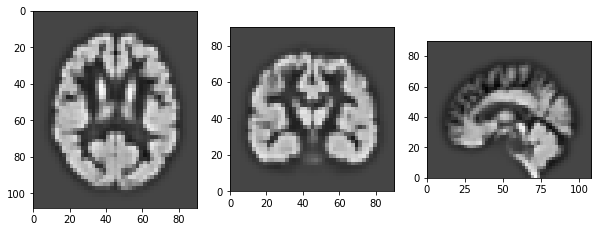

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.831312841722034 set 2 0.8541439804877943 avg 0.8427284111049141
svm set 1 0.5451305195715301 set 2 0.5484716206457475 avg 0.5468010701086388
mlp set 1 -1.1802038545211655 set 2 -0.7350081364111709 avg -0.9576059954661682
Average set 1 0.06541316892413285 set 2 0.22253582157412363 total 0.14397449524912825
Visualisation of Preprocessing:


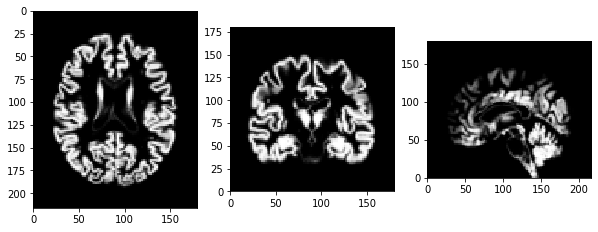

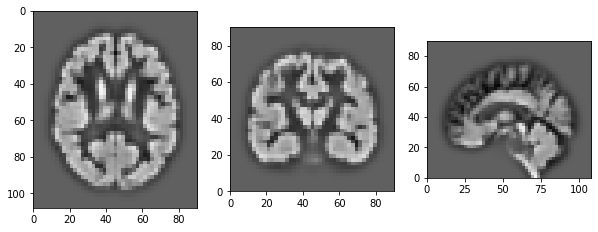

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8551608507652398 set 2 0.849888174920453 avg 0.8525245128428465
svm set 1 0.5397312008240756 set 2 0.4134941802473377 avg 0.47661269053570665
mlp set 1 -1.0714727886778963 set 2 -1.3329663623528272 avg -1.2022195755153617
Average set 1 0.10780642097047306 set 2 -0.023194669061678812 total 0.042305875954397124
Visualisation of Preprocessing:


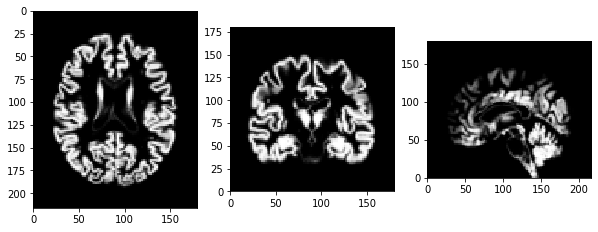

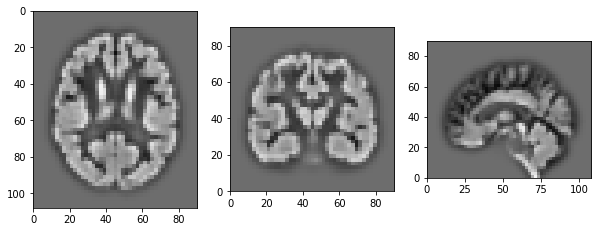

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8432056433599768 set 2 0.8353327515891709 avg 0.8392691974745738
svm set 1 0.6654087434149003 set 2 0.668805571247336 avg 0.6671071573311181
mlp set 1 -0.1305775396835258 set 2 0.0462082579916302 avg -0.04218464084594781
Average set 1 0.4593456156971171 set 2 0.5167821936093789 total 0.488063904653248
Visualisation of Preprocessing:


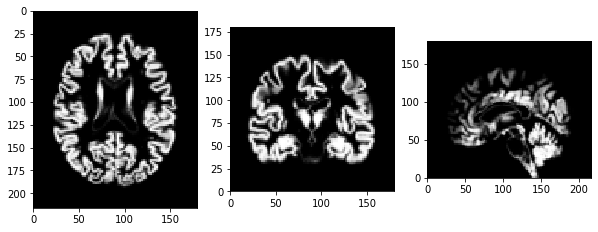

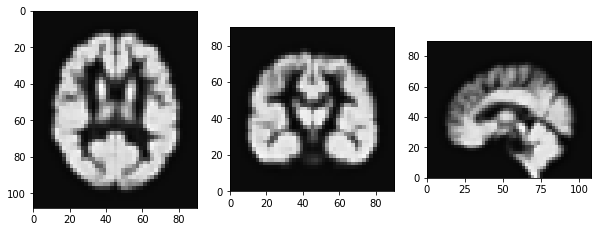

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8733326019244907 set 2 0.8456519138247667 avg 0.8594922578746287
svm set 1 0.6432222204955308 set 2 0.6519008965233901 avg 0.6475615585094605
mlp set 1 -0.23328279636042312 set 2 -0.3263517083759815 avg -0.2798172523682023
Average set 1 0.42775734201986615 set 2 0.3904003673240584 total 0.40907885467196226
Visualisation of Preprocessing:


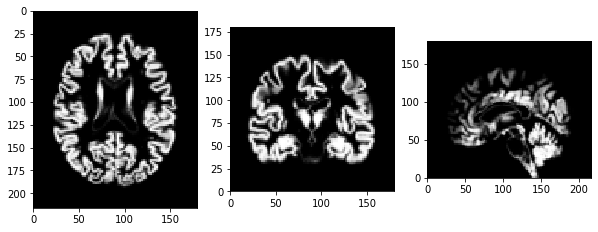

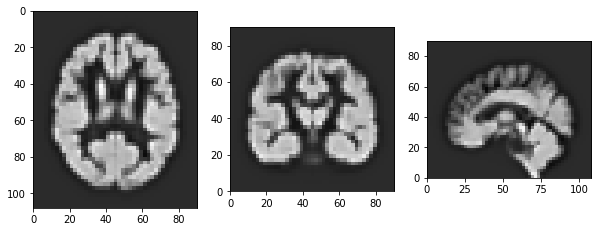

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.864838787268081 set 2 0.850051799274173 avg 0.857445293271127
svm set 1 0.6248077218728385 set 2 0.558685843760369 avg 0.5917467828166038
mlp set 1 -0.3280532486044503 set 2 -0.644298167858435 avg -0.4861757082314426
Average set 1 0.38719775351215646 set 2 0.25481315839203567 total 0.32100545595209606
Visualisation of Preprocessing:


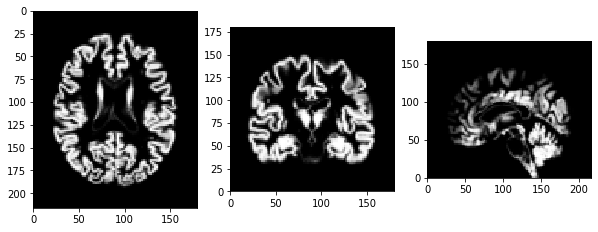

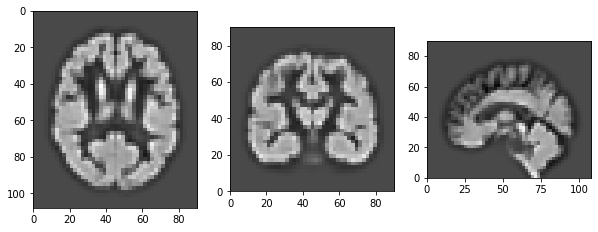

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.864521498210789 set 2 0.8662359216465575 avg 0.8653787099286733
svm set 1 0.6747713380338884 set 2 0.6546815604678071 avg 0.6647264492508478
mlp set 1 -0.34155591950185316 set 2 0.04825367797049651 avg -0.14665112076567832
Average set 1 0.39924563891427484 set 2 0.5230570533616204 total 0.4611513461379476
Visualisation of Preprocessing:


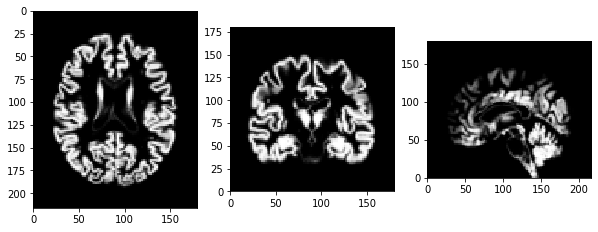

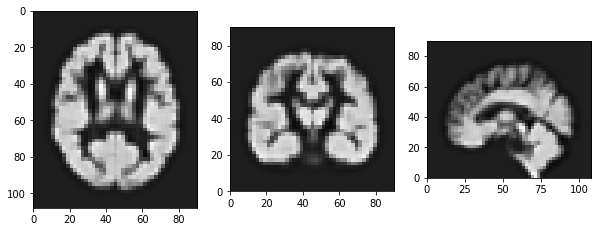

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8586698549458751 set 2 0.8434916944251714 avg 0.8510807746855232
svm set 1 0.6211097755033468 set 2 0.6141749171329043 avg 0.6176423463181255
mlp set 1 -0.38119326923287633 set 2 -0.44801238584655984 avg -0.4146028275397181
Average set 1 0.3661954537387819 set 2 0.33655140857050525 total 0.3513734311546436
Visualisation of Preprocessing:


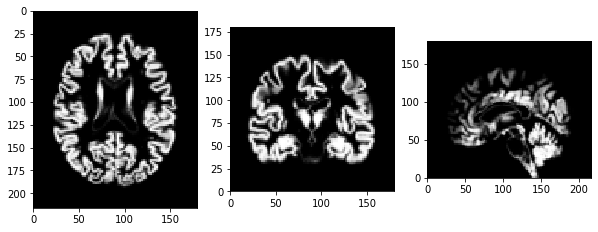

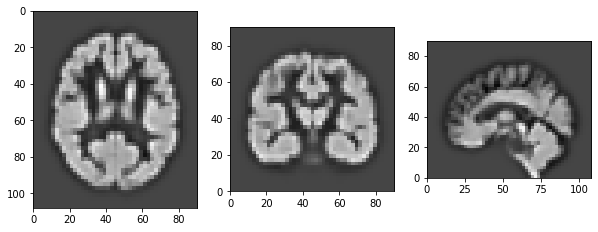

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8628445236909743 set 2 0.8338994438086876 avg 0.8483719837498309
svm set 1 0.5836180790852158 set 2 0.5571506947252347 avg 0.5703843869052252
mlp set 1 -0.9068676435213417 set 2 -0.7134268357621236 avg -0.8101472396417326
Average set 1 0.17986498641828283 set 2 0.22587443425726628 total 0.20286971033777457
Visualisation of Preprocessing:


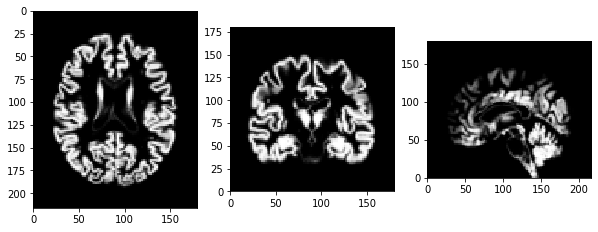

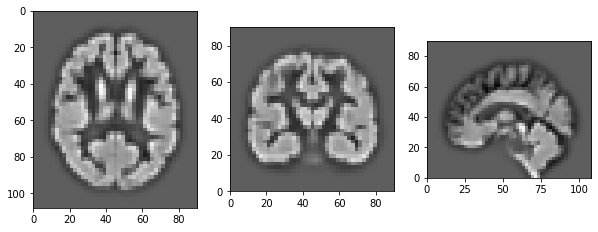

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8483374689044699 set 2 0.8480964300517704 avg 0.8482169494781202
svm set 1 0.6449257766320176 set 2 0.6654820134765601 avg 0.6552038950542889
mlp set 1 -0.18971433403815796 set 2 -0.3175065813618638 avg -0.2536104577000109
Average set 1 0.43451630383277645 set 2 0.3986906207221555 total 0.416603462277466
Visualisation of Preprocessing:


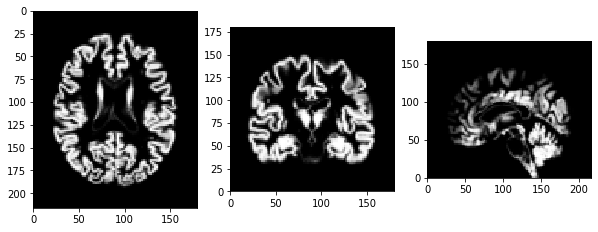

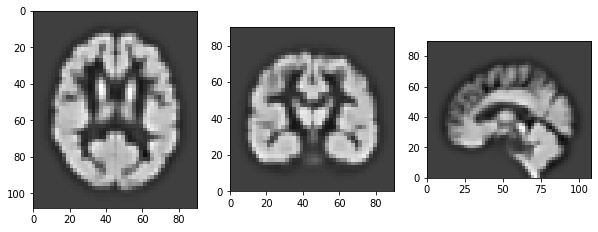

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8448778058077305 set 2 0.8635649356757454 avg 0.854221370741738
svm set 1 0.5983490629552533 set 2 0.6319238226638131 avg 0.6151364428095332
mlp set 1 -0.500324289043788 set 2 -0.6575453377844049 avg -0.5789348134140965
Average set 1 0.3143008599063986 set 2 0.27931447351838457 total 0.29680766671239156
Visualisation of Preprocessing:


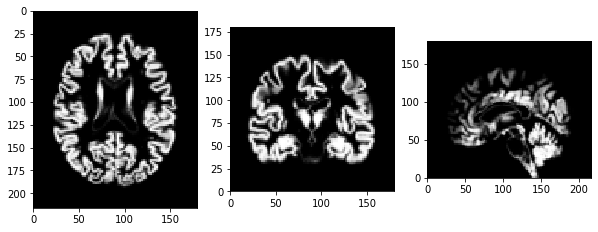

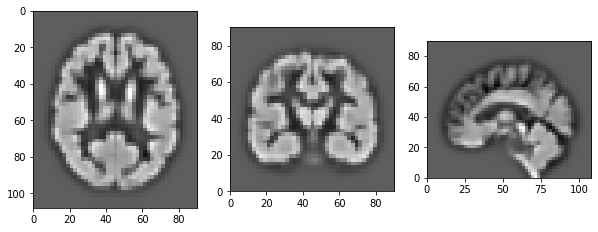

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.846429961250658 set 2 0.8521508102465339 avg 0.8492903857485959
svm set 1 0.6183327442229003 set 2 0.5321973373221571 avg 0.5752650407725287
mlp set 1 -0.6799037156373611 set 2 -0.7175720069248999 avg -0.6987378612811305
Average set 1 0.2616196632787324 set 2 0.22225871354793045 total 0.2419391884133314
Visualisation of Preprocessing:


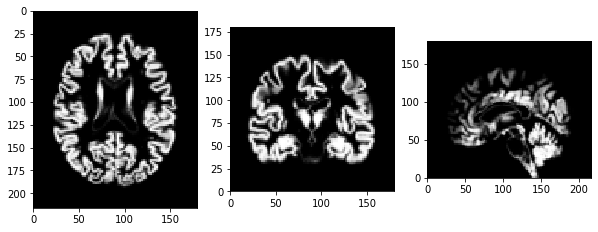

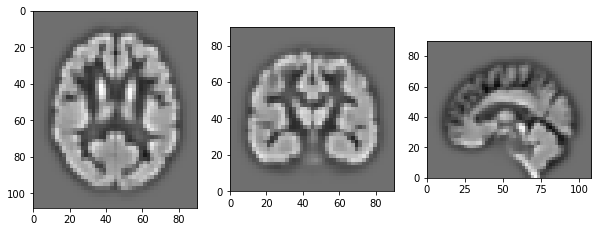

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8687162956613785 set 2 0.8497029051961456 avg 0.859209600428762
svm set 1 0.6744726497178175 set 2 0.6604046888219621 avg 0.6674386692698898
mlp set 1 0.07291928507478196 set 2 0.10321426142407673 avg 0.08806677324942935
Average set 1 0.5387027434846593 set 2 0.5377739518140615 total 0.5382383476493604
Visualisation of Preprocessing:


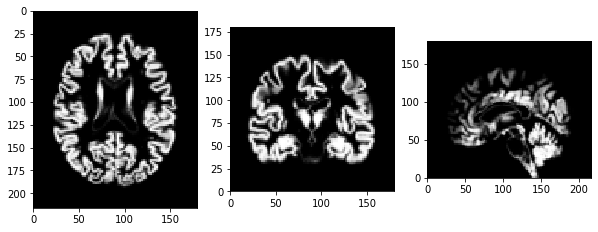

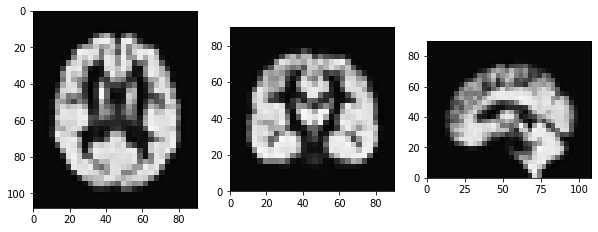

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8459012068444229 set 2 0.8407982978583972 avg 0.8433497523514101
svm set 1 0.632537489955157 set 2 0.6734707423714743 avg 0.6530041161633157
mlp set 1 -0.16005852494000972 set 2 -0.2451437794365341 avg -0.2026011521882719
Average set 1 0.43946005728652343 set 2 0.4230417535977791 total 0.4312509054421513
Visualisation of Preprocessing:


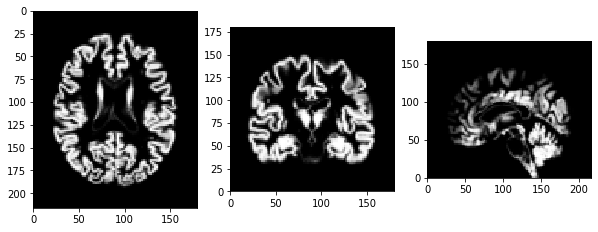

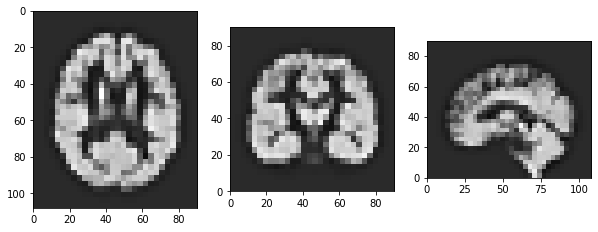

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8523910750901191 set 2 0.8507488803790066 avg 0.8515699777345629
svm set 1 0.6222784478060708 set 2 0.6192566088879263 avg 0.6207675283469986
mlp set 1 -0.19714942741455532 set 2 -0.402261773047496 avg -0.29970560023102566
Average set 1 0.42584003182721153 set 2 0.35591457207314564 total 0.39087730195017856
Visualisation of Preprocessing:


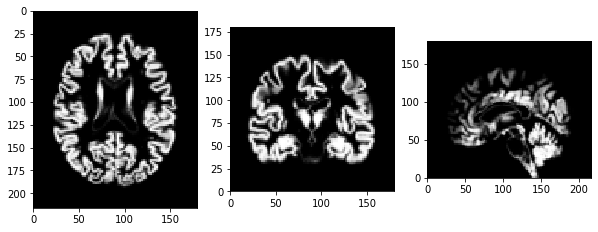

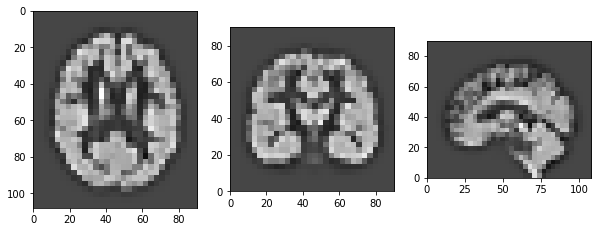

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8431531176252935 set 2 0.8430094743383872 avg 0.8430812959818403
svm set 1 0.6641895401674736 set 2 0.662272776440969 avg 0.6632311583042213
mlp set 1 -0.145705139860705 set 2 0.03082509814807577 avg -0.05744002085631461
Average set 1 0.4538791726440207 set 2 0.5120357829758106 total 0.4829574778099157
Visualisation of Preprocessing:


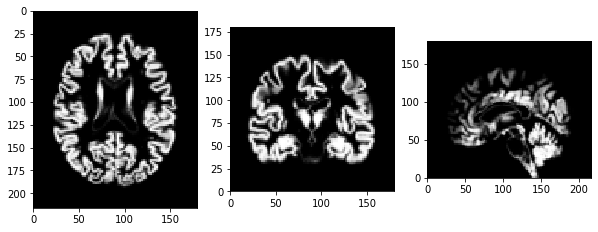

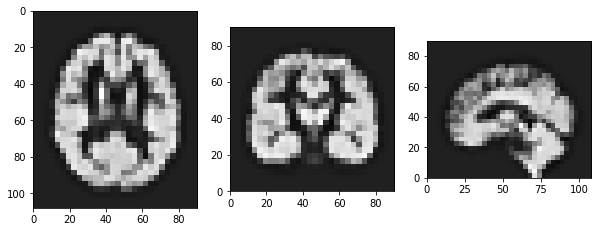

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8487652971527531 set 2 0.8467035425760353 avg 0.8477344198643941
svm set 1 0.6022011252135664 set 2 0.6521087165183415 avg 0.6271549208659539
mlp set 1 -0.06592603218612036 set 2 -0.5268516016043587 avg -0.29638881689523955
Average set 1 0.46168013006006636 set 2 0.32398688583000596 total 0.39283350794503613
Visualisation of Preprocessing:


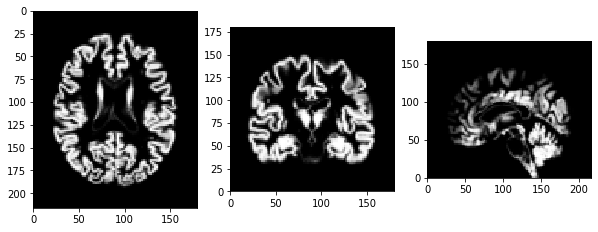

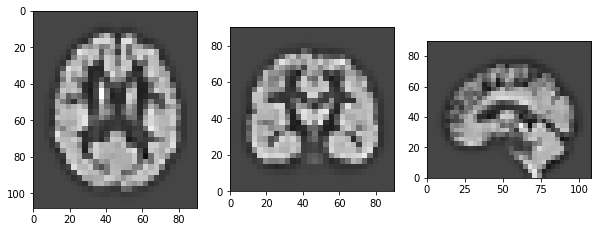

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8472388861579239 set 2 0.8386770132621901 avg 0.842957949710057
svm set 1 0.5524527749920121 set 2 0.6154106549448533 avg 0.5839317149684327
mlp set 1 -0.6001946737056738 set 2 -0.41839000791701264 avg -0.5092923408113432
Average set 1 0.26649899581475406 set 2 0.34523255343001025 total 0.3058657746223822
Visualisation of Preprocessing:


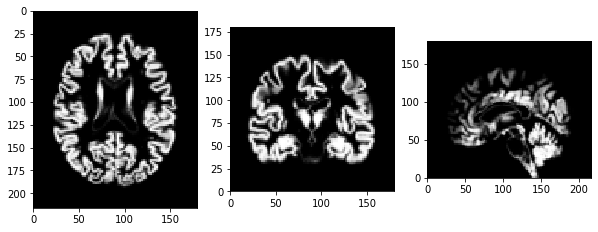

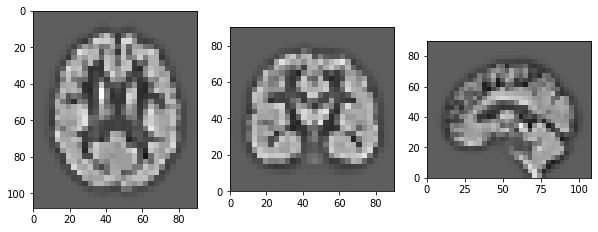

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8426183979939977 set 2 0.8482782749961497 avg 0.8454483364950738
svm set 1 0.6390242391876539 set 2 0.6623963019812519 avg 0.650710270584453
mlp set 1 -0.2116351935635321 set 2 -0.14795836828305942 avg -0.17979678092329576
Average set 1 0.42333581453937325 set 2 0.45423873623144745 total 0.43878727538541035
Visualisation of Preprocessing:


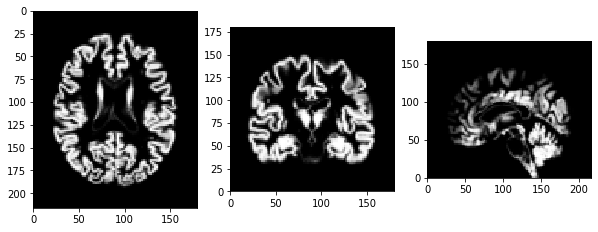

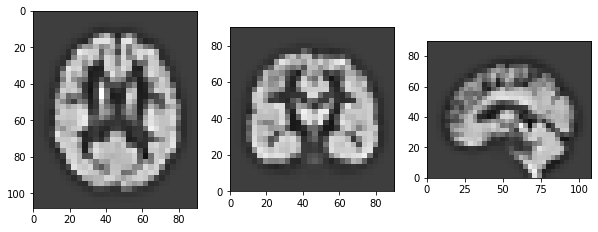

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8572303396153067 set 2 0.8367138580327093 avg 0.8469720988240079
svm set 1 0.593119666470585 set 2 0.6141078471258681 avg 0.6036137567982265
mlp set 1 -0.3707510181286886 set 2 -0.4641559971173114 avg -0.41745350762300004
Average set 1 0.35986632931906765 set 2 0.3288885693470886 total 0.3443774493330781
Visualisation of Preprocessing:


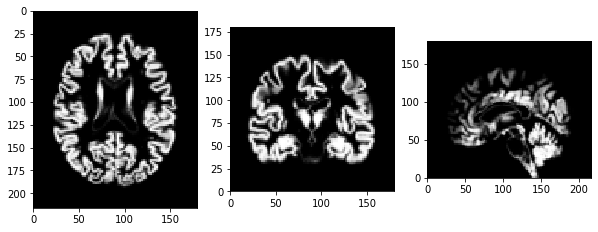

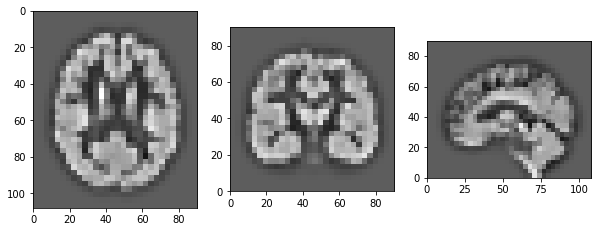

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8576729779676663 set 2 0.8284417958358752 avg 0.8430573869017708
svm set 1 0.6023249671950017 set 2 0.5494801715961479 avg 0.5759025693955748
mlp set 1 -0.6287218883883603 set 2 -0.5296360432045513 avg -0.5791789657964558
Average set 1 0.27709201892476926 set 2 0.2827619747424906 total 0.2799269968336299
Visualisation of Preprocessing:


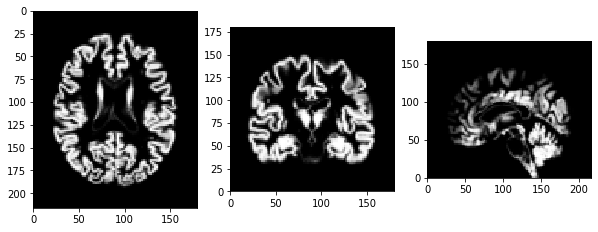

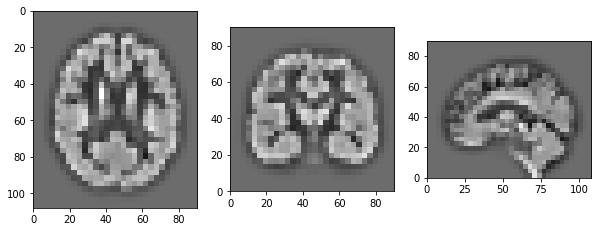

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8598123948524671 set 2 0.8488393932263489 avg 0.8543258940394081
svm set 1 0.6612879271042666 set 2 0.613816960310541 avg 0.6375524437074038
mlp set 1 0.10996732897713435 set 2 0.21542317121104027 avg 0.1626952500940873
Average set 1 0.543689216977956 set 2 0.5593598415826434 total 0.5515245292802997
Visualisation of Preprocessing:


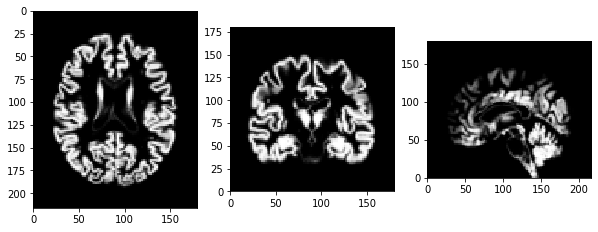

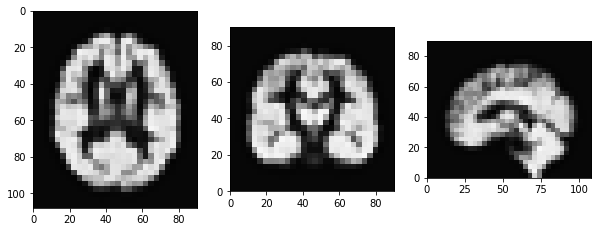

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.839442333477051 set 2 0.869981800867679 avg 0.8547120671723649
svm set 1 0.6732757737444026 set 2 0.650988989568685 avg 0.6621323816565439
mlp set 1 -0.028264211745731238 set 2 0.09069917922485415 avg 0.031217483739561458
Average set 1 0.49481796515857407 set 2 0.5372233232204061 total 0.5160206441894901
Visualisation of Preprocessing:


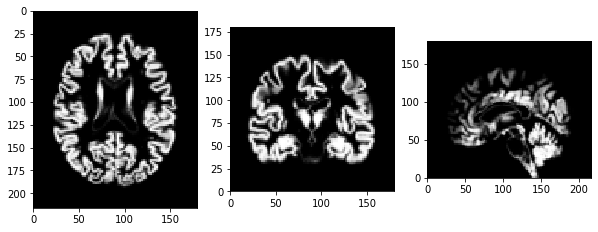

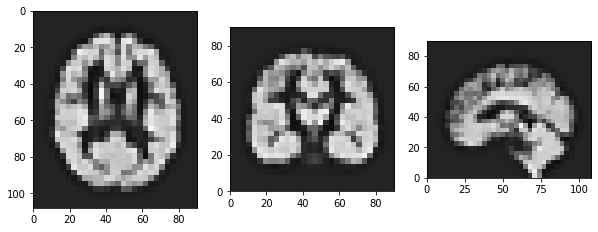

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.866655539936142 set 2 0.8380869292199645 avg 0.8523712345780532
svm set 1 0.6591077132444858 set 2 0.6442827233557622 avg 0.651695218300124
mlp set 1 -0.20300084938439109 set 2 -0.3353292573237665 avg -0.2691650533540788
Average set 1 0.4409208012654122 set 2 0.38234679841732006 total 0.41163379984136617
Visualisation of Preprocessing:


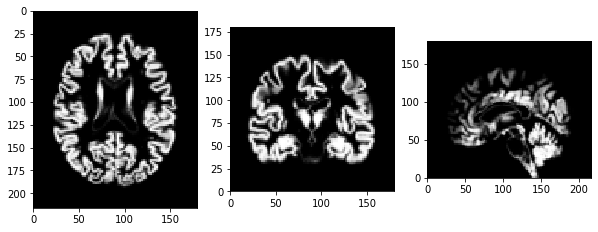

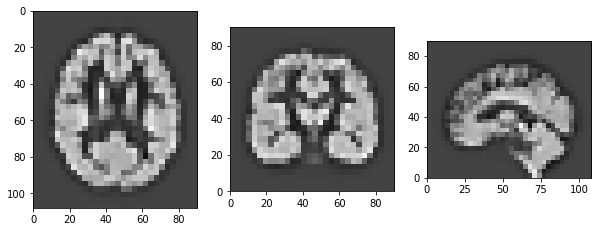

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8336429205435805 set 2 0.8731254937626488 avg 0.8533842071531146
svm set 1 0.6838834957419345 set 2 0.670848680901629 avg 0.6773660883217818
mlp set 1 0.12934013965990843 set 2 0.03390448921011513 avg 0.08162231443501178
Average set 1 0.5489555186484746 set 2 0.5259595546247976 total 0.5374575366366361
Visualisation of Preprocessing:


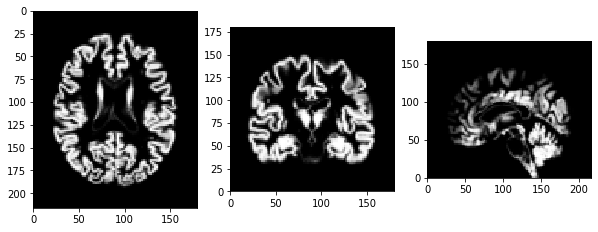

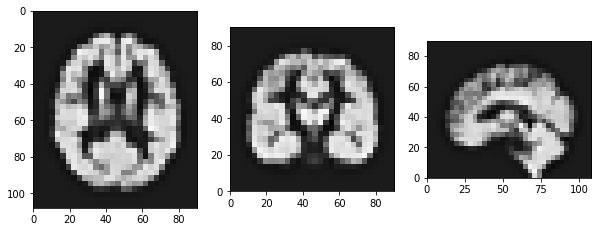

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8598953489124341 set 2 0.8245821886468065 avg 0.8422387687796203
svm set 1 0.6463966428709891 set 2 0.6512595018330637 avg 0.6488280723520263
mlp set 1 0.032967158082100934 set 2 -0.42601873534733187 avg -0.19652578863261547
Average set 1 0.5130863832885081 set 2 0.3499409850441794 total 0.4315136841663437
Visualisation of Preprocessing:


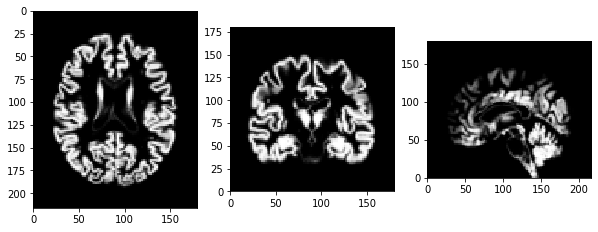

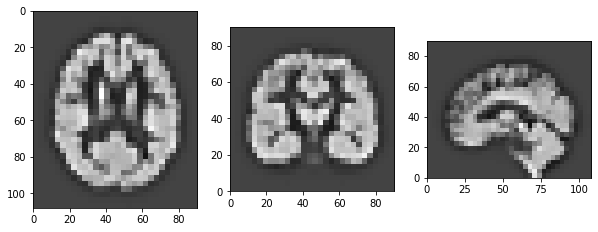

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8587642754835787 set 2 0.8445007864539402 avg 0.8516325309687595
svm set 1 0.6187628647662757 set 2 0.6341554344624906 avg 0.6264591496143832
mlp set 1 -0.28699682330912224 set 2 -0.3750726397101265 avg -0.33103473150962437
Average set 1 0.39684343898024405 set 2 0.3678611937354348 total 0.3823523163578394
Visualisation of Preprocessing:


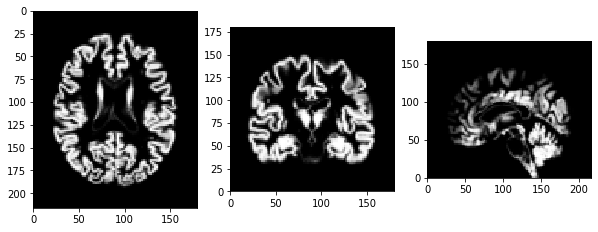

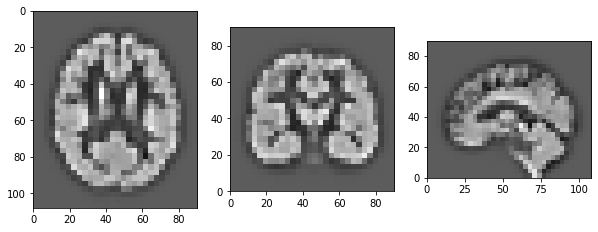

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8525016907657146 set 2 0.8666251120290485 avg 0.8595634013973815
svm set 1 0.6907206082431951 set 2 0.6504959918782076 avg 0.6706083000607014
mlp set 1 -0.11331687730851316 set 2 0.07866524225156735 avg -0.017325817528472905
Average set 1 0.47663514056679884 set 2 0.5319287820529411 total 0.50428196130987
Visualisation of Preprocessing:


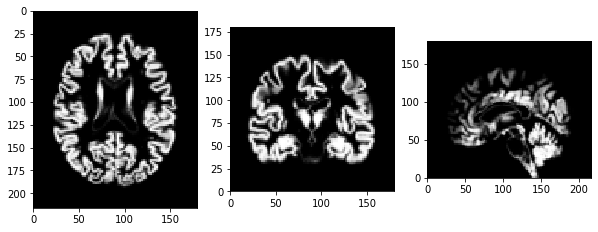

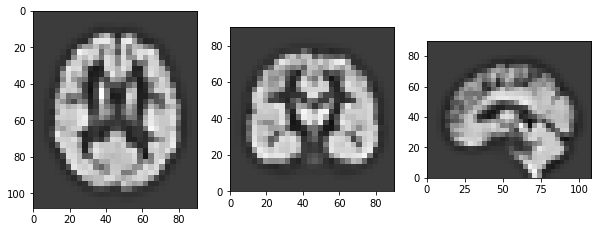

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8515164471080093 set 2 0.8518506503618428 avg 0.8516835487349261
svm set 1 0.6472193080108015 set 2 0.6324037250461885 avg 0.639811516528495
mlp set 1 -0.27797622118934684 set 2 -0.27925047758454835 avg -0.2786133493869476
Average set 1 0.4069198446431547 set 2 0.401667965941161 total 0.40429390529215786
Visualisation of Preprocessing:


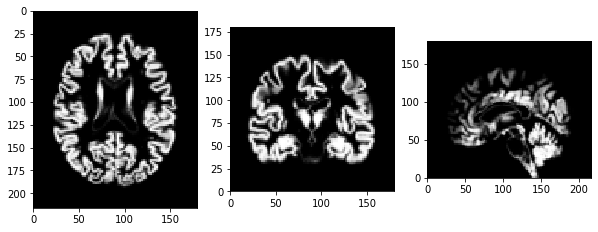

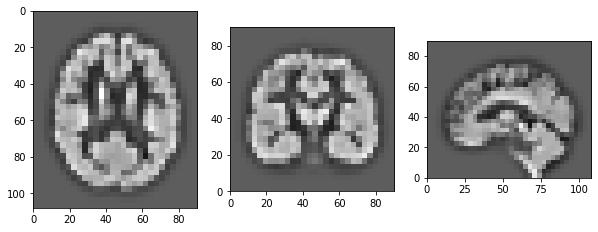

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8476550569195738 set 2 0.855659876021829 avg 0.8516574664707014
svm set 1 0.6392461373813836 set 2 0.5872822431320772 avg 0.6132641902567304
mlp set 1 -0.5224787520774659 set 2 -0.3527881517736273 avg -0.4376334519255466
Average set 1 0.3214741474078305 set 2 0.3633846557934263 total 0.3424294016006284
Visualisation of Preprocessing:


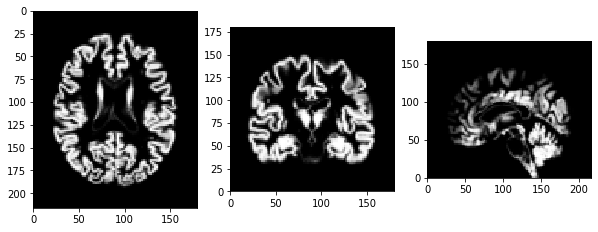

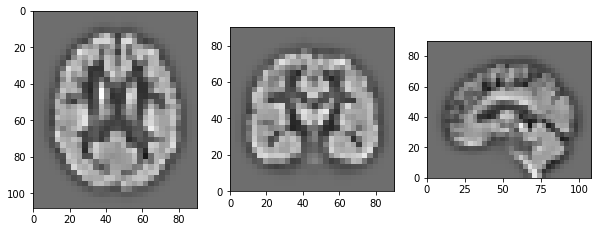

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.856191939324334 set 2 0.8273898614199925 avg 0.8417909003721633
svm set 1 0.6906878151018632 set 2 0.6784848240334783 avg 0.6845863195676707
mlp set 1 0.3145076827780158 set 2 0.27963636961398686 avg 0.2970720261960013
Average set 1 0.620462479068071 set 2 0.5951703516891526 total 0.6078164153786118
Visualisation of Preprocessing:


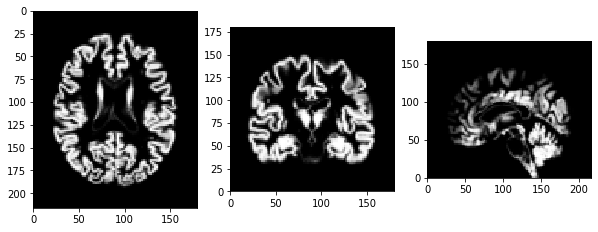

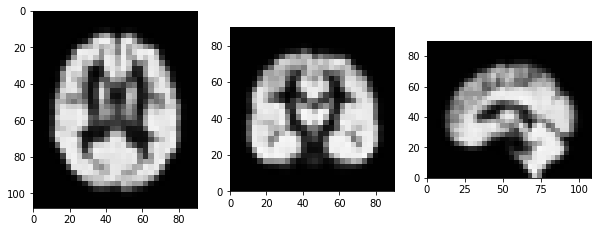

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8608640866834023 set 2 0.8780364682533229 avg 0.8694502774683626
svm set 1 0.6886549947903364 set 2 0.6593766470713447 avg 0.6740158209308406
mlp set 1 0.06971852181923344 set 2 0.25215519866681235 avg 0.1609368602430229
Average set 1 0.539745867764324 set 2 0.5965227713304934 total 0.5681343195474087
Visualisation of Preprocessing:


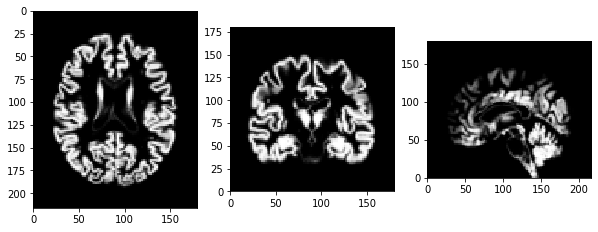

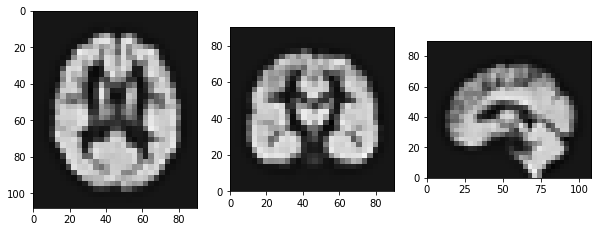

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8856940907375331 set 2 0.838425016887861 avg 0.862059553812697
svm set 1 0.6942801560739913 set 2 0.6517588222407367 avg 0.673019489157364
mlp set 1 0.13886918292015238 set 2 -0.11087120359870162 avg 0.01399898966072538
Average set 1 0.572947809910559 set 2 0.4597708785099654 total 0.5163593442102622
Visualisation of Preprocessing:


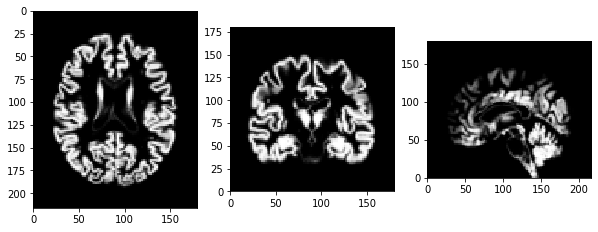

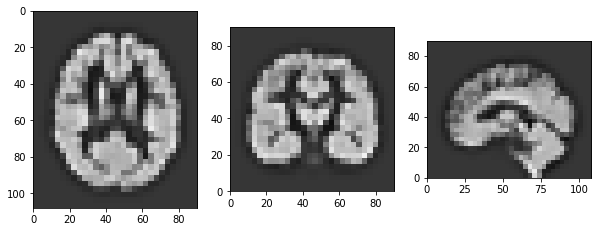

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.856783408989438 set 2 0.8551658877232822 avg 0.8559746483563601
svm set 1 0.6824923735080402 set 2 0.6856781148219093 avg 0.6840852441649747
mlp set 1 0.19888160451407502 set 2 0.24917163911992435 avg 0.22402662181699967
Average set 1 0.5793857956705177 set 2 0.5966718805550386 total 0.5880288381127782
Visualisation of Preprocessing:


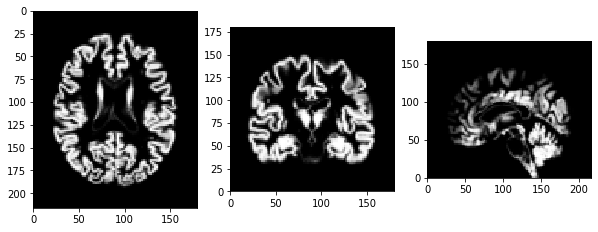

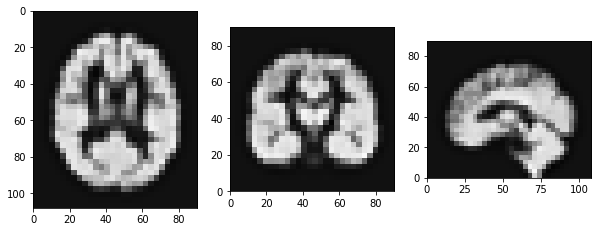

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8588181846798174 set 2 0.8816143911258103 avg 0.8702162879028139
svm set 1 0.6754092391429499 set 2 0.6903292032604705 avg 0.6828692212017102
mlp set 1 0.06570073835945012 set 2 0.16945272252151067 avg 0.11757673044048039
Average set 1 0.5333093873940725 set 2 0.5804654389692638 total 0.5568874131816681
Visualisation of Preprocessing:


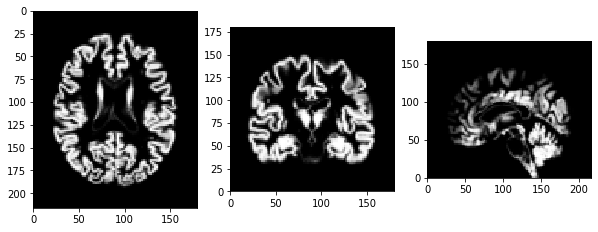

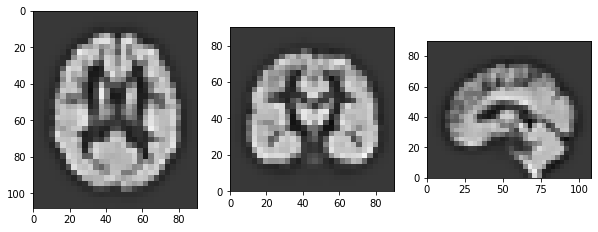

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.85926549781344 set 2 0.8365131120064129 avg 0.8478893049099264
svm set 1 0.662315881965821 set 2 0.6858525946993372 avg 0.6740842383325791
mlp set 1 0.027500673860379465 set 2 -0.1163755425204589 avg -0.044437434330039716
Average set 1 0.5163606845465468 set 2 0.4686633880617637 total 0.4925120363041553
Visualisation of Preprocessing:


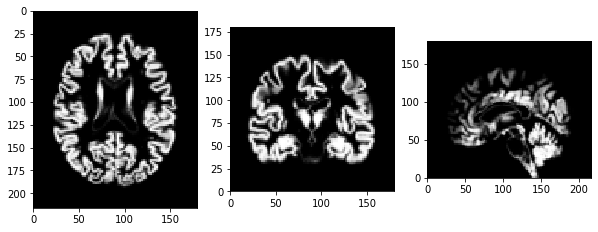

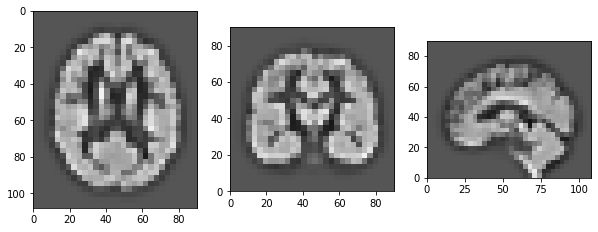

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.865532492025489 set 2 0.8503264176919935 avg 0.8579294548587413
svm set 1 0.6869261379977216 set 2 0.6918543374289706 avg 0.6893902377133461
mlp set 1 0.1604885651252117 set 2 0.0008192943285235676 avg 0.08065392972686763
Average set 1 0.5709823983828074 set 2 0.5143333498164959 total 0.5426578740996517
Visualisation of Preprocessing:


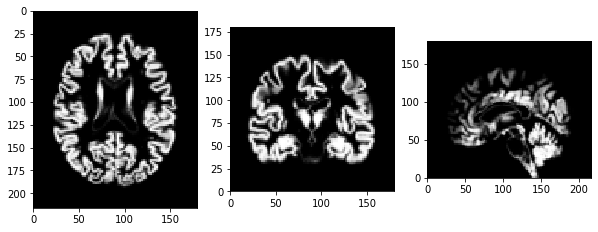

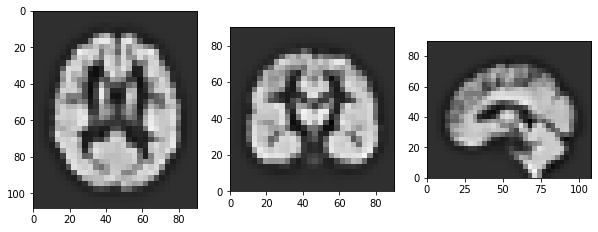

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8478863508975797 set 2 0.8546370299603991 avg 0.8512616904289894
svm set 1 0.6799036747588387 set 2 0.6854612279840844 avg 0.6826824513714616
mlp set 1 0.005752732550107997 set 2 0.02418917474896598 avg 0.014970953649536989
Average set 1 0.5111809194021754 set 2 0.5214291442311498 total 0.5163050318166627
Visualisation of Preprocessing:


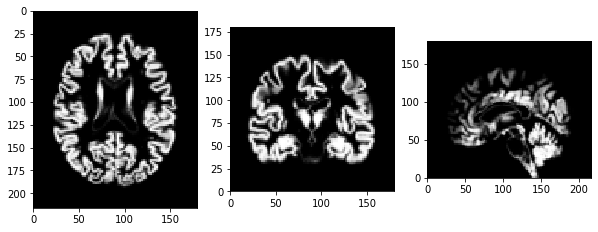

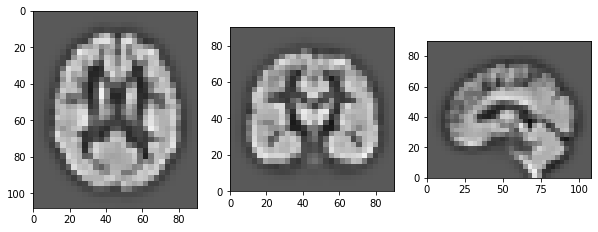

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8621789541934407 set 2 0.8519703752441515 avg 0.8570746647187961
svm set 1 0.6687757247829582 set 2 0.6553281405760327 avg 0.6620519326794955
mlp set 1 -0.16834157742957734 set 2 -0.23167680302806604 avg -0.2000091902288217
Average set 1 0.4542043671822739 set 2 0.4252072375973728 total 0.4397058023898234
Visualisation of Preprocessing:


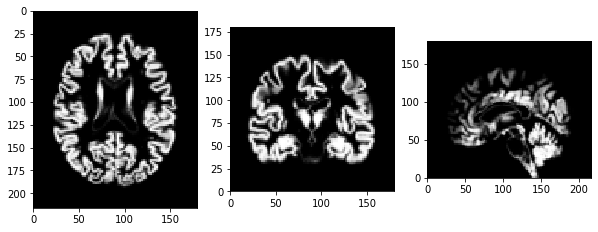

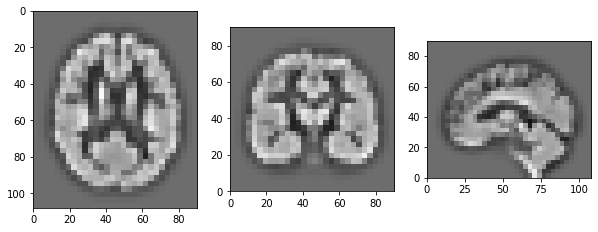

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8103520740161106 set 2 0.813379309330265 avg 0.8118656916731879
svm set 1 0.681673176002629 set 2 0.6991139815899798 avg 0.6903935787963045


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.6882364272369466 set 2 0.7107609390696048 avg 0.6994986831532757
Average set 1 0.726753892418562 set 2 0.7410847433299499 total 0.733919317874256
Visualisation of Preprocessing:


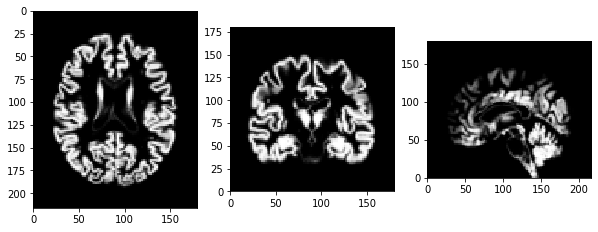

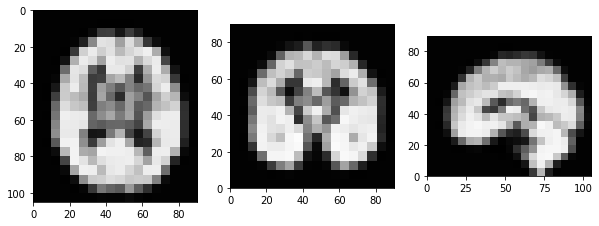

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8665890443035397 set 2 0.7987517343117276 avg 0.8326703893076337
svm set 1 0.707105298901443 set 2 0.6798435822777307 avg 0.6934744405895868
mlp set 1 0.6858422797289718 set 2 0.5839536603951332 avg 0.6348979700620525
Average set 1 0.7531788743113182 set 2 0.6875163256615305 total 0.7203475999864244
Visualisation of Preprocessing:


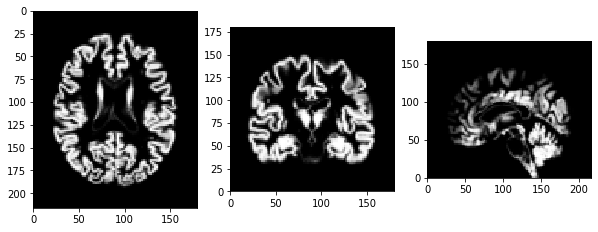

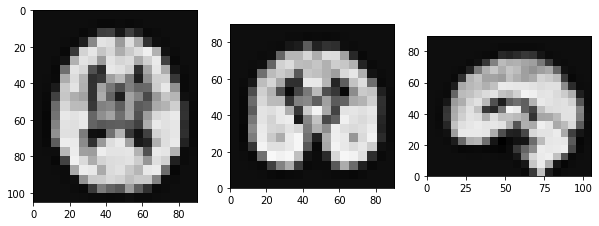

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8512643354653582 set 2 0.8528675142883105 avg 0.8520659248768343
svm set 1 0.6936162339406557 set 2 0.6778062419978241 avg 0.6857112379692399
mlp set 1 0.5021784305971504 set 2 0.5981313638522131 avg 0.5501548972246817
Average set 1 0.6823530000010548 set 2 0.7096017067127827 total 0.6959773533569187
Visualisation of Preprocessing:


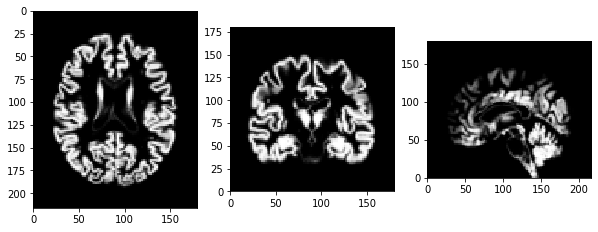

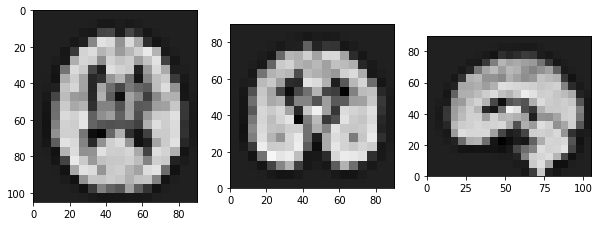

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8278923367160578 set 2 0.8530993870598742 avg 0.840495861887966
svm set 1 0.6777520649735937 set 2 0.7061451256877933 avg 0.6919485953306935
mlp set 1 0.6707627725135616 set 2 0.6646197726455532 avg 0.6676912725795574
Average set 1 0.7254690580677376 set 2 0.7412880951310736 total 0.7333785765994056
Visualisation of Preprocessing:


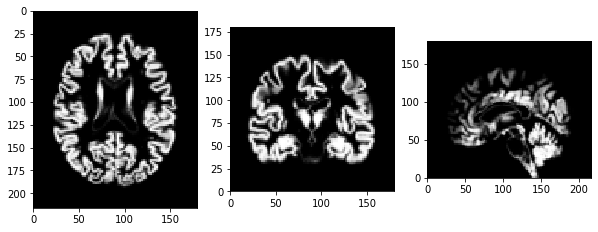

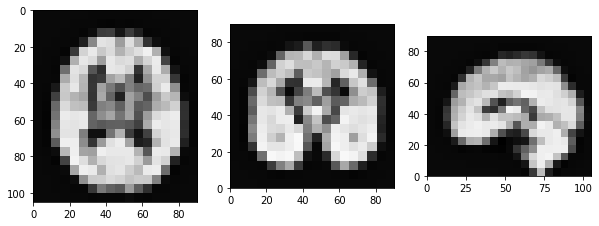

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8396278378768085 set 2 0.836702141373364 avg 0.8381649896250862
svm set 1 0.6750755071531956 set 2 0.7190476873544958 avg 0.6970615972538456
mlp set 1 0.634348853103466 set 2 0.5599520295623057 avg 0.5971504413328859
Average set 1 0.7163507327111566 set 2 0.7052339527633885 total 0.7107923427372725
Visualisation of Preprocessing:


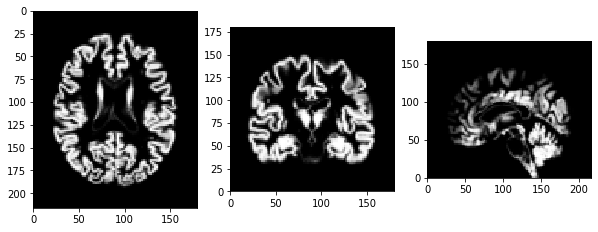

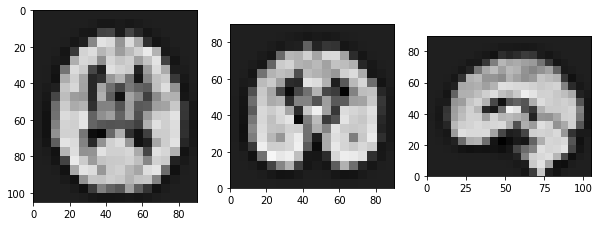

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8524007772554334 set 2 0.860953391634561 avg 0.8566770844449971
svm set 1 0.698672476268287 set 2 0.7108292545484216 avg 0.7047508654083543
mlp set 1 0.48672264492470996 set 2 0.46921507656961486 avg 0.4779688607471624
Average set 1 0.6792652994828101 set 2 0.6803325742508658 total 0.679798936866838
Visualisation of Preprocessing:


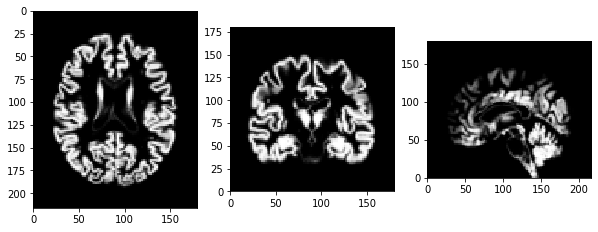

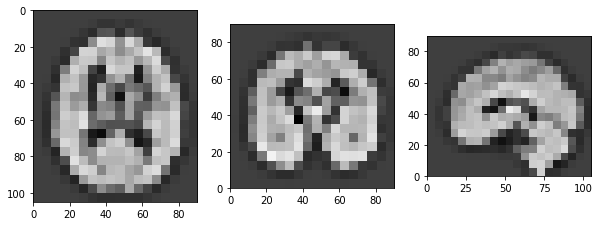

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8465527695476679 set 2 0.8479470549382487 avg 0.8472499122429583
svm set 1 0.6964055261623119 set 2 0.6991716359186364 avg 0.6977885810404741
mlp set 1 0.6277398403815477 set 2 0.5518820582089301 avg 0.5898109492952389
Average set 1 0.7235660453638424 set 2 0.6996669163552718 total 0.7116164808595571
Visualisation of Preprocessing:


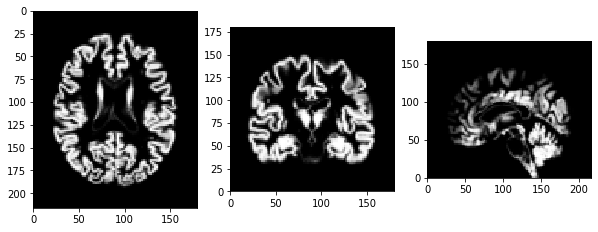

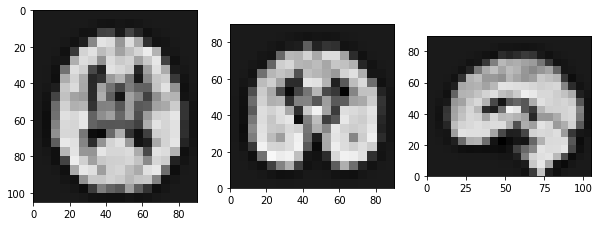

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8442780735631962 set 2 0.8415849925680295 avg 0.8429315330656129
svm set 1 0.7172079869605323 set 2 0.6957592412992966 avg 0.7064836141299145
mlp set 1 0.4987015804332312 set 2 0.4242550093510649 avg 0.4614782948921481
Average set 1 0.68672921365232 set 2 0.6538664144061302 total 0.6702978140292251
Visualisation of Preprocessing:


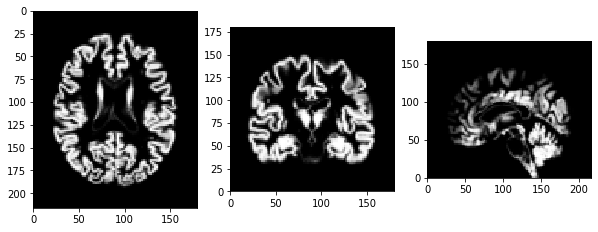

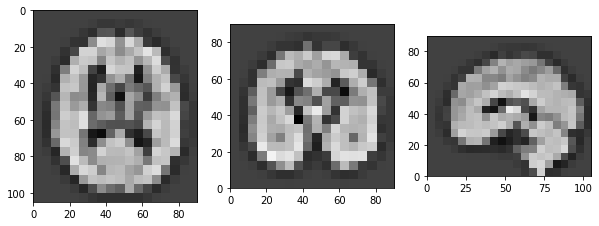

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8652729361715971 set 2 0.8425718048645433 avg 0.8539223705180702
svm set 1 0.6895491213925202 set 2 0.7147843580488119 avg 0.7021667397206661
mlp set 1 0.43008958085774335 set 2 0.39058892967482817 avg 0.4103392552662858
Average set 1 0.6616372128072868 set 2 0.6493150308627278 total 0.6554761218350074
Visualisation of Preprocessing:


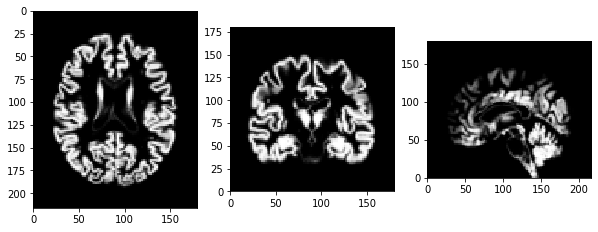

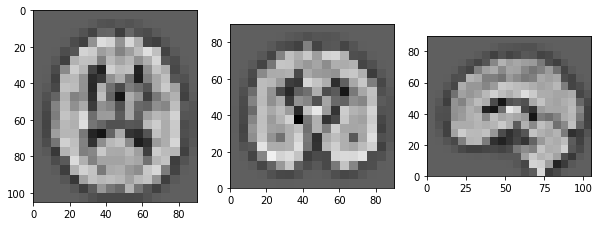

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8437061002001847 set 2 0.7777663423946614 avg 0.810736221297423
svm set 1 0.6908704148504051 set 2 0.6881531103862663 avg 0.6895117626183357


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.7029748570843126 set 2 0.701042416582449 avg 0.7020086368333809
Average set 1 0.7458504573783008 set 2 0.7223206231211255 total 0.7340855402497132
Visualisation of Preprocessing:


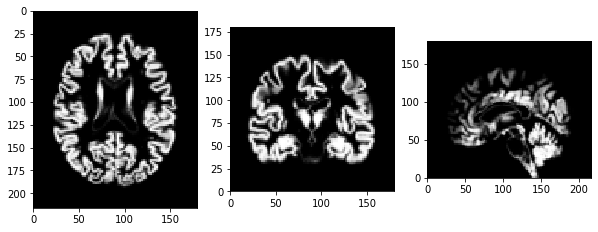

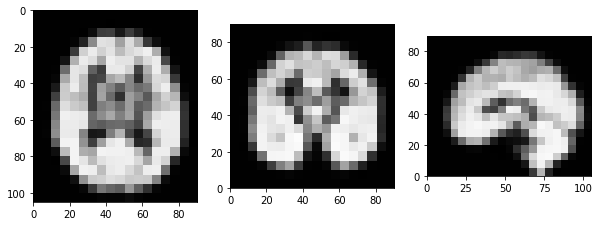

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8358817065248654 set 2 0.829682530074903 avg 0.8327821182998842
svm set 1 0.6914318824170382 set 2 0.6967864331578743 avg 0.6941091577874563


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.7030069016557409 set 2 0.6893072975432821 avg 0.6961570995995114
Average set 1 0.7434401635325482 set 2 0.7385920869253532 total 0.7410161252289507
Visualisation of Preprocessing:


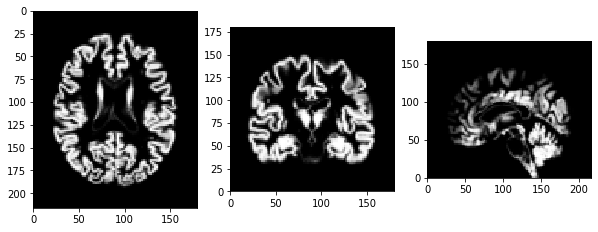

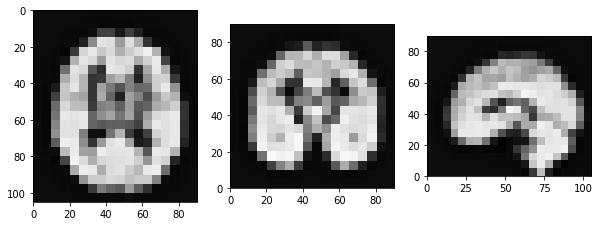

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8438063106598193 set 2 0.8401659342852831 avg 0.8419861224725511
svm set 1 0.6916252343268139 set 2 0.7135020300809183 avg 0.7025636322038661
mlp set 1 0.5629003539710442 set 2 0.5762733431062456 avg 0.5695868485386448
Average set 1 0.6994439663192257 set 2 0.709980435824149 total 0.7047122010716873
Visualisation of Preprocessing:


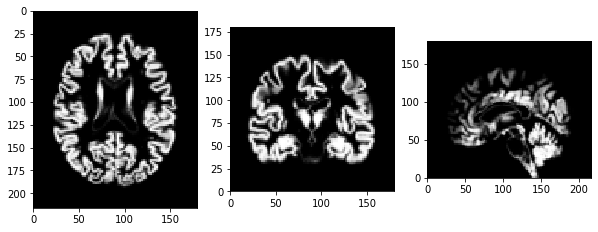

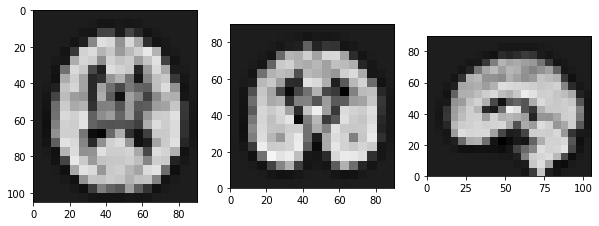

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8194169472414393 set 2 0.8106538544859662 avg 0.8150354008637027
svm set 1 0.6815811493528467 set 2 0.7150782837752647 avg 0.6983297165640557


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.742404036640835 set 2 0.6767618548495564 avg 0.7095829457451956
Average set 1 0.7478007110783736 set 2 0.7341646643702625 total 0.7409826877243181
Visualisation of Preprocessing:


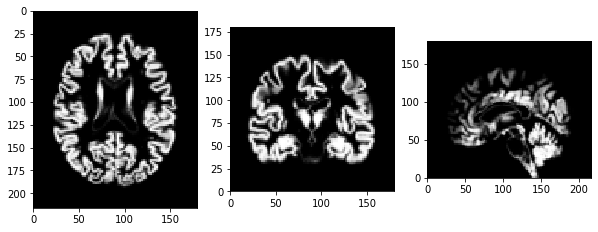

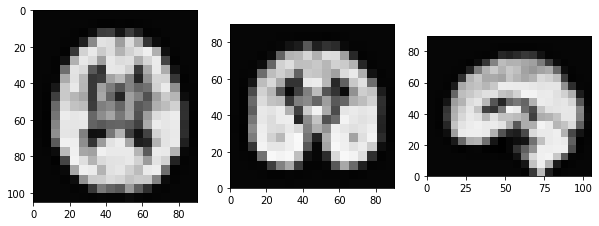

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8406665948894159 set 2 0.8523152858066253 avg 0.8464909403480205
svm set 1 0.6918057537320399 set 2 0.7258191235690941 avg 0.708812438650567
mlp set 1 0.6274009848091057 set 2 0.6550530480467502 avg 0.6412270164279279
Average set 1 0.7199577778101872 set 2 0.7443958191408232 total 0.7321767984755052
Visualisation of Preprocessing:


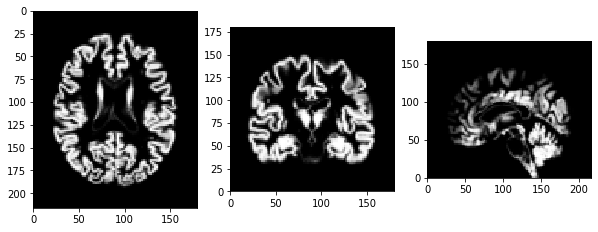

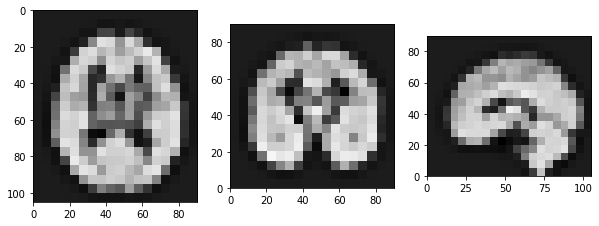

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8543091098658561 set 2 0.8585051915808993 avg 0.8564071507233777
svm set 1 0.6981848659446797 set 2 0.7208712266025588 avg 0.7095280462736192
mlp set 1 0.5197490737837306 set 2 0.4759206046682102 avg 0.4978348392259704
Average set 1 0.6907476831980888 set 2 0.6850990076172226 total 0.6879233454076557
Visualisation of Preprocessing:


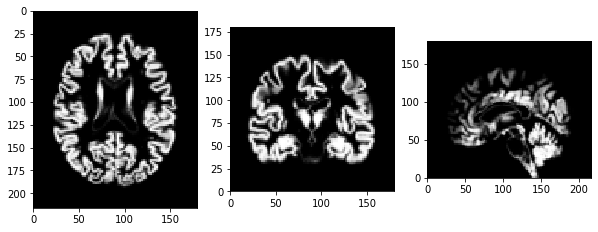

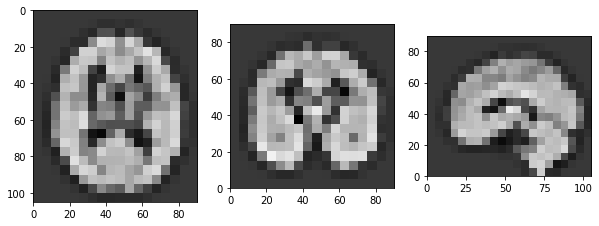

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8484059835778855 set 2 0.8403433592231474 avg 0.8443746714005165
svm set 1 0.7235538003000148 set 2 0.6793034507926902 avg 0.7014286255463524
mlp set 1 0.6244080462082457 set 2 0.7050114606791064 avg 0.6647097534436761
Average set 1 0.7321226100287154 set 2 0.7415527568983147 total 0.7368376834635151
Visualisation of Preprocessing:


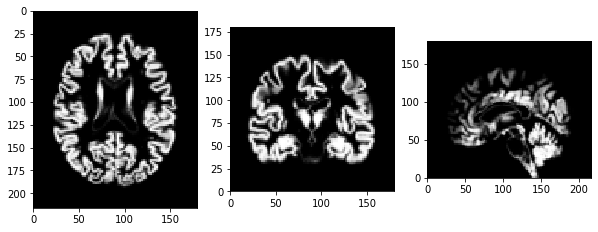

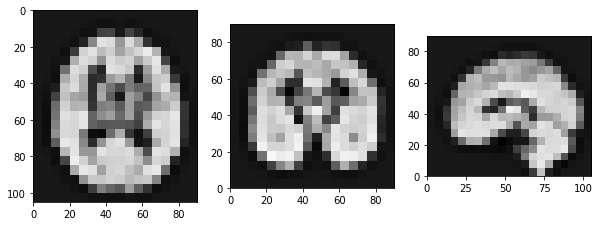

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.872638670602121 set 2 0.8425325332691046 avg 0.8575856019356127
svm set 1 0.7048254514684351 set 2 0.7084101572565799 avg 0.7066178043625075
mlp set 1 0.47164207682169845 set 2 0.5497587329101824 avg 0.5107004048659405
Average set 1 0.6830353996307515 set 2 0.7002338078119555 total 0.6916346037213535
Visualisation of Preprocessing:


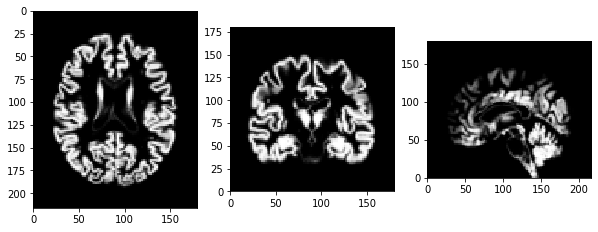

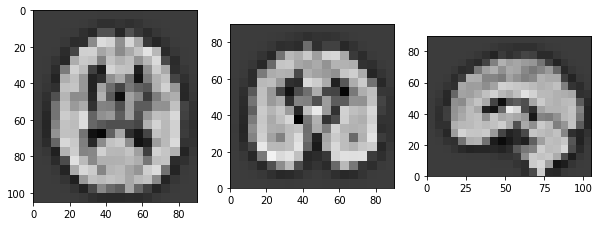

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.836358265740012 set 2 0.8513248341901221 avg 0.8438415499650671
svm set 1 0.7031223004161103 set 2 0.6913770626567757 avg 0.6972496815364431
mlp set 1 0.39590528419668025 set 2 0.3695157573824286 avg 0.3827105207895544
Average set 1 0.6451286167842675 set 2 0.6374058847431088 total 0.6412672507636881
Visualisation of Preprocessing:


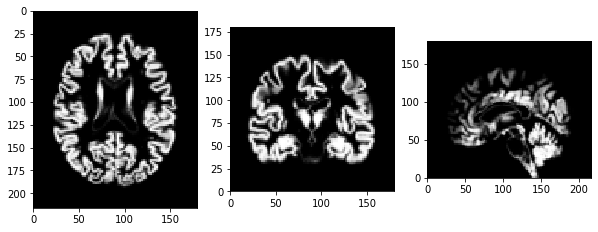

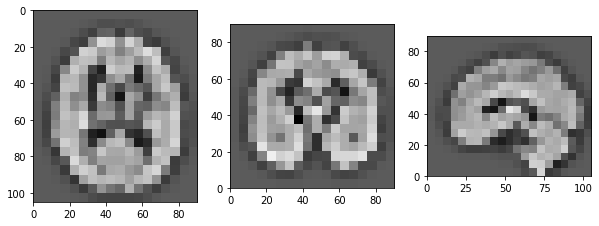

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.784553007284604 set 2 0.8275583425884095 avg 0.8060556749365068
svm set 1 0.6690342284873388 set 2 0.6649329853815706 avg 0.6669836069344548


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.5914941857151644 set 2 0.7541153264170934 avg 0.672804756066129
Average set 1 0.681693807162369 set 2 0.7488688847956912 total 0.7152813459790301
Visualisation of Preprocessing:


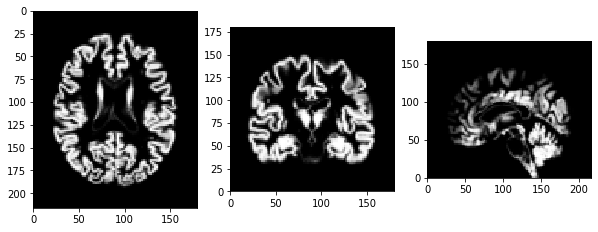

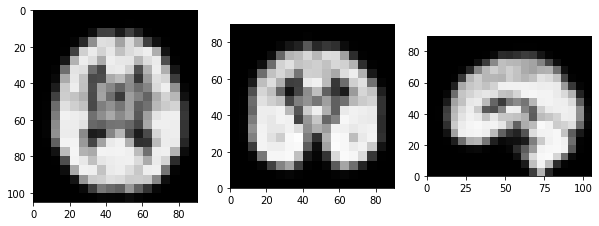

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8383042626266863 set 2 0.8182936122018899 avg 0.8282989374142882
svm set 1 0.6986610079231517 set 2 0.6708879751825912 avg 0.6847744915528715


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.6389901399557023 set 2 0.7224112381878585 avg 0.6807006890717804
Average set 1 0.7253184701685135 set 2 0.7371976085241133 total 0.7312580393463134
Visualisation of Preprocessing:


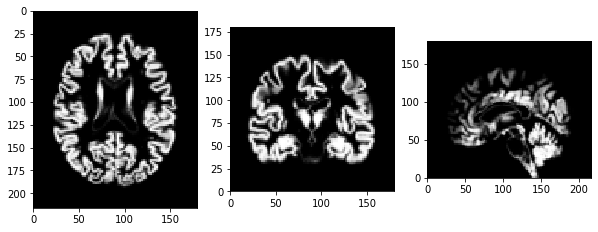

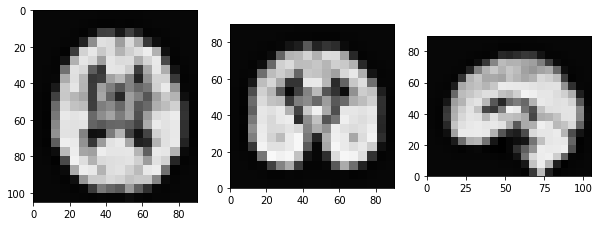

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8274881771642818 set 2 0.8455195476549582 avg 0.8365038624096199
svm set 1 0.7072466105460428 set 2 0.7068249670988211 avg 0.7070357888224319
mlp set 1 0.6606558792628676 set 2 0.6219979881923922 avg 0.6413269337276299
Average set 1 0.731796888991064 set 2 0.7247808343153905 total 0.7282888616532273
Visualisation of Preprocessing:


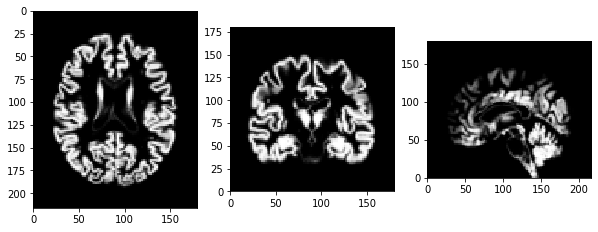

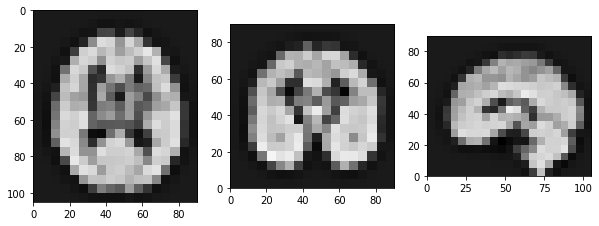

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8055612090280777 set 2 0.8226860996240868 avg 0.8141236543260822
svm set 1 0.695258428716477 set 2 0.7044259571670981 avg 0.6998421929417875


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.6874187223237125 set 2 0.7593102747327201 avg 0.7233644985282163
Average set 1 0.7294127866894224 set 2 0.762140777174635 total 0.7457767819320287
Visualisation of Preprocessing:


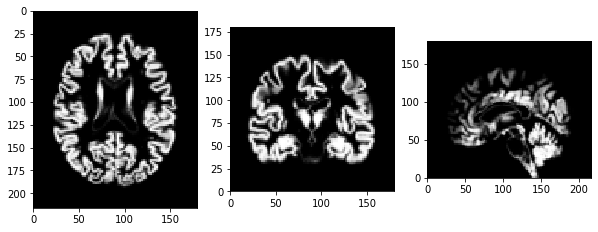

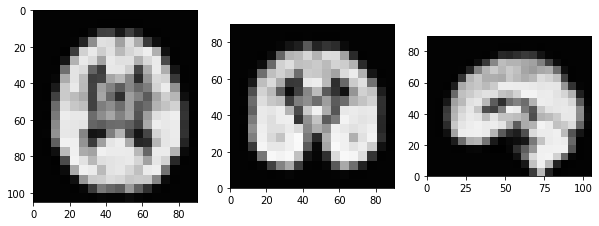

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8097163890713751 set 2 0.858438383692648 avg 0.8340773863820116
svm set 1 0.6903796610711181 set 2 0.7090594772055132 avg 0.6997195691383157
mlp set 1 0.6131567323289794 set 2 0.6893796886466925 avg 0.651268210487836
Average set 1 0.7044175941571575 set 2 0.7522925165149511 total 0.7283550553360543
Visualisation of Preprocessing:


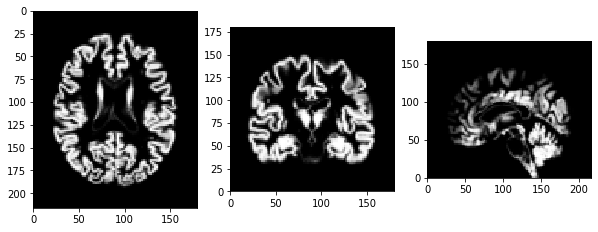

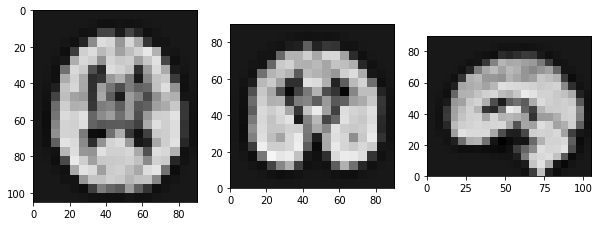

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8347086817582101 set 2 0.8542743063901896 avg 0.8444914940741999
svm set 1 0.6856242339951555 set 2 0.7189478763448647 avg 0.7022860551700101
mlp set 1 0.4977651925953591 set 2 0.5741764189947204 avg 0.5359708057950398
Average set 1 0.672699369449575 set 2 0.7157995339099249 total 0.6942494516797499
Visualisation of Preprocessing:


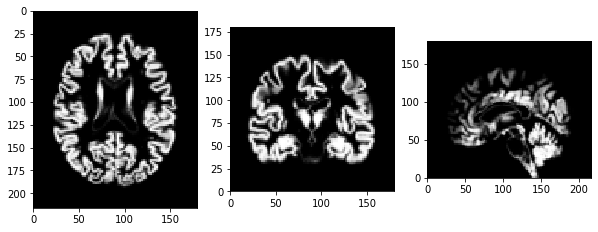

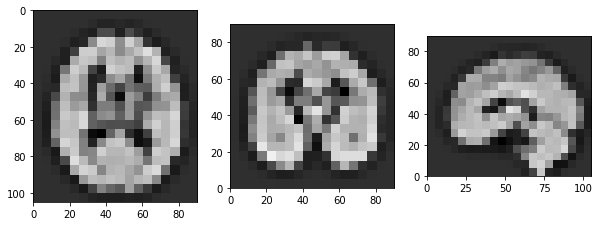

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8412085213179523 set 2 0.8188305512216553 avg 0.8300195362698037
svm set 1 0.705060246964865 set 2 0.7070354918839103 avg 0.7060478694243877
mlp set 1 0.6772591396512311 set 2 0.6029214637285747 avg 0.6400903016899029
Average set 1 0.7411759693113495 set 2 0.70959583561138 total 0.7253859024613647
Visualisation of Preprocessing:


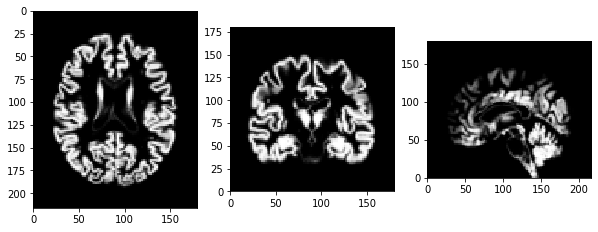

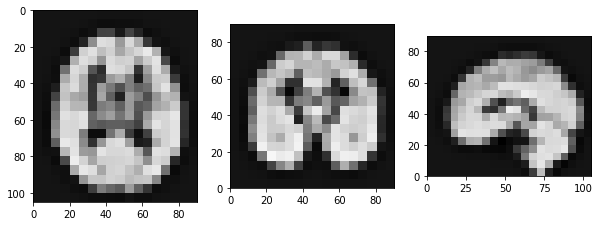

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8658810180956709 set 2 0.8476245601027619 avg 0.8567527890992164
svm set 1 0.7083412945270644 set 2 0.7104720304098581 avg 0.7094066624684612
mlp set 1 0.5627097813411801 set 2 0.5043809335889209 avg 0.5335453574650505
Average set 1 0.7123106979879719 set 2 0.6874925080338471 total 0.6999016030109095
Visualisation of Preprocessing:


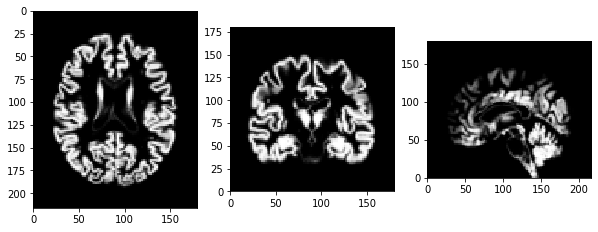

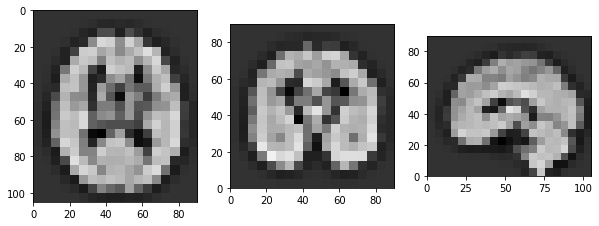

(operation 1) Gamma Corretion (gamma=1 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8591910305863631 set 2 0.8616351486781566 avg 0.8604130896322599
svm set 1 0.7012418927189806 set 2 0.7256054932043846 avg 0.7134236929616826
mlp set 1 0.41472859192261324 set 2 0.543568279421847 avg 0.47914843567223014
Average set 1 0.6583871717426524 set 2 0.7102696404347961 total 0.6843284060887243
Visualisation of Preprocessing:


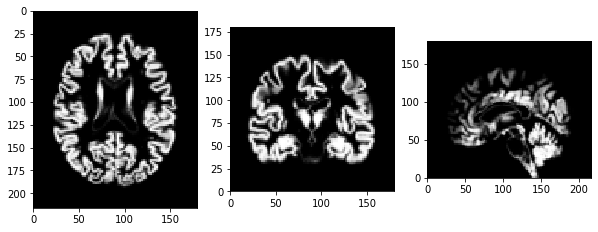

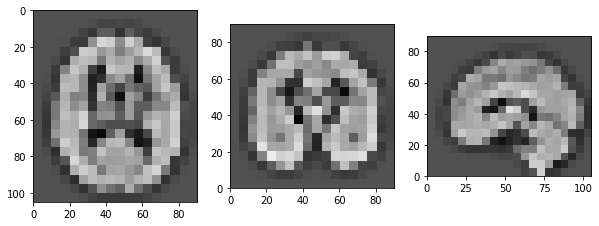

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.848773655099392 set 2 0.8516078719924365 avg 0.8501907635459143
svm set 1 0.5583649068729375 set 2 0.576569880963187 avg 0.5674673939180622
mlp set 1 -0.962004074471526 set 2 -1.3362301509783086 avg -1.1491171127249173
Average set 1 0.14837816250026778 set 2 0.030649200659104963 total 0.08951368157968637
Visualisation of Preprocessing:


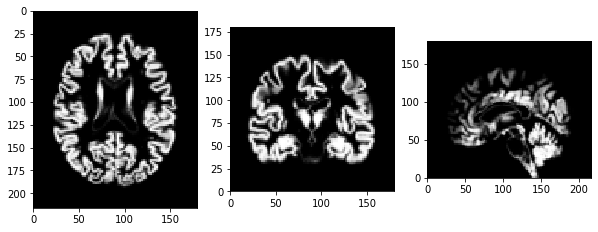

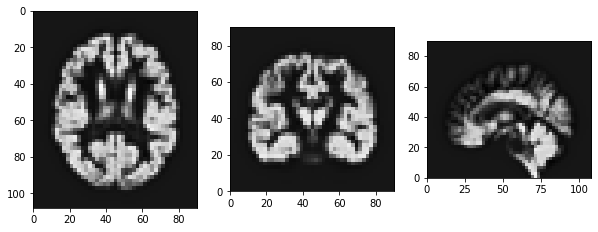

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8438198626249666 set 2 0.8482746196041555 avg 0.846047241114561
svm set 1 0.4728797646665532 set 2 0.5086851607316063 avg 0.49078246269907977
mlp set 1 -1.5706282980238915 set 2 -1.7485921675521165 avg -1.659610232788004
Average set 1 -0.08464289024412393 set 2 -0.13054412907211824 total -0.10759350965812109
Visualisation of Preprocessing:


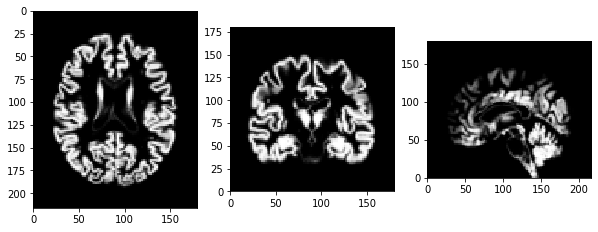

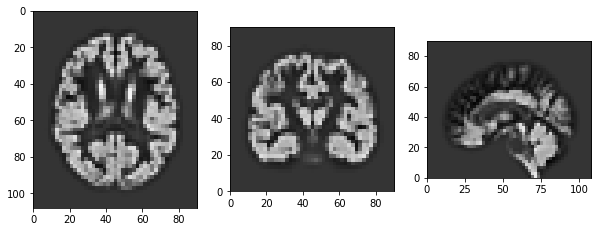

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8159187516543236 set 2 0.8462603738199137 avg 0.8310895627371186
svm set 1 0.3755541822335079 set 2 0.43592911601786793 avg 0.4057416491256879
mlp set 1 -2.2286032094661343 set 2 -1.991067546113774 avg -2.1098353777899543
Average set 1 -0.34571009185943424 set 2 -0.23629268542533075 total -0.2910013886423825
Visualisation of Preprocessing:


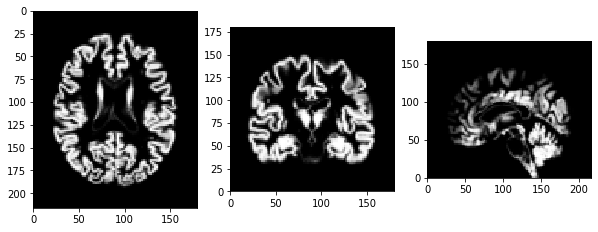

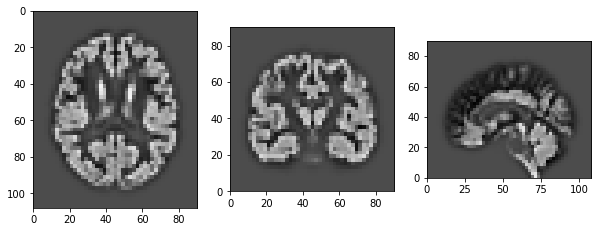

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.844114366981982 set 2 0.84612091495159 avg 0.845117640966786
svm set 1 0.5302110325263397 set 2 0.5192981936763732 avg 0.5247546131013565
mlp set 1 -1.2084859427552122 set 2 -1.2613036913406939 avg -1.234894817047953
Average set 1 0.055279818917703206 set 2 0.034705139095756454 total 0.04499247900672983
Visualisation of Preprocessing:


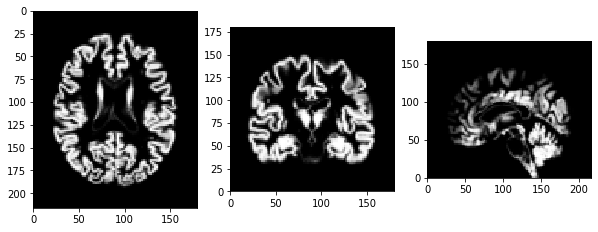

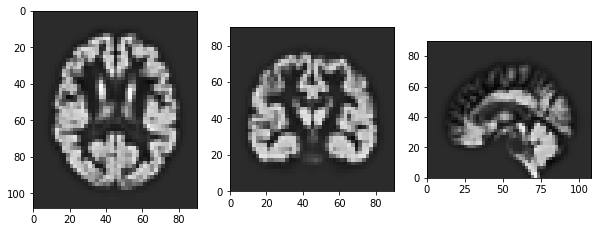

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8282622489746364 set 2 0.8320700208964462 avg 0.8301661349355414
svm set 1 0.4271138216041085 set 2 0.4806366313290805 avg 0.4538752264665945
mlp set 1 -1.6412985773369322 set 2 -1.9979057749235152 avg -1.8196021761302237
Average set 1 -0.12864083558606243 set 2 -0.22839970756599612 total -0.1785202715760293
Visualisation of Preprocessing:


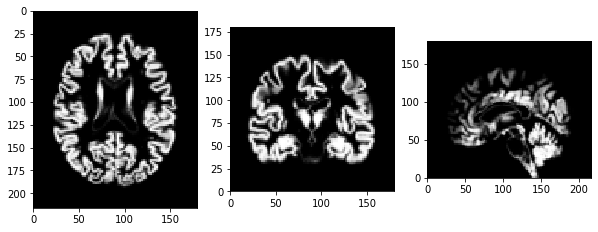

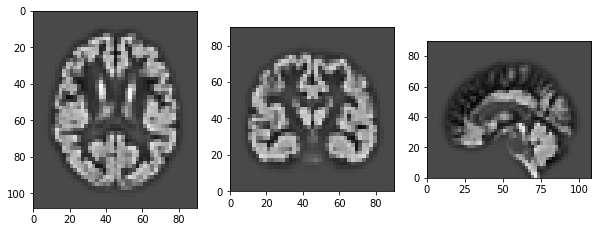

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8374438663950544 set 2 0.833877653545498 avg 0.8356607599702762
svm set 1 0.3986934005088812 set 2 0.4031883316164529 avg 0.40094086606266705
mlp set 1 -1.9889820831984355 set 2 -2.3236201315477922 avg -2.156301107373114
Average set 1 -0.2509482720981666 set 2 -0.3621847154619471 total -0.30656649378005685
Visualisation of Preprocessing:


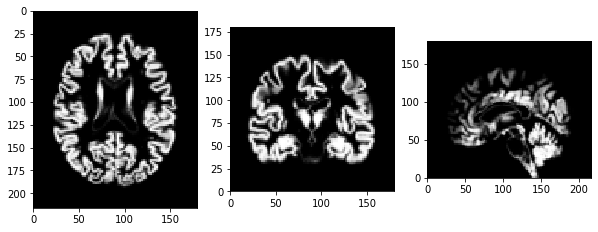

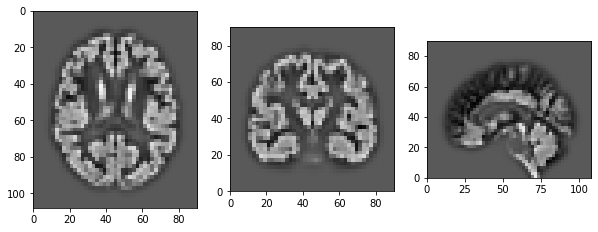

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.849356061999403 set 2 0.8369699310454335 avg 0.8431629965224182
svm set 1 0.5086607872058342 set 2 0.5367469567769709 avg 0.5227038719914026
mlp set 1 -1.1160553275368357 set 2 -1.5259702192324966 avg -1.3210127733846662
Average set 1 0.08065384055613382 set 2 -0.050751110470030746 total 0.01495136504305154
Visualisation of Preprocessing:


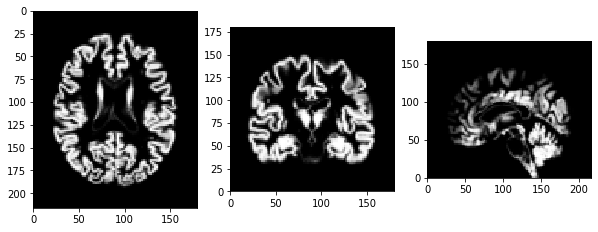

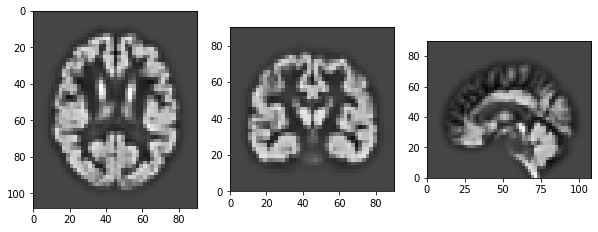

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8177007401743386 set 2 0.8470476528244651 avg 0.8323741964994018
svm set 1 0.43673585057255854 set 2 0.47280660860301144 avg 0.454771229587785
mlp set 1 -1.6980449128135027 set 2 -1.7319423505180112 avg -1.7149936316657568
Average set 1 -0.14786944068886854 set 2 -0.1373626963635115 total -0.14261606852619002
Visualisation of Preprocessing:


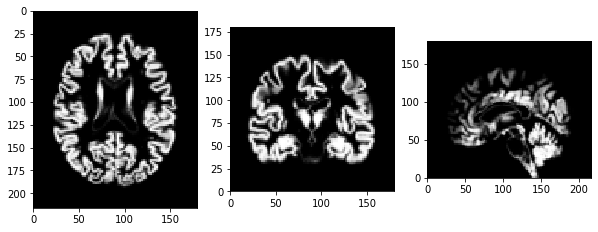

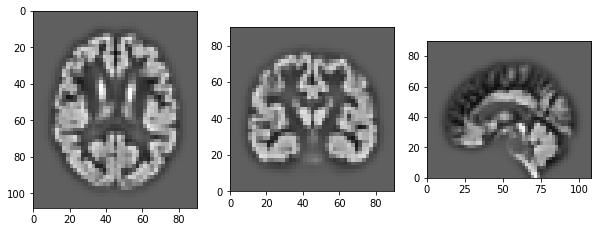

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8396269021812843 set 2 0.8078103389857718 avg 0.8237186205835281
svm set 1 0.4315737685027738 set 2 0.4043341849199255 avg 0.41795397671134965
mlp set 1 -2.1551668943762263 set 2 -1.8799048747249794 avg -2.017535884550603
Average set 1 -0.29465540789738937 set 2 -0.22258678360642734 total -0.25862109575190834
Visualisation of Preprocessing:


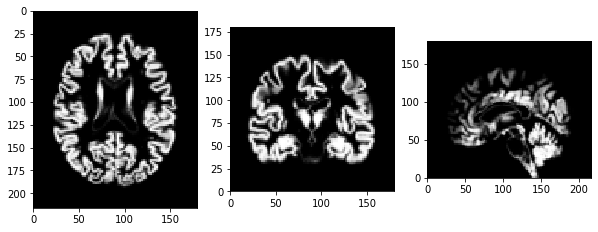

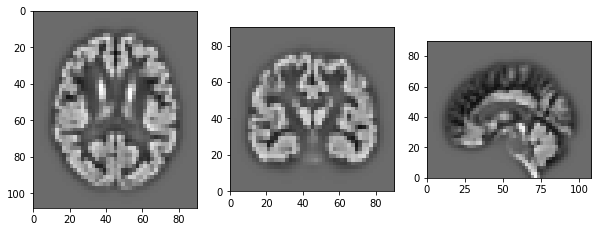

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.852888639025736 set 2 0.867960911310152 avg 0.8604247751679439
svm set 1 0.5767258158784552 set 2 0.5464704039625183 avg 0.5615981099204868
mlp set 1 -0.7481597618847313 set 2 -0.7999711370055691 avg -0.7740654494451502
Average set 1 0.22715156433981995 set 2 0.20482005942236703 total 0.2159858118810935
Visualisation of Preprocessing:


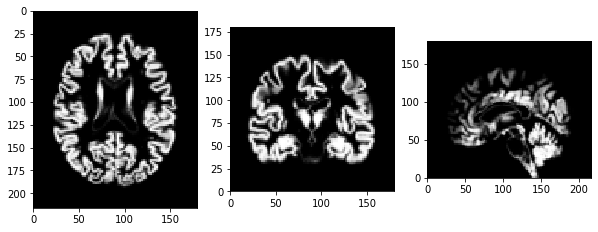

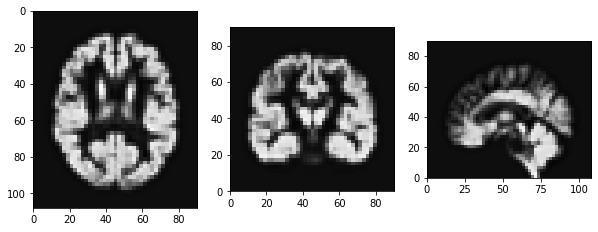

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8497301434500618 set 2 0.8374601341778112 avg 0.8435951388139364
svm set 1 0.49109070421751355 set 2 0.5364846646337298 avg 0.5137876844256217
mlp set 1 -1.1926774150064885 set 2 -1.3135695328773527 avg -1.2531234739419206
Average set 1 0.04938114422036229 set 2 0.020125088644729432 total 0.03475311643254586
Visualisation of Preprocessing:


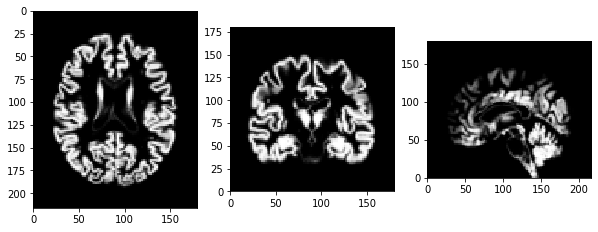

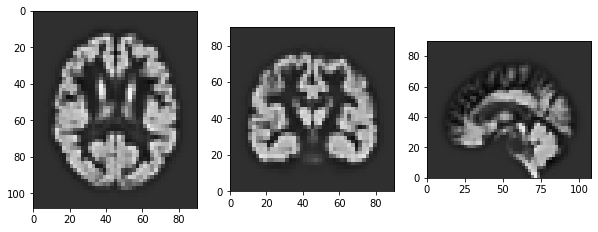

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8481156683306337 set 2 0.8277765206593825 avg 0.8379460944950081
svm set 1 0.44340294917891415 set 2 0.442818907184808 avg 0.44311092818186104
mlp set 1 -1.2833700049914203 set 2 -2.0489642836839046 avg -1.6661671443376624
Average set 1 0.0027162041727091988 set 2 -0.2594562852799047 total -0.12837004055359777
Visualisation of Preprocessing:


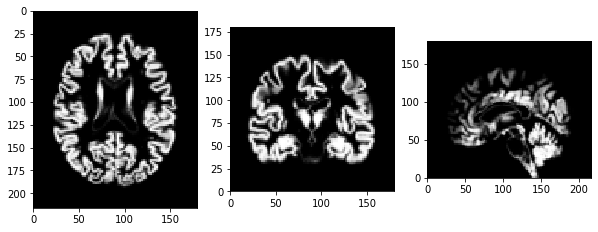

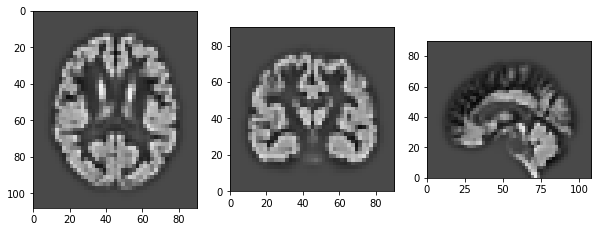

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8328656739675656 set 2 0.8550176370746854 avg 0.8439416555211254
svm set 1 0.5061552413898586 set 2 0.587162790404387 avg 0.5466590158971227
mlp set 1 -0.8395436799483907 set 2 -1.2736483669625387 avg -1.0565960234554648
Average set 1 0.16649241180301114 set 2 0.05617735350551123 total 0.11133488265426118
Visualisation of Preprocessing:


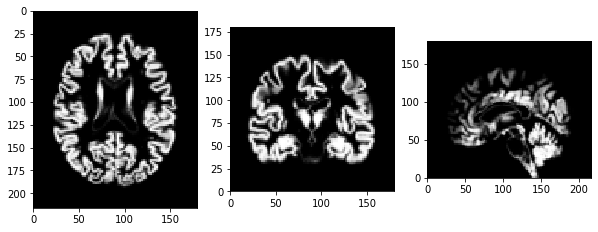

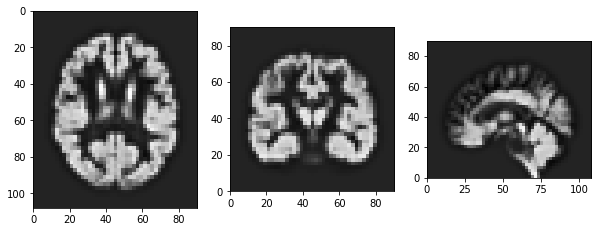

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8606550175436314 set 2 0.8244003322035411 avg 0.8425276748735863
svm set 1 0.4872223053221451 set 2 0.4359836084662262 avg 0.4616029568941856
mlp set 1 -1.5080736482927306 set 2 -1.5213929879517654 avg -1.514733318122248
Average set 1 -0.05339877514231802 set 2 -0.08700301576066598 total -0.070200895451492
Visualisation of Preprocessing:


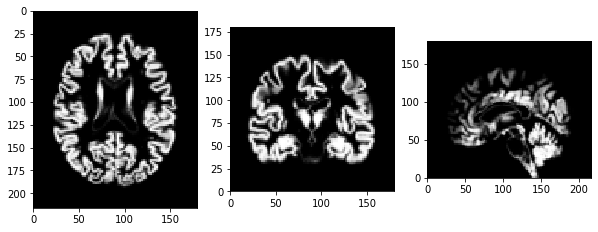

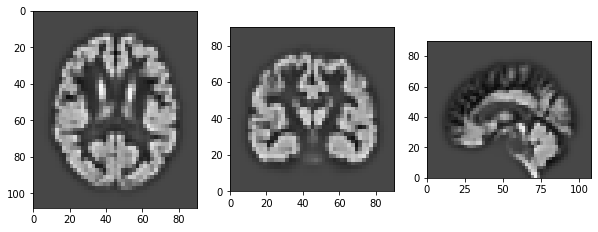

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8185670815706905 set 2 0.8534035161807078 avg 0.8359852988756991
svm set 1 0.40569266499954415 set 2 0.44142941302726546 avg 0.4235610390134048
mlp set 1 -1.8895617013548969 set 2 -1.9992564640003456 avg -1.9444090826776212
Average set 1 -0.22176731826155413 set 2 -0.2348078449307908 total -0.22828758159617246
Visualisation of Preprocessing:


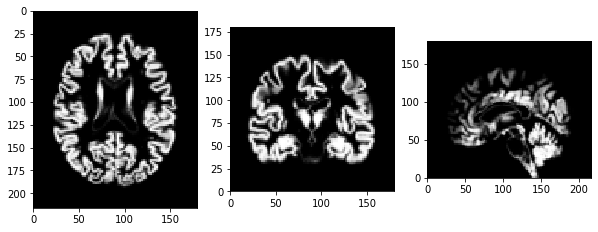

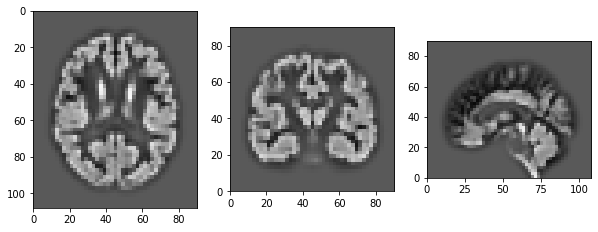

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8412173878802144 set 2 0.8570458659445892 avg 0.8491316269124018
svm set 1 0.4963120658073781 set 2 0.5549439893589287 avg 0.5256280275831534
mlp set 1 -0.9077657899895721 set 2 -1.1774382041974638 avg -1.0426019970935179
Average set 1 0.14325455456600675 set 2 0.07818388370201805 total 0.11071921913401239
Visualisation of Preprocessing:


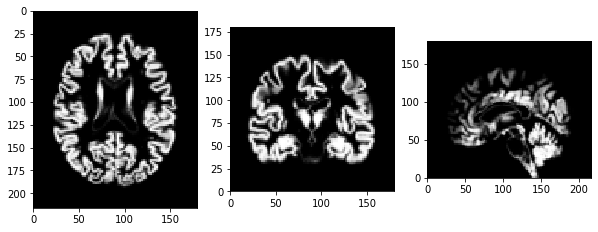

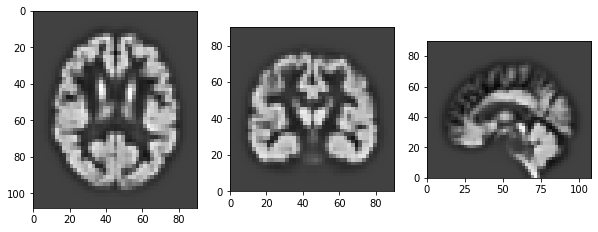

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8476105215091827 set 2 0.8335798849824936 avg 0.8405952032458381
svm set 1 0.46595703819670686 set 2 0.48447653685923237 avg 0.4752167875279696
mlp set 1 -1.061810146021525 set 2 -1.6116391108453803 avg -1.3367246284334526
Average set 1 0.08391913789478818 set 2 -0.09786089633455146 total -0.00697087921988164
Visualisation of Preprocessing:


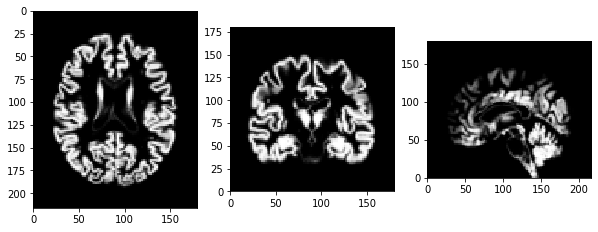

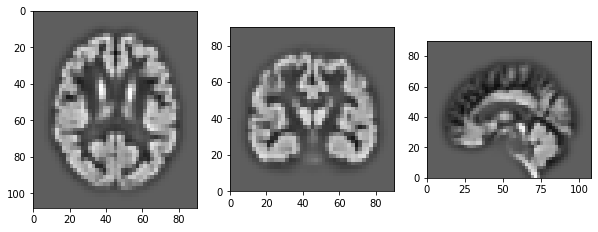

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8330570169860276 set 2 0.8436867887309019 avg 0.8383719028584647
svm set 1 0.4312837305097428 set 2 0.47099904122089553 avg 0.45114138586531916
mlp set 1 -1.5530616805488504 set 2 -1.9431183644308234 avg -1.748090022489837
Average set 1 -0.09624031101769333 set 2 -0.20947751149300867 total -0.152858911255351
Visualisation of Preprocessing:


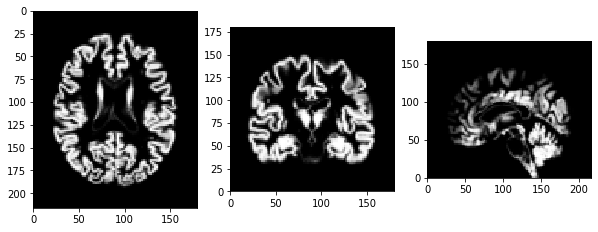

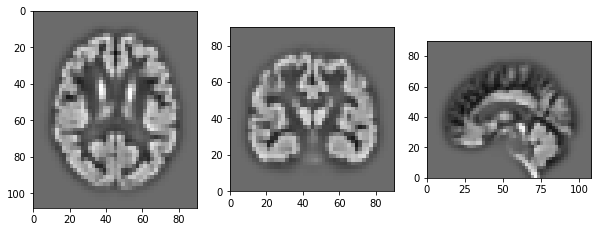

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8533601322443485 set 2 0.8429909090069776 avg 0.848175520625663
svm set 1 0.6179868535335924 set 2 0.6071672029726294 avg 0.6125770282531109
mlp set 1 -0.18100421757827 set 2 -0.32611009932036517 avg -0.2535571584493176
Average set 1 0.43011425606655695 set 2 0.37468267088641394 total 0.40239846347648545
Visualisation of Preprocessing:


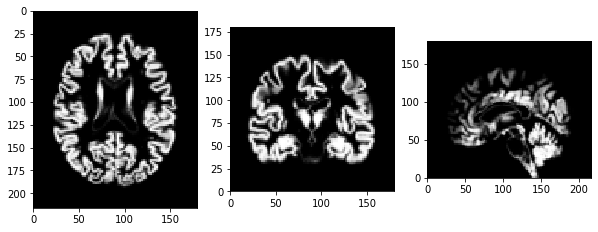

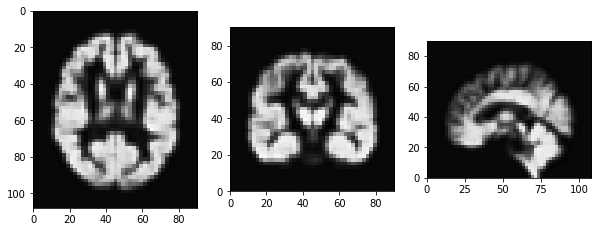

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8390053281363457 set 2 0.8694950891471841 avg 0.8542502086417649
svm set 1 0.5917236018189878 set 2 0.5733320367639344 avg 0.5825278192914611
mlp set 1 -0.6590806168707712 set 2 -0.5496717621465148 avg -0.604376189508643
Average set 1 0.2572161043615207 set 2 0.29771845458820123 total 0.27746727947486094
Visualisation of Preprocessing:


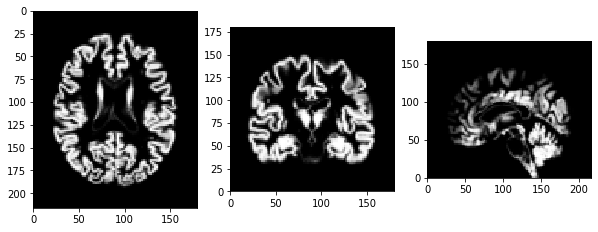

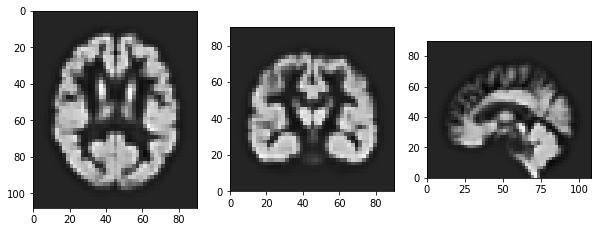

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8335013643005351 set 2 0.844885690220101 avg 0.839193527260318
svm set 1 0.5135853492326508 set 2 0.5449224072094914 avg 0.5292538782210711
mlp set 1 -1.0299875229247704 set 2 -1.1204237917788014 avg -1.0752056573517859
Average set 1 0.10569973020280517 set 2 0.08979476855026365 total 0.09774724937653441
Visualisation of Preprocessing:


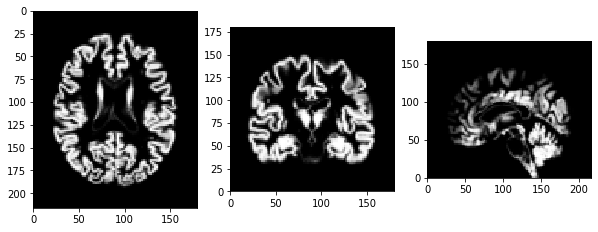

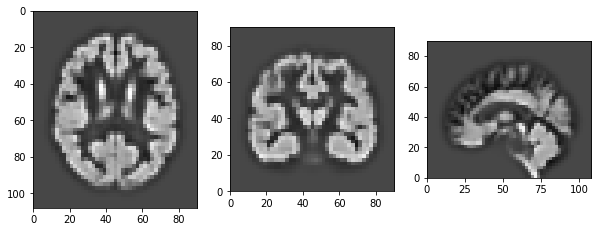

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8478347569214933 set 2 0.8574193627774163 avg 0.8526270598494547
svm set 1 0.6144059279981897 set 2 0.6010484329362467 avg 0.6077271804672182
mlp set 1 -0.4787508330741401 set 2 -0.39968719997234303 avg -0.4392190165232416
Average set 1 0.327829950615181 set 2 0.35292686524710665 total 0.3403784079311438
Visualisation of Preprocessing:


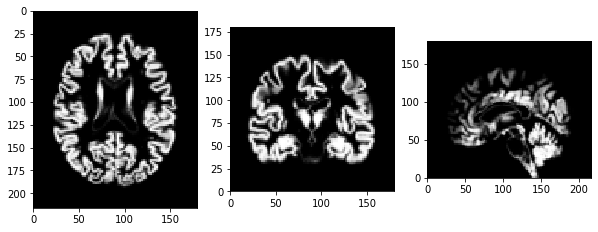

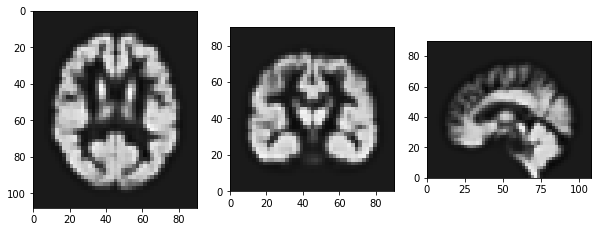

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8436626794532253 set 2 0.8669025274326934 avg 0.8552826034429593
svm set 1 0.5580272960604156 set 2 0.586627363454001 avg 0.5723273297572082
mlp set 1 -0.6734309625566659 set 2 -0.8427096273321885 avg -0.7580702949444271
Average set 1 0.2427530043189916 set 2 0.2036067545181686 total 0.22317987941858008
Visualisation of Preprocessing:


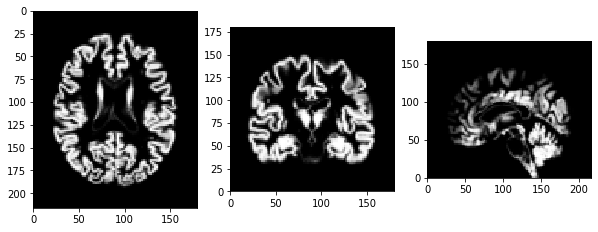

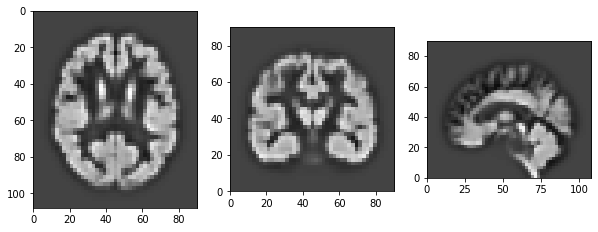

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8397664018465594 set 2 0.8486315471051039 avg 0.8441989744758316
svm set 1 0.5152263847079384 set 2 0.5085279077892638 avg 0.5118771462486011
mlp set 1 -1.3997148777879107 set 2 -1.1959107761348617 avg -1.2978128269613862
Average set 1 -0.014907363744470992 set 2 0.053749559586501995 total 0.0194210979210155
Visualisation of Preprocessing:


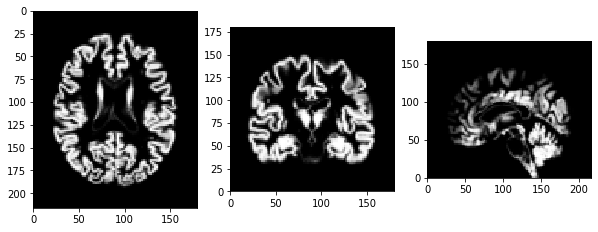

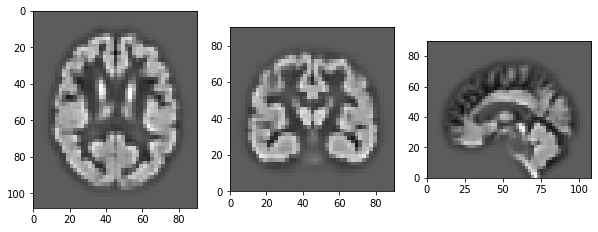

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8648052705455828 set 2 0.8400635044726784 avg 0.8524343875091306
svm set 1 0.616160890526557 set 2 0.6105434204371796 avg 0.6133521554818683
mlp set 1 -0.3850065323771157 set 2 -0.5093726635728719 avg -0.4471895979749938
Average set 1 0.36531987623167467 set 2 0.3137447537789954 total 0.33953231500533504
Visualisation of Preprocessing:


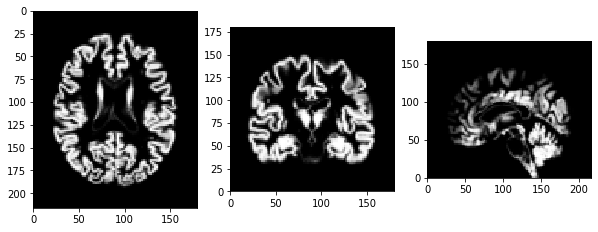

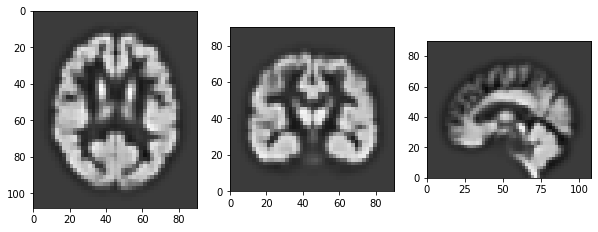

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8354399385264366 set 2 0.8416576455477138 avg 0.8385487920370752
svm set 1 0.5355560736461817 set 2 0.5612285013802241 avg 0.5483922875132029
mlp set 1 -0.8810953951633449 set 2 -0.8954262102120858 avg -0.8882608026877153
Average set 1 0.1633002056697578 set 2 0.16915331223861738 total 0.1662267589541876
Visualisation of Preprocessing:


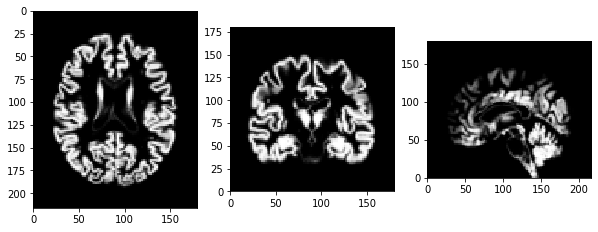

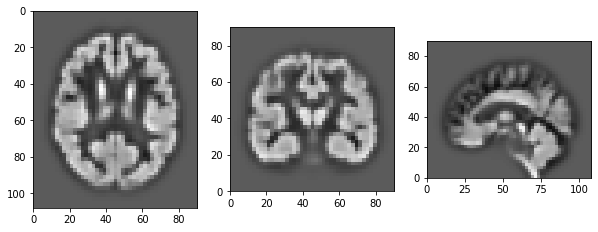

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8241317277876526 set 2 0.851511955659103 avg 0.8378218417233778
svm set 1 0.5289298690627855 set 2 0.5009455680470353 avg 0.5149377185549104
mlp set 1 -1.2855033014708086 set 2 -1.0898892297171505 avg -1.1876962655939796
Average set 1 0.022519431793209883 set 2 0.08752276466299591 total 0.055021098228102895
Visualisation of Preprocessing:


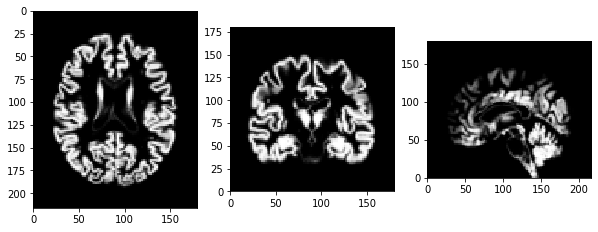

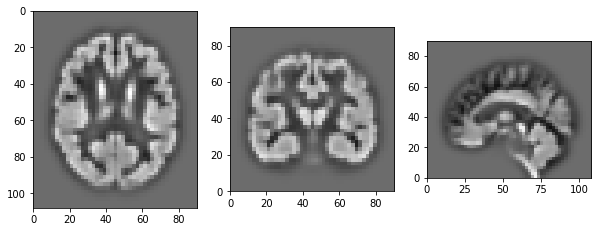

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8441964084716589 set 2 0.8496140382051536 avg 0.8469052233384062
svm set 1 0.6175380830749048 set 2 0.6099976915167312 avg 0.613767887295818
mlp set 1 -0.20548993545010874 set 2 -0.14523340040560861 avg -0.17536166792785868
Average set 1 0.418748185365485 set 2 0.4381261097720921 total 0.4284371475687886
Visualisation of Preprocessing:


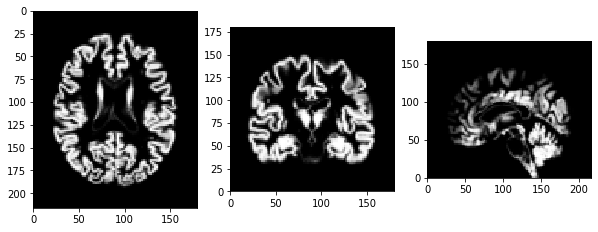

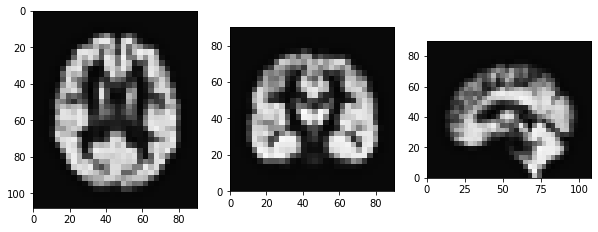

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8571317553147578 set 2 0.8519711383092402 avg 0.854551446811999
svm set 1 0.5916303442892381 set 2 0.5926852005127616 avg 0.5921577724009999
mlp set 1 -0.32432740474670996 set 2 -0.5134431500420291 avg -0.41888527739436954
Average set 1 0.3748115649524287 set 2 0.3104043962599909 total 0.3426079806062098
Visualisation of Preprocessing:


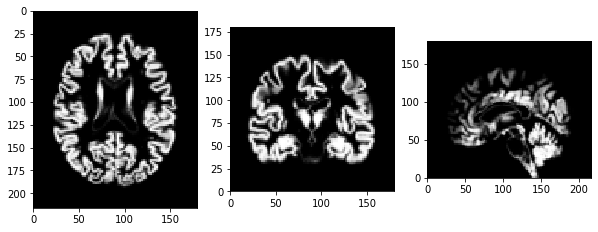

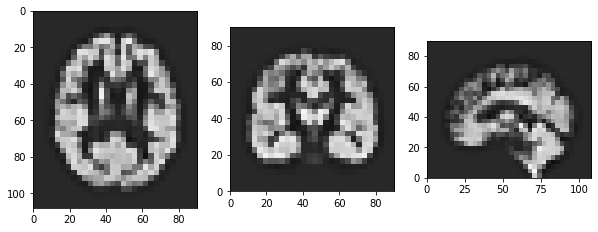

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8591740725211697 set 2 0.8541910707312999 avg 0.8566825716262347
svm set 1 0.561725293246462 set 2 0.5556081565689626 avg 0.5586667249077123
mlp set 1 -0.67310734959216 set 2 -0.6385066021871837 avg -0.6558069758896719
Average set 1 0.2492640053918239 set 2 0.25709754170435956 total 0.2531807735480917
Visualisation of Preprocessing:


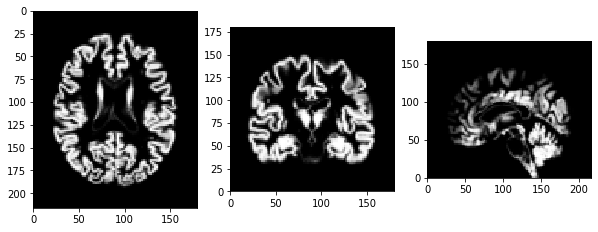

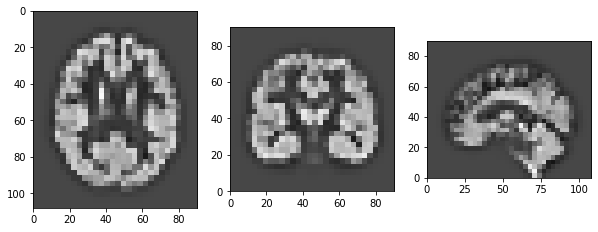

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8527280189237036 set 2 0.8365592006313373 avg 0.8446436097775205
svm set 1 0.6221033110455882 set 2 0.6124832852561757 avg 0.617293298150882
mlp set 1 -0.4199446470468102 set 2 -0.09477097286428136 avg -0.2573578099555458
Average set 1 0.3516288943074939 set 2 0.45142383767441047 total 0.40152636599095215
Visualisation of Preprocessing:


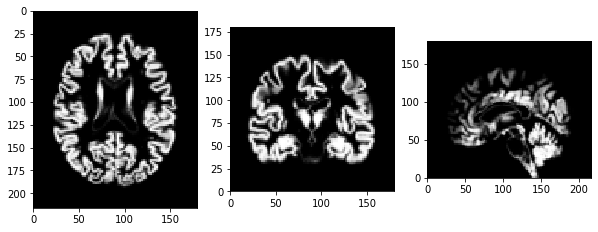

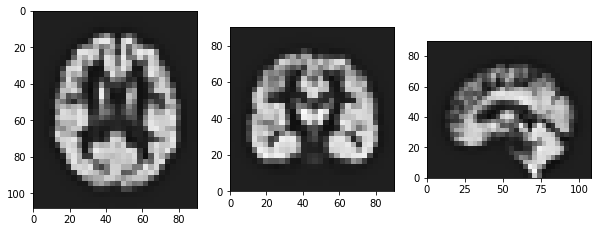

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8681833729529179 set 2 0.8311907299624095 avg 0.8496870514576638
svm set 1 0.5637328038354978 set 2 0.5950026096944332 avg 0.5793677067649655
mlp set 1 -0.5759680703235617 set 2 -0.6221687891652452 avg -0.5990684297444034
Average set 1 0.28531603548828466 set 2 0.2680081834971992 total 0.27666210949274195
Visualisation of Preprocessing:


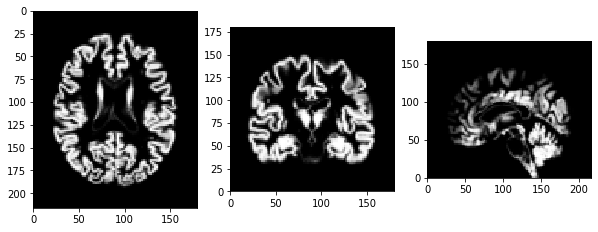

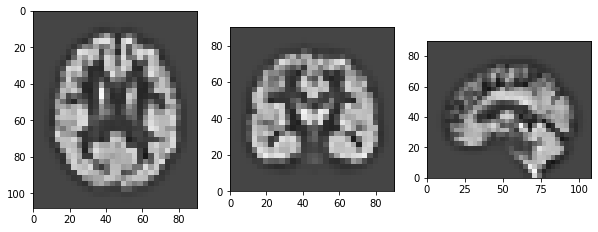

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.851708209533173 set 2 0.8536858873848429 avg 0.852697048459008
svm set 1 0.510587920515138 set 2 0.5211101344426328 avg 0.5158490274788854
mlp set 1 -0.9979871524589702 set 2 -0.8272283309654725 avg -0.9126077417122214
Average set 1 0.12143632586311359 set 2 0.18252256362066774 total 0.15197944474189068
Visualisation of Preprocessing:


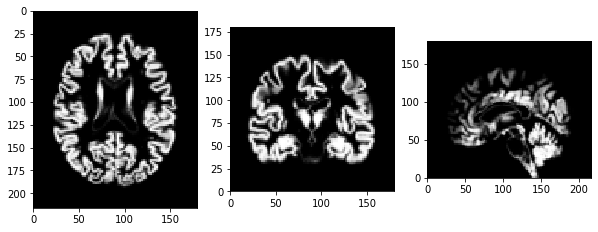

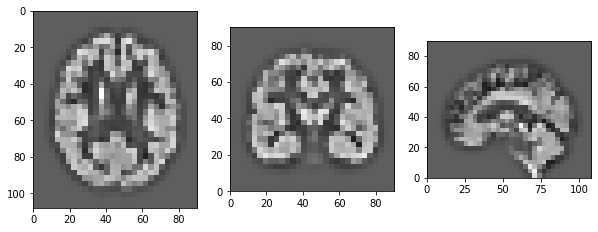

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.856467602908804 set 2 0.83604218622494 avg 0.846254894566872
svm set 1 0.601747191282296 set 2 0.5838009713888784 avg 0.5927740813355873
mlp set 1 -0.4720859945459397 set 2 -0.40799525961715144 avg -0.44004062708154557
Average set 1 0.32870959988172005 set 2 0.33728263266555564 total 0.33299611627363784
Visualisation of Preprocessing:


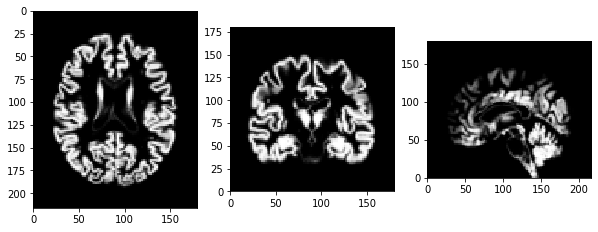

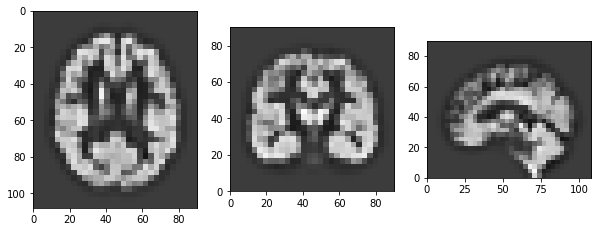

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8344315625878078 set 2 0.848233527731647 avg 0.8413325451597273
svm set 1 0.5462187644848302 set 2 0.554146875817137 avg 0.5501828201509835
mlp set 1 -0.6545243424226688 set 2 -0.8898356483411645 avg -0.7721799953819166
Average set 1 0.2420419948833231 set 2 0.17084825173587315 total 0.20644512330959813
Visualisation of Preprocessing:


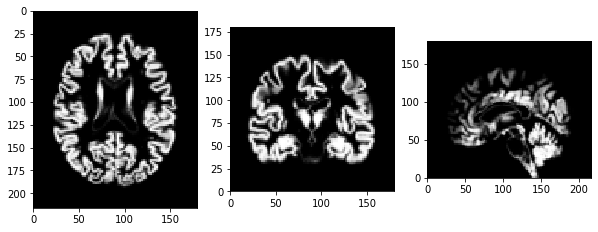

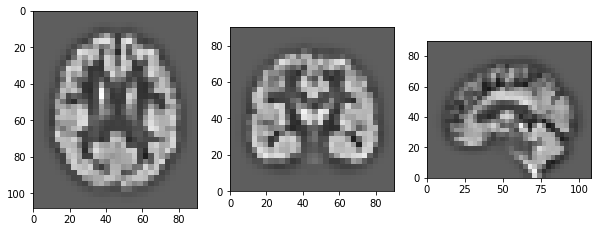

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8400604138532776 set 2 0.8397382176699831 avg 0.8398993157616303
svm set 1 0.5228148725891064 set 2 0.5027059638053983 avg 0.5127604181972524
mlp set 1 -1.012878133926451 set 2 -0.8415833900998418 avg -0.9272307620131464
Average set 1 0.11666571750531096 set 2 0.16695359712517985 total 0.14180965731524542
Visualisation of Preprocessing:


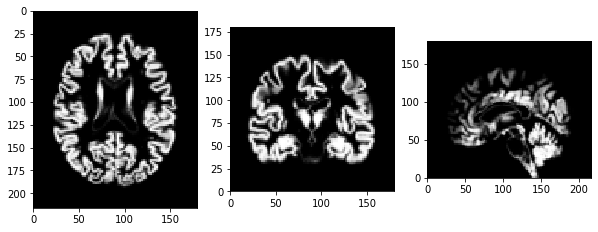

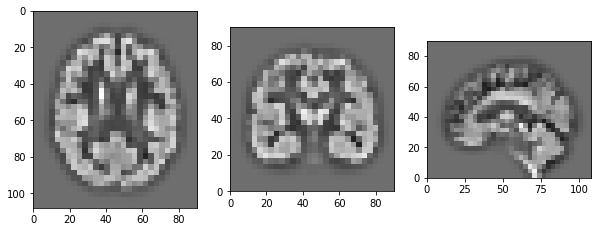

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8448679993816808 set 2 0.8567784319565228 avg 0.8508232156691018
svm set 1 0.6406264728715998 set 2 0.6539029891050205 avg 0.6472647309883102
mlp set 1 -0.16194318280300268 set 2 0.017619928114652295 avg -0.0721616273441752
Average set 1 0.4411837631500926 set 2 0.5094337830587319 total 0.4753087731044122
Visualisation of Preprocessing:


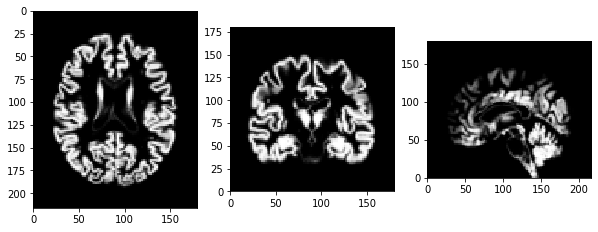

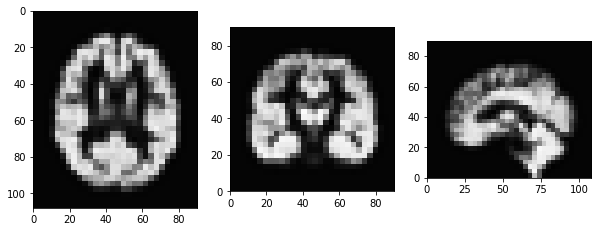

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8444403735047098 set 2 0.8545346175931509 avg 0.8494874955489303
svm set 1 0.6339805036429182 set 2 0.6425761184402721 avg 0.6382783110415952
mlp set 1 -0.13422668421960404 set 2 -0.2105222859203912 avg -0.17237448506999764
Average set 1 0.448064730976008 set 2 0.42886281670434384 total 0.43846377384017593
Visualisation of Preprocessing:


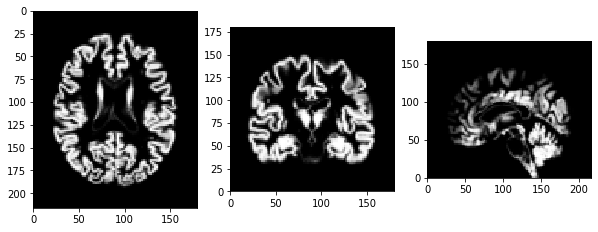

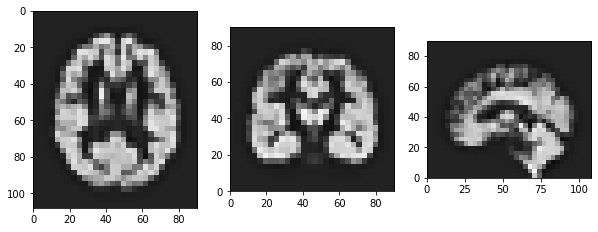

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8299901105324359 set 2 0.8583906873142617 avg 0.8441903989233488
svm set 1 0.5877382984981043 set 2 0.6198280826579075 avg 0.6037831905780059
mlp set 1 -0.5574516193614565 set 2 -0.4418454075889786 avg -0.49964851347521755
Average set 1 0.2867589298896946 set 2 0.34545778746106354 total 0.31610835867537906
Visualisation of Preprocessing:


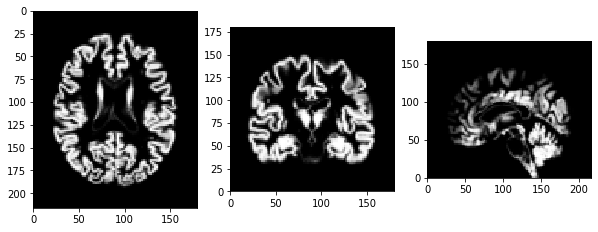

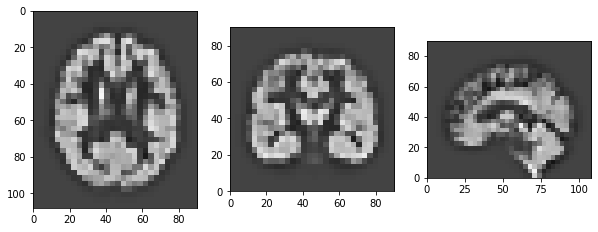

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8543856539254125 set 2 0.8465062972870437 avg 0.8504459756062281
svm set 1 0.6553438027909926 set 2 0.6392848624285414 avg 0.647314332609767
mlp set 1 -0.12875711337937945 set 2 -0.2081711524977954 avg -0.16846413293858742
Average set 1 0.4603241144456753 set 2 0.4258733357392632 total 0.4430987250924693
Visualisation of Preprocessing:


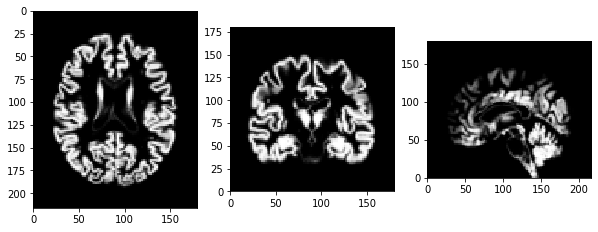

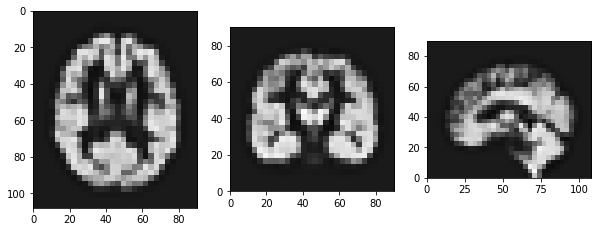

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8478027157717032 set 2 0.8441110337022844 avg 0.8459568747369938
svm set 1 0.6323782862413021 set 2 0.5762308154680099 avg 0.6043045508546561
mlp set 1 -0.49211017260463547 set 2 -0.36193555519031007 avg -0.4270228638974728
Average set 1 0.32935694313612324 set 2 0.352802097993328 total 0.3410795205647256
Visualisation of Preprocessing:


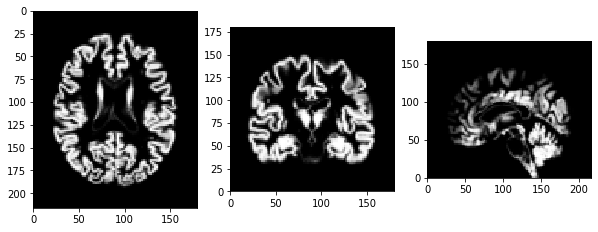

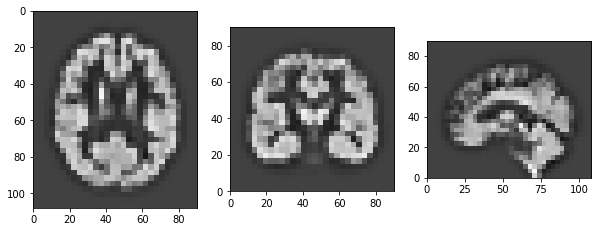

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8371122132020103 set 2 0.835588519615246 avg 0.8363503664086283
svm set 1 0.5496478419276962 set 2 0.5919181654581616 avg 0.5707830036929289
mlp set 1 -0.5492300406355186 set 2 -0.9033119767489478 avg -0.7262710086922333
Average set 1 0.27917667149806263 set 2 0.17473156944148657 total 0.2269541204697746
Visualisation of Preprocessing:


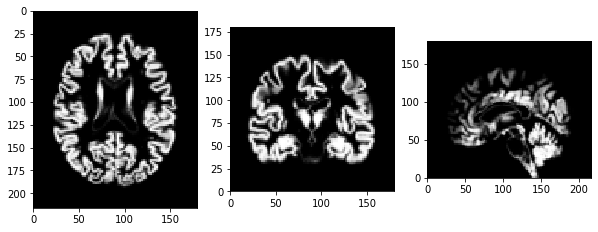

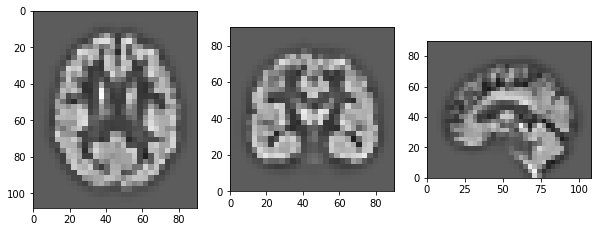

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8665164978618838 set 2 0.8397759307324245 avg 0.8531462142971542
svm set 1 0.6379430962416326 set 2 0.6330660776647652 avg 0.6355045869531989
mlp set 1 -0.3258750498510832 set 2 -0.17815249236685426 avg -0.2520137711089687
Average set 1 0.39286151475081105 set 2 0.4315631720101118 total 0.4122123433804614
Visualisation of Preprocessing:


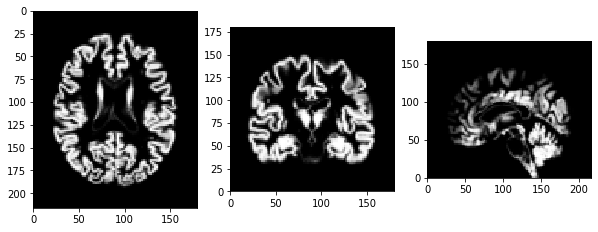

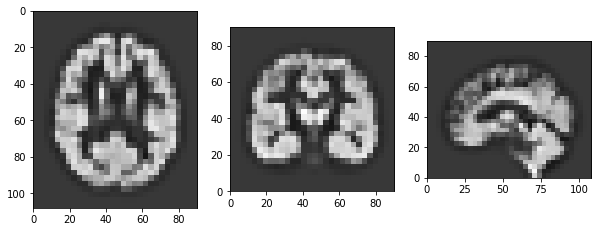

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8199167028429534 set 2 0.8409868974109578 avg 0.8304518001269556
svm set 1 0.5921924050146076 set 2 0.5875298014064787 avg 0.5898611032105432
mlp set 1 -0.44359853733686805 set 2 -0.643991723205479 avg -0.5437951302711735
Average set 1 0.32283685684023095 set 2 0.2615083252039858 total 0.29217259102210835
Visualisation of Preprocessing:


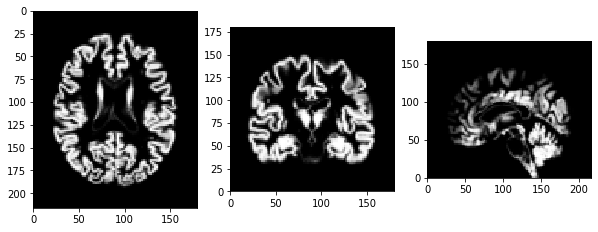

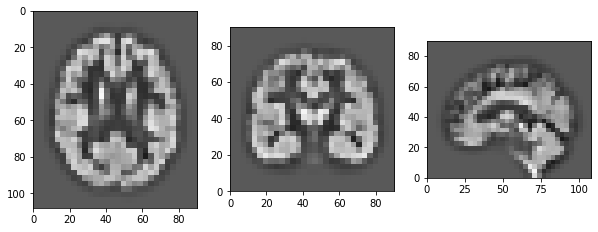

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8237725106937552 set 2 0.857687595996595 avg 0.8407300533451751
svm set 1 0.5513527706194414 set 2 0.519259067238333 avg 0.5353059189288872
mlp set 1 -1.0631193904455967 set 2 -0.5745520721435968 avg -0.8188357312945967
Average set 1 0.10400196362253333 set 2 0.2674648636971104 total 0.18573341365982188
Visualisation of Preprocessing:


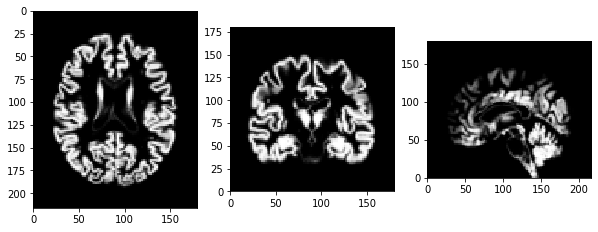

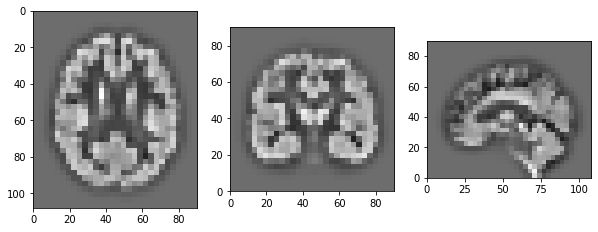

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8448534812626629 set 2 0.8748014202778229 avg 0.8598274507702429
svm set 1 0.657661988488256 set 2 0.6823794225390403 avg 0.6700207055136481
mlp set 1 0.11014292349893384 set 2 0.10930686300193604 avg 0.10972489325043494
Average set 1 0.5375527977499509 set 2 0.5554959019395997 total 0.5465243498447754
Visualisation of Preprocessing:


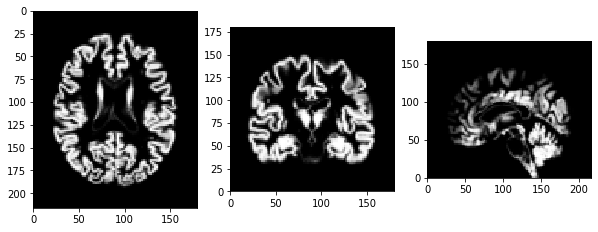

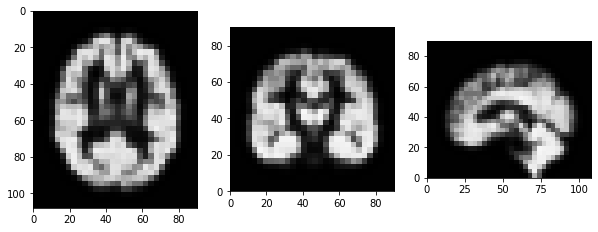

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8619332255156238 set 2 0.8628928065034823 avg 0.8624130160095531
svm set 1 0.6699460778337596 set 2 0.6642522392491301 avg 0.6670991585414449
mlp set 1 -0.12791421918359225 set 2 0.003389949741835374 avg -0.06226213472087844
Average set 1 0.46798836138859706 set 2 0.5101783318314825 total 0.4890833466100398
Visualisation of Preprocessing:


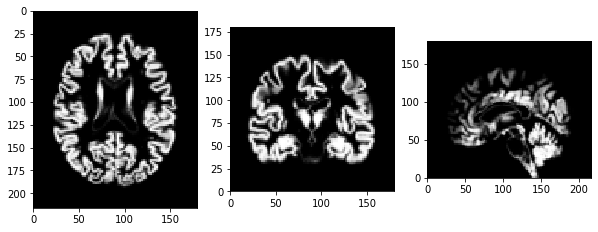

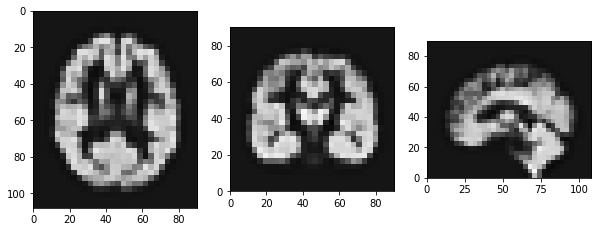

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8547267955037623 set 2 0.8486075983541668 avg 0.8516671969289645
svm set 1 0.6543174214229172 set 2 0.6550162077429806 avg 0.6546668145829488
mlp set 1 -0.17125680146289857 set 2 -0.17272828781159588 avg -0.17199254463724722
Average set 1 0.445929138487927 set 2 0.4436318394285172 total 0.4447804889582221
Visualisation of Preprocessing:


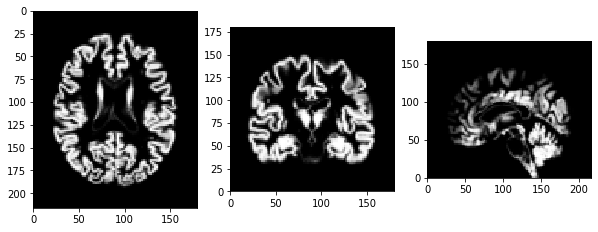

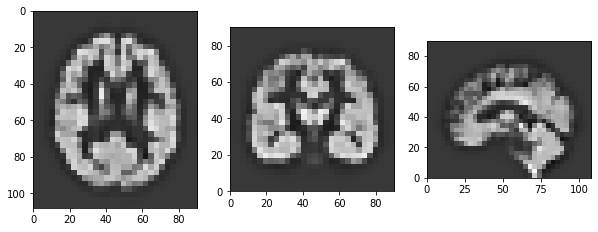

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8553071669321042 set 2 0.8400523861675083 avg 0.8476797765498063
svm set 1 0.6598852852844866 set 2 0.6798286454367879 avg 0.6698569653606372
mlp set 1 0.08843565006419041 set 2 0.014499895065040902 avg 0.051467772564615655
Average set 1 0.5345427007602604 set 2 0.5114603088897791 total 0.5230015048250198
Visualisation of Preprocessing:


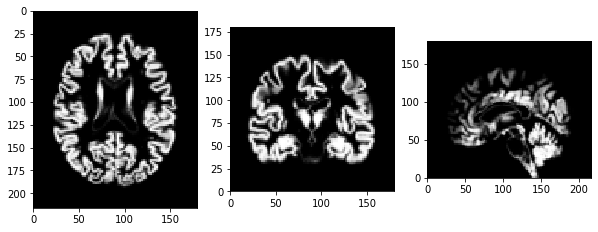

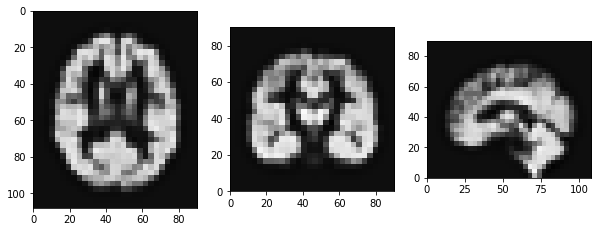

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8552552133745724 set 2 0.8369719469058432 avg 0.8461135801402078
svm set 1 0.6451085504374642 set 2 0.6271713191216776 avg 0.6361399347795709
mlp set 1 -0.1569500143013074 set 2 -0.20039659665983645 avg -0.17867330548057192
Average set 1 0.4478045831702431 set 2 0.42124888978922814 total 0.4345267364797356
Visualisation of Preprocessing:


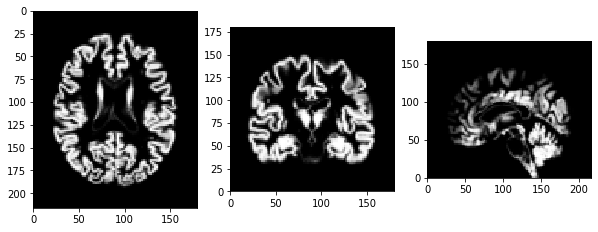

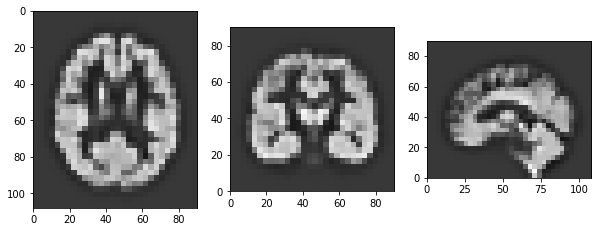

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8352748694108412 set 2 0.8373574256967784 avg 0.8363161475538098
svm set 1 0.6237607941556336 set 2 0.6282177044506078 avg 0.6259892493031207
mlp set 1 -0.3017540393975253 set 2 -0.526938837675013 avg -0.4143464385362692
Average set 1 0.3857605413896498 set 2 0.3128787641574577 total 0.34931965277355376
Visualisation of Preprocessing:


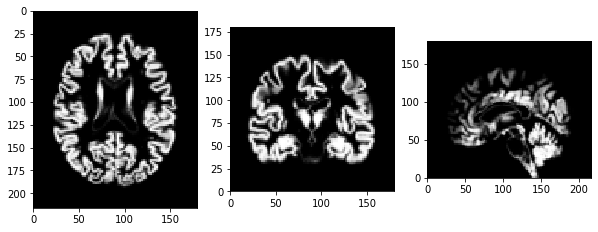

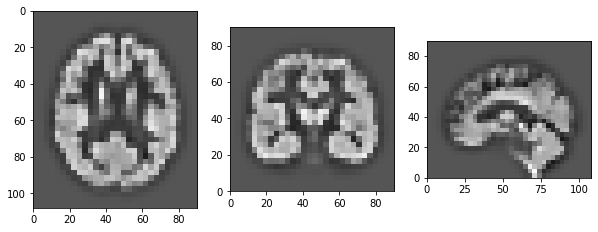

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8416889686114394 set 2 0.8414850839351524 avg 0.8415870262732958
svm set 1 0.6702927658571354 set 2 0.663781373139342 avg 0.6670370694982387
mlp set 1 -0.04995722319896778 set 2 -0.022384099985727657 avg -0.03617066159234772
Average set 1 0.4873415037565357 set 2 0.4942941190295889 total 0.4908178113930623
Visualisation of Preprocessing:


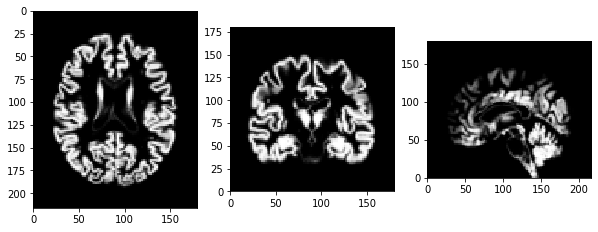

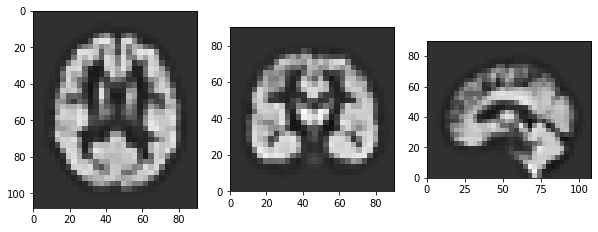

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.83695330191386 set 2 0.8408351348103423 avg 0.8388942183621011
svm set 1 0.6151070354595483 set 2 0.6256757180136936 avg 0.6203913767366209
mlp set 1 -0.3321673900121169 set 2 -0.28171849323471054 avg -0.30694294162341373
Average set 1 0.37329764912043045 set 2 0.3949307865297751 total 0.3841142178251028
Visualisation of Preprocessing:


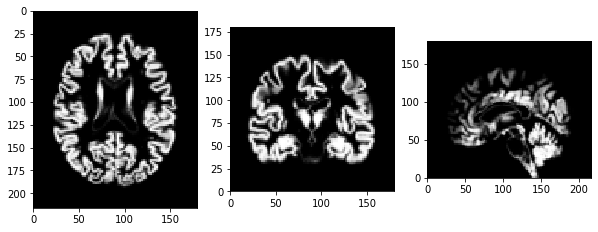

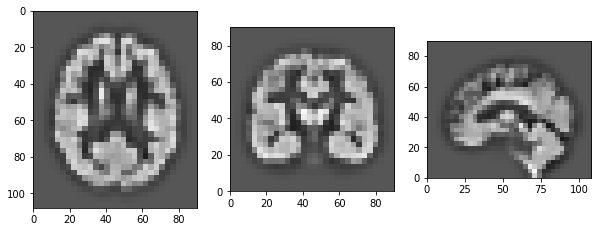

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8368831817761516 set 2 0.8505355168340065 avg 0.8437093493050791
svm set 1 0.6010928407352368 set 2 0.5999845603680811 avg 0.6005387005516589
mlp set 1 -0.5521933744910139 set 2 -0.7147913448801697 avg -0.6334923596855918
Average set 1 0.2952608826734582 set 2 0.24524291077397264 total 0.2702518967237154
Visualisation of Preprocessing:


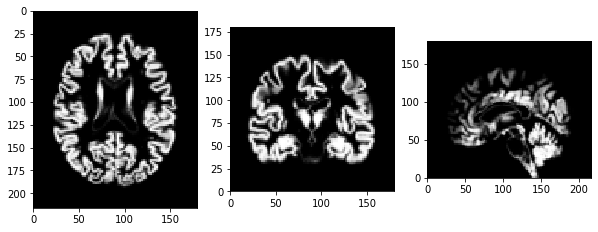

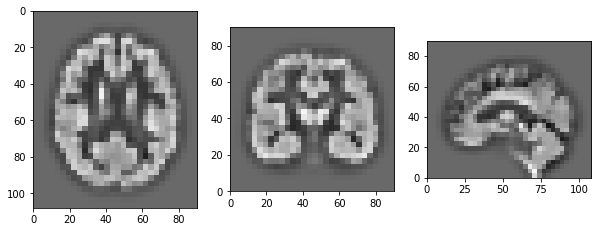

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.847557051592927 set 2 0.8415793476919614 avg 0.8445681996424442
svm set 1 0.6715346499446933 set 2 0.6892571785420366 avg 0.6803959142433649
mlp set 1 0.6085019733758293 set 2 0.5468947883114275 avg 0.5776983808436285
Average set 1 0.7091978916378165 set 2 0.6925771048484751 total 0.7008874982431459
Visualisation of Preprocessing:


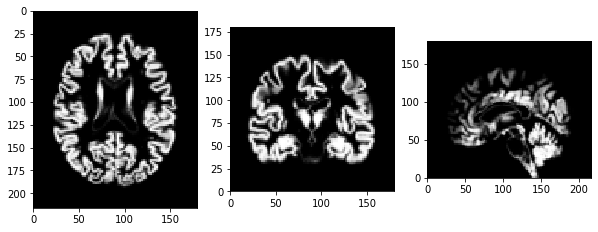

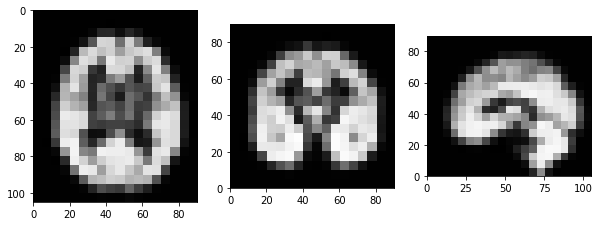

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8431891723801239 set 2 0.8472183357089791 avg 0.8452037540445515
svm set 1 0.6839137176166317 set 2 0.6864386037748819 avg 0.6851761606957567
mlp set 1 0.4951431739598999 set 2 0.37771406801224316 avg 0.4364286209860715
Average set 1 0.6740820213188852 set 2 0.637123669165368 total 0.6556028452421265
Visualisation of Preprocessing:


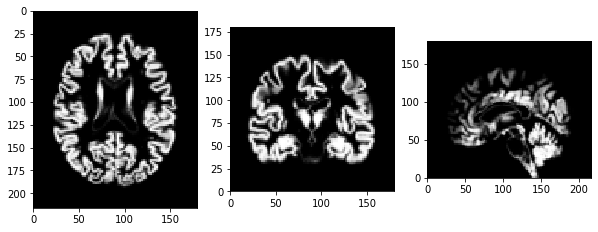

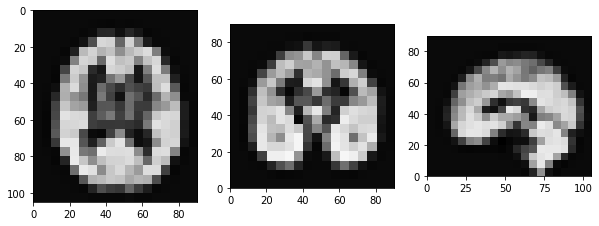

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8167556224481203 set 2 0.852782053950405 avg 0.8347688381992626
svm set 1 0.6890930491080094 set 2 0.690577471052555 avg 0.6898352600802822
mlp set 1 0.25379826522756 set 2 0.41192279341189747 avg 0.33286052931972876
Average set 1 0.5865489789278966 set 2 0.6517607728049525 total 0.6191548758664245
Visualisation of Preprocessing:


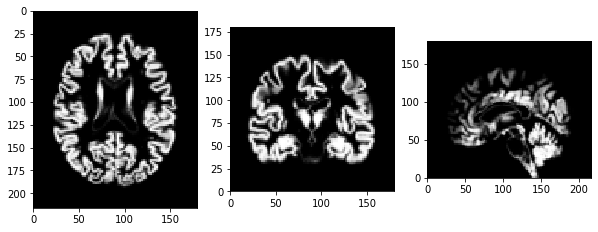

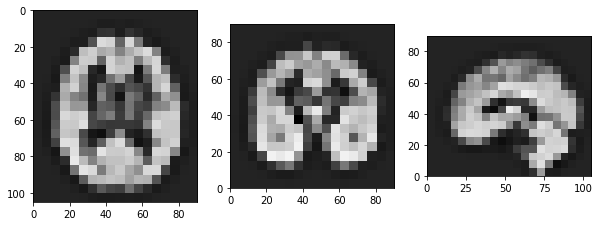

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8538646843436386 set 2 0.853718543082156 avg 0.8537916137128974
svm set 1 0.6744173284802 set 2 0.7015496840133761 avg 0.6879835062467881
mlp set 1 0.5829560035869186 set 2 0.5402670376103815 avg 0.56161152059865
Average set 1 0.7037460054702525 set 2 0.6985117549019711 total 0.7011288801861117
Visualisation of Preprocessing:


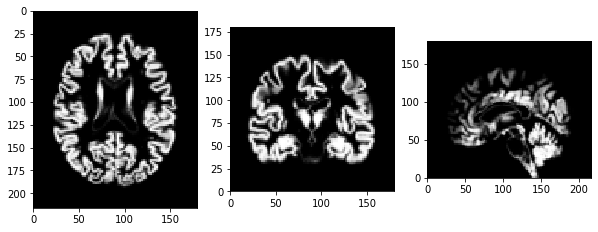

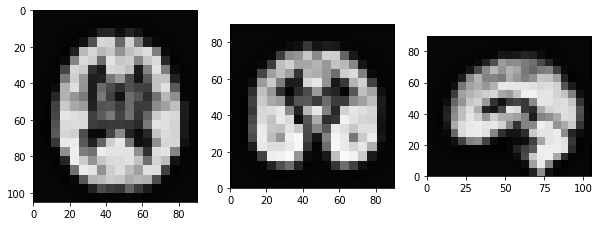

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8618324775837514 set 2 0.8508295300145298 avg 0.8563310037991405
svm set 1 0.6722556184449286 set 2 0.6922257501617235 avg 0.6822406843033261
mlp set 1 0.431160822287754 set 2 0.4609796422901422 avg 0.4460702322889481
Average set 1 0.6550829727721447 set 2 0.6680116408221318 total 0.6615473067971382
Visualisation of Preprocessing:


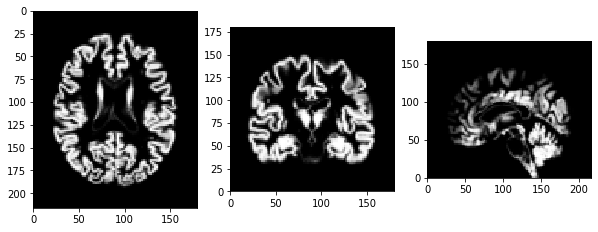

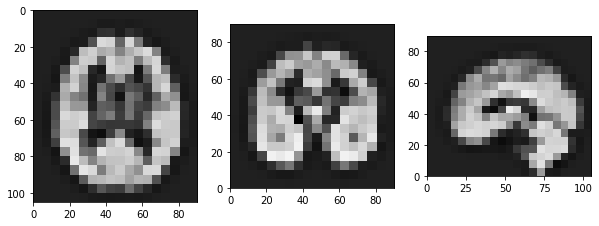

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8511731571522401 set 2 0.8563524444382997 avg 0.8537628007952699
svm set 1 0.6634056858262425 set 2 0.6685945750371328 avg 0.6660001304316876
mlp set 1 0.3887698592528636 set 2 0.17551093368269932 avg 0.28214039646778144
Average set 1 0.6344495674104488 set 2 0.5668193177193772 total 0.600634442564913
Visualisation of Preprocessing:


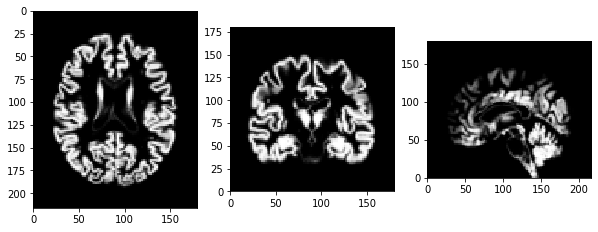

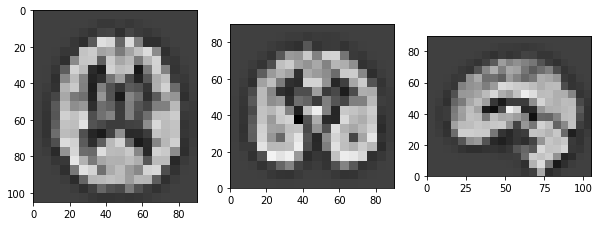

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8671010082613192 set 2 0.8393953230235305 avg 0.8532481656424249
svm set 1 0.6948116164778231 set 2 0.6896417931194327 avg 0.6922267047986279
mlp set 1 0.435487143217211 set 2 0.4669885613911155 avg 0.45123785230416324
Average set 1 0.6657999226521177 set 2 0.6653418925113596 total 0.6655709075817386
Visualisation of Preprocessing:


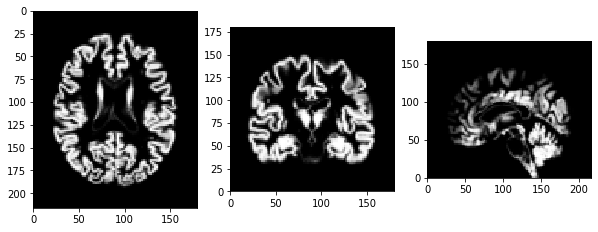

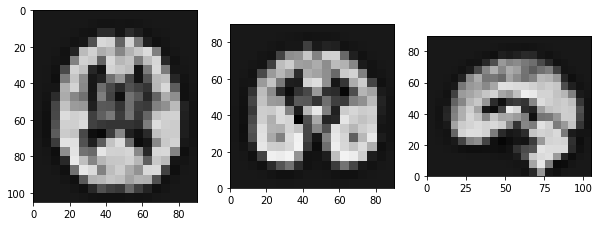

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8579505073522359 set 2 0.851075152847217 avg 0.8545128300997265
svm set 1 0.6887933682250738 set 2 0.6913180100727463 avg 0.69005568914891
mlp set 1 0.3205024368523698 set 2 0.2912566106842097 avg 0.30587952376828975
Average set 1 0.6224154374765597 set 2 0.611216591201391 total 0.6168160143389754
Visualisation of Preprocessing:


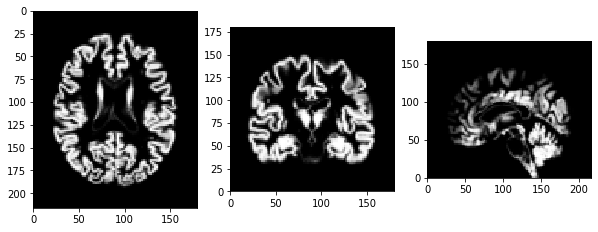

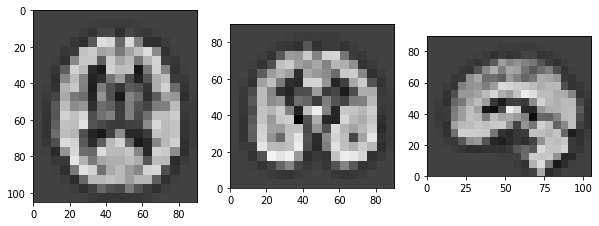

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8486951271217297 set 2 0.8391930366419106 avg 0.8439440818818201
svm set 1 0.6819325721745628 set 2 0.6846770776660844 avg 0.6833048249203236
mlp set 1 0.1837563240991824 set 2 0.3092027419902801 avg 0.24647953304473125
Average set 1 0.5714613411318249 set 2 0.6110242854327584 total 0.5912428132822917
Visualisation of Preprocessing:


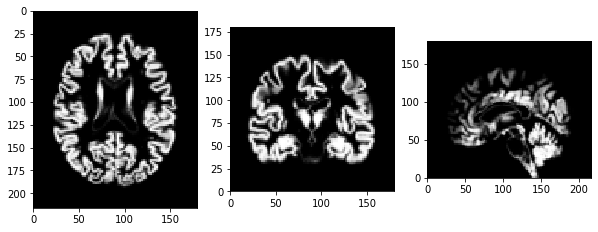

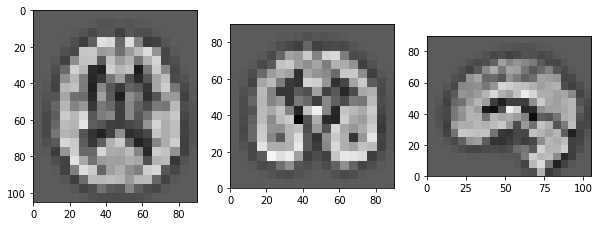

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8291503444317564 set 2 0.8618304404308227 avg 0.8454903924312895
svm set 1 0.681017050372289 set 2 0.6487553641441585 avg 0.6648862072582238
mlp set 1 0.5841364478920892 set 2 0.5371846378592773 avg 0.5606605428756832
Average set 1 0.6981012808987116 set 2 0.6825901474780861 total 0.6903457141883989
Visualisation of Preprocessing:


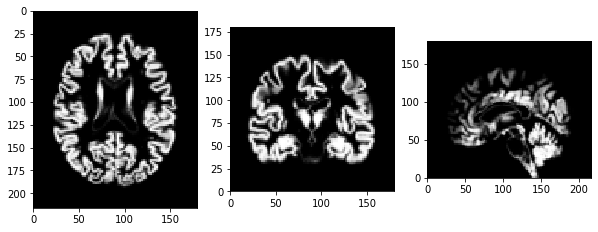

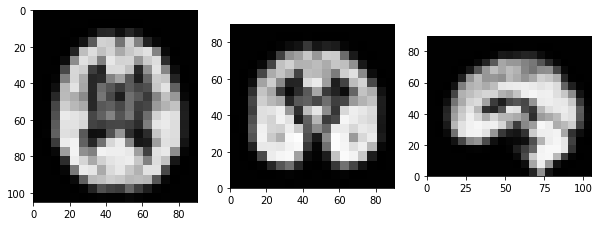

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8284430835008925 set 2 0.8501353481533458 avg 0.8392892158271191
svm set 1 0.6538584282250656 set 2 0.680060949928792 avg 0.6669596890769287
mlp set 1 0.5967894445323751 set 2 0.4871540068686532 avg 0.5419717257005141
Average set 1 0.6930303187527778 set 2 0.6724501016502636 total 0.6827402102015208
Visualisation of Preprocessing:


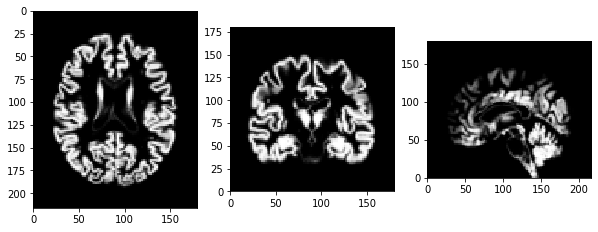

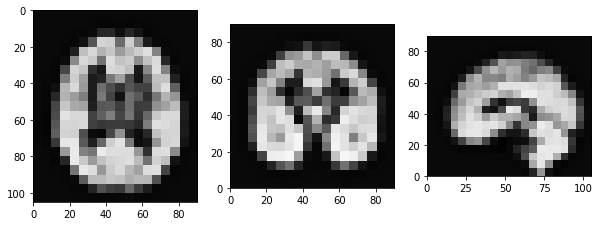

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8544389267402357 set 2 0.8437369488810033 avg 0.8490879378106195
svm set 1 0.6681941809520269 set 2 0.6802314227109828 avg 0.6742128018315048
mlp set 1 0.42854904483226053 set 2 0.40810146112075224 avg 0.41832525297650636
Average set 1 0.6503940508415077 set 2 0.6440232775709128 total 0.6472086642062103
Visualisation of Preprocessing:


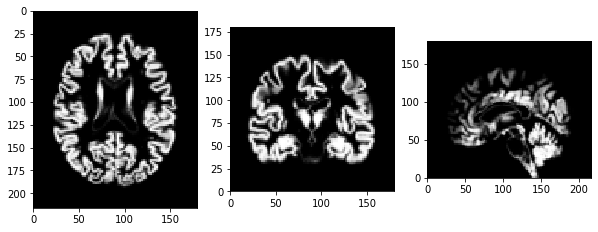

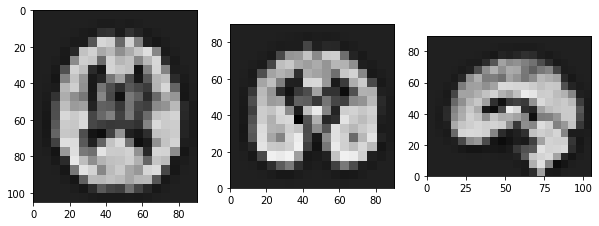

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.83243672152148 set 2 0.8444021471491383 avg 0.8384194343353091
svm set 1 0.6731299675117286 set 2 0.6824029926599358 avg 0.6777664800858322
mlp set 1 0.6197735090991591 set 2 0.38569929263037506 avg 0.502736400864767
Average set 1 0.7084467327107893 set 2 0.6375014774798163 total 0.6729741050953029
Visualisation of Preprocessing:


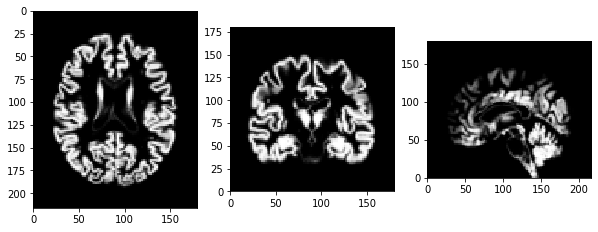

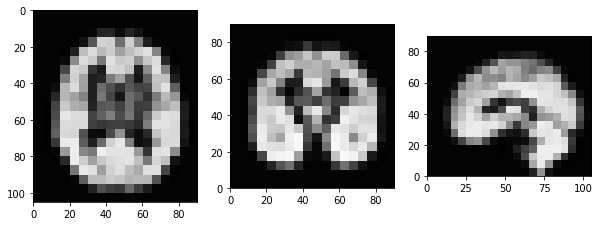

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8328267753846006 set 2 0.8581273076765883 avg 0.8454770415305944
svm set 1 0.7040643830524109 set 2 0.677609103743169 avg 0.69083674339779
mlp set 1 0.4397664690686896 set 2 0.43389675207557044 avg 0.43683161057213005
Average set 1 0.6588858758352337 set 2 0.6565443878317759 total 0.6577151318335048
Visualisation of Preprocessing:


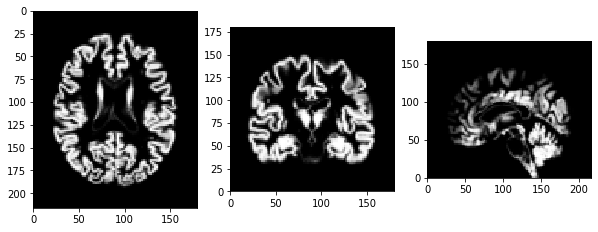

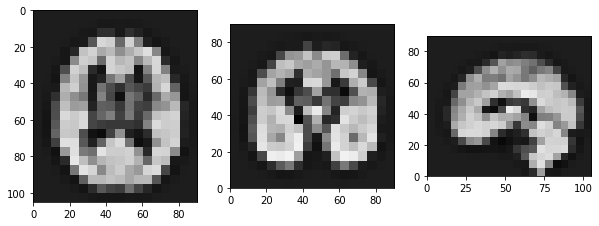

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8347609956307607 set 2 0.8714948369072139 avg 0.8531279162689873
svm set 1 0.7030857233799612 set 2 0.6819348846422546 avg 0.6925103040111079
mlp set 1 0.28030901158437405 set 2 0.33564453747574086 avg 0.30797677453005745
Average set 1 0.6060519101983654 set 2 0.6296914196750698 total 0.6178716649367175
Visualisation of Preprocessing:


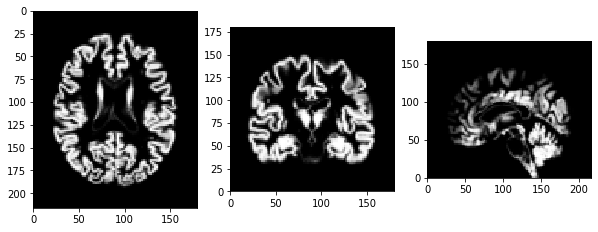

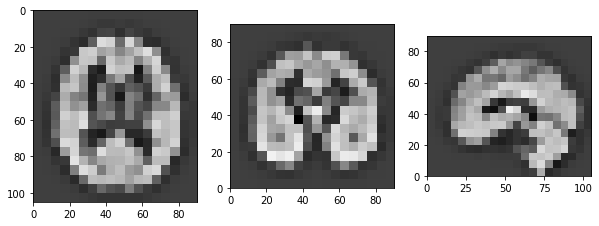

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8405080168069254 set 2 0.8486378657553989 avg 0.8445729412811622
svm set 1 0.6719381624365399 set 2 0.7082223724843707 avg 0.6900802674604554
mlp set 1 0.3139861493526752 set 2 0.5177036623644264 avg 0.41584490585855083
Average set 1 0.6088107761987135 set 2 0.6915213002013987 total 0.650166038200056
Visualisation of Preprocessing:


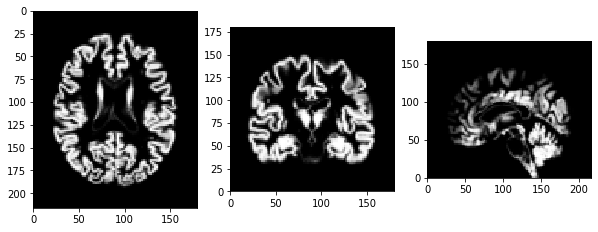

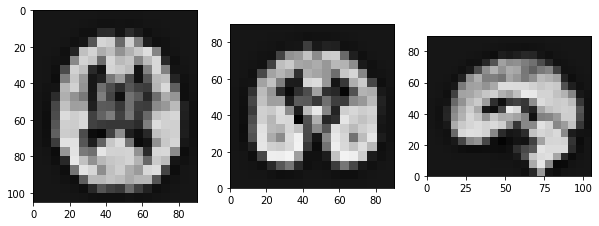

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8495248982086752 set 2 0.8465013202971511 avg 0.8480131092529131
svm set 1 0.6829820892255704 set 2 0.7010698974316478 avg 0.692025993328609
mlp set 1 0.40198596458691593 set 2 0.2794772682452401 avg 0.340731616416078
Average set 1 0.6448309840070539 set 2 0.6090161619913464 total 0.6269235729992002
Visualisation of Preprocessing:


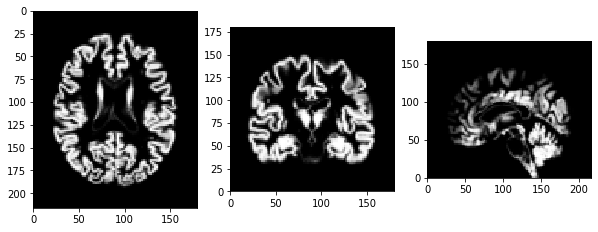

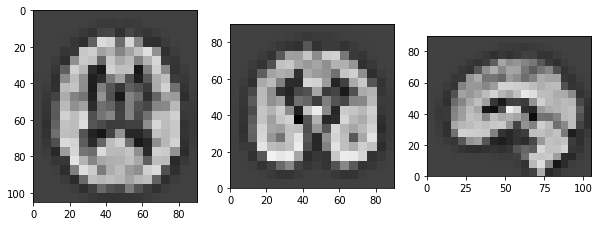

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8442188434008144 set 2 0.8526979670711324 avg 0.8484584052359734
svm set 1 0.6948597008895501 set 2 0.6822868485055317 avg 0.6885732746975408
mlp set 1 0.2769995450650623 set 2 0.2809013192468466 avg 0.27895043215595444
Average set 1 0.6053593631184756 set 2 0.6052953782745035 total 0.6053273706964896
Visualisation of Preprocessing:


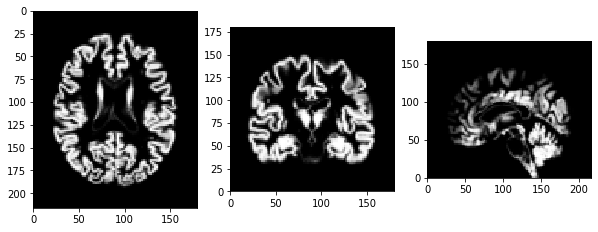

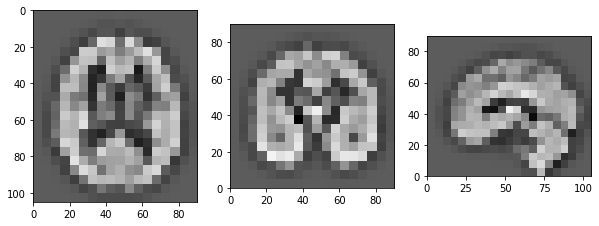

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8124012048298656 set 2 0.8027450892521572 avg 0.8075731470410114
svm set 1 0.6527005017424783 set 2 0.6763733755168941 avg 0.6645369386296862
mlp set 1 0.5580806791322381 set 2 0.4699099090364467 avg 0.5139952940843424
Average set 1 0.6743941285681941 set 2 0.6496761246018327 total 0.6620351265850134
Visualisation of Preprocessing:


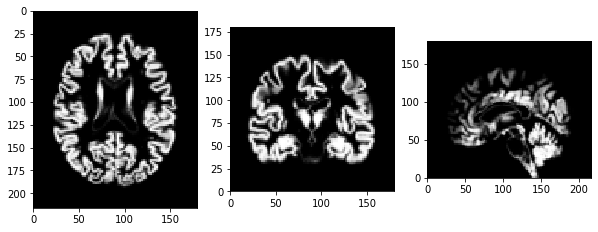

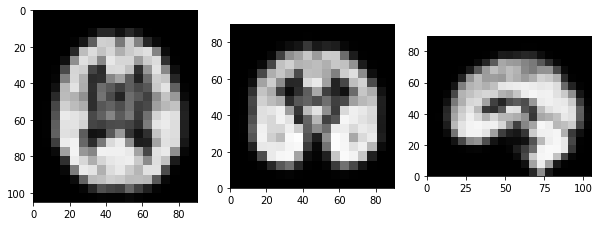

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8342143196348606 set 2 0.8589657285862609 avg 0.8465900241105607
svm set 1 0.7031459466537653 set 2 0.684159634531458 avg 0.6936527905926116
mlp set 1 0.5608199357845034 set 2 0.5696838550757961 avg 0.5652518954301498
Average set 1 0.699393400691043 set 2 0.7042697393978384 total 0.7018315700444407
Visualisation of Preprocessing:


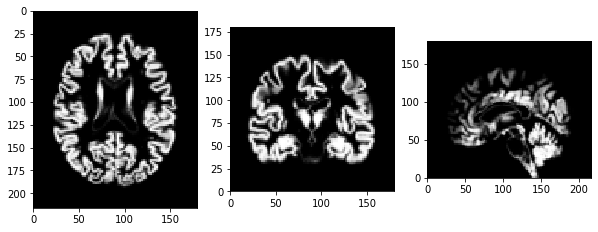

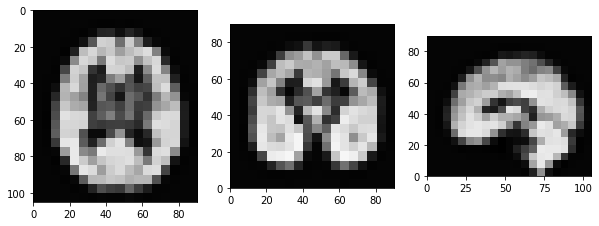

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8322715273587837 set 2 0.8640866062679282 avg 0.848179066813356
svm set 1 0.683256194764589 set 2 0.6942761744911407 avg 0.6887661846278648
mlp set 1 0.35285255897236656 set 2 0.5584697585002638 avg 0.4556611587363152
Average set 1 0.6227934270319131 set 2 0.7056108464197776 total 0.6642021367258453
Visualisation of Preprocessing:


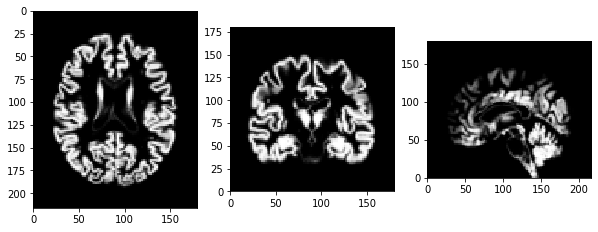

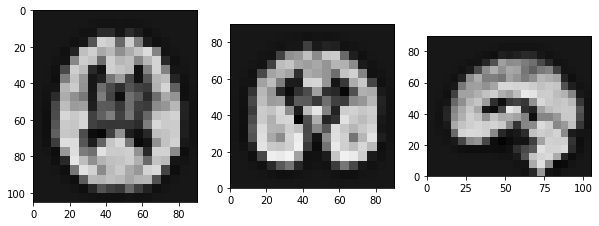

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8078486856996814 set 2 0.8314884758579881 avg 0.8196685807788348
svm set 1 0.651479841306936 set 2 0.7256695030480739 avg 0.688574672177505
mlp set 1 0.5602438410422925 set 2 0.5766211189738276 avg 0.56843248000806
Average set 1 0.6731907893496366 set 2 0.7112596992932966 total 0.6922252443214666
Visualisation of Preprocessing:


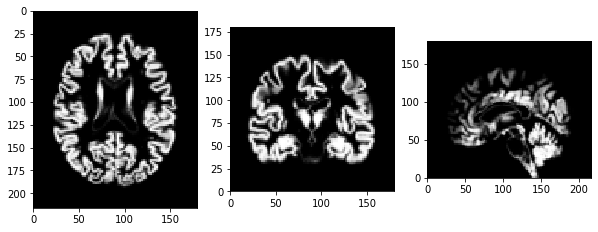

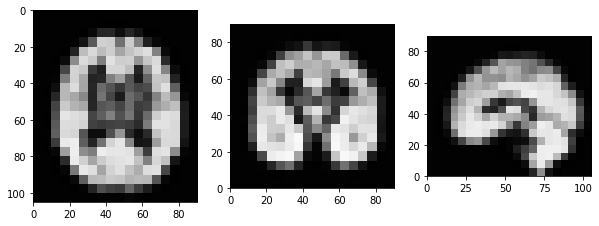

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8448566368921901 set 2 0.8541268674841003 avg 0.8494917521881452
svm set 1 0.6898915942382426 set 2 0.6939233446996864 avg 0.6919074694689645
mlp set 1 0.5263625732469385 set 2 0.4459802192535293 avg 0.48617139625023387
Average set 1 0.6870369347924571 set 2 0.6646768104791053 total 0.6758568726357812
Visualisation of Preprocessing:


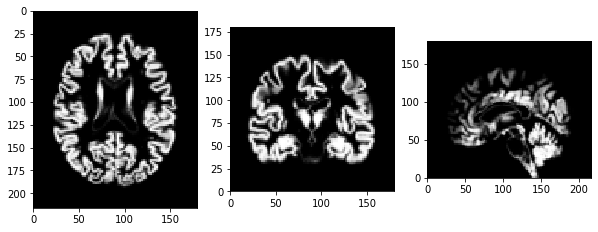

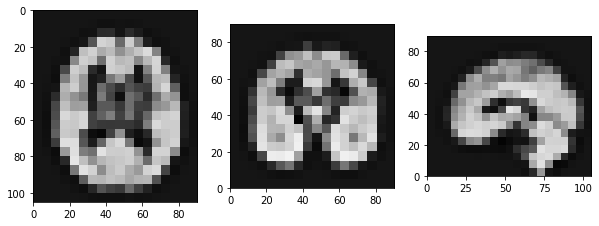

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8380573150580389 set 2 0.8516031635142439 avg 0.8448302392861414
svm set 1 0.6816826118299626 set 2 0.6897528864297684 avg 0.6857177491298655
mlp set 1 0.3314234014325952 set 2 0.4193265659924879 avg 0.3753749837125415
Average set 1 0.6170544427735322 set 2 0.6535608719788334 total 0.6353076573761828
Visualisation of Preprocessing:


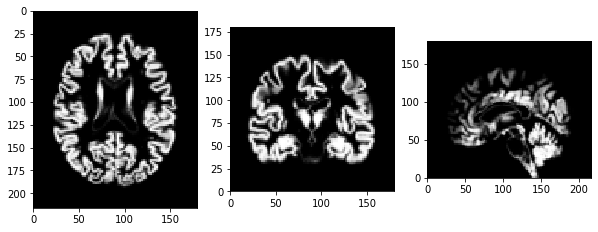

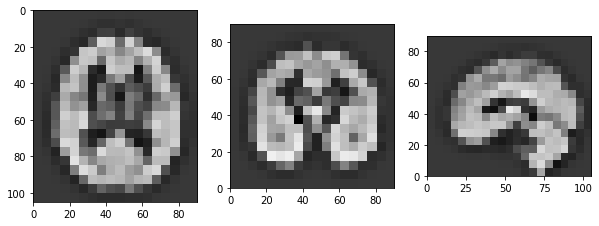

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8536111706427453 set 2 0.8455518429849945 avg 0.8495815068138699
svm set 1 0.6992224638266976 set 2 0.6869448989289431 avg 0.6930836813778203
mlp set 1 0.5186169834642465 set 2 0.44759952516966967 avg 0.48310825431695803
Average set 1 0.6904835393112299 set 2 0.660032089027869 total 0.6752578141695494
Visualisation of Preprocessing:


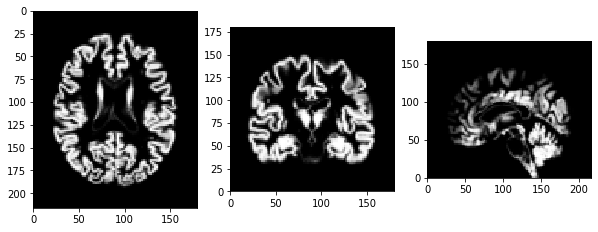

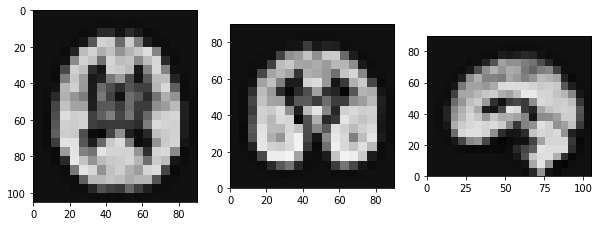

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8391072659980653 set 2 0.8377290474312759 avg 0.8384181567146706
svm set 1 0.6660405551255113 set 2 0.6965097802680864 avg 0.6812751676967989
mlp set 1 0.464020459996397 set 2 0.3342622452014099 avg 0.3991413525989035
Average set 1 0.6563894270399913 set 2 0.622833690966924 total 0.6396115590034577
Visualisation of Preprocessing:


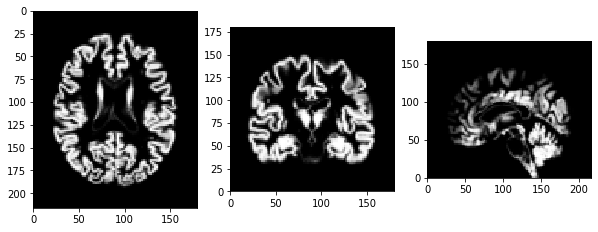

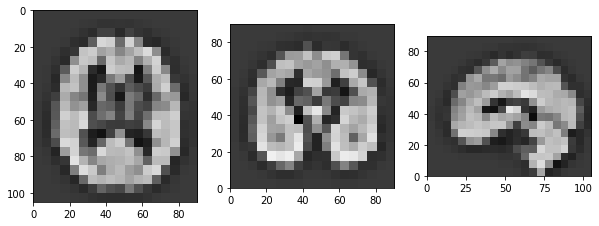

(operation 1) Gamma Corretion (gamma=1 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8625078859367434 set 2 0.8416101982050969 avg 0.8520590420709202
svm set 1 0.6738686196473234 set 2 0.6859526254543942 avg 0.6799106225508588
mlp set 1 0.39574166973208813 set 2 0.2695739602588212 avg 0.33265781499545466
Average set 1 0.6440393917720516 set 2 0.5990455946394374 total 0.6215424932057445
Visualisation of Preprocessing:


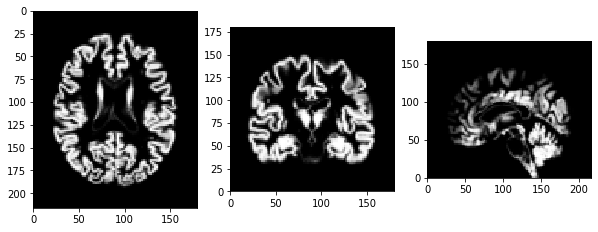

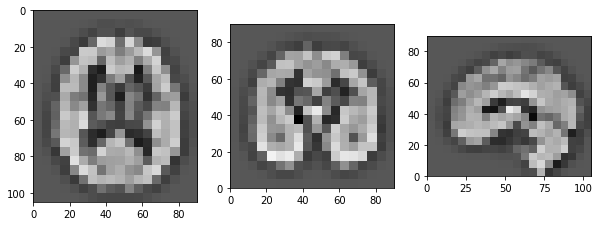

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8461582457906334 set 2 0.8637521774583353 avg 0.8549552116244843
svm set 1 0.5404004926334022 set 2 0.5433039312753584 avg 0.5418522119543803
mlp set 1 -1.48985791026797 set 2 -1.25011839322061 avg -1.36998815174429
Average set 1 -0.034433057281311484 set 2 0.05231257183769459 total 0.008939757278191553
Visualisation of Preprocessing:


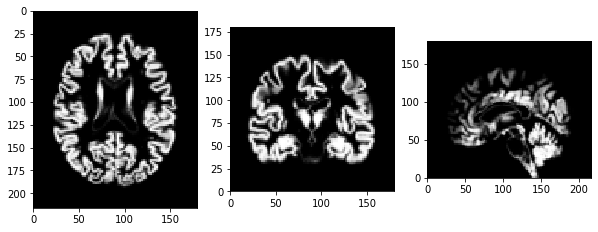

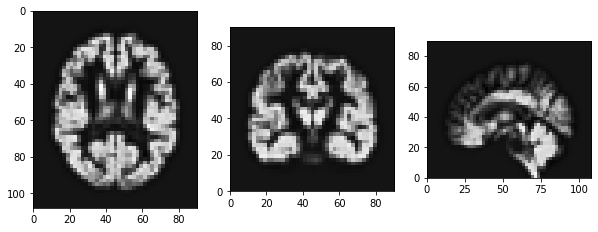

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8493814290891967 set 2 0.8368968331333023 avg 0.8431391311112495
svm set 1 0.4892358077323001 set 2 0.4635084771200415 avg 0.47637214242617076
mlp set 1 -1.994856361209667 set 2 -1.635957959490618 avg -1.8154071603501425
Average set 1 -0.21874637479605674 set 2 -0.11185088307909134 total -0.16529862893757405
Visualisation of Preprocessing:


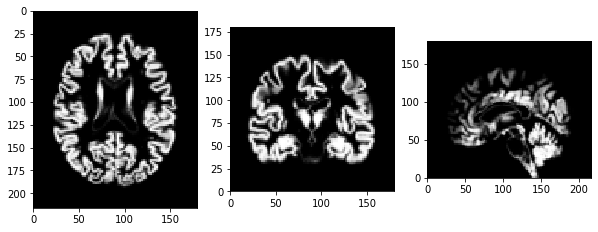

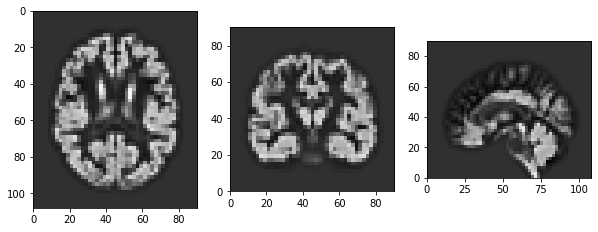

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8341916681467888 set 2 0.8544517796075499 avg 0.8443217238771694
svm set 1 0.41709676089456243 set 2 0.41742278444885833 avg 0.4172597726717104
mlp set 1 -2.2815075661191324 set 2 -2.389577400424003 avg -2.335542483271568
Average set 1 -0.343406379025927 set 2 -0.3725676121225316 total -0.3579869955742293
Visualisation of Preprocessing:


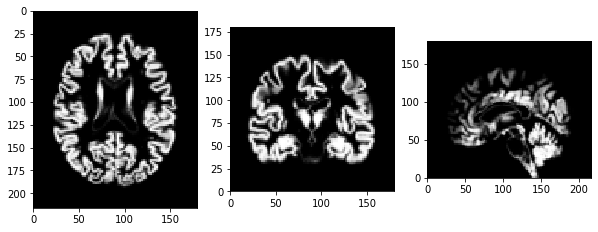

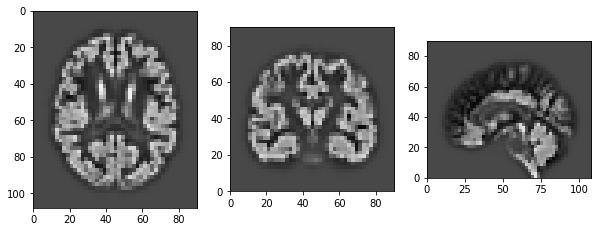

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8492759733905934 set 2 0.8556146309268995 avg 0.8524453021587464
svm set 1 0.5213207130588651 set 2 0.5231973333499489 avg 0.522259023204407
mlp set 1 -1.5906455021786272 set 2 -1.4304247162260695 avg -1.5105351092023485
Average set 1 -0.07334960524305623 set 2 -0.017204250649740366 total -0.045276927946398295
Visualisation of Preprocessing:


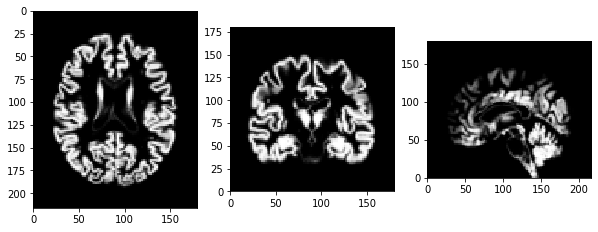

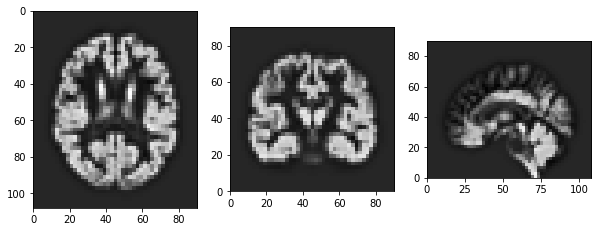

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8288574548555869 set 2 0.8348659430986274 avg 0.8318616989771072
svm set 1 0.4309355601466793 set 2 0.4486520882716021 avg 0.4397938242091407
mlp set 1 -1.8706913678006023 set 2 -2.0993528205524274 avg -1.9850220941765149
Average set 1 -0.203632784266112 set 2 -0.2719449297273993 total -0.23778885699675567
Visualisation of Preprocessing:


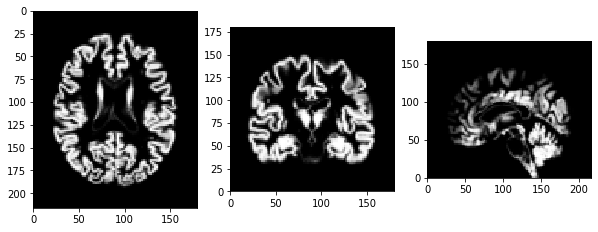

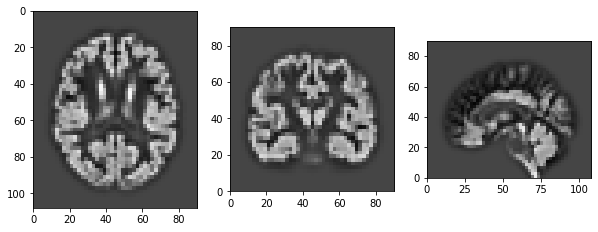

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8316951302406722 set 2 0.8080054739920147 avg 0.8198503021163435
svm set 1 0.3867632305473921 set 2 0.40856999253232584 avg 0.39766661153985894
mlp set 1 -2.18545199357254 set 2 -2.7444547134455264 avg -2.464953353509033
Average set 1 -0.3223312109281585 set 2 -0.5092930823070619 total -0.41581214661761023
Visualisation of Preprocessing:


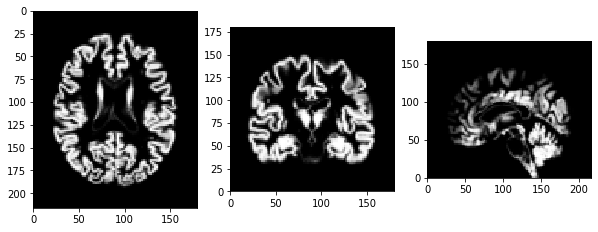

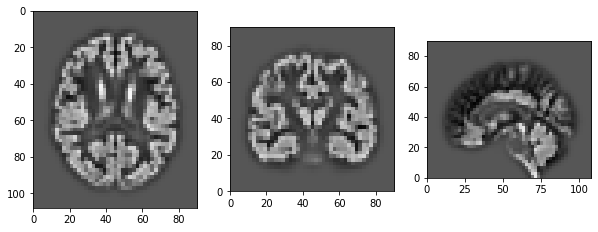

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.868488435021641 set 2 0.8280150129467067 avg 0.8482517239841738
svm set 1 0.4848854274524514 set 2 0.4251408899575317 avg 0.45501315870499154
mlp set 1 -1.491424891175786 set 2 -1.5220298387828723 avg -1.5067273649793291
Average set 1 -0.046017009567231204 set 2 -0.08962464529287802 total -0.0678208274300546
Visualisation of Preprocessing:


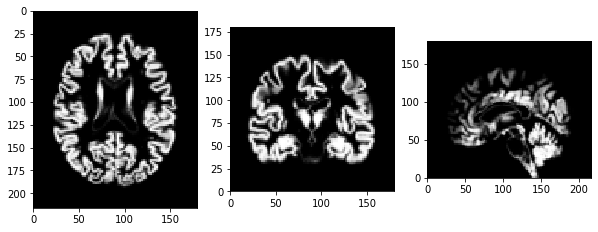

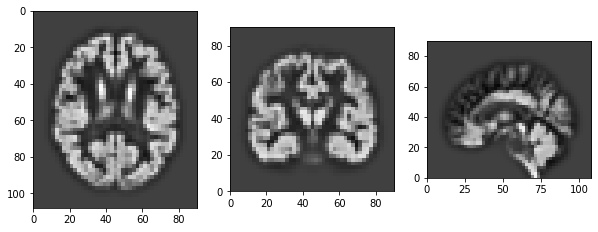

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8441467672736104 set 2 0.8302099225686245 avg 0.8371783449211174
svm set 1 0.449131468268966 set 2 0.45374226650573957 avg 0.4514368673873528
mlp set 1 -1.8108046212850821 set 2 -1.7201951783582738 avg -1.765499899821678
Average set 1 -0.17250879524750187 set 2 -0.1454143297613033 total -0.15896156250440258
Visualisation of Preprocessing:


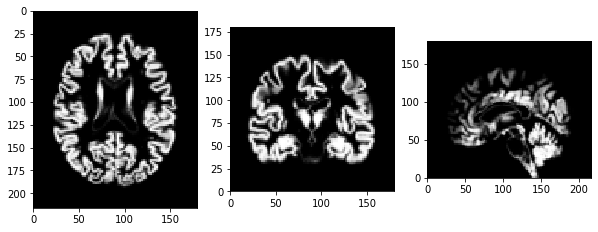

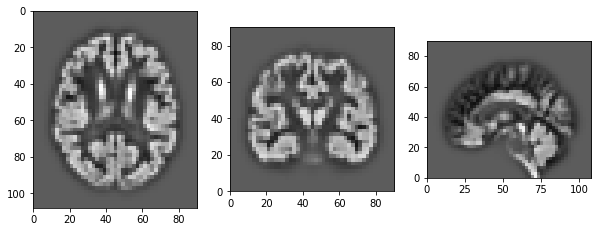

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8370529359676607 set 2 0.8163463655601075 avg 0.8266996507638842
svm set 1 0.3729809369572515 set 2 0.4258995987228241 avg 0.39944026784003783
mlp set 1 -1.6283759788412906 set 2 -2.536944189759013 avg -2.082660084300152
Average set 1 -0.13944736863879278 set 2 -0.4315660751586938 total -0.28550672189874327
Visualisation of Preprocessing:


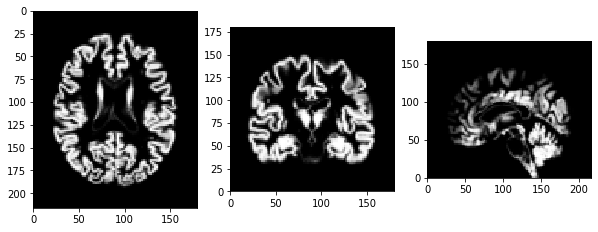

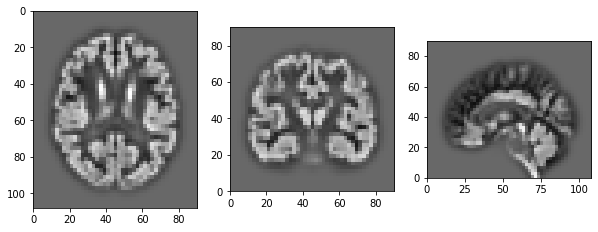

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8457225053252206 set 2 0.8514779177209338 avg 0.8486002115230773
svm set 1 0.552655404536115 set 2 0.5668046756159684 avg 0.5597300400760417
mlp set 1 -0.8546223396204881 set 2 -0.9662209778644172 avg -0.9104216587424526
Average set 1 0.18125185674694919 set 2 0.15068720515749504 total 0.1659695309522221
Visualisation of Preprocessing:


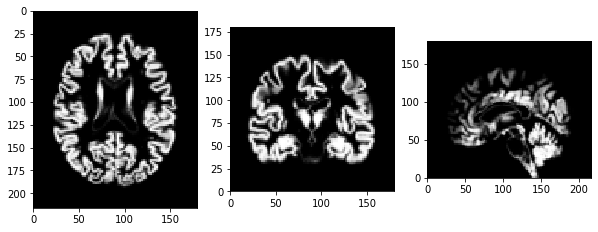

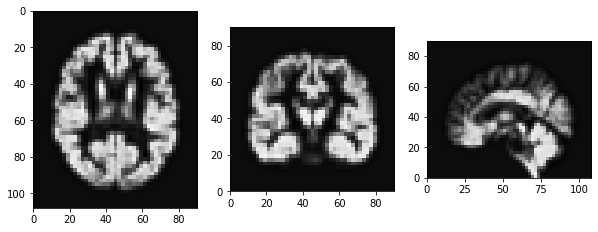

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8484387511459782 set 2 0.8406876915296405 avg 0.8445632213378094
svm set 1 0.5115221048015367 set 2 0.49172893800044254 avg 0.5016255214009896
mlp set 1 -1.3738220739760543 set 2 -1.2913885872315638 avg -1.332605330603809
Average set 1 -0.004620406009513116 set 2 0.013676014099506398 total 0.004527804044996642
Visualisation of Preprocessing:


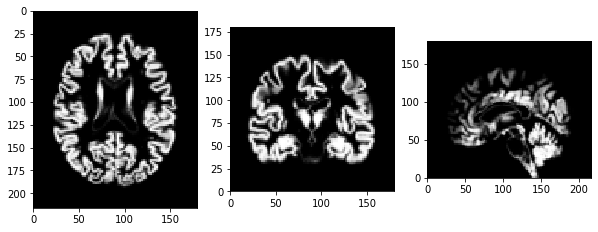

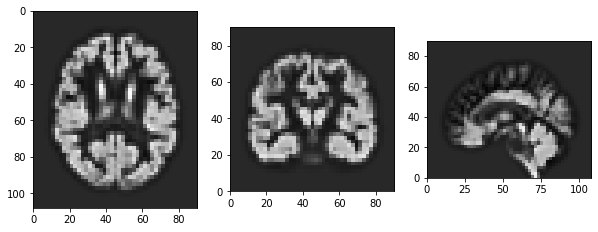

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.850886098122491 set 2 0.8304988747006681 avg 0.8406924864115796
svm set 1 0.43488456171679624 set 2 0.4600299939907488 avg 0.44745727785377254
mlp set 1 -1.6939572348309184 set 2 -2.0150425026796936 avg -1.854499868755306
Average set 1 -0.13606219166387704 set 2 -0.24150454466275892 total -0.18878336816331798
Visualisation of Preprocessing:


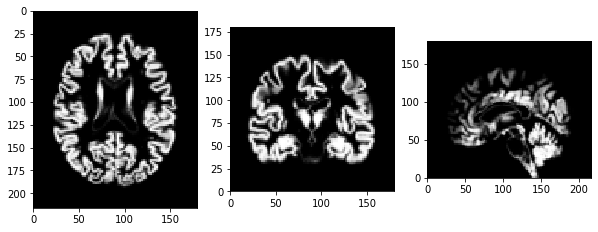

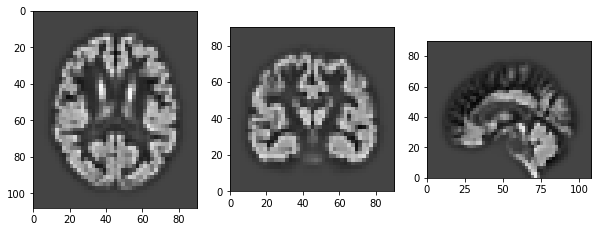

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8483301105305919 set 2 0.8445775335714818 avg 0.8464538220510369
svm set 1 0.5517010521275855 set 2 0.49406959424940217 avg 0.5228853231884938
mlp set 1 -0.9845135367956571 set 2 -1.118743872926192 avg -1.0516287048609245
Average set 1 0.13850587528750677 set 2 0.07330108496489733 total 0.10590348012620204
Visualisation of Preprocessing:


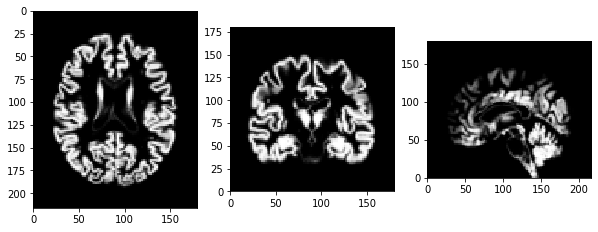

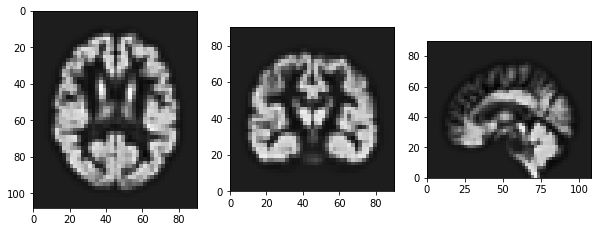

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8417541252120186 set 2 0.8246977029230161 avg 0.8332259140675173
svm set 1 0.49356165004555574 set 2 0.4196265599203748 avg 0.45659410498296527
mlp set 1 -1.7344893575616083 set 2 -1.3817719417010164 avg -1.5581306496313123
Average set 1 -0.1330578607680113 set 2 -0.04581589295254185 total -0.08943687686027657
Visualisation of Preprocessing:


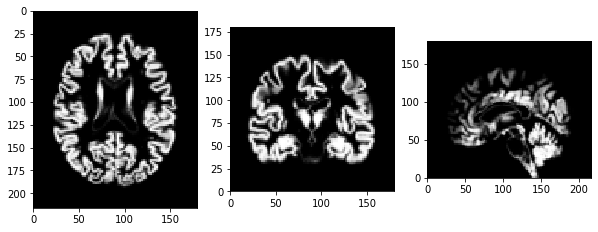

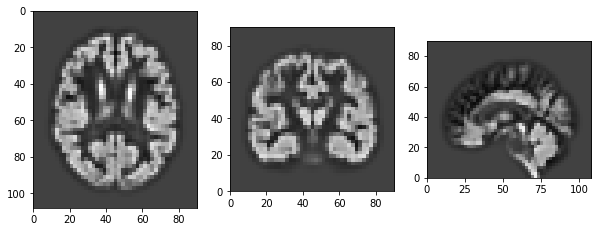

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8648137878290725 set 2 0.8114591900813197 avg 0.8381364889551961
svm set 1 0.42262148150838813 set 2 0.3704546126288132 avg 0.39653804706860063
mlp set 1 -2.1034639639914188 set 2 -1.890871447672298 avg -1.9971677058318584
Average set 1 -0.2720095648846527 set 2 -0.23631921498738842 total -0.2541643899360206
Visualisation of Preprocessing:


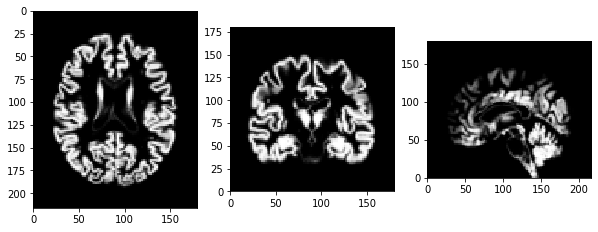

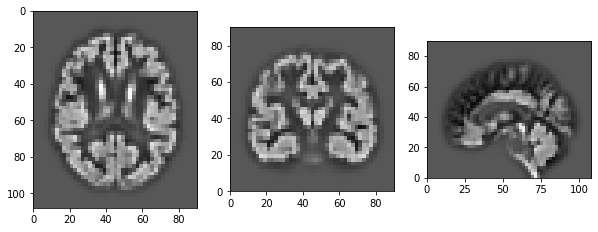

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8541641397986784 set 2 0.8487924047284786 avg 0.8514782722635785
svm set 1 0.5265290100804971 set 2 0.5236161681213949 avg 0.525072589100946
mlp set 1 -1.3396849911107265 set 2 -1.0213167165248267 avg -1.1805008538177766
Average set 1 0.013669386256149737 set 2 0.11703061877501557 total 0.06535000251558265
Visualisation of Preprocessing:


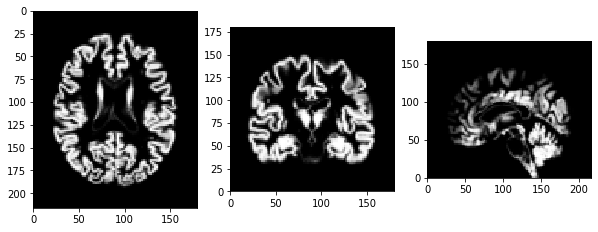

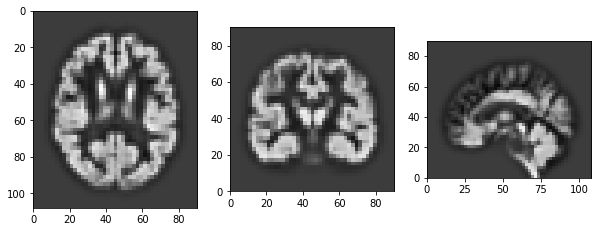

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8450088584930224 set 2 0.8222085524134765 avg 0.8336087054532495
svm set 1 0.4725836069903013 set 2 0.46400993967763793 avg 0.4682967733339696
mlp set 1 -1.6017223448409388 set 2 -1.4184789102728987 avg -1.5101006275569189
Average set 1 -0.09470995978587167 set 2 -0.044086806060594785 total -0.06939838292323322
Visualisation of Preprocessing:


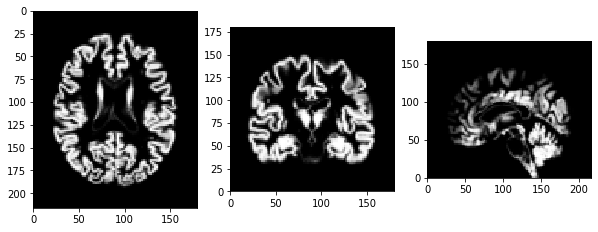

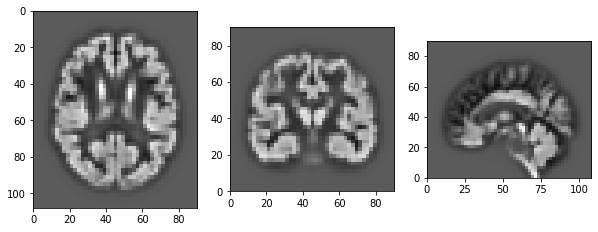

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8309728335492521 set 2 0.8384527031130449 avg 0.8347127683311485
svm set 1 0.4151302694978599 set 2 0.4807449520381758 avg 0.44793761076801786
mlp set 1 -1.359779411294849 set 2 -2.140884642721884 avg -1.7503320270083664
Average set 1 -0.03789210274924567 set 2 -0.2738956625235544 total -0.15589388263640003
Visualisation of Preprocessing:


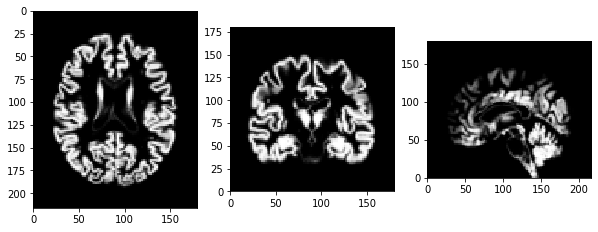

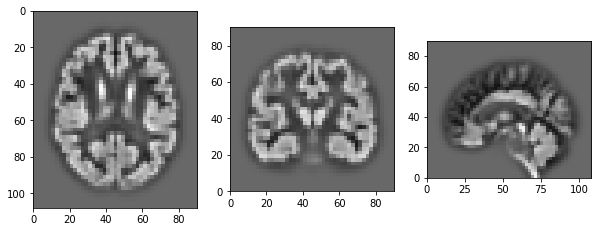

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8597150149991187 set 2 0.8436602324156022 avg 0.8516876237073605
svm set 1 0.6210148379340681 set 2 0.6459297074949438 avg 0.6334722727145059
mlp set 1 -0.1565314660255972 set 2 -0.6783021348543223 avg -0.41741680043995977
Average set 1 0.4413994623025299 set 2 0.27042926835207454 total 0.35591436532730225
Visualisation of Preprocessing:


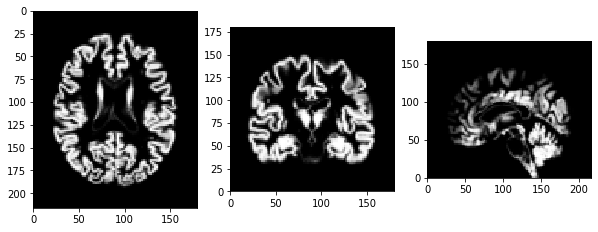

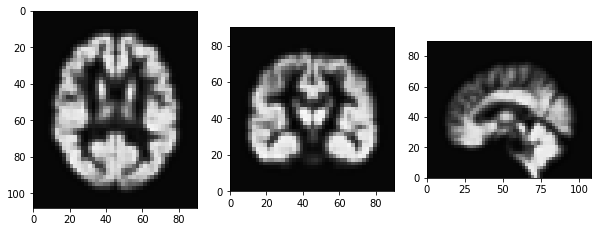

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8572050330308938 set 2 0.851424768765767 avg 0.8543149008983304
svm set 1 0.5900977781039873 set 2 0.615945904088359 avg 0.6030218410961732
mlp set 1 -0.5386457378679006 set 2 -0.9770786510507234 avg -0.757862194459312
Average set 1 0.3028856910889935 set 2 0.16343067393446753 total 0.2331581825117305
Visualisation of Preprocessing:


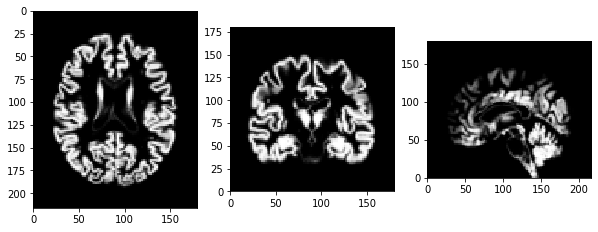

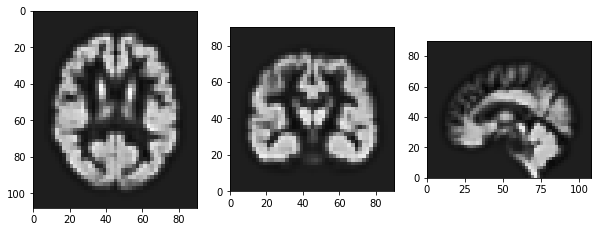

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8567934302910771 set 2 0.8600356229100751 avg 0.858414526600576
svm set 1 0.5025003647288879 set 2 0.5402093778715824 avg 0.5213548713002352
mlp set 1 -0.9343672846945004 set 2 -1.3153685985904238 avg -1.124867941642462
Average set 1 0.14164217010848823 set 2 0.028292134063744534 total 0.08496715208611638
Visualisation of Preprocessing:


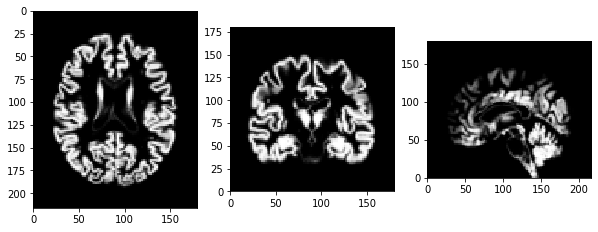

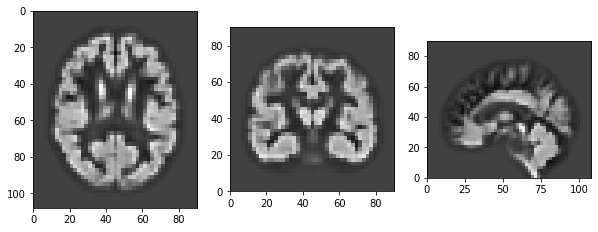

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.844082412033427 set 2 0.8545574745164011 avg 0.8493199432749141
svm set 1 0.605033438435366 set 2 0.612751865661628 avg 0.608892652048497
mlp set 1 -0.48419371505186004 set 2 -0.47699848289403035 avg -0.4805960989729452
Average set 1 0.32164071180564435 set 2 0.33010361909466623 total 0.3258721654501553
Visualisation of Preprocessing:


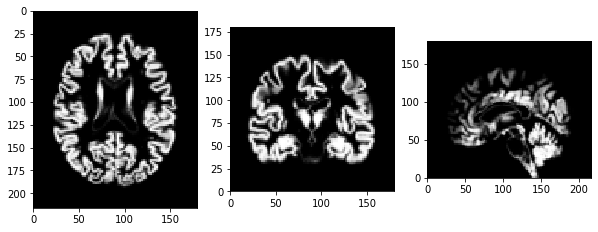

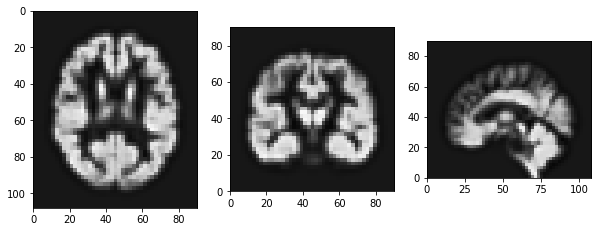

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8230780783746584 set 2 0.8645490228301487 avg 0.8438135506024036
svm set 1 0.520262441796469 set 2 0.5265636640977371 avg 0.523413052947103
mlp set 1 -1.0341476760651118 set 2 -0.8722849746516086 avg -0.9532163253583602
Average set 1 0.10306428136867189 set 2 0.17294257075875907 total 0.1380034260637155
Visualisation of Preprocessing:


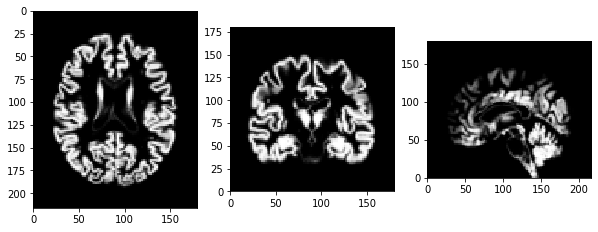

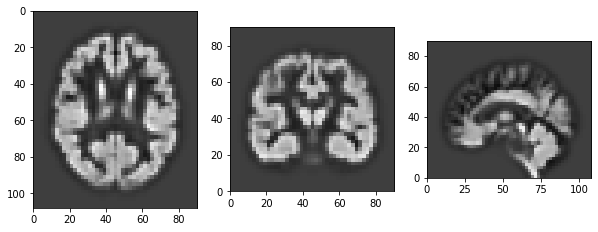

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.818125934021905 set 2 0.8553540181825932 avg 0.8367399761022492
svm set 1 0.49576290270186263 set 2 0.5168190621428899 avg 0.5062909824223762
mlp set 1 -1.1950806017735456 set 2 -1.2375768576042456 avg -1.2163287296888956
Average set 1 0.03960274498340732 set 2 0.0448654075737458 total 0.04223407627857656
Visualisation of Preprocessing:


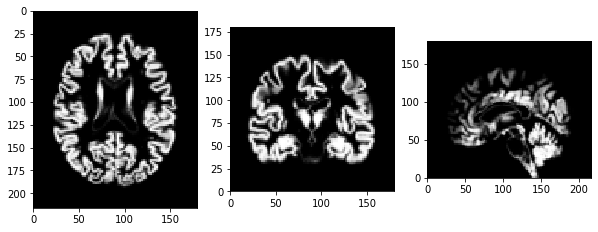

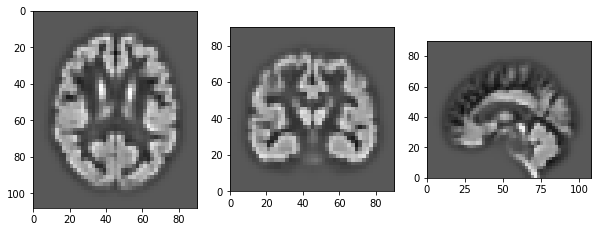

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8469063945089359 set 2 0.8570641961207262 avg 0.851985295314831
svm set 1 0.6043066025666307 set 2 0.6189472890388417 avg 0.6116269458027361
mlp set 1 -0.5367488601266404 set 2 -0.4153893787049961 avg -0.4760691194158182
Average set 1 0.3048213789829754 set 2 0.35354070215152394 total 0.32918104056724967
Visualisation of Preprocessing:


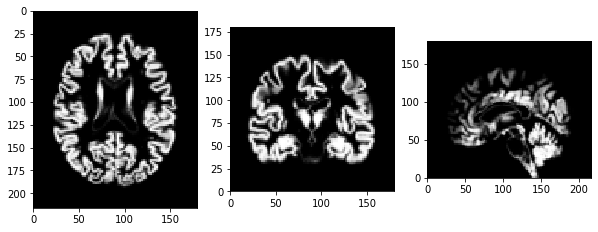

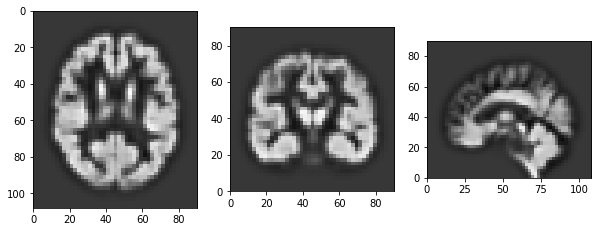

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8384418256443696 set 2 0.8494257606639578 avg 0.8439337931541637
svm set 1 0.5086523235284397 set 2 0.556003748981887 avg 0.5323280362551633
mlp set 1 -0.7669848034395654 set 2 -1.1880611090449302 avg -0.9775229562422478
Average set 1 0.19336978191108134 set 2 0.07245613353363822 total 0.13291295772235978
Visualisation of Preprocessing:


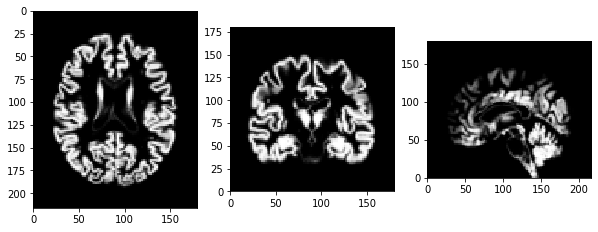

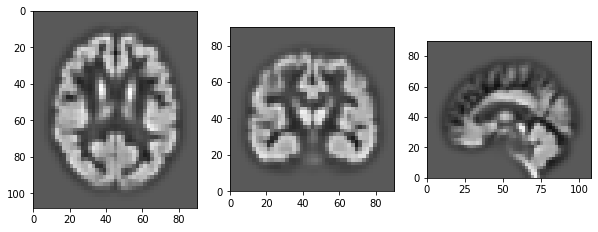

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8407038998305827 set 2 0.8606638772122759 avg 0.8506838885214293
svm set 1 0.5025672722796823 set 2 0.5127301717298469 avg 0.5076487220047646
mlp set 1 -1.4240512875497187 set 2 -1.2661840582211905 avg -1.3451176728854546
Average set 1 -0.026926705146484542 set 2 0.0357366635736441 total 0.004404979213579779
Visualisation of Preprocessing:


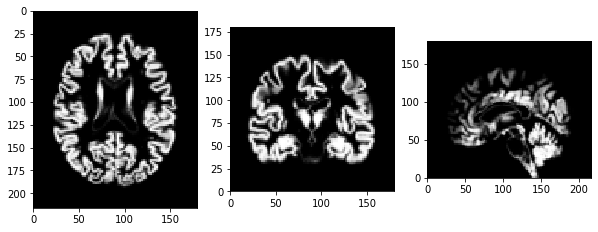

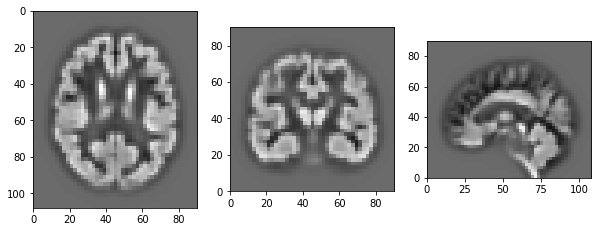

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8655801040491439 set 2 0.8553894910522429 avg 0.8604847975506934
svm set 1 0.6044611466420031 set 2 0.6550296902107933 avg 0.6297454184263982
mlp set 1 -0.10613823671110012 set 2 -0.2551745222316746 avg -0.18065637947138735
Average set 1 0.454634337993349 set 2 0.41841488634378726 total 0.43652461216856814
Visualisation of Preprocessing:


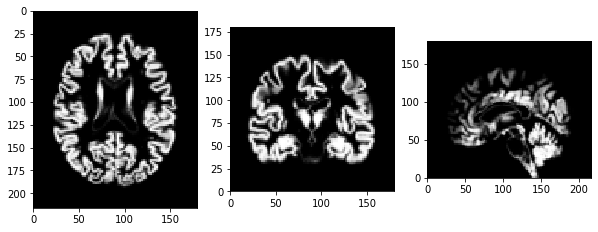

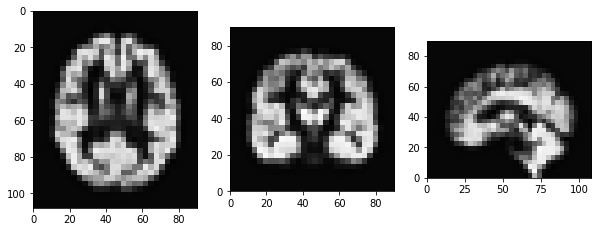

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8466506673879973 set 2 0.836434794325446 avg 0.8415427308567216
svm set 1 0.5447300927012981 set 2 0.6124217970526042 avg 0.5785759448769512
mlp set 1 -0.24091492363938571 set 2 -0.7243507182690245 avg -0.4826328209542051
Average set 1 0.3834886121499699 set 2 0.24150195770300856 total 0.3124952849264892
Visualisation of Preprocessing:


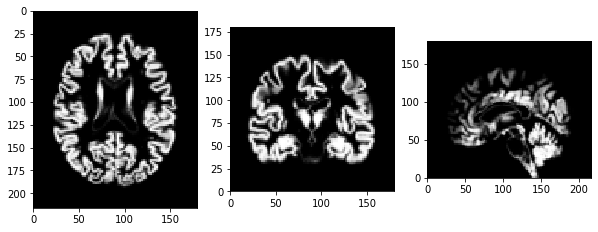

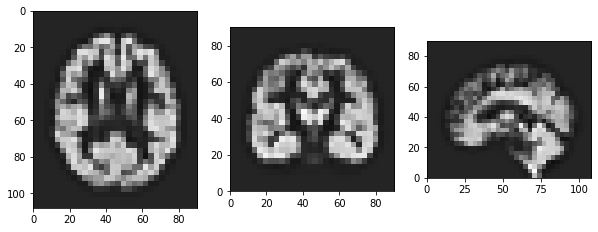

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8559226738324808 set 2 0.8447070001828761 avg 0.8503148370076785
svm set 1 0.5711819462847951 set 2 0.5470743212220853 avg 0.5591281337534402
mlp set 1 -0.5314924672650396 set 2 -0.896298437562522 avg -0.7138954524137808
Average set 1 0.2985373842840788 set 2 0.16516096128081315 total 0.23184917278244596
Visualisation of Preprocessing:


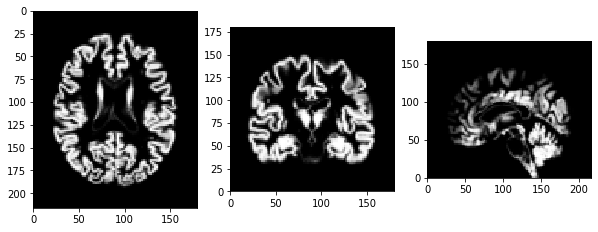

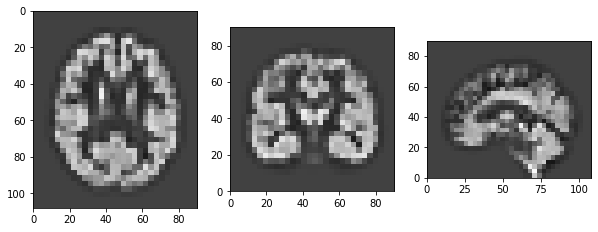

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8520347334760905 set 2 0.8455870714501269 avg 0.8488109024631088
svm set 1 0.607974560393826 set 2 0.6232913565594822 avg 0.6156329584766541
mlp set 1 -0.13214112887973628 set 2 -0.5779468068994136 avg -0.35504396788957493
Average set 1 0.4426227216633934 set 2 0.29697720703673186 total 0.3697999643500626
Visualisation of Preprocessing:


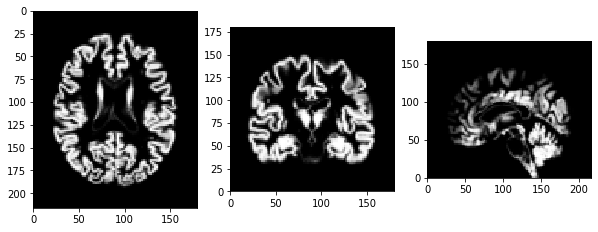

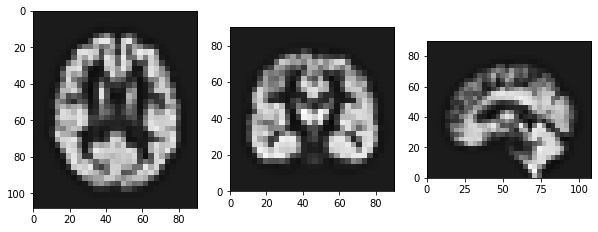

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8417876989459941 set 2 0.8480012753038071 avg 0.8448944871249007
svm set 1 0.5384350183480597 set 2 0.5806588152040661 avg 0.5595469167760629
mlp set 1 -0.6737337915162829 set 2 -0.6138632852014987 avg -0.6437985383588908
Average set 1 0.2354963085925903 set 2 0.27159893510212485 total 0.2535476218473576
Visualisation of Preprocessing:


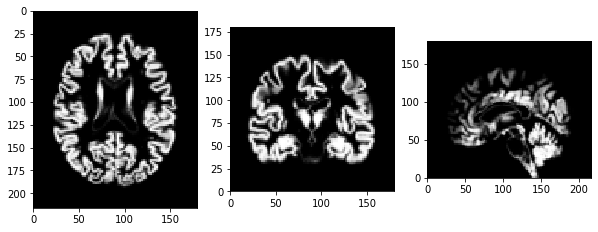

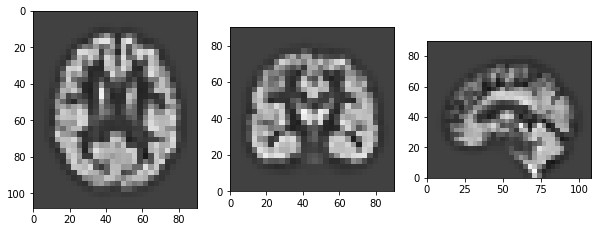

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8376288997892968 set 2 0.8427873110440304 avg 0.8402081054166636
svm set 1 0.47000033603611463 set 2 0.5105386998040495 avg 0.4902695179200821
mlp set 1 -0.7496545018880456 set 2 -1.1559865603614026 avg -0.9528205311247241
Average set 1 0.1859915779791219 set 2 0.0657798168288924 total 0.12588569740400715
Visualisation of Preprocessing:


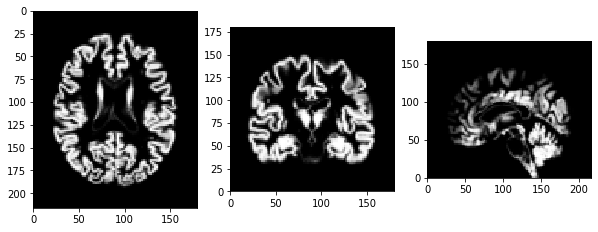

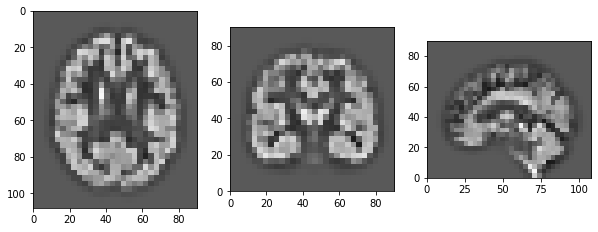

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8610225781461247 set 2 0.8425531302561158 avg 0.8517878542011202
svm set 1 0.593734309665823 set 2 0.5823434706018789 avg 0.5880388901338509
mlp set 1 -0.5026546905641918 set 2 -0.44394579734768874 avg -0.4733002439559403
Average set 1 0.3173673990825853 set 2 0.32698360117010195 total 0.32217550012634366
Visualisation of Preprocessing:


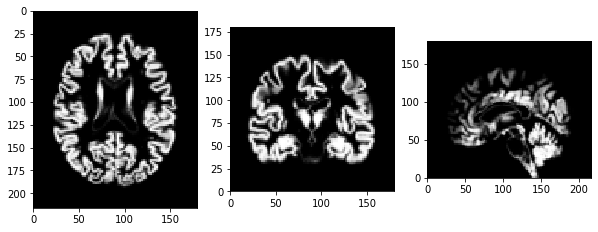

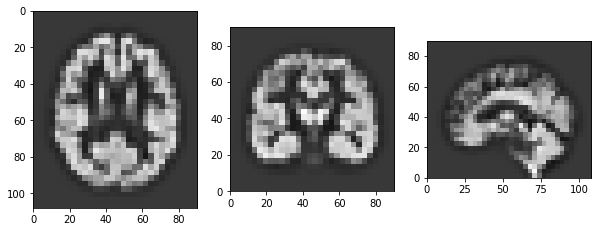

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8508055624562789 set 2 0.8401803039037821 avg 0.8454929331800305
svm set 1 0.5410571054511631 set 2 0.551157823974288 avg 0.5461074647127255
mlp set 1 -0.6631098457198696 set 2 -0.9558141508920093 avg -0.8094619983059395
Average set 1 0.24291760739585744 set 2 0.14517465899535362 total 0.19404613319560554
Visualisation of Preprocessing:


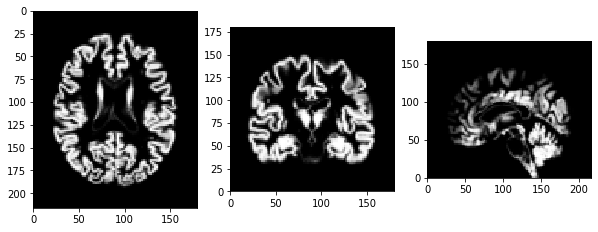

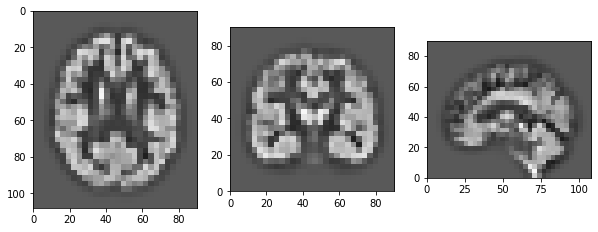

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8278816204916362 set 2 0.8539016533763458 avg 0.8408916369339909
svm set 1 0.5109301298368261 set 2 0.48624929000602984 avg 0.4985897099214279
mlp set 1 -1.1228370432153238 set 2 -0.9322543030213299 avg -1.0275456731183268
Average set 1 0.0719915690377128 set 2 0.13596554678701525 total 0.10397855791236402
Visualisation of Preprocessing:


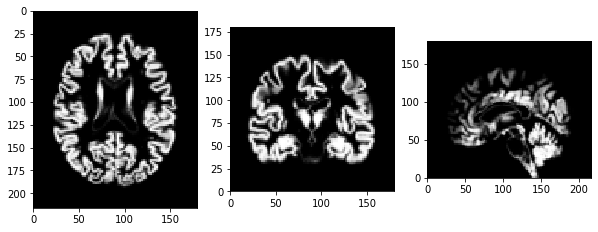

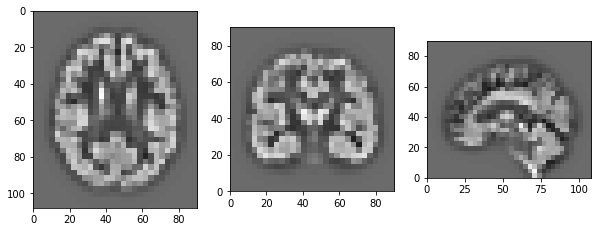

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8534062445062122 set 2 0.8577500346258571 avg 0.8555781395660347
svm set 1 0.6509468066399647 set 2 0.6431988390515837 avg 0.6470728228457743
mlp set 1 -0.005723925455618728 set 2 -0.15836547565138082 avg -0.08204470055349977
Average set 1 0.4995430418968527 set 2 0.44752779934201997 total 0.4735354206194363
Visualisation of Preprocessing:


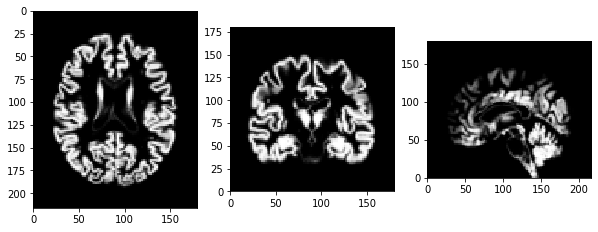

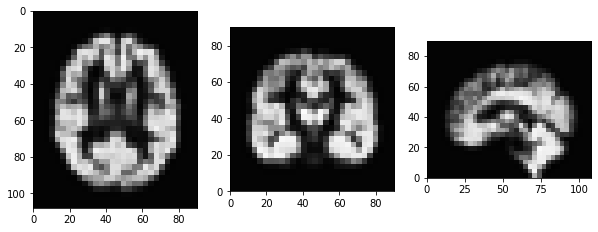

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8477793420162919 set 2 0.8430972052163697 avg 0.8454382736163308
svm set 1 0.6440113869967095 set 2 0.6380607621191452 avg 0.6410360745579273
mlp set 1 -0.4177224483463354 set 2 -0.2698952902059859 avg -0.3438088692761606
Average set 1 0.35802276022222207 set 2 0.403754225709843 total 0.38088849296603255
Visualisation of Preprocessing:


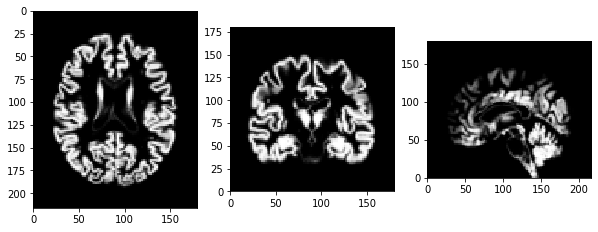

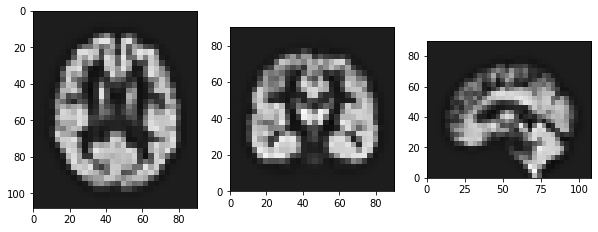

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8429804132072832 set 2 0.8588192856710729 avg 0.8508998494391781
svm set 1 0.5970873259768767 set 2 0.6137746673029367 avg 0.6054309966399067
mlp set 1 -0.5363312652714216 set 2 -0.8155284811685249 avg -0.6759298732199732
Average set 1 0.30124549130424616 set 2 0.2190218239351616 total 0.26013365761970386
Visualisation of Preprocessing:


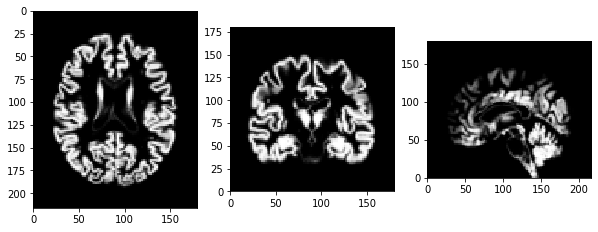

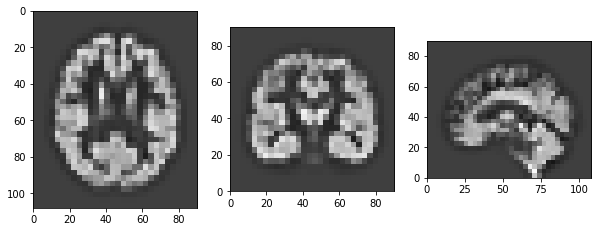

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8549418112298728 set 2 0.8369489932249766 avg 0.8459454022274246
svm set 1 0.644598746851431 set 2 0.6242568249243796 avg 0.6344277858879053
mlp set 1 -0.2427571762910996 set 2 -0.20528251666683103 avg -0.22401984647896533
Average set 1 0.4189277939300681 set 2 0.4186411004941751 total 0.4187844472121216
Visualisation of Preprocessing:


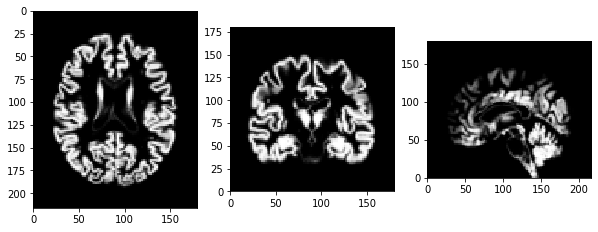

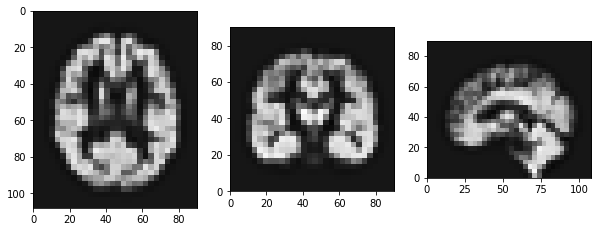

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8519771852103216 set 2 0.8519222636305633 avg 0.8519497244204425
svm set 1 0.6061506925181418 set 2 0.5948806969848663 avg 0.600515694751504
mlp set 1 -0.7444560476174227 set 2 -0.39857666804143976 avg -0.5715163578294312
Average set 1 0.2378906100370136 set 2 0.34940876419133 total 0.2936496871141718
Visualisation of Preprocessing:


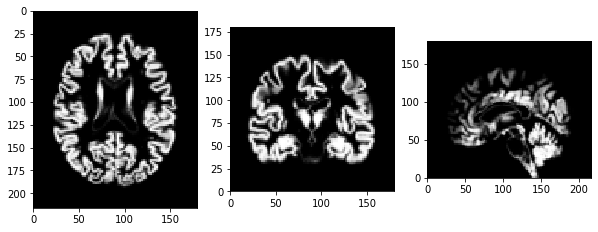

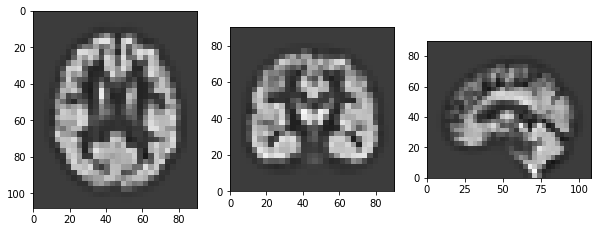

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8457150146875358 set 2 0.8391175188028438 avg 0.8424162667451898
svm set 1 0.5351837623838895 set 2 0.5650389401631595 avg 0.5501113512735245
mlp set 1 -0.7839538927011597 set 2 -0.8003076591154967 avg -0.7921307759083283
Average set 1 0.1989816281234219 set 2 0.20128293328350222 total 0.20013228070346206
Visualisation of Preprocessing:


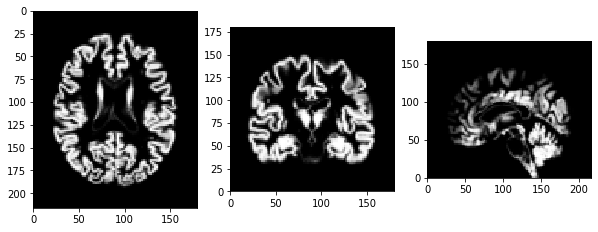

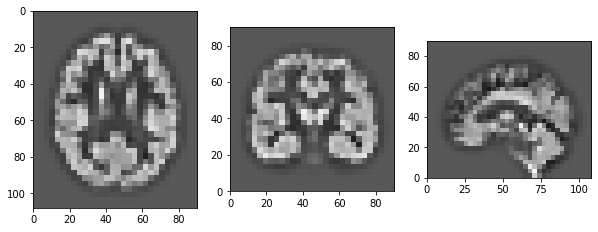

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8236484135917389 set 2 0.8518776849871174 avg 0.8377630492894281
svm set 1 0.6347642491898451 set 2 0.6146296035414532 avg 0.6246969263656492
mlp set 1 -0.44198068820382735 set 2 -0.31657302208739035 avg -0.3792768551456088
Average set 1 0.33881065819258555 set 2 0.3833114221470601 total 0.3610610401698228
Visualisation of Preprocessing:


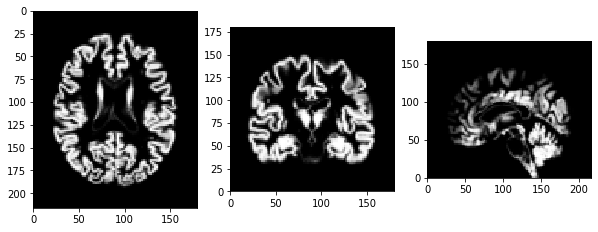

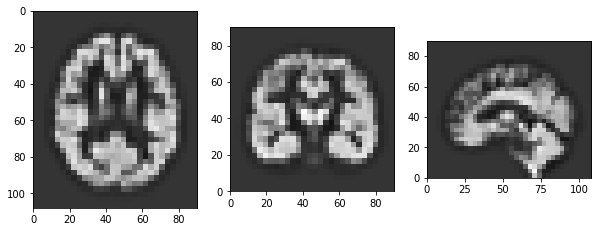

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8382461216056567 set 2 0.8555353304567267 avg 0.8468907260311918
svm set 1 0.589233065069475 set 2 0.5690435845974509 avg 0.579138324833463
mlp set 1 -0.729153819071352 set 2 -0.6142832083681362 avg -0.6717185137197441
Average set 1 0.23277512253459323 set 2 0.27009856889534717 total 0.2514368457149702
Visualisation of Preprocessing:


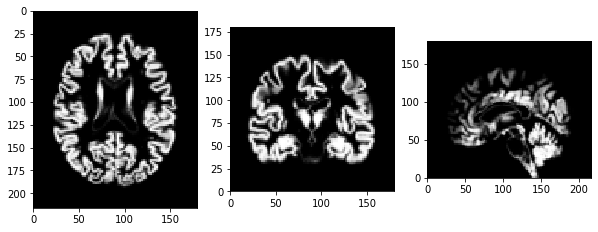

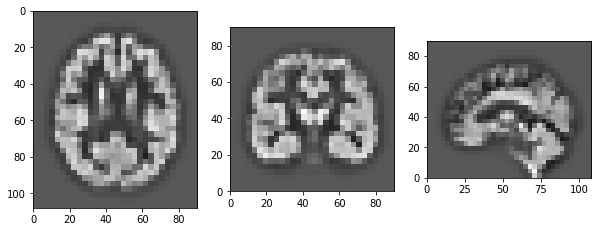

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8347664955992141 set 2 0.8487341507667497 avg 0.8417503231829819
svm set 1 0.5319217794854528 set 2 0.5304645942220676 avg 0.5311931868537603
mlp set 1 -1.0092115784341646 set 2 -0.6814513759365428 avg -0.8453314771853537
Average set 1 0.11915889888350077 set 2 0.23258245635075822 total 0.1758706776171295
Visualisation of Preprocessing:


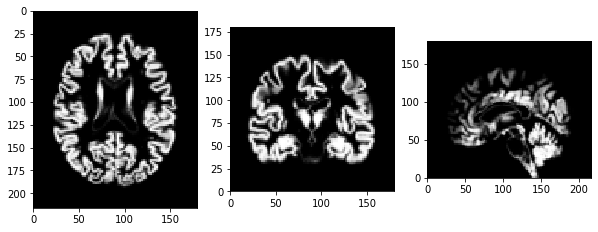

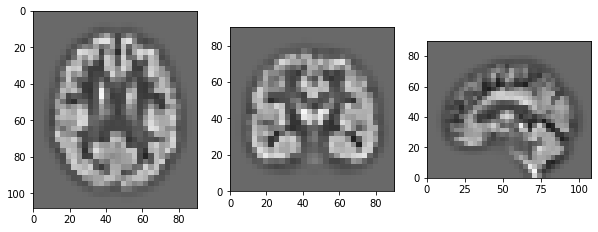

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8504227269647969 set 2 0.8520556160044801 avg 0.8512391714846386
svm set 1 0.6635160056840448 set 2 0.6852309322933088 avg 0.6743734689886768
mlp set 1 -0.0367262218533817 set 2 0.10852714860260837 avg 0.035900463374613334
Average set 1 0.4924041702651533 set 2 0.5486045656334658 total 0.5205043679493095
Visualisation of Preprocessing:


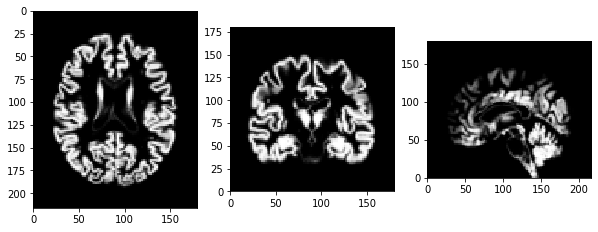

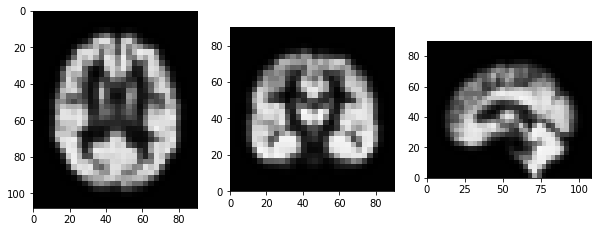

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8576844975756972 set 2 0.8620864562518472 avg 0.8598854769137723
svm set 1 0.658047253241762 set 2 0.6529095504486789 avg 0.6554784018452204
mlp set 1 -0.09406620549895739 set 2 -0.15384181641973904 avg -0.12395401095934822
Average set 1 0.4738885151061673 set 2 0.45371806342692905 total 0.4638032892665482
Visualisation of Preprocessing:


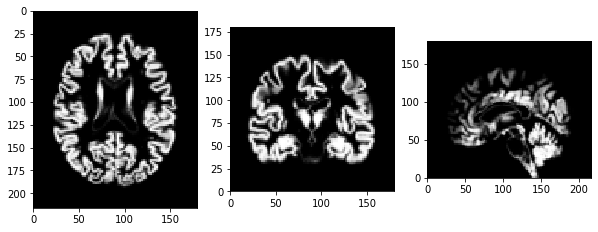

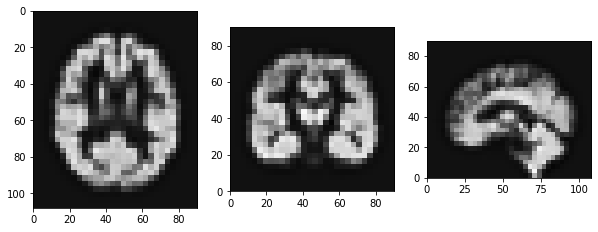

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8519196451038933 set 2 0.8503412275957727 avg 0.851130436349833
svm set 1 0.6604662204739875 set 2 0.6561145937829654 avg 0.6582904071284765
mlp set 1 -0.25631591022284805 set 2 -0.5407910187134486 avg -0.3985534644681483
Average set 1 0.41868998511834427 set 2 0.32188826755509653 total 0.3702891263367204
Visualisation of Preprocessing:


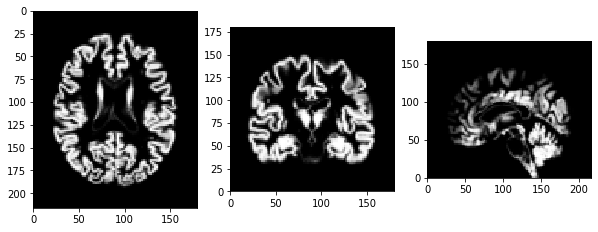

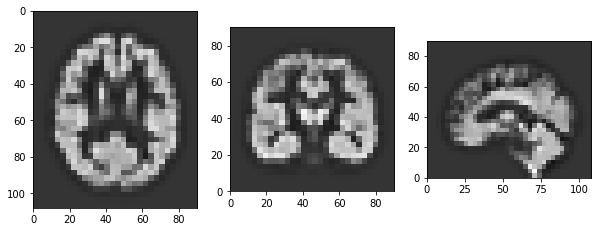

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8458086218827998 set 2 0.8577592557704192 avg 0.8517839388266095
svm set 1 0.6705505607328819 set 2 0.6865938414498842 avg 0.678572201091383
mlp set 1 -0.11319633539495921 set 2 -0.05908397334501325 avg -0.08614015436998623
Average set 1 0.46772094907357414 set 2 0.49508970795843005 total 0.4814053285160021
Visualisation of Preprocessing:


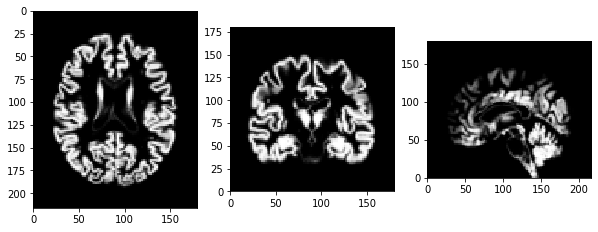

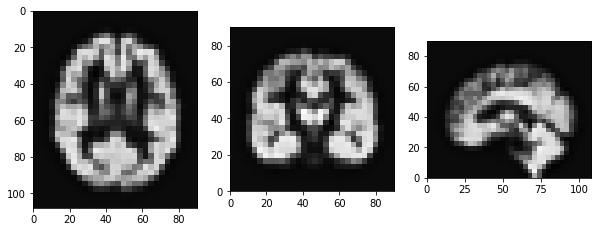

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8424369683366134 set 2 0.8453957641845137 avg 0.8439163662605635
svm set 1 0.6479689972136231 set 2 0.6478705828474476 avg 0.6479197900305353
mlp set 1 -0.07903568690831553 set 2 -0.4110293600546533 avg -0.2450325234814844
Average set 1 0.47045675954730704 set 2 0.36074566232576927 total 0.4156012109365381
Visualisation of Preprocessing:


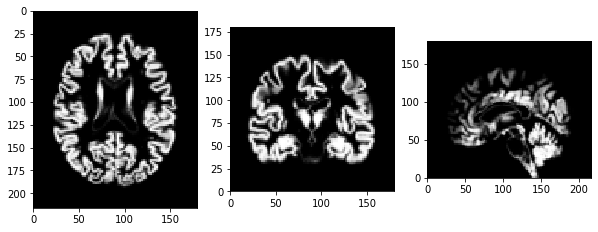

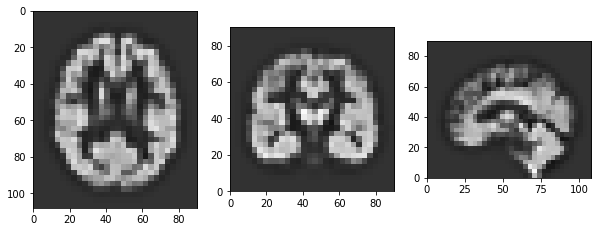

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8429765356628725 set 2 0.8418726589612737 avg 0.8424245973120731
svm set 1 0.6335310077568297 set 2 0.6186053281803586 avg 0.6260681679685942
mlp set 1 -0.634098437868958 set 2 -0.4002293193361399 avg -0.517163878602549
Average set 1 0.28080303518358135 set 2 0.35341622260183087 total 0.3171096288927061
Visualisation of Preprocessing:


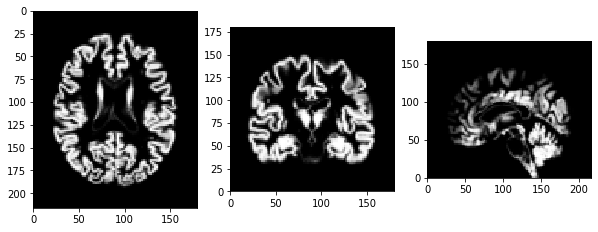

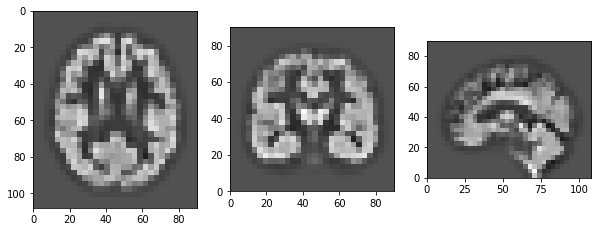

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8457537989600404 set 2 0.8630235407330152 avg 0.8543886698465278
svm set 1 0.6708560639842651 set 2 0.6698616869123055 avg 0.6703588754482853
mlp set 1 -0.21915709607100808 set 2 -0.09303265815005779 avg -0.15609487711053294
Average set 1 0.43248425562443255 set 2 0.47995085649842095 total 0.4562175560614268
Visualisation of Preprocessing:


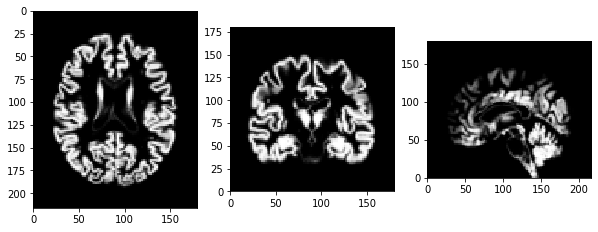

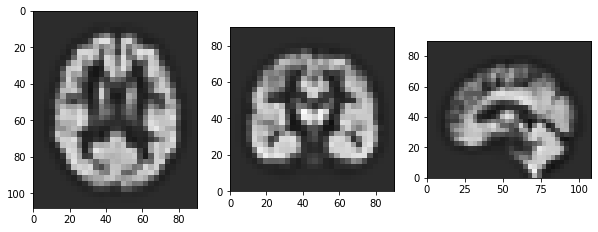

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8304467121789895 set 2 0.8392797303889742 avg 0.8348632212839818
svm set 1 0.596069448672869 set 2 0.612189917923009 avg 0.604129683297939
mlp set 1 -0.3878983965995453 set 2 -0.4351454290653183 avg -0.4115219128324318
Average set 1 0.3462059214174377 set 2 0.3387747397488883 total 0.342490330583163
Visualisation of Preprocessing:


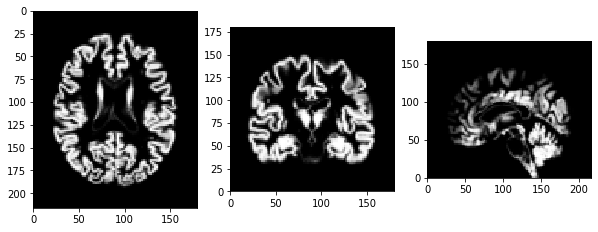

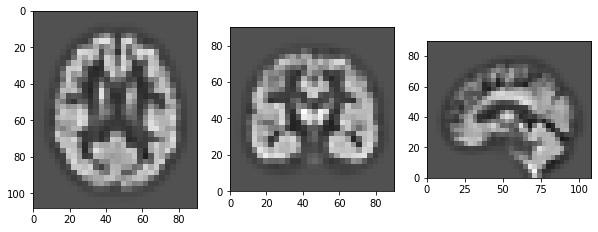

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8341827434401898 set 2 0.8625098798625056 avg 0.8483463116513477
svm set 1 0.5970342463961587 set 2 0.584787247881642 avg 0.5909107471389003
mlp set 1 -0.8997938305213136 set 2 -0.41896609166902077 avg -0.6593799610951672
Average set 1 0.17714105310501163 set 2 0.34277701202504224 total 0.25995903256502695
Visualisation of Preprocessing:


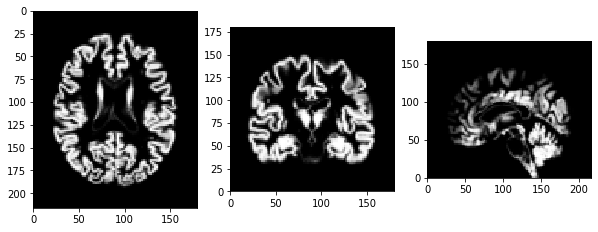

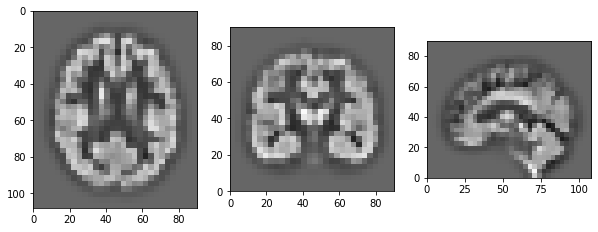

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8371336057373207 set 2 0.8355218387569217 avg 0.8363277222471212
svm set 1 0.6926980118093837 set 2 0.6913115337586015 avg 0.6920047727839926
mlp set 1 0.5604068975571557 set 2 0.39225973406014225 avg 0.47633331580864896
Average set 1 0.6967461717012867 set 2 0.6396977021918885 total 0.6682219369465876
Visualisation of Preprocessing:


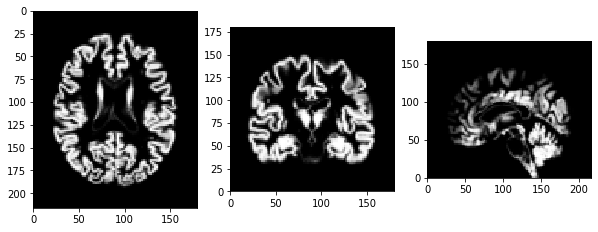

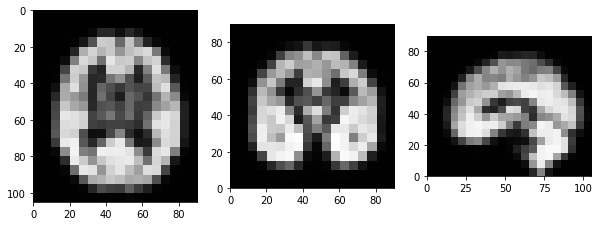

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8521451756358448 set 2 0.8468012427420968 avg 0.8494732091889707
svm set 1 0.6850902838216181 set 2 0.6993573906038345 avg 0.6922238372127263
mlp set 1 0.3780234309365205 set 2 0.4289820858589808 avg 0.4035027583977506
Average set 1 0.6384196301313277 set 2 0.6583802397349707 total 0.6483999349331493
Visualisation of Preprocessing:


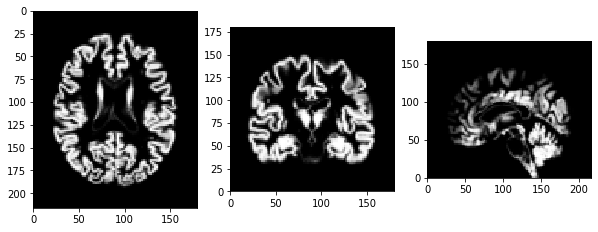

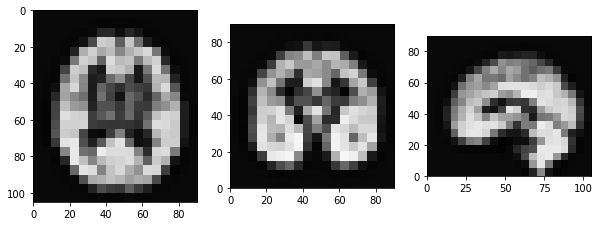

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8603197107145182 set 2 0.8452491908053507 avg 0.8527844507599345
svm set 1 0.674991214190362 set 2 0.6827684371151438 avg 0.6788798256527528
mlp set 1 0.40235064302225465 set 2 0.1944713455664293 avg 0.298410994294342
Average set 1 0.645887189309045 set 2 0.574162991162308 total 0.6100250902356765
Visualisation of Preprocessing:


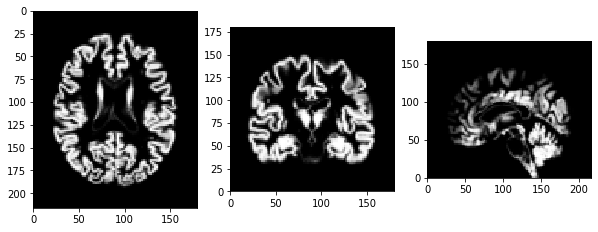

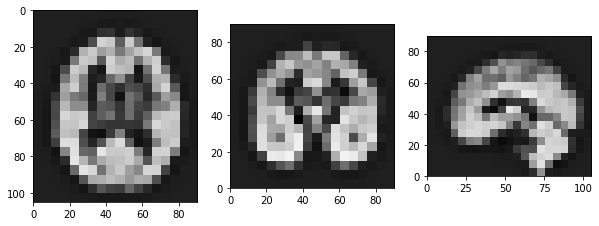

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8185707476260224 set 2 0.8610467432058874 avg 0.8398087454159548
svm set 1 0.6843681158608759 set 2 0.6954838495919149 avg 0.6899259827263954
mlp set 1 0.48312377940235696 set 2 0.5196182279083229 avg 0.5013710036553399
Average set 1 0.6620208809630851 set 2 0.6920496069020418 total 0.6770352439325634
Visualisation of Preprocessing:


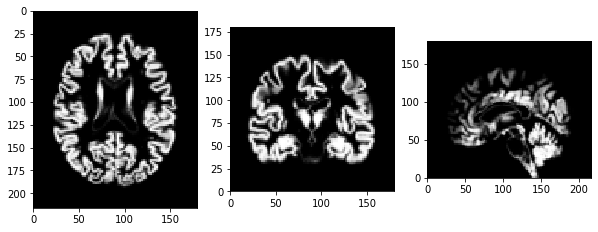

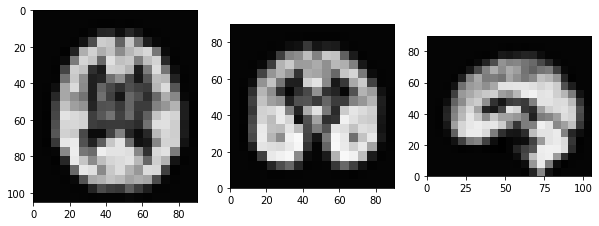

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.836940822383388 set 2 0.8374570356042669 avg 0.8371989289938274
svm set 1 0.6834325267719086 set 2 0.7091114866757471 avg 0.6962720067238278
mlp set 1 0.4862536111106304 set 2 0.23891905972785363 avg 0.362586335419242
Average set 1 0.6688756534219756 set 2 0.5951625273359559 total 0.6320190903789658
Visualisation of Preprocessing:


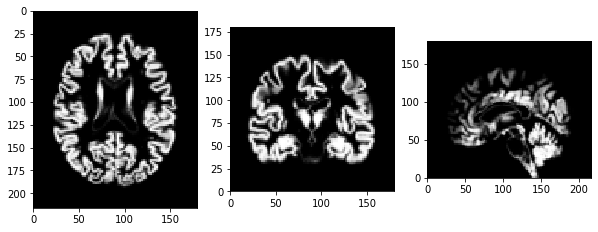

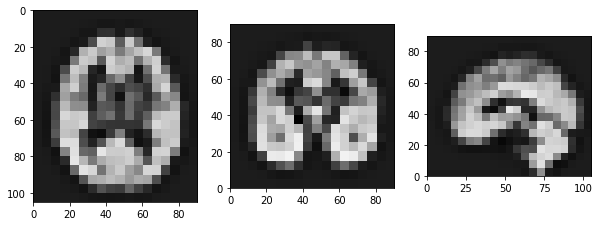

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8313730827704271 set 2 0.8598075644266701 avg 0.8455903235985486
svm set 1 0.6802428226658694 set 2 0.701187820631965 avg 0.6907153216489172
mlp set 1 0.25469229017453365 set 2 0.23400933909158583 avg 0.24435081463305974
Average set 1 0.5887693985369434 set 2 0.5983349080500736 total 0.5935521532935085
Visualisation of Preprocessing:


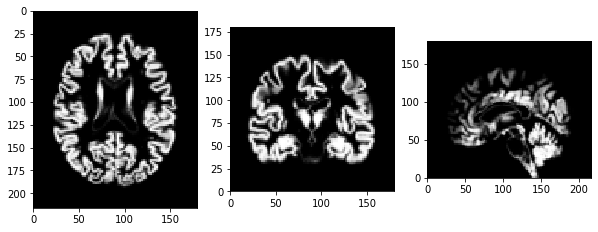

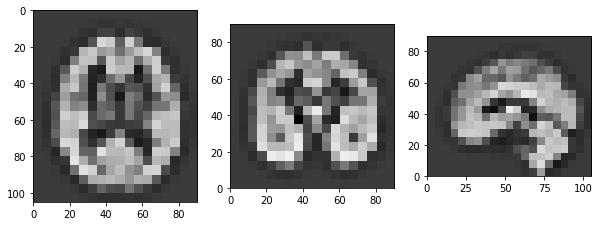

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8582327200628059 set 2 0.843330631272828 avg 0.850781675667817
svm set 1 0.6785783283266726 set 2 0.6930638309953115 avg 0.685821079660992
mlp set 1 0.27810608359049505 set 2 0.4256760866619693 avg 0.3518910851262322
Average set 1 0.6049723773266579 set 2 0.6540235163100363 total 0.629497946818347
Visualisation of Preprocessing:


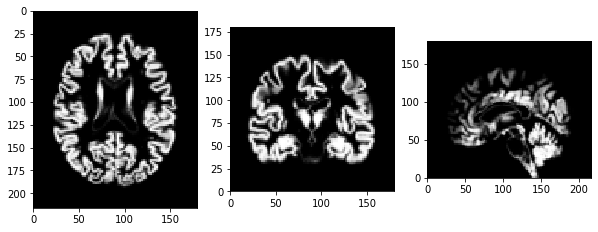

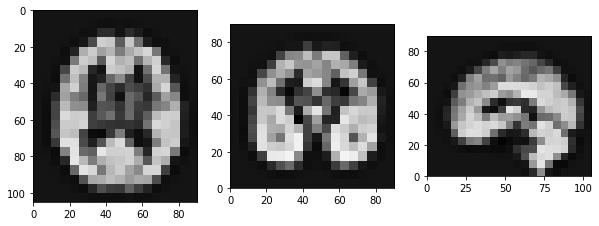

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8542509201448367 set 2 0.8478811940376825 avg 0.8510660570912596
svm set 1 0.6716174375026245 set 2 0.6941363325120509 avg 0.6828768850073377
mlp set 1 0.33163396776375087 set 2 0.16259018805610093 avg 0.2471120779099259
Average set 1 0.6191674418037373 set 2 0.5682025715352781 total 0.5936850066695076
Visualisation of Preprocessing:


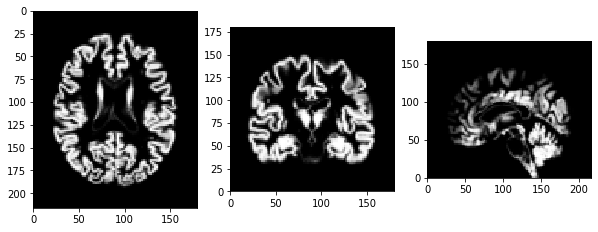

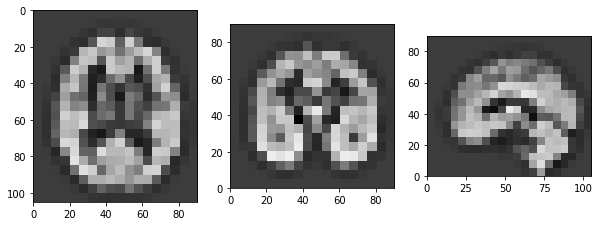

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8281956161966875 set 2 0.8442893310162672 avg 0.8362424736064773
svm set 1 0.6787245786299798 set 2 0.6658863098657664 avg 0.6723054442478731
mlp set 1 0.06936092820058937 set 2 0.29788795180317307 avg 0.18362444000188122
Average set 1 0.5254270410090855 set 2 0.6026878642284021 total 0.5640574526187438
Visualisation of Preprocessing:


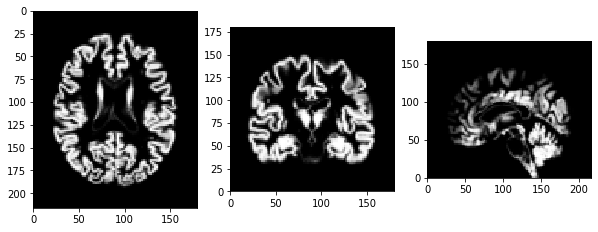

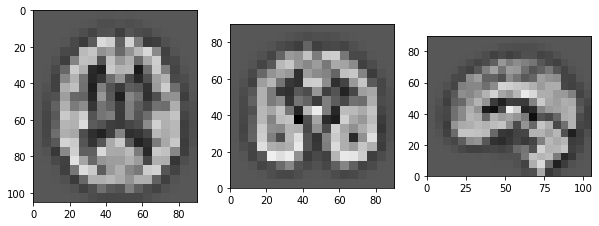

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8533055615078985 set 2 0.8287953839198042 avg 0.8410504727138514
svm set 1 0.6846567367806838 set 2 0.6952630809761426 avg 0.6899599088784132
mlp set 1 0.5163448638633555 set 2 0.4366915071688841 avg 0.4765181855161198
Average set 1 0.6847690540506459 set 2 0.6535833240216103 total 0.6691761890361281
Visualisation of Preprocessing:


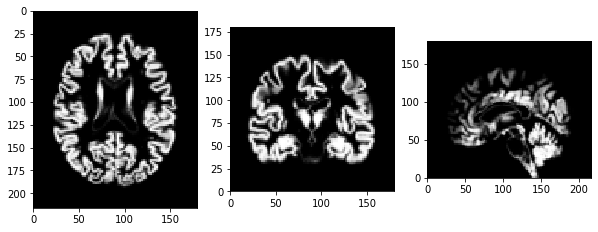

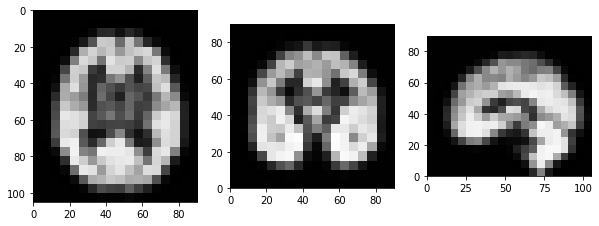

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8314601523750912 set 2 0.8404682848716544 avg 0.8359642186233728
svm set 1 0.6913334717089816 set 2 0.6834515458267701 avg 0.6873925087678758
mlp set 1 0.27931122920136464 set 2 0.5234909699586625 avg 0.4014010995800136
Average set 1 0.6007016177618125 set 2 0.6824702668856957 total 0.6415859423237541
Visualisation of Preprocessing:


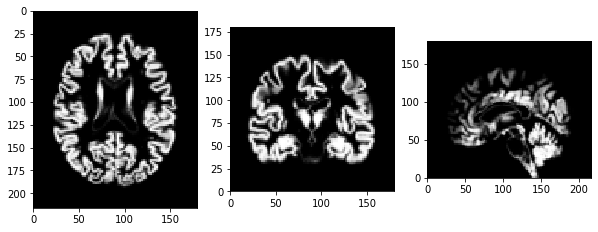

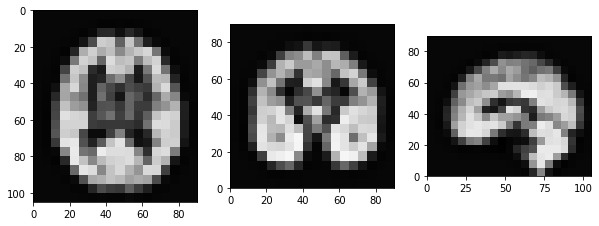

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8332423164945423 set 2 0.8661654814024827 avg 0.8497038989485125
svm set 1 0.6886474761105132 set 2 0.6968822600766889 avg 0.692764868093601
mlp set 1 0.2633940296472047 set 2 0.4428536381317895 avg 0.3531238338894971
Average set 1 0.59509460741742 set 2 0.6686337932036537 total 0.6318642003105368
Visualisation of Preprocessing:


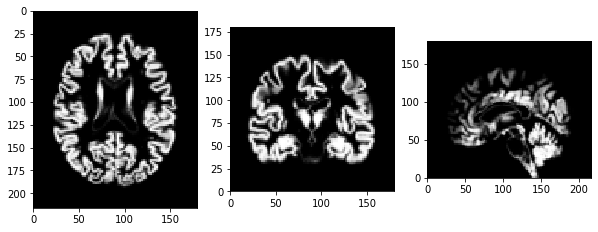

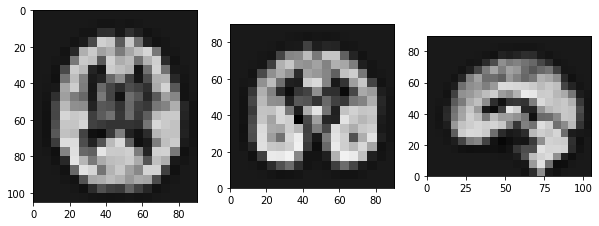

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8310882124795033 set 2 0.8274452339147494 avg 0.8292667231971264
svm set 1 0.6564658125465264 set 2 0.7042030240930008 avg 0.6803344183197636
mlp set 1 0.5082149644228193 set 2 0.44207311022169116 avg 0.47514403732225524
Average set 1 0.6652563298162829 set 2 0.6579071227431471 total 0.661581726279715
Visualisation of Preprocessing:


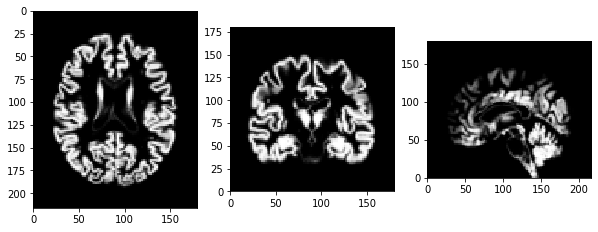

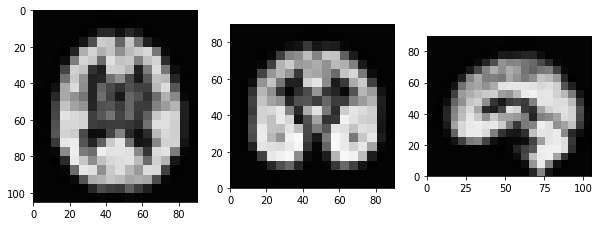

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8402162185995589 set 2 0.8500427341686221 avg 0.8451294763840904
svm set 1 0.6771828962330713 set 2 0.7005558353244827 avg 0.688869365778777
mlp set 1 0.4164792582004373 set 2 0.3183305913524185 avg 0.3674049247764279
Average set 1 0.6446261243443558 set 2 0.6229763869485078 total 0.6338012556464319
Visualisation of Preprocessing:


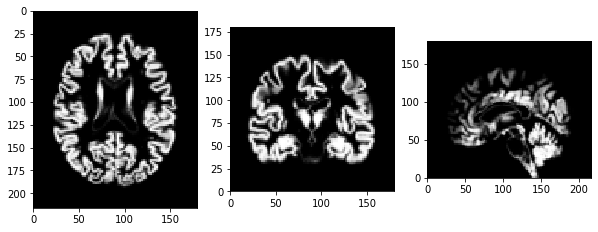

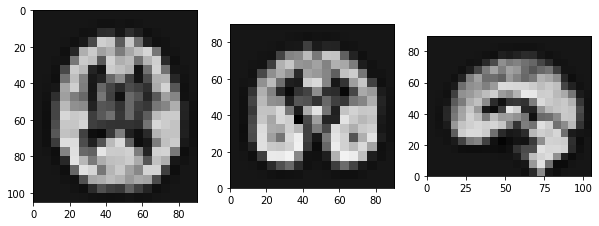

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8562705695403443 set 2 0.8490173753143293 avg 0.8526439724273368
svm set 1 0.7069940498811875 set 2 0.6556405979978484 avg 0.6813173239395179
mlp set 1 0.3621283266555727 set 2 0.13508742257029693 avg 0.24860787461293482
Average set 1 0.6417976486923682 set 2 0.5465817986274916 total 0.5941897236599298
Visualisation of Preprocessing:


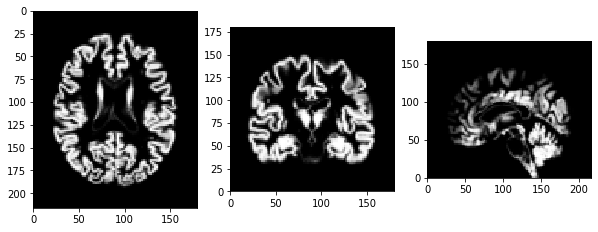

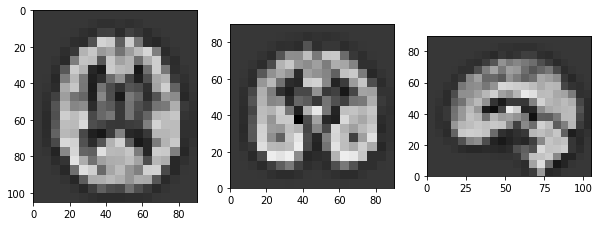

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8519344687685356 set 2 0.8202224308680368 avg 0.8360784498182863
svm set 1 0.6940049735147982 set 2 0.6805810173526821 avg 0.6872929954337401
mlp set 1 0.5032472479292023 set 2 0.04611739807913573 avg 0.274682323004169
Average set 1 0.6830622300708452 set 2 0.5156402820999516 total 0.5993512560853984
Visualisation of Preprocessing:


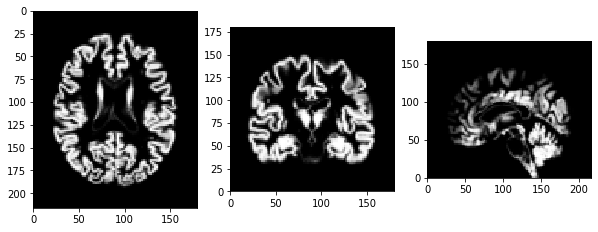

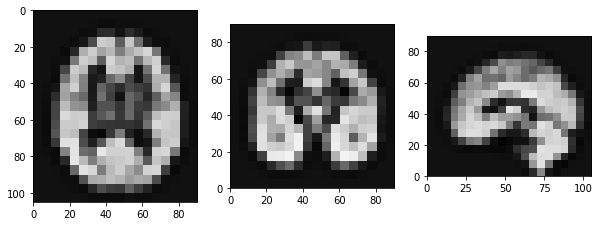

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8556879867690179 set 2 0.8035272808212574 avg 0.8296076337951377
svm set 1 0.6806084163345423 set 2 0.6996435436752566 avg 0.6901259800048994
mlp set 1 0.34528620590300985 set 2 0.12727445737953458 avg 0.2362803316412722
Average set 1 0.62719420300219 set 2 0.5434817606253496 total 0.5853379818137698
Visualisation of Preprocessing:


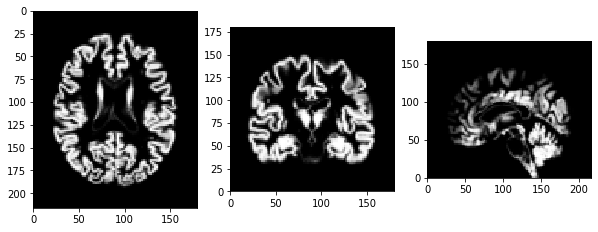

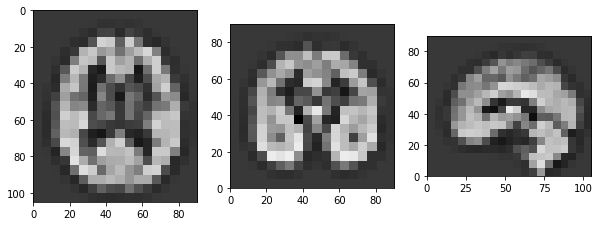

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8419179429282287 set 2 0.8562429441674003 avg 0.8490804435478145
svm set 1 0.6843207397169754 set 2 0.701639438924541 avg 0.6929800893207582
mlp set 1 0.17902735943333725 set 2 0.2702165666440992 avg 0.22462196303871823
Average set 1 0.5684220140261805 set 2 0.6093663165786801 total 0.5888941653024303
Visualisation of Preprocessing:


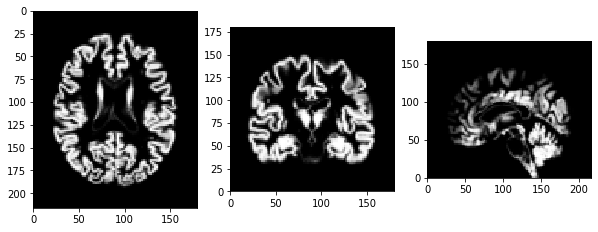

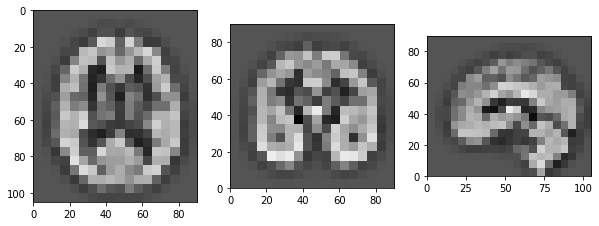

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8426302341021398 set 2 0.8238693635562426 avg 0.8332497988291911
svm set 1 0.6734012827545786 set 2 0.7121579333449097 avg 0.6927796080497441
mlp set 1 0.5017228715687598 set 2 0.5114939287592136 avg 0.5066084001639868
Average set 1 0.672584796141826 set 2 0.682507075220122 total 0.677545935680974
Visualisation of Preprocessing:


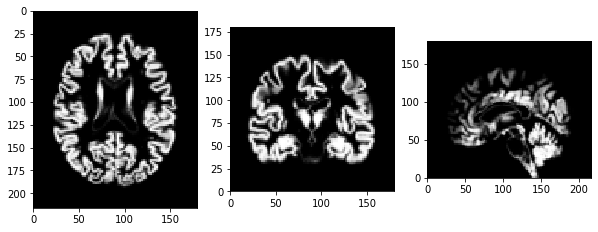

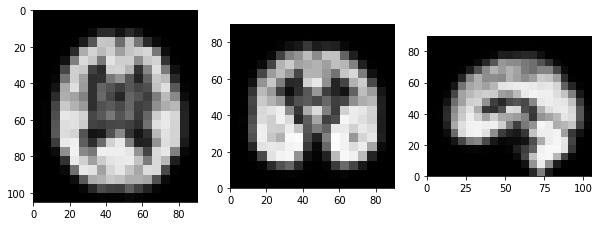

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8349256702899476 set 2 0.8335743399957766 avg 0.8342500051428621
svm set 1 0.7003163757488235 set 2 0.7027181561089866 avg 0.7015172659289051
mlp set 1 0.43637005854254607 set 2 0.4207023942845612 avg 0.4285362264135536
Average set 1 0.6572040348604391 set 2 0.6523316301297747 total 0.654767832495107
Visualisation of Preprocessing:


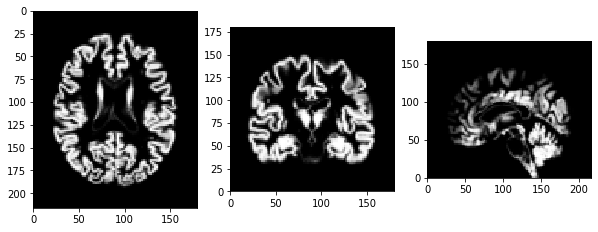

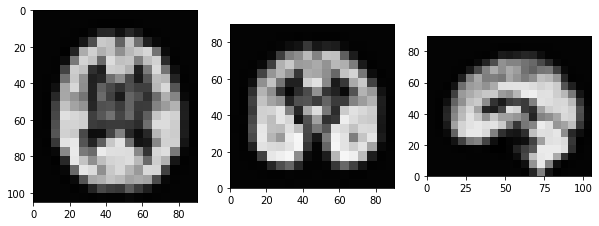

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8414333545227947 set 2 0.8718798928822536 avg 0.8566566237025242
svm set 1 0.7098689720542233 set 2 0.671484833520221 avg 0.6906769027872222
mlp set 1 0.3620092931329818 set 2 0.46533969605514064 avg 0.41367449459406125
Average set 1 0.6377705399033333 set 2 0.6695681408192051 total 0.6536693403612692
Visualisation of Preprocessing:


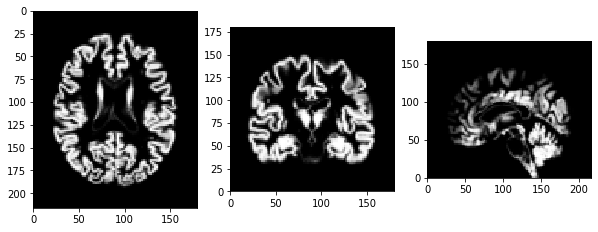

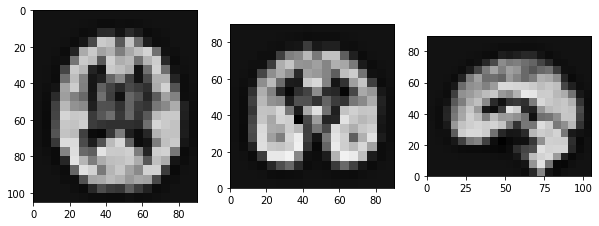

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8570938851872367 set 2 0.8318165413914722 avg 0.8444552132893545
svm set 1 0.7067953808486436 set 2 0.6842739625090419 avg 0.6955346716788428
mlp set 1 0.39972249785886155 set 2 0.5985157981565844 avg 0.49911914800772295
Average set 1 0.6545372546315806 set 2 0.7048687673523663 total 0.6797030109919735
Visualisation of Preprocessing:


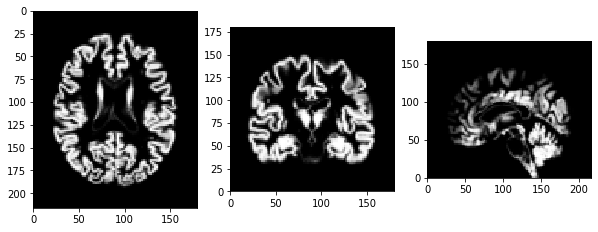

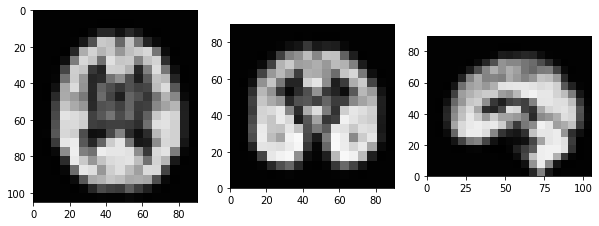

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8188904482977447 set 2 0.8496291837117996 avg 0.8342598160047722
svm set 1 0.6977331796383281 set 2 0.7033834063174845 avg 0.7005582929779064
mlp set 1 0.29576402632034327 set 2 0.3062481141681054 avg 0.3010060702442243
Average set 1 0.6041292180854722 set 2 0.6197535680657965 total 0.6119413930756343
Visualisation of Preprocessing:


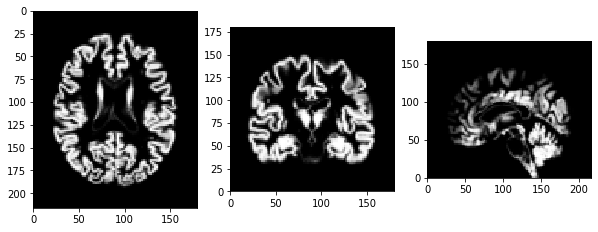

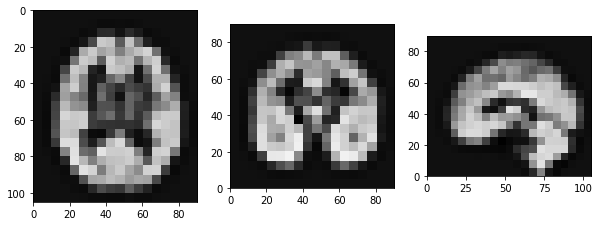

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8368970818262572 set 2 0.8540762362903156 avg 0.8454866590582863
svm set 1 0.7039470891854397 set 2 0.6994300996157117 avg 0.7016885944005757
mlp set 1 0.2603855759384599 set 2 0.2816235440560211 avg 0.2710045599972405
Average set 1 0.6004099156500523 set 2 0.6117099599873494 total 0.6060599378187008
Visualisation of Preprocessing:


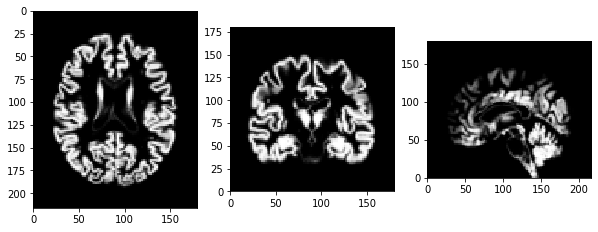

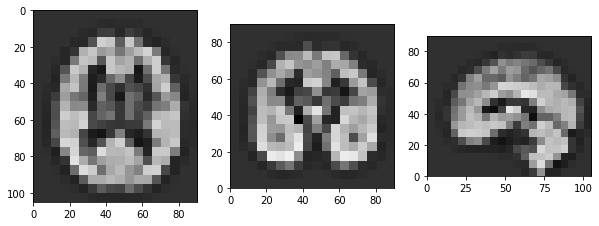

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8366139761858622 set 2 0.8584703071570156 avg 0.8475421416714388
svm set 1 0.6943893714824407 set 2 0.7041825455006938 avg 0.6992859584915673
mlp set 1 0.4090952451916459 set 2 0.45754676364667385 avg 0.4333210044191599
Average set 1 0.6466995309533162 set 2 0.673399872101461 total 0.6600497015273886
Visualisation of Preprocessing:


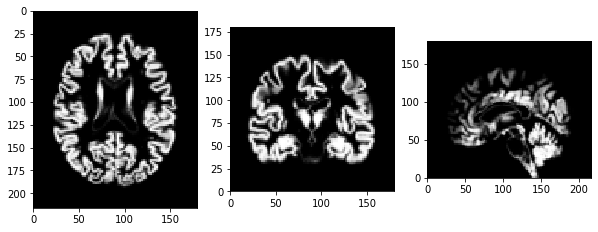

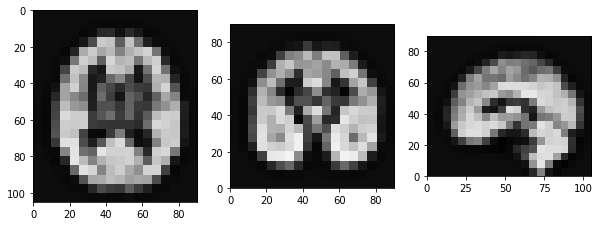

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8580499875425841 set 2 0.831417237433047 avg 0.8447336124878155
svm set 1 0.7093183932814058 set 2 0.6715703576419336 avg 0.6904443754616697
mlp set 1 0.3750988956944049 set 2 0.11867542485010087 avg 0.24688716027225288
Average set 1 0.6474890921727982 set 2 0.5405543399750271 total 0.5940217160739126
Visualisation of Preprocessing:


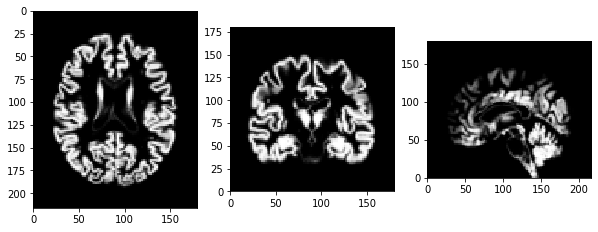

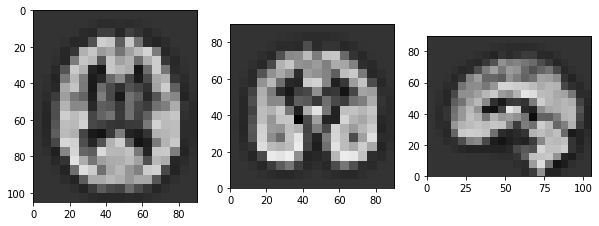

(operation 1) Gamma Corretion (gamma=1 c=15) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8401062181914813 set 2 0.850492181704742 avg 0.8452991999481116
svm set 1 0.6977669873111508 set 2 0.6916500950531694 avg 0.6947085411821601
mlp set 1 0.30089137167594515 set 2 0.30602669081946576 avg 0.30345903124770546
Average set 1 0.6129215257261924 set 2 0.6160563225257923 total 0.6144889241259923
Visualisation of Preprocessing:


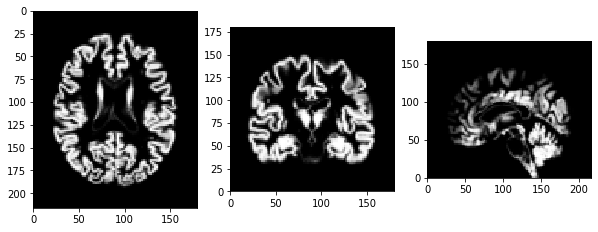

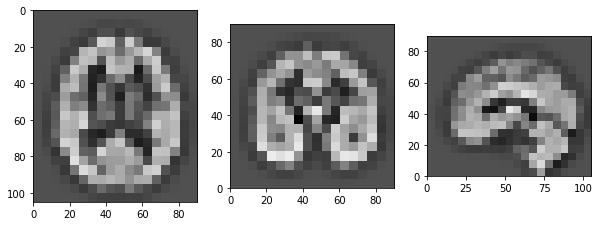

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8529421710398818 set 2 0.8658709677692537 avg 0.8594065694045677
svm set 1 0.6769667165941001 set 2 0.743128196602436 avg 0.7100474565982681
mlp set 1 -0.20670512364744528 set 2 -0.18536891233022512 avg -0.19603701798883522
Average set 1 0.44106792132884554 set 2 0.47454341734715483 total 0.45780566933800015
Visualisation of Preprocessing:


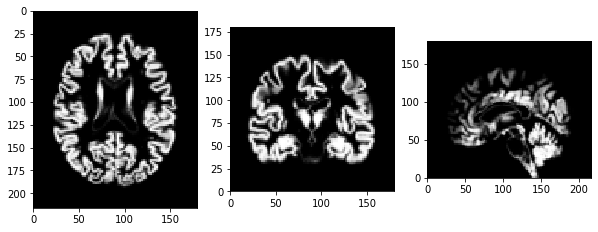

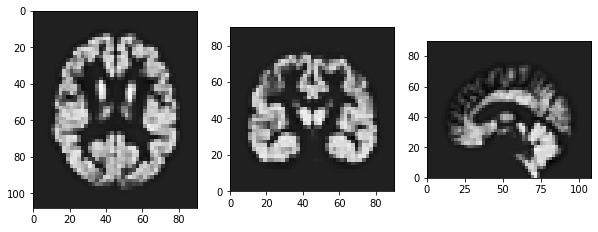

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8559418526583529 set 2 0.8380469656080727 avg 0.8469944091332128
svm set 1 0.7109697817776504 set 2 0.7276561077222432 avg 0.7193129447499468
mlp set 1 -0.4422672989404541 set 2 -0.7177103371540485 avg -0.5799888180472513
Average set 1 0.374881445165183 set 2 0.2826642453920891 total 0.32877284527863604
Visualisation of Preprocessing:


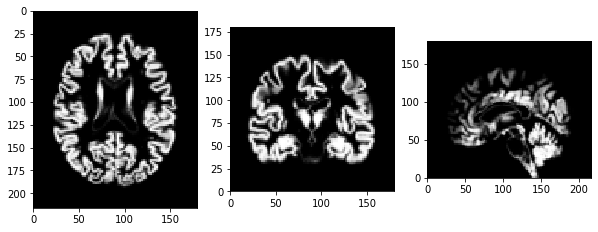

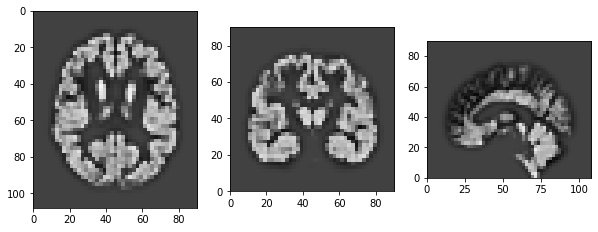

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8144680164589909 set 2 0.8111302746578227 avg 0.8127991455584068
svm set 1 0.5571725115030619 set 2 0.7243814151736797 avg 0.6407769633383709


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 -0.7857288813359871 set 2 -0.967039351466259 avg -0.876384116401123
Average set 1 0.19530388220868863 set 2 0.18949077945508117 total 0.1923973308318849
Visualisation of Preprocessing:


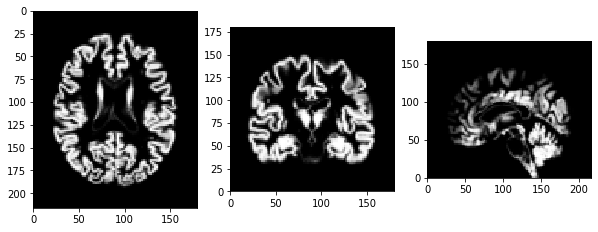

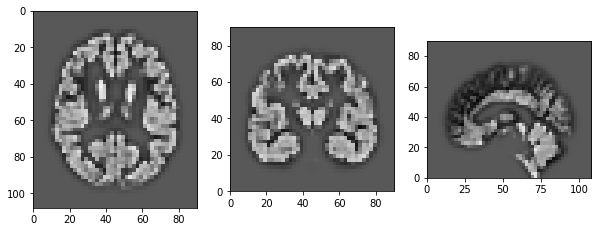

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8706071091282739 set 2 0.8333709640457407 avg 0.8519890365870073
svm set 1 0.7229255535209352 set 2 0.7000767151604126 avg 0.7115011343406739
mlp set 1 -0.14282408367160992 set 2 -0.5962677780317391 avg -0.36954593085167453
Average set 1 0.48356952632586636 set 2 0.3123933003914714 total 0.3979814133586689
Visualisation of Preprocessing:


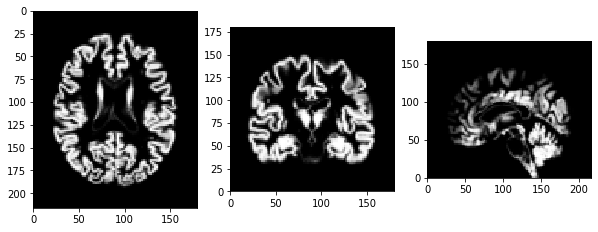

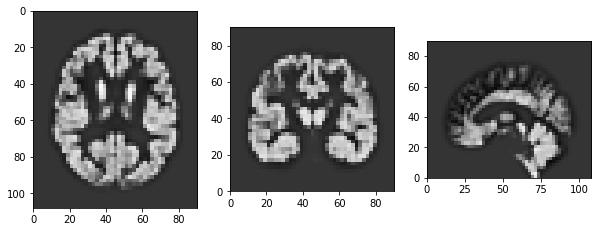

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8463188414245587 set 2 0.8458992570260085 avg 0.8461090492252836
svm set 1 0.6911640059852084 set 2 0.7094234978273142 avg 0.7002937519062613
mlp set 1 -0.47593961877415714 set 2 -0.9661748693004651 avg -0.7210572440373111
Average set 1 0.35384774287853665 set 2 0.19638262851761923 total 0.2751151856980779
Visualisation of Preprocessing:


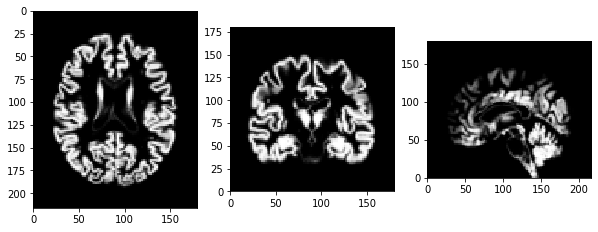

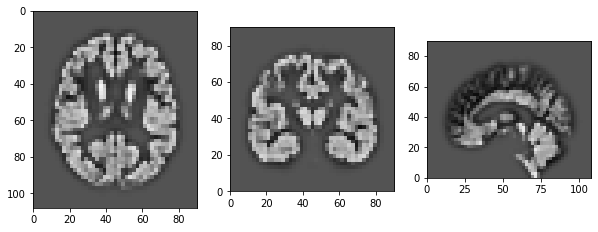

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.849630847972698 set 2 0.8361368882522402 avg 0.8428838681124691
svm set 1 0.6524452034327077 set 2 0.5686544090399026 avg 0.6105498062363052
mlp set 1 -1.463881791139646 set 2 -0.9445418287738008 avg -1.2042118099567234
Average set 1 0.012731420088586557 set 2 0.153416489506114 total 0.08307395479735027
Visualisation of Preprocessing:


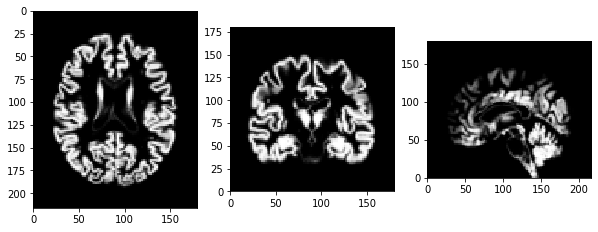

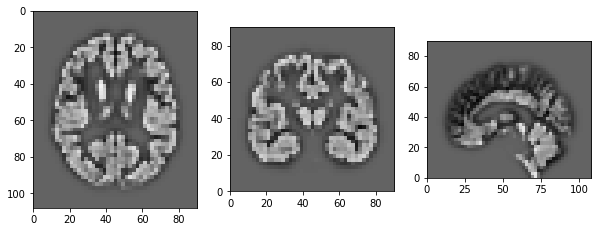

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8782810264427436 set 2 0.8331874822693807 avg 0.8557342543560622
svm set 1 0.7059715126089606 set 2 0.7235712585778156 avg 0.7147713855933882
mlp set 1 -0.18505665233027457 set 2 -0.7446661578987184 avg -0.4648614051144965
Average set 1 0.4663986289071433 set 2 0.2706975276494927 total 0.368548078278318
Visualisation of Preprocessing:


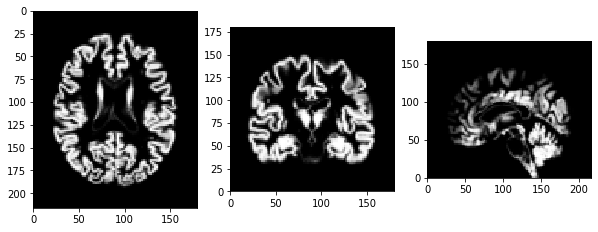

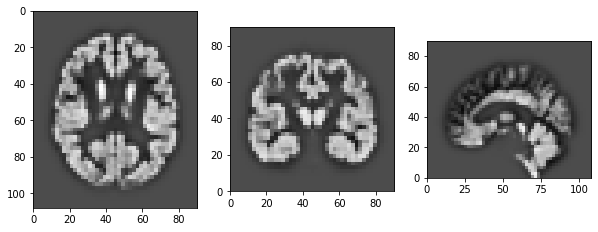

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8666932571101631 set 2 0.8361390528303798 avg 0.8514161549702715
svm set 1 0.6773404895886537 set 2 0.6903038447204599 avg 0.6838221671545568
mlp set 1 -0.7449320947777238 set 2 -0.7789237210104809 avg -0.7619279078941024
Average set 1 0.266367217307031 set 2 0.24917305884678628 total 0.25777013807690863
Visualisation of Preprocessing:


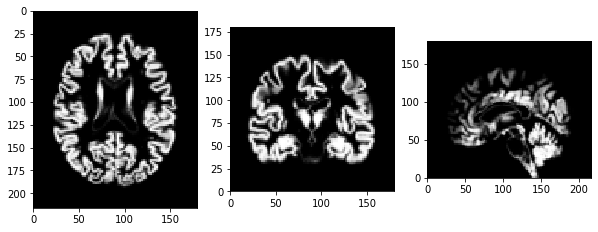

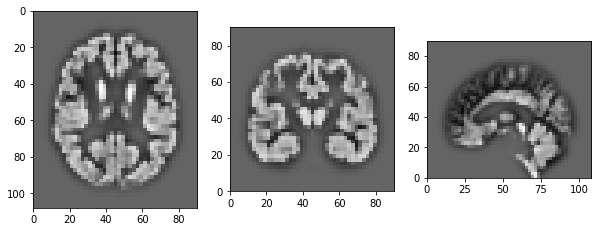

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8574062564903545 set 2 0.8209642397611925 avg 0.8391852481257736
svm set 1 0.6648830657094069 set 2 0.5680857304446867 avg 0.6164843980770468
mlp set 1 -1.2644604166662976 set 2 -0.8912309664777522 avg -1.077845691572025
Average set 1 0.08594296851115457 set 2 0.16593966790937564 total 0.1259413182102651
Visualisation of Preprocessing:


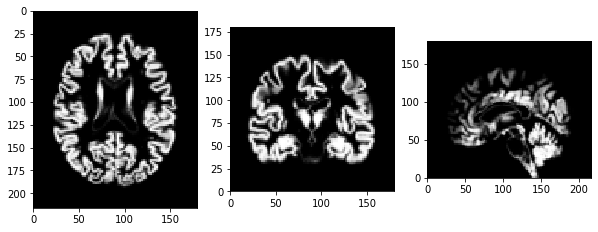

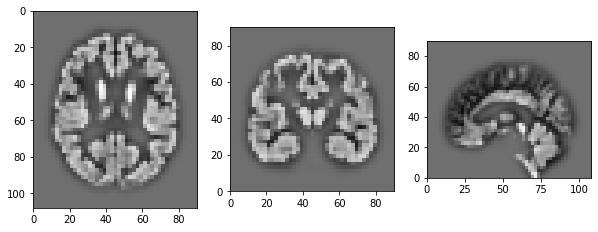

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8370210966891769 set 2 0.867729097017162 avg 0.8523750968531695
svm set 1 0.700548149084985 set 2 0.6776660552157636 avg 0.6891071021503743
mlp set 1 -0.16644144894585544 set 2 0.1294448872565077 avg -0.018498280844673864
Average set 1 0.45704259894276883 set 2 0.5582800131631445 total 0.5076613060529567
Visualisation of Preprocessing:


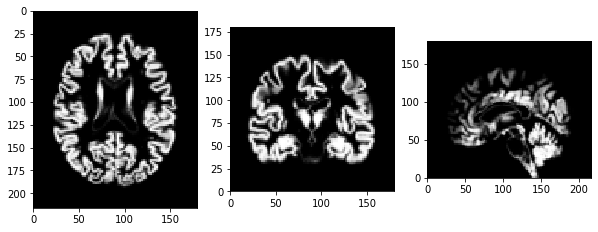

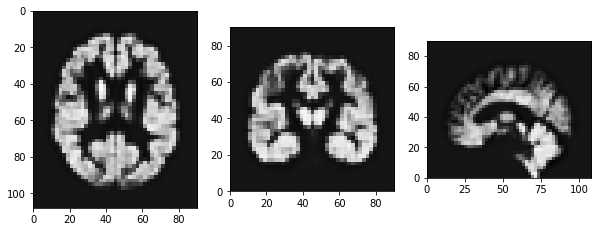

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8468014095140877 set 2 0.8485418577762911 avg 0.8476716336451894
svm set 1 0.6740029298002175 set 2 0.6936636888933423 avg 0.6838333093467799


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 -0.24152954462179488 set 2 -0.4145912150673632 avg -0.32806037984457903
Average set 1 0.4264249315641701 set 2 0.3758714438674234 total 0.40114818771579674
Visualisation of Preprocessing:


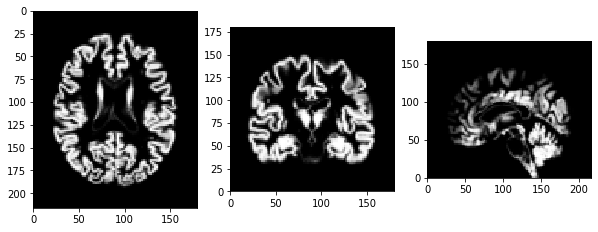

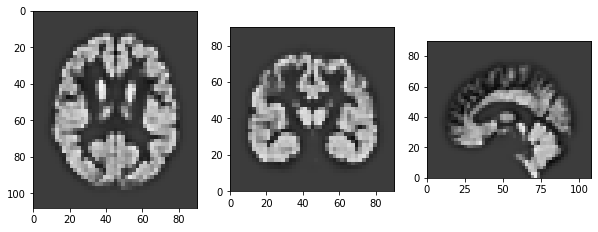

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.844916817241228 set 2 0.8576216983474816 avg 0.8512692577943548
svm set 1 0.6672905068540331 set 2 0.6756968603266962 avg 0.6714936835903647
mlp set 1 -0.6254374493726147 set 2 -0.4864886384938667 avg -0.5559630439332407
Average set 1 0.29558995824088213 set 2 0.3489433067267704 total 0.32226663248382625
Visualisation of Preprocessing:


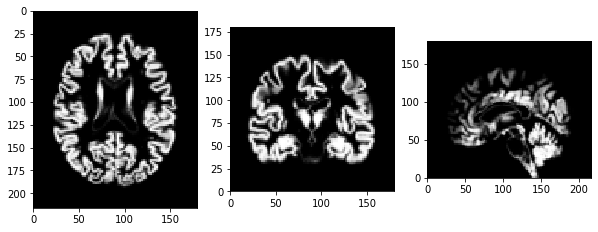

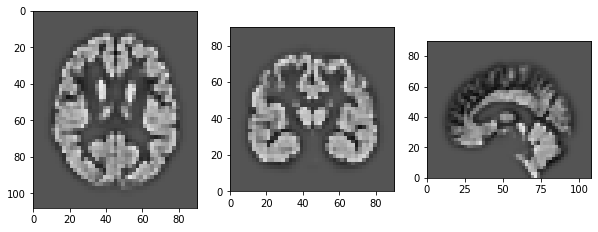

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.872134483436416 set 2 0.8492345698688653 avg 0.8606845266526406
svm set 1 0.7031855087021659 set 2 0.6771442313669263 avg 0.6901648700345461
mlp set 1 -0.019656431962014942 set 2 -0.18880248957606516 avg -0.10422946076904005
Average set 1 0.5185545200588556 set 2 0.44585877055324213 total 0.48220664530604884
Visualisation of Preprocessing:


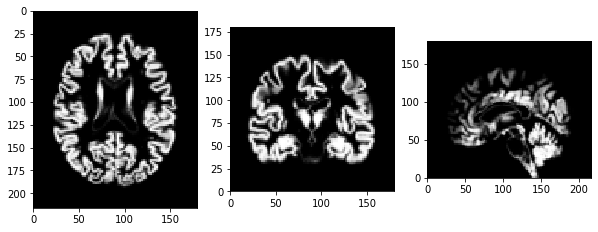

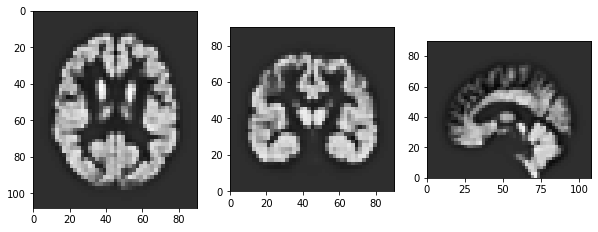

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8375111994501039 set 2 0.8586833217948486 avg 0.8480972606224763
svm set 1 0.6816655739171757 set 2 0.6684123251034533 avg 0.6750389495103145
mlp set 1 -0.5848481026775356 set 2 -0.27049926520822165 avg -0.42767368394287864
Average set 1 0.31144289022991467 set 2 0.4188654605633601 total 0.3651541753966374
Visualisation of Preprocessing:


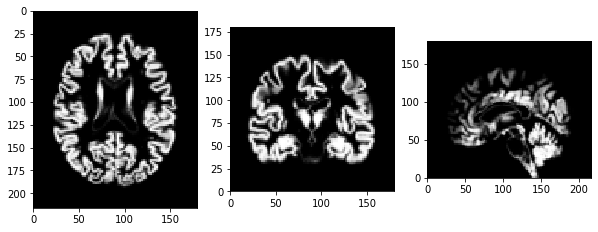

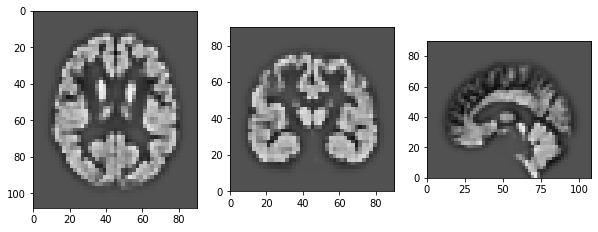

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.808949697353571 set 2 0.8618962391410903 avg 0.8354229682473306
svm set 1 0.5830800464358042 set 2 0.6603548670756124 avg 0.6217174567557083
mlp set 1 -0.9360900712912855 set 2 -0.6084871091812829 avg -0.7722885902362842
Average set 1 0.1519798908326966 set 2 0.3045879990118066 total 0.22828394492225162
Visualisation of Preprocessing:


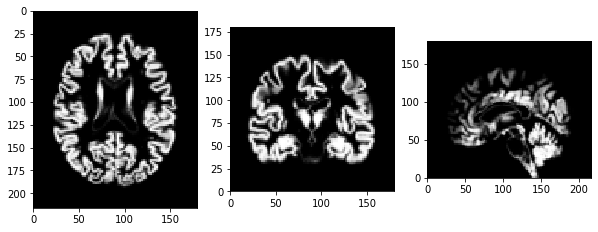

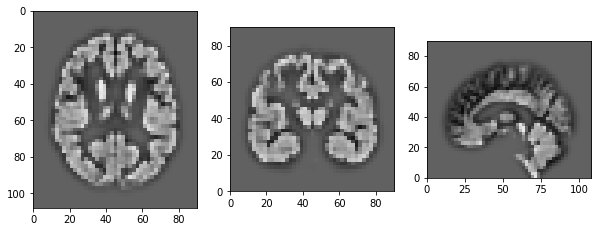

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.840999702828051 set 2 0.8472199877204588 avg 0.8441098452742549
svm set 1 0.6827793098448104 set 2 0.6924018061366051 avg 0.6875905579907078
mlp set 1 -0.18633551265515513 set 2 -0.24957483647047574 avg -0.21795517456281543
Average set 1 0.4458145000059021 set 2 0.4300156524621961 total 0.4379150762340491
Visualisation of Preprocessing:


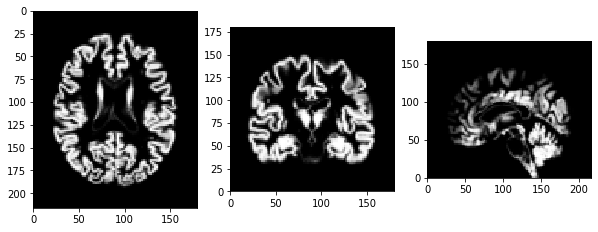

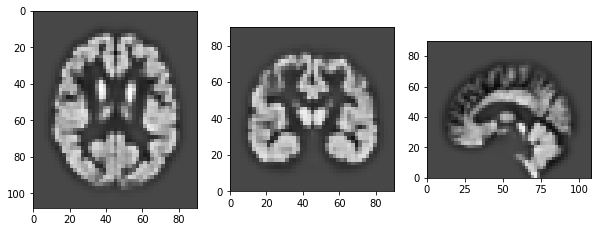

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8539417320693359 set 2 0.8333462650107135 avg 0.8436439985400247
svm set 1 0.6547115532051284 set 2 0.7017018152090844 avg 0.6782066842071064
mlp set 1 -0.4605546670470591 set 2 -0.6092449158184636 avg -0.5348997914327613
Average set 1 0.34936620607580177 set 2 0.30860105480044475 total 0.3289836304381233
Visualisation of Preprocessing:


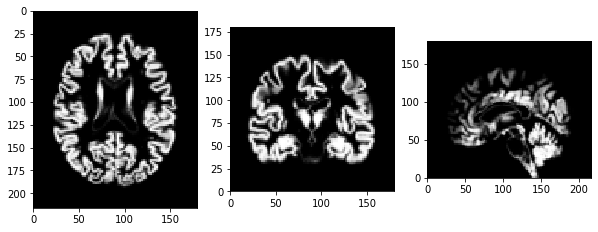

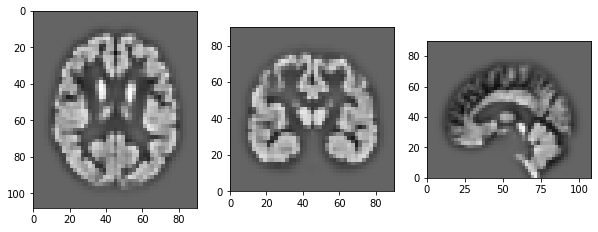

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8271406347981246 set 2 0.8566021319006522 avg 0.8418713833493884
svm set 1 0.5618883090471405 set 2 0.7281401735373109 avg 0.6450142412922257
mlp set 1 -0.5271587683784067 set 2 -0.8612446338202053 avg -0.694201701099306
Average set 1 0.28729005848895284 set 2 0.24116589053925255 total 0.2642279745141027
Visualisation of Preprocessing:


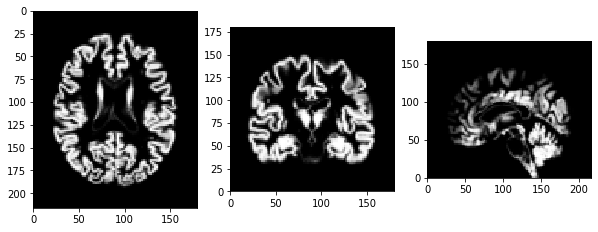

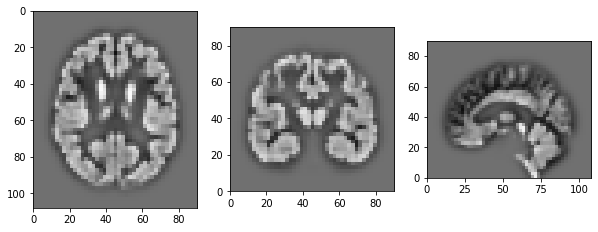

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8450401398887504 set 2 0.8706247262374858 avg 0.8578324330631181
svm set 1 0.6916396598041318 set 2 0.7178858236797787 avg 0.7047627417419553
mlp set 1 0.3758672046865217 set 2 0.24895813294421465 avg 0.31241266881536817
Average set 1 0.6375156681264679 set 2 0.6124895609538265 total 0.6250026145401472
Visualisation of Preprocessing:


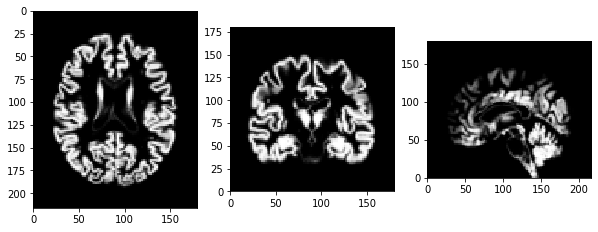

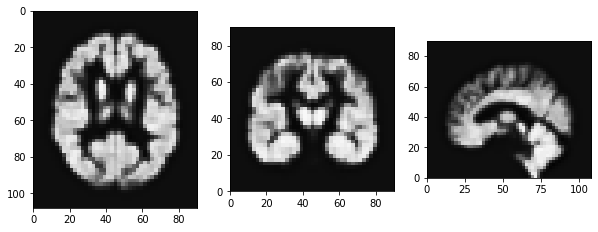

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8576731421021409 set 2 0.8579628477406813 avg 0.8578179949214111
svm set 1 0.7024416084716596 set 2 0.7110657869070989 avg 0.7067536976893792


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.23175530829509516 set 2 -0.012082948604577926 avg 0.10983617984525862
Average set 1 0.5972900196229652 set 2 0.5189818953477341 total 0.5581359574853497
Visualisation of Preprocessing:


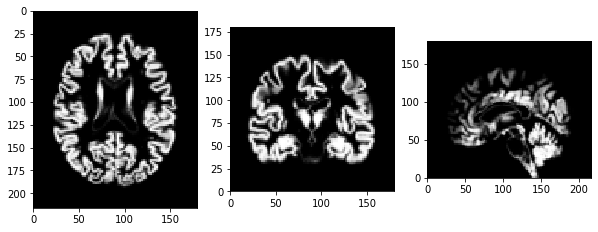

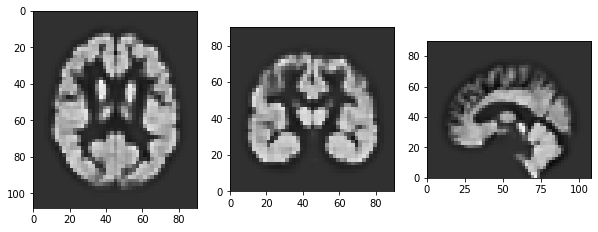

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8715455588416051 set 2 0.8275989283272756 avg 0.8495722435844404
svm set 1 0.6824793682405943 set 2 0.7011518869358597 avg 0.691815627588227


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 -0.12219118675911365 set 2 -0.15071370599626732 avg -0.1364524463776905
Average set 1 0.4772779134410286 set 2 0.459345703088956 total 0.4683118082649923
Visualisation of Preprocessing:


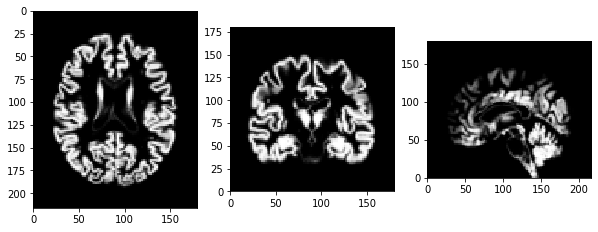

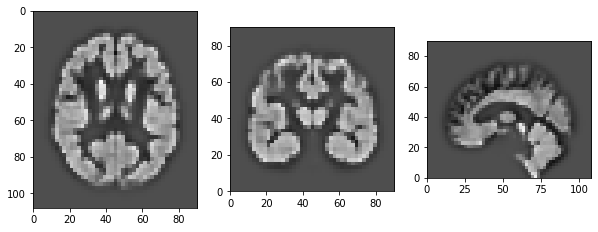

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8599939719984963 set 2 0.8649770662685794 avg 0.8624855191335379
svm set 1 0.7080464685638406 set 2 0.7044226454159948 avg 0.7062345569899177
mlp set 1 0.2855075625707809 set 2 0.18107990419497 avg 0.23329373338287546
Average set 1 0.617849334377706 set 2 0.5834932052931814 total 0.6006712698354437
Visualisation of Preprocessing:


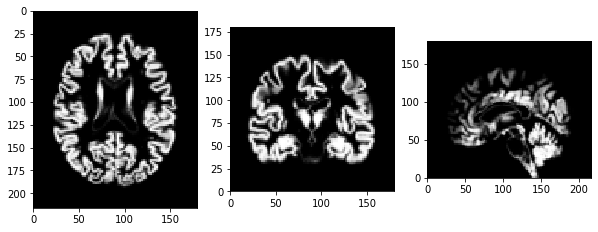

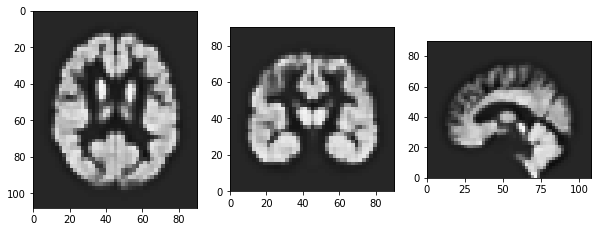

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8360811255021589 set 2 0.8556527338372939 avg 0.8458669296697263
svm set 1 0.6830811912810937 set 2 0.7263048279864033 avg 0.7046930096337485


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.06204877142027898 set 2 -0.1210185861993942 avg -0.029484907389557613
Average set 1 0.5270703627345106 set 2 0.4869796585414343 total 0.5070250106379725
Visualisation of Preprocessing:


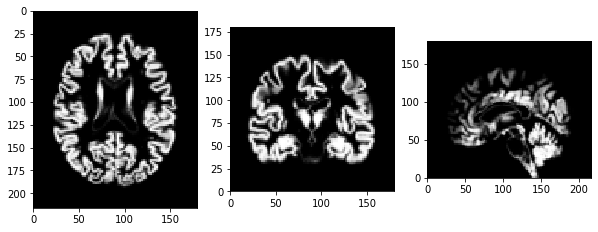

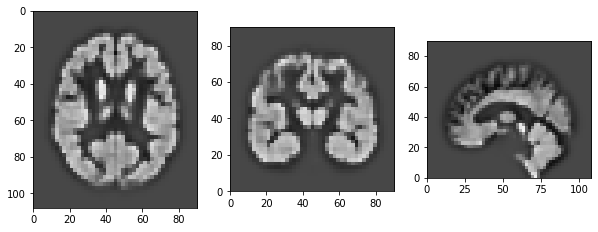

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8641553915668779 set 2 0.8330657944132652 avg 0.8486105929900716
svm set 1 0.6942620674805352 set 2 0.6948826730769033 avg 0.6945723702787192
mlp set 1 -0.14611250179588287 set 2 -0.3519684470334836 avg -0.24904047441468324
Average set 1 0.4707683190838434 set 2 0.39199334015222836 total 0.4313808296180359
Visualisation of Preprocessing:


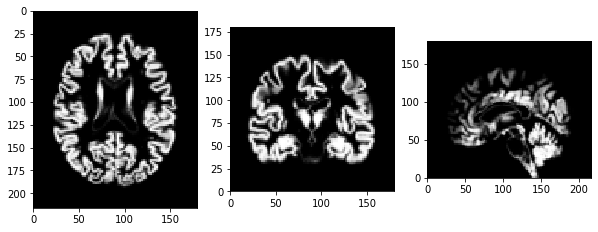

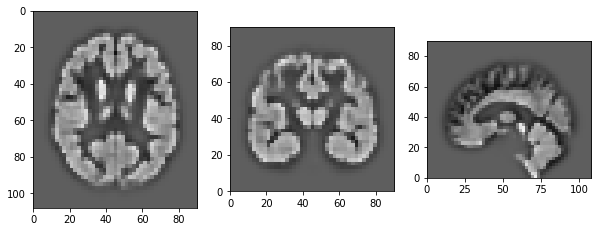

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8678484411658459 set 2 0.8471959595880393 avg 0.8575222003769426
svm set 1 0.7132969121391465 set 2 0.6982541292462141 avg 0.7057755206926803
mlp set 1 0.05597416130180943 set 2 0.253840423022788 avg 0.1549072921622987
Average set 1 0.5457065048689339 set 2 0.5997635039523471 total 0.5727350044106405
Visualisation of Preprocessing:


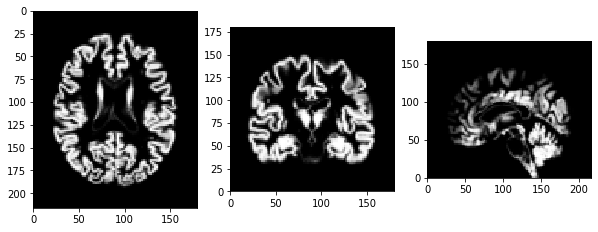

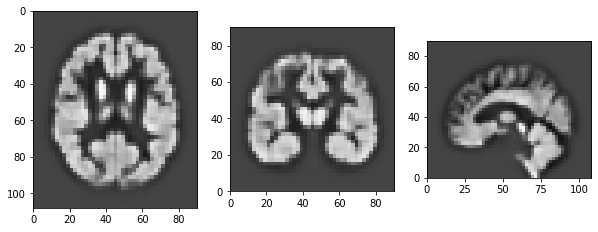

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8536004978988486 set 2 0.8443406984181658 avg 0.8489705981585072
svm set 1 0.7299995047045569 set 2 0.6896777110921433 avg 0.7098386078983501
mlp set 1 -0.04453110972986596 set 2 -0.22793644664977752 avg -0.13623377818982174
Average set 1 0.5130229642911799 set 2 0.43536065428684384 total 0.47419180928901183
Visualisation of Preprocessing:


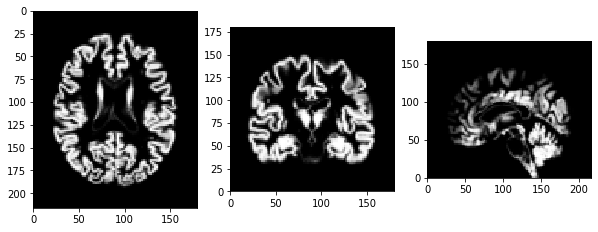

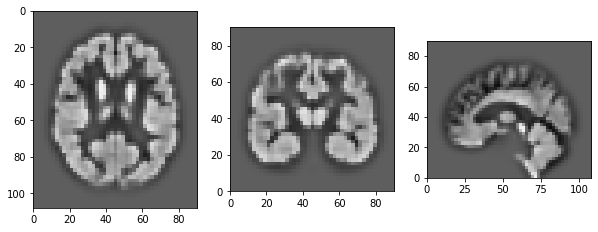

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8587097790966854 set 2 0.8429126929509941 avg 0.8508112360238398
svm set 1 0.6813004671773841 set 2 0.7189228577187046 avg 0.7001116624480443
mlp set 1 -0.2826997994453755 set 2 -0.3581647274348312 avg -0.32043226344010334
Average set 1 0.4191034822762314 set 2 0.4012236077449558 total 0.4101635450105936
Visualisation of Preprocessing:


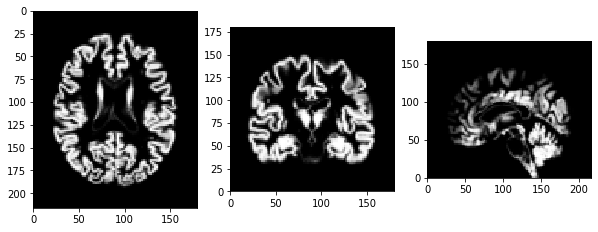

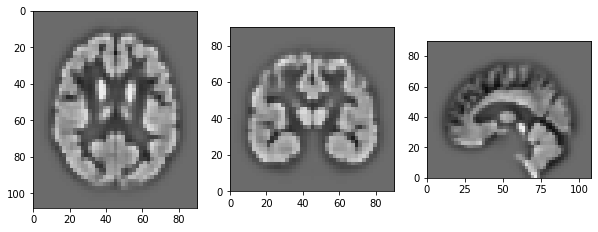

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8649405064810738 set 2 0.852845441848157 avg 0.8588929741646154
svm set 1 0.7213040775205375 set 2 0.6709760736930725 avg 0.696140075606805


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.4043151672011656 set 2 0.4590623036979747 avg 0.43168873544957015
Average set 1 0.6635199170675923 set 2 0.6609612730797347 total 0.6622405950736635
Visualisation of Preprocessing:


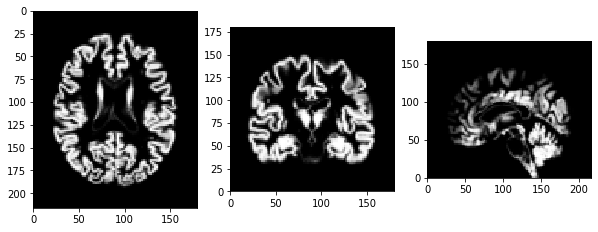

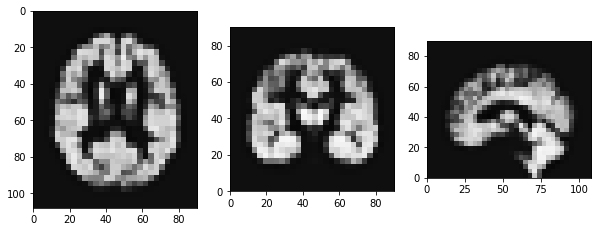

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8693295766142398 set 2 0.8493853470374607 avg 0.8593574618258503
svm set 1 0.7028674273847073 set 2 0.6633586055251974 avg 0.6831130164549524


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.4085045915385534 set 2 0.16271665184611772 avg 0.28561062169233553
Average set 1 0.6602338651791668 set 2 0.5584868681362586 total 0.6093603666577128
Visualisation of Preprocessing:


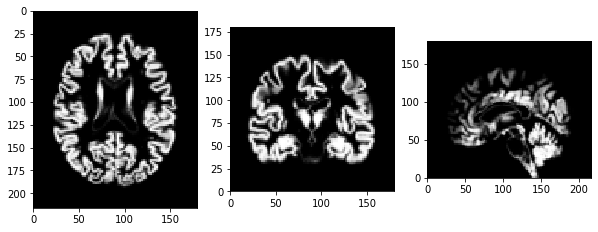

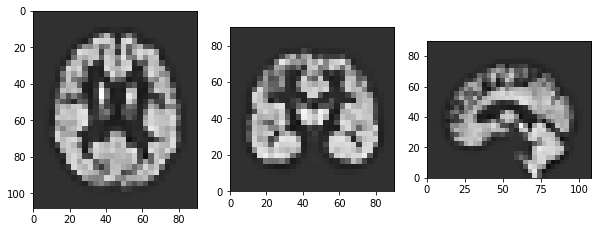

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8565976028215034 set 2 0.8334484712640504 avg 0.8450230370427769
svm set 1 0.7250419713159961 set 2 0.6931565108153634 avg 0.7090992410656798
mlp set 1 0.17997324298251915 set 2 0.05694357696013541 avg 0.11845840997132728
Average set 1 0.5872042723733396 set 2 0.5278495196798497 total 0.5575268960265947
Visualisation of Preprocessing:


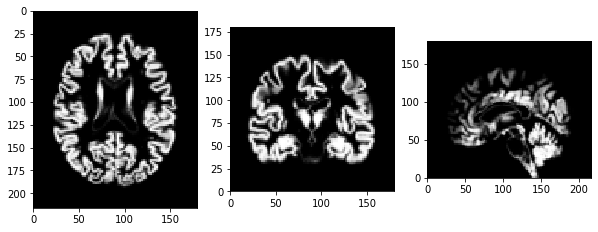

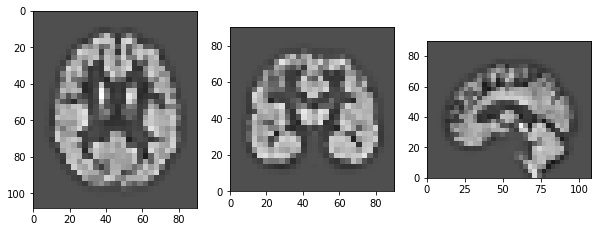

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8617755512246078 set 2 0.8534984863387385 avg 0.8576370187816731
svm set 1 0.7211116395460028 set 2 0.6929329980741277 avg 0.7070223188100653
mlp set 1 0.32437940398886156 set 2 0.3026239799656263 avg 0.3135016919772439
Average set 1 0.6357555315864908 set 2 0.6163518214594975 total 0.6260536765229942
Visualisation of Preprocessing:


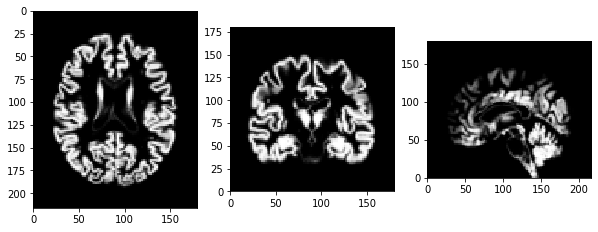

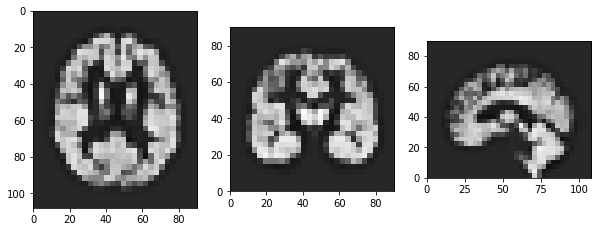

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8468238785153649 set 2 0.8804710117827894 avg 0.8636474451490772
svm set 1 0.6959780712596575 set 2 0.7010472220221142 avg 0.6985126466408859


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 -0.007551307565661247 set 2 0.20762257800207642 avg 0.10003563521820759
Average set 1 0.511750214069787 set 2 0.5963802706023267 total 0.5540652423360568
Visualisation of Preprocessing:


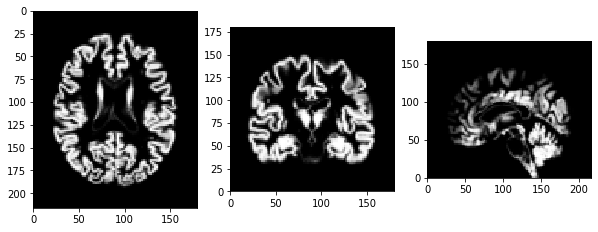

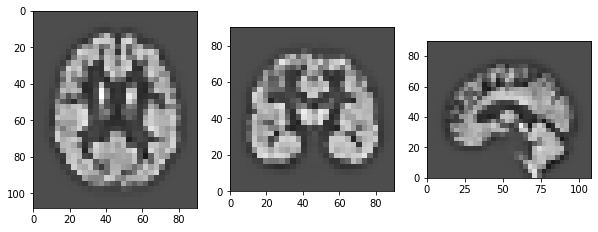

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8434396772786567 set 2 0.8634662333340206 avg 0.8534529553063386
svm set 1 0.7017068374620055 set 2 0.7006980773479701 avg 0.7012024574049878
mlp set 1 -0.014368892404101665 set 2 -0.08687283165036774 avg -0.0506208620272347
Average set 1 0.5102592074455201 set 2 0.492430493010541 total 0.5013448502280305
Visualisation of Preprocessing:


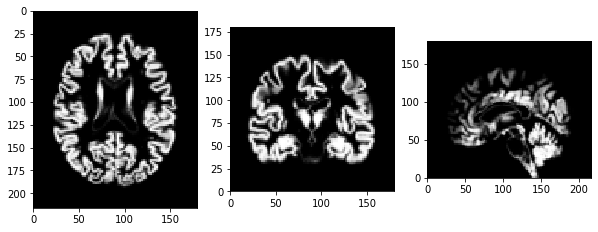

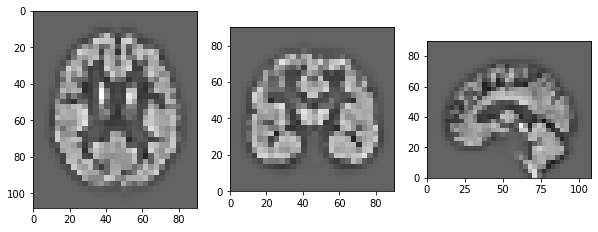

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8589612002938831 set 2 0.8703787175619226 avg 0.8646699589279029
svm set 1 0.7064710197944671 set 2 0.707705638957363 avg 0.7070883293759151


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.1982774311799317 set 2 0.3205103134306837 avg 0.2593938723053077
Average set 1 0.5879032170894273 set 2 0.6328648899833231 total 0.6103840535363751
Visualisation of Preprocessing:


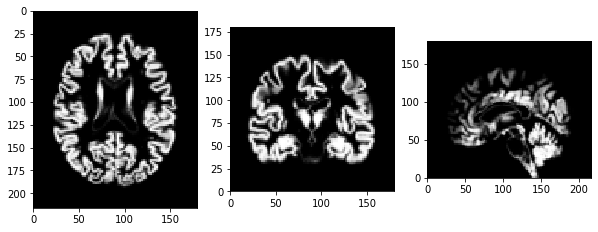

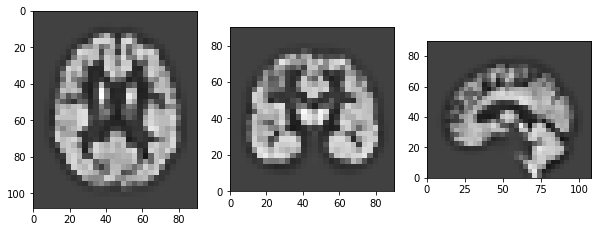

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8539747806538545 set 2 0.8644700233481147 avg 0.8592224020009847
svm set 1 0.6966946783575463 set 2 0.6934124605596654 avg 0.6950535694586059


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 -0.1548383439689347 set 2 0.2586483620423957 avg 0.05190500903673051
Average set 1 0.4652770383474887 set 2 0.605510281983392 total 0.5353936601654403
Visualisation of Preprocessing:


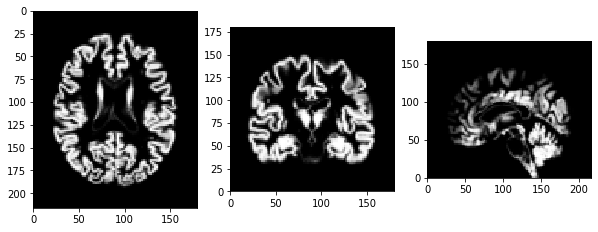

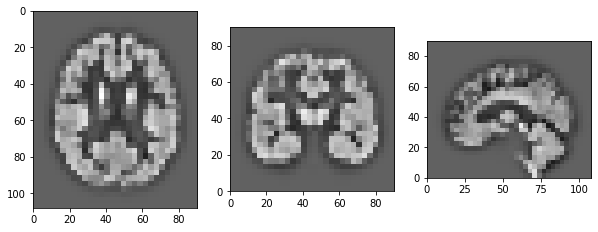

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8427334625957483 set 2 0.8360523242018347 avg 0.8393928933987915
svm set 1 0.6870042776143401 set 2 0.7133928216292243 avg 0.7001985496217822
mlp set 1 -0.12229449064905683 set 2 -0.20314195825372128 avg -0.16271822445138906
Average set 1 0.4691477498536772 set 2 0.44876772919244595 total 0.45895773952306157
Visualisation of Preprocessing:


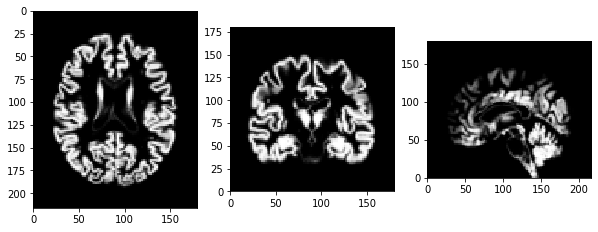

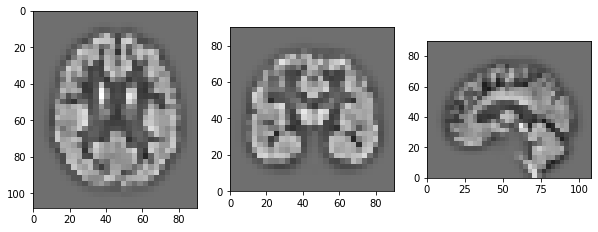

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8443614070891905 set 2 0.8607890912624717 avg 0.8525752491758312
svm set 1 0.6879595440757662 set 2 0.7313815082731565 avg 0.7096705261744614
mlp set 1 0.5402146036573594 set 2 0.45817122489085926 avg 0.49919291427410933
Average set 1 0.6908451849407721 set 2 0.6834472748088292 total 0.6871462298748006
Visualisation of Preprocessing:


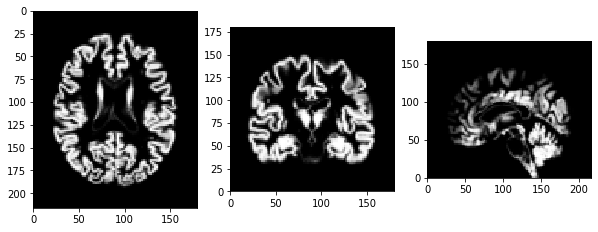

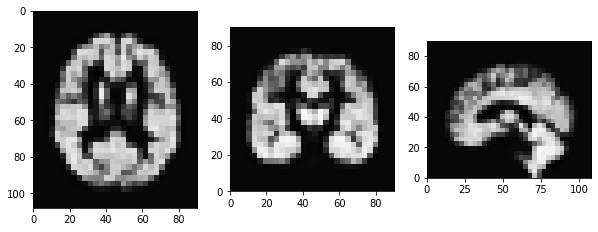

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8366767803184685 set 2 0.8773395282391617 avg 0.857008154278815
svm set 1 0.7084555331580837 set 2 0.7022190106519468 avg 0.7053372719050153


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.29871811810271054 set 2 0.2584231985569033 avg 0.27857065832980693
Average set 1 0.6146168105264209 set 2 0.6126605791493374 total 0.6136386948378791
Visualisation of Preprocessing:


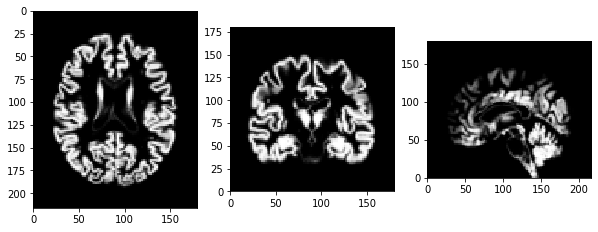

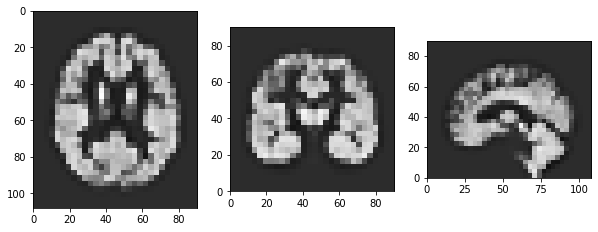

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8458733903122095 set 2 0.8652748325595095 avg 0.8555741114358595
svm set 1 0.7011942972210681 set 2 0.7266257821455487 avg 0.7139100396833085
mlp set 1 0.16930046746835004 set 2 0.12265226507132099 avg 0.1459763662698355
Average set 1 0.5721227183338758 set 2 0.5715176265921263 total 0.5718201724630011
Visualisation of Preprocessing:


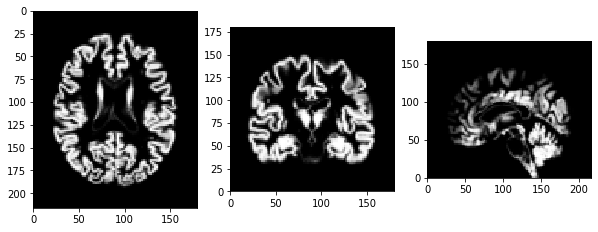

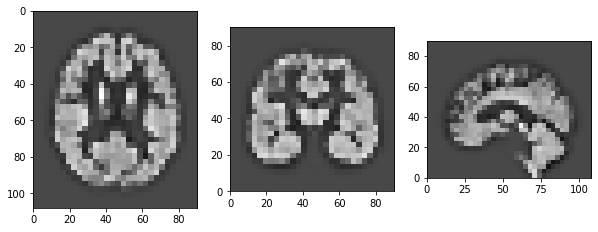

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8505247838508931 set 2 0.8580460840900044 avg 0.8542854339704488
svm set 1 0.7012103324457266 set 2 0.7158213098335064 avg 0.7085158211396165
mlp set 1 0.3810193349704641 set 2 0.3392031354485896 avg 0.3601112352095268
Average set 1 0.6442514837556946 set 2 0.6376901764573668 total 0.6409708301065307
Visualisation of Preprocessing:


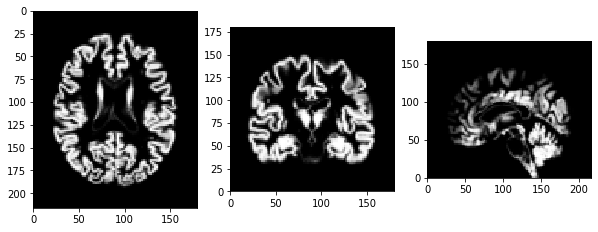

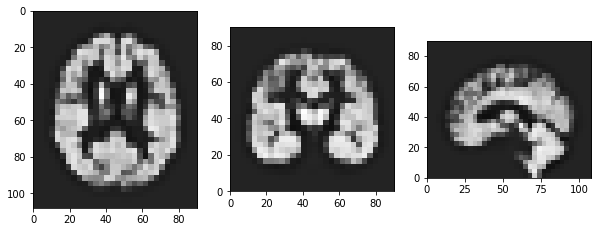

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.8623752997498434 set 2 0.8590287830916215 avg 0.8607020414207325
svm set 1 0.7157431509996359 set 2 0.7202968330120045 avg 0.7180199920058202
mlp set 1 0.16785349852527198 set 2 0.28437523910065254 avg 0.22611436881296226
Average set 1 0.5819906497582504 set 2 0.6212336184014262 total 0.6016121340798384
Visualisation of Preprocessing:


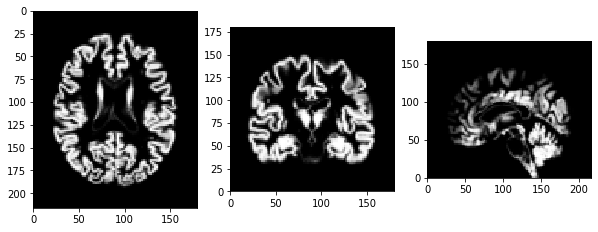

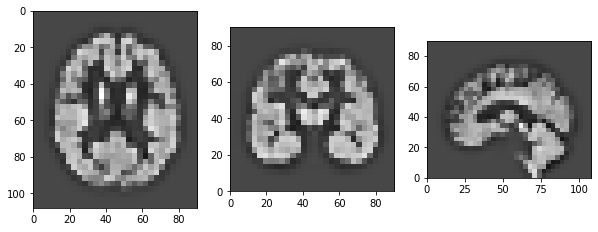

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8502353049368211 set 2 0.8421671290091499 avg 0.8462012169729856
svm set 1 0.7161200485965833 set 2 0.686793615555308 avg 0.7014568320759457
mlp set 1 -0.0634629024796931 set 2 0.06891516677782483 avg 0.002726132149065863
Average set 1 0.5009641503512371 set 2 0.5326253037807609 total 0.5167947270659989
Visualisation of Preprocessing:


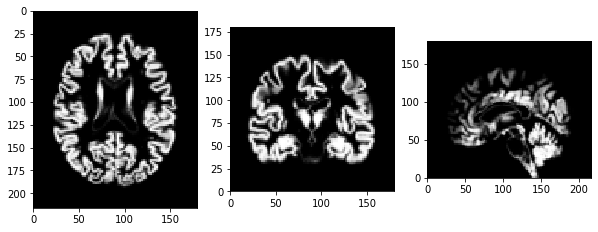

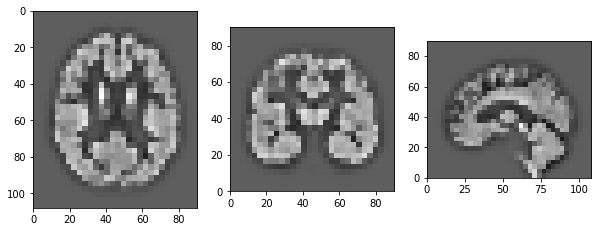

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8579169260799692 set 2 0.8612650275014083 avg 0.8595909767906887
svm set 1 0.6990913721155971 set 2 0.6903261877077599 avg 0.6947087799116785
mlp set 1 0.387557848645102 set 2 0.2089734672696102 avg 0.2982656579573561
Average set 1 0.6481887156135561 set 2 0.5868548941595928 total 0.6175218048865745
Visualisation of Preprocessing:


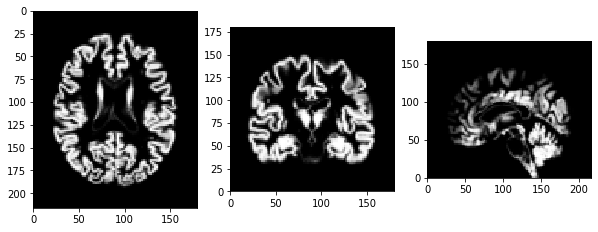

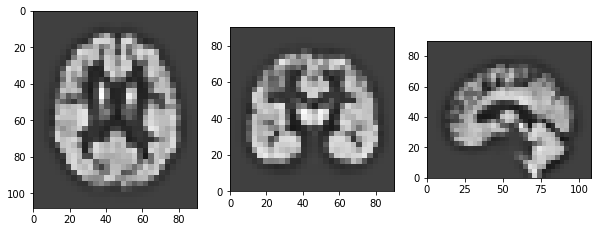

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8392707961677851 set 2 0.8347845247390174 avg 0.8370276604534013
svm set 1 0.6862622139131048 set 2 0.7025202007789542 avg 0.6943912073460294
mlp set 1 0.2045142129836428 set 2 -0.0019876095530375615 avg 0.10126330171530262
Average set 1 0.5766824076881776 set 2 0.5117723719883114 total 0.5442273898382445
Visualisation of Preprocessing:


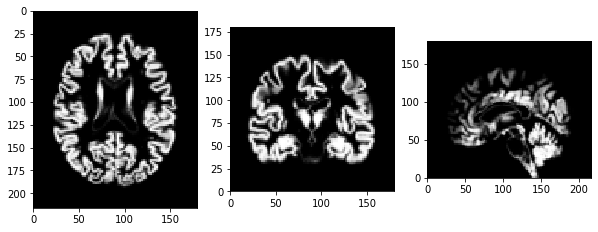

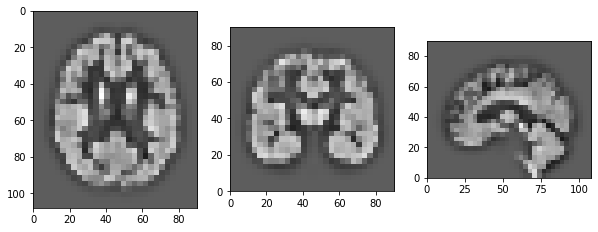

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8635374691123348 set 2 0.850051419825555 avg 0.8567944444689448
svm set 1 0.7167431615906603 set 2 0.6985805837151653 avg 0.7076618726529128
mlp set 1 0.1095458453427459 set 2 -0.23173859078147552 avg -0.06109637271936481
Average set 1 0.563275492015247 set 2 0.4389644709197482 total 0.5011199814674976
Visualisation of Preprocessing:


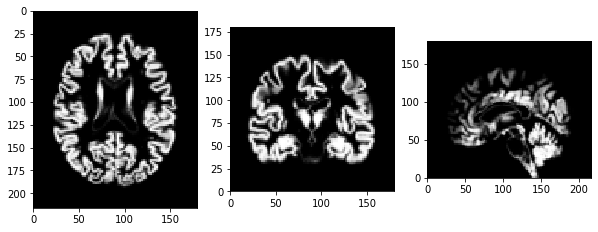

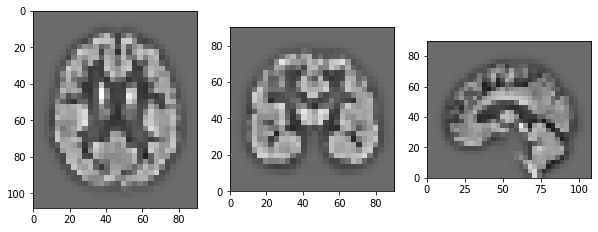

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.855518620350685 set 2 0.8340170843338702 avg 0.8447678523422777
svm set 1 0.718072683329781 set 2 0.701419141081139 avg 0.70974591220546
mlp set 1 0.5732385575953913 set 2 0.6519897362355093 avg 0.6126141469154502
Average set 1 0.715609953758619 set 2 0.7291419872168395 total 0.7223759704877293
Visualisation of Preprocessing:


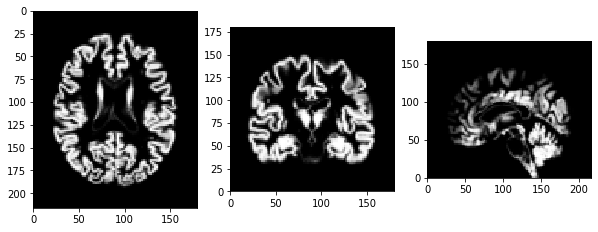

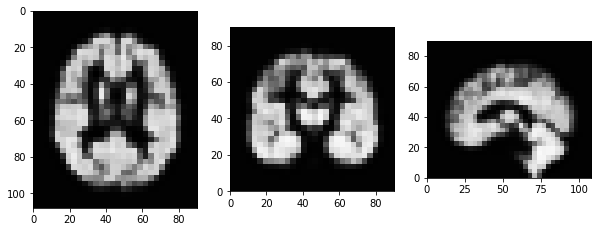

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8526850621352327 set 2 0.8478844346246309 avg 0.8502847483799318
svm set 1 0.7089237878016326 set 2 0.7218840973030956 avg 0.7154039425523641
mlp set 1 0.5689010189729382 set 2 0.5294737046775098 avg 0.549187361825224
Average set 1 0.7101699563032678 set 2 0.6997474122017454 total 0.7049586842525066
Visualisation of Preprocessing:


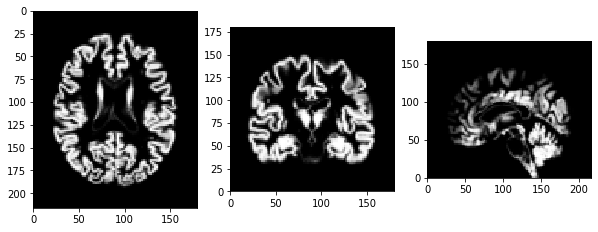

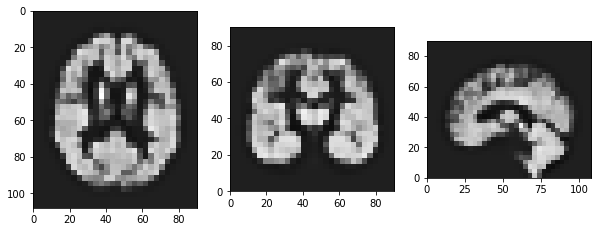

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8390112791499011 set 2 0.8572328945019271 avg 0.8481220868259141
svm set 1 0.7114100405236479 set 2 0.7095833306840682 avg 0.710496685603858
mlp set 1 0.3914076729851606 set 2 0.29388209839203505 avg 0.34264488568859786
Average set 1 0.6472763308862365 set 2 0.6202327745260101 total 0.6337545527061232
Visualisation of Preprocessing:


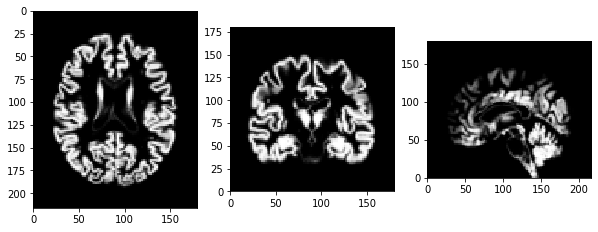

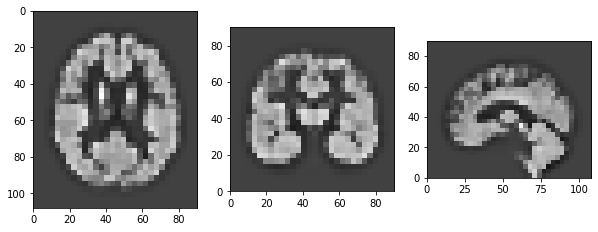

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.8625527376052573 set 2 0.8221444049774902 avg 0.8423485712913737
svm set 1 0.7127495691410543 set 2 0.7075075336587773 avg 0.7101285513999158
mlp set 1 0.6074372851562416 set 2 0.6058837027613349 avg 0.6066604939587883
Average set 1 0.7275798639675178 set 2 0.7118452137992008 total 0.7197125388833594
Visualisation of Preprocessing:


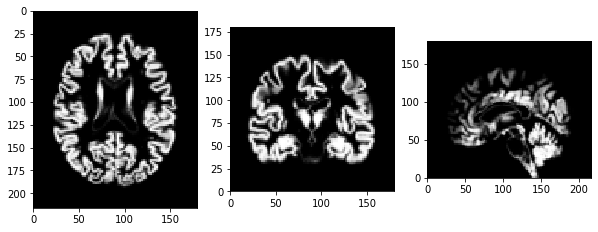

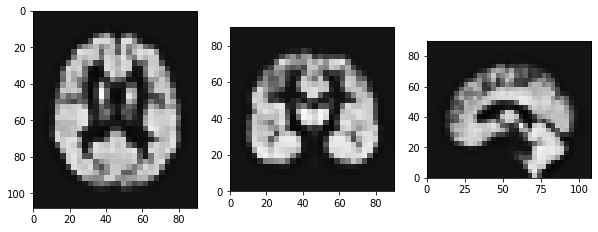

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.85997134637481 set 2 0.841593679608698 avg 0.850782512991754
svm set 1 0.7294562909143538 set 2 0.6885959067471831 avg 0.7090260988307684
mlp set 1 0.3985379092196456 set 2 0.4037693976373551 avg 0.40115365342850035
Average set 1 0.6626551821696031 set 2 0.6446529946644121 total 0.6536540884170076
Visualisation of Preprocessing:


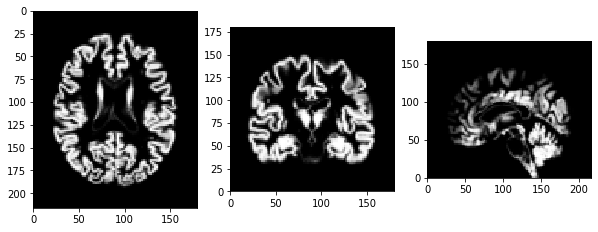

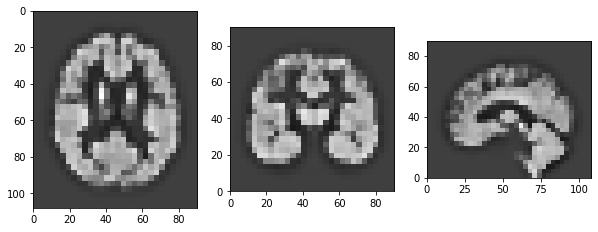

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8407242842756864 set 2 0.8580052291743385 avg 0.8493647567250124
svm set 1 0.7340723428661926 set 2 0.6939034685175047 avg 0.7139879056918487
mlp set 1 0.16400680191510775 set 2 0.29358230638484994 avg 0.22879455414997885
Average set 1 0.5796011430189956 set 2 0.6151636680255644 total 0.5973824055222801
Visualisation of Preprocessing:


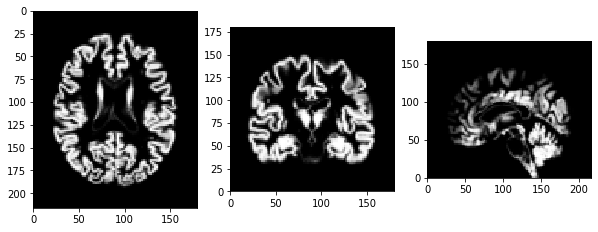

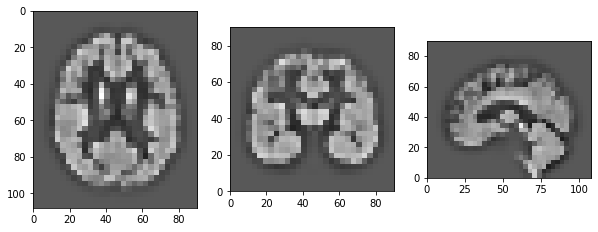

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.8628152940083316 set 2 0.844094845146873 avg 0.8534550695776023
svm set 1 0.725005981080972 set 2 0.7161079857082432 avg 0.7205569833946076
mlp set 1 0.5178801678928759 set 2 0.4986238940198258 avg 0.5082520309563509
Average set 1 0.7019004809940599 set 2 0.686275574958314 total 0.694088027976187
Visualisation of Preprocessing:


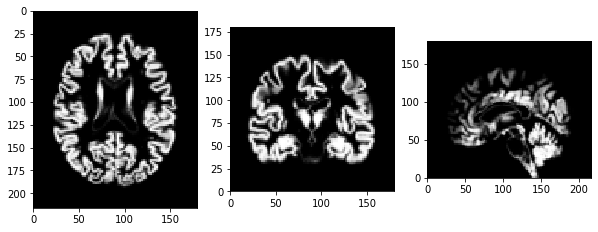

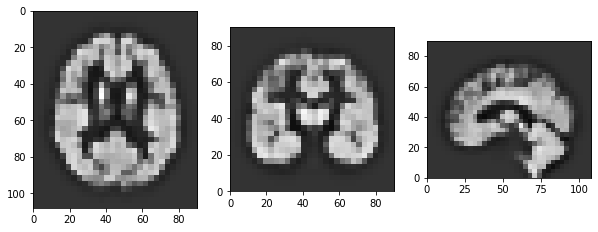

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8319684123859848 set 2 0.8820213980803279 avg 0.8569949052331564
svm set 1 0.7064228106477355 set 2 0.7129711862854989 avg 0.7096969984666173
mlp set 1 0.15643300086445755 set 2 0.345302906106283 avg 0.2508679534853703
Average set 1 0.5649414079660593 set 2 0.6467651634907033 total 0.6058532857283814
Visualisation of Preprocessing:


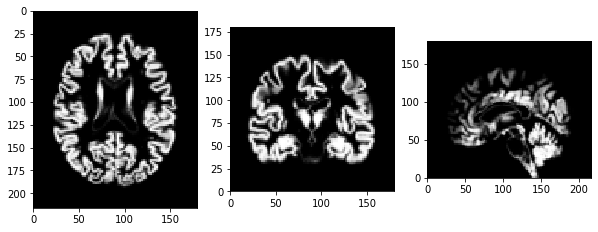

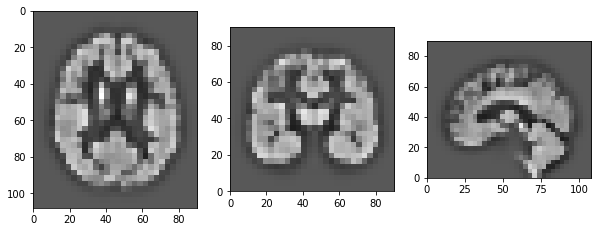

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=3) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8610247364985729 set 2 0.8471861657129343 avg 0.8541054511057535
svm set 1 0.7126790500044116 set 2 0.7061416641116707 avg 0.7094103570580411
mlp set 1 0.17579585211872473 set 2 0.016538318586247325 avg 0.09616708535248603
Average set 1 0.5831665462072365 set 2 0.5232887161369507 total 0.5532276311720936
Visualisation of Preprocessing:


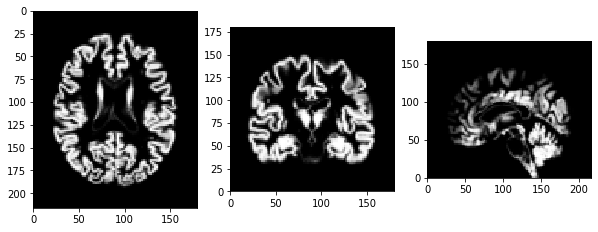

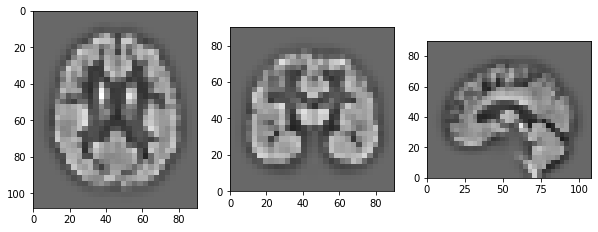

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.754348339767283 set 2 0.6930040381995788 avg 0.7236761889834309
svm set 1 0.7067655260372062 set 2 0.6642380964057554 avg 0.6855018112214808
mlp set 1 0.7569077966153641 set 2 0.6950021848280412 avg 0.7259549907217027
Average set 1 0.7393405541399511 set 2 0.6840814398111252 total 0.7117109969755382
Visualisation of Preprocessing:


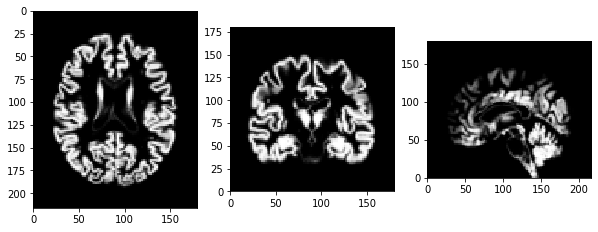

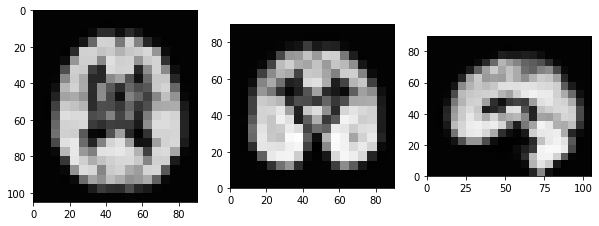

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.7402567496228649 set 2 0.7048171052200526 avg 0.7225369274214588
svm set 1 0.6691664577501191 set 2 0.6637409663692742 avg 0.6664537120596966
mlp set 1 0.7397978171160557 set 2 0.7009099522711384 avg 0.7203538846935971
Average set 1 0.7164070081630133 set 2 0.6898226746201551 total 0.7031148413915842
Visualisation of Preprocessing:


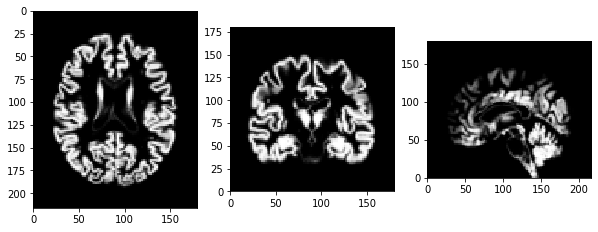

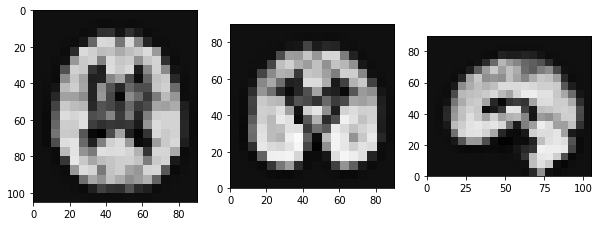

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.7184678770986481 set 2 0.7434859762468795 avg 0.7309769266727638
svm set 1 0.6764418413909058 set 2 0.6758003822444081 avg 0.6761211118176569
mlp set 1 0.7003285877093943 set 2 0.742983201389409 avg 0.7216558945494016
Average set 1 0.6984127687329827 set 2 0.7207565199602323 total 0.7095846443466075
Visualisation of Preprocessing:


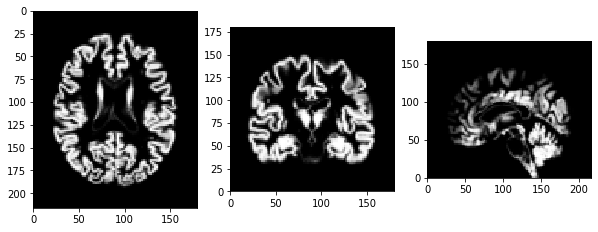

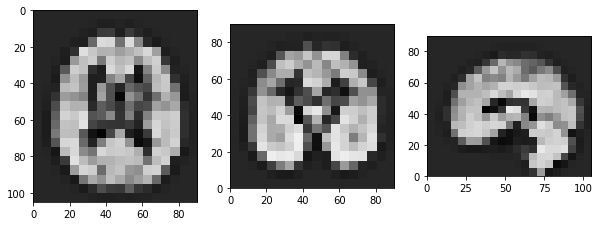

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.7170159811097604 set 2 0.7297919388708745 avg 0.7234039599903175
svm set 1 0.6760818253755434 set 2 0.6648493887230298 avg 0.6704656070492866
mlp set 1 0.7280061462063603 set 2 0.7638900489781324 avg 0.7459480975922463
Average set 1 0.7070346508972213 set 2 0.7195104588573455 total 0.7132725548772834
Visualisation of Preprocessing:


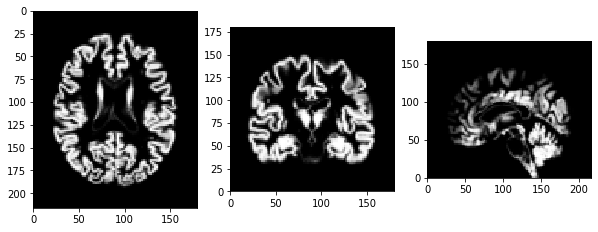

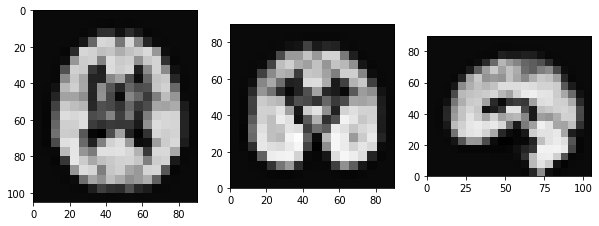

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.6826331055162904 set 2 0.7530544632143944 avg 0.7178437843653425
svm set 1 0.672939992372189 set 2 0.6834789682681248 avg 0.6782094803201569
mlp set 1 0.7225000592839537 set 2 0.7524436302286733 avg 0.7374718447563136
Average set 1 0.6926910523908111 set 2 0.7296590205703976 total 0.7111750364806043
Visualisation of Preprocessing:


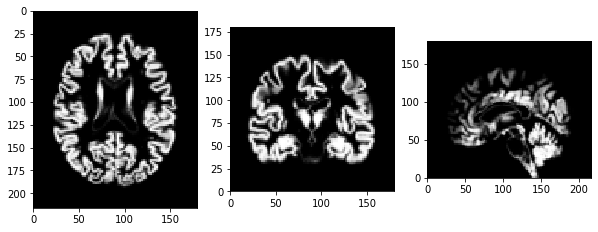

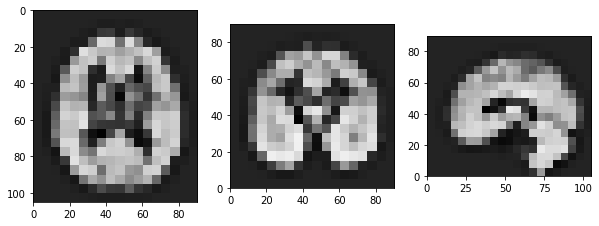

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.828863437775839 set 2 0.7857201363983933 avg 0.8072917870871161
svm set 1 0.7013539394972692 set 2 0.6842650587122662 avg 0.6928094991047677


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.7496568796437579 set 2 0.7031847196149833 avg 0.7264207996293706
Average set 1 0.7599580856389553 set 2 0.7243899715752143 total 0.7421740286070848
Visualisation of Preprocessing:


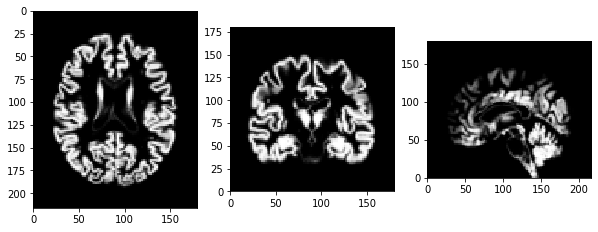

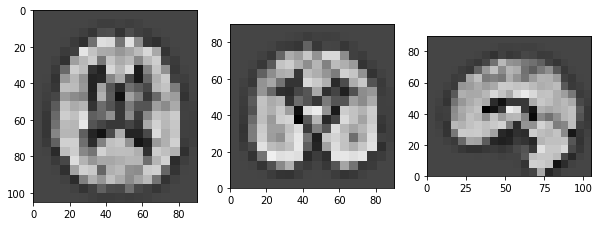

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.7268551747180365 set 2 0.7101695140454102 avg 0.7185123443817234
svm set 1 0.6835805544266036 set 2 0.6641100879779778 avg 0.6738453212022907
mlp set 1 0.7375742023768463 set 2 0.7137187429140441 avg 0.7256464726454452
Average set 1 0.7160033105071623 set 2 0.6959994483124774 total 0.7060013794098199
Visualisation of Preprocessing:


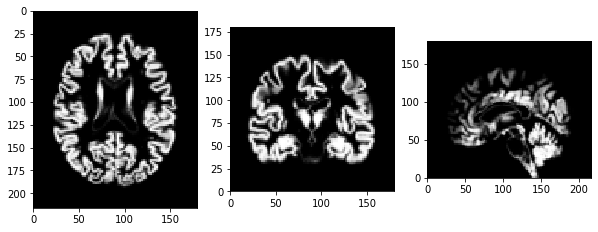

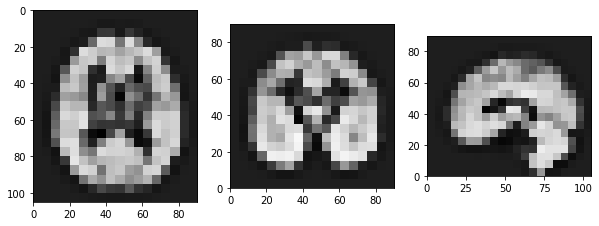

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.7965308585776246 set 2 0.8339367836647785 avg 0.8152338211212016
svm set 1 0.664050493530901 set 2 0.7282943894078444 avg 0.6961724414693726


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.7304297026730786 set 2 0.7416618132270139 avg 0.7360457579500462
Average set 1 0.7303370182605348 set 2 0.7679643287665456 total 0.7491506735135403
Visualisation of Preprocessing:


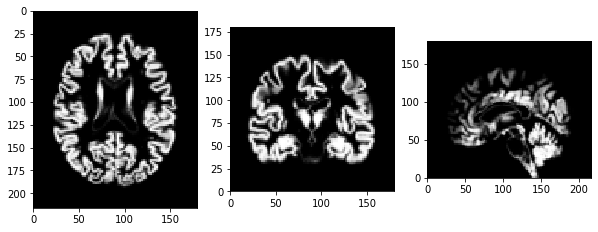

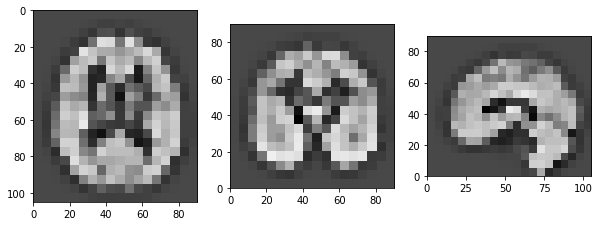

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8218181672394448 set 2 0.8162097496266987 avg 0.8190139584330718
svm set 1 0.7085297178819361 set 2 0.66801796393253 avg 0.6882738409072331
mlp set 1 0.6541158109532887 set 2 0.7195387855372853 avg 0.686827298245287
Average set 1 0.7281545653582233 set 2 0.7345888330321714 total 0.7313716991951973
Visualisation of Preprocessing:


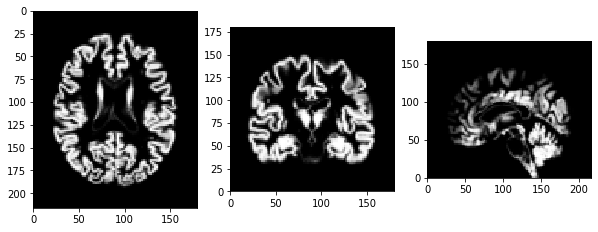

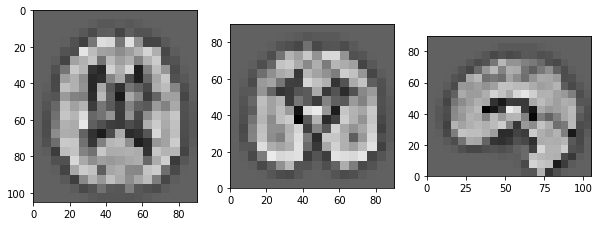

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.715179276366922 set 2 0.756014836114987 avg 0.7355970562409545
svm set 1 0.6638518799472599 set 2 0.7046162889995808 avg 0.6842340844734204
mlp set 1 0.7232670207676434 set 2 0.7295815172980638 avg 0.7264242690328535
Average set 1 0.7007660590272752 set 2 0.7300708808042105 total 0.7154184699157429
Visualisation of Preprocessing:


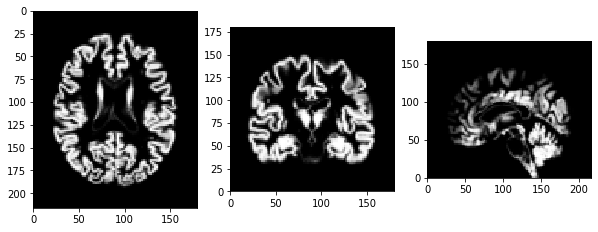

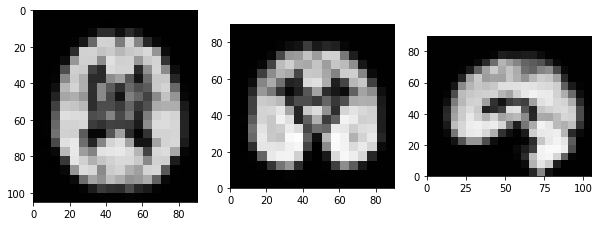

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.7399401462154294 set 2 0.7137697715125076 avg 0.7268549588639686
svm set 1 0.7215781513716801 set 2 0.6541462509624145 avg 0.6878622011670473
mlp set 1 0.7471349239826831 set 2 0.7132027794542223 avg 0.7301688517184527
Average set 1 0.7362177405232643 set 2 0.6937062673097149 total 0.7149620039164896
Visualisation of Preprocessing:


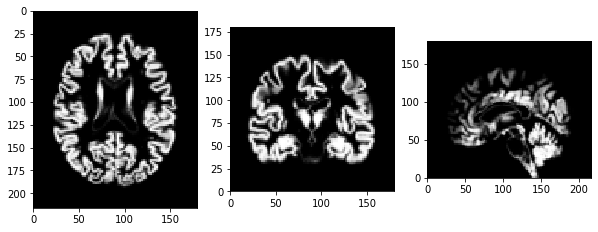

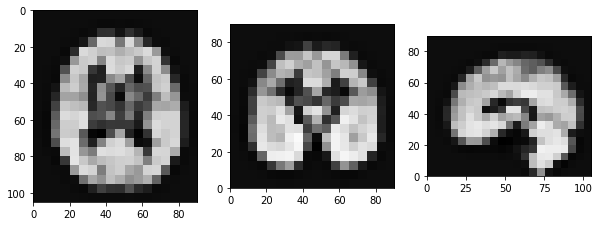

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.7289091798899283 set 2 0.7224493112219165 avg 0.7256792455559224
svm set 1 0.6585518376892245 set 2 0.714585898184412 avg 0.6865688679368183
mlp set 1 0.7416306318982415 set 2 0.6925866661185707 avg 0.7171086490084061
Average set 1 0.7096972164924648 set 2 0.7098739585082997 total 0.7097855875003822
Visualisation of Preprocessing:


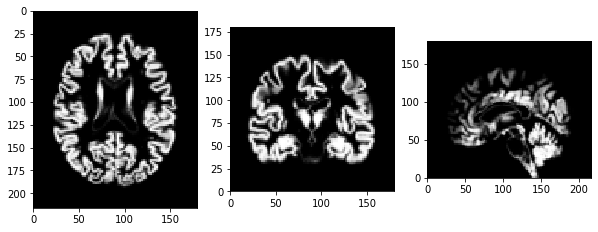

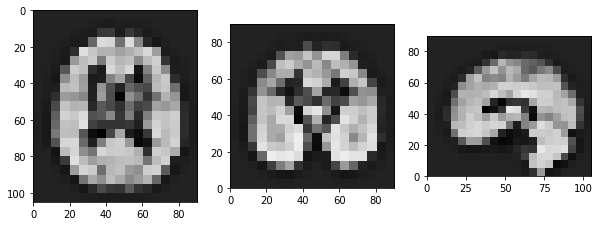

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.7512141945856211 set 2 0.708106424194084 avg 0.7296603093898526
svm set 1 0.6965533104012103 set 2 0.6508491154903375 avg 0.6737012129457739
mlp set 1 0.7364171124062677 set 2 0.7140223785695774 avg 0.7252197454879226
Average set 1 0.728061539131033 set 2 0.6909926394179996 total 0.7095270892745162
Visualisation of Preprocessing:


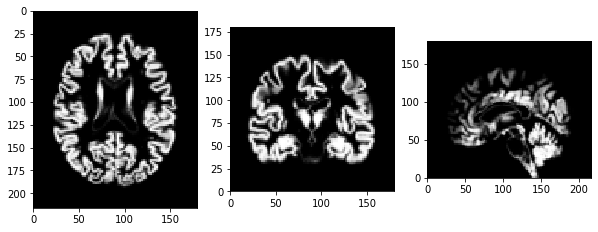

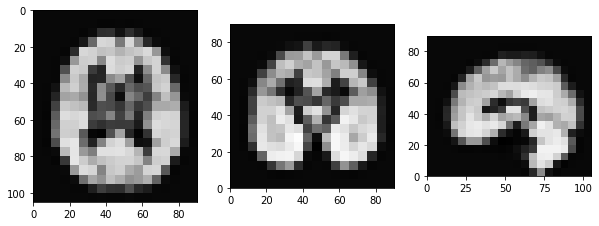

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.7387210589557798 set 2 0.7366841142392757 avg 0.7377025865975277
svm set 1 0.6804239311979431 set 2 0.70384938565429 avg 0.6921366584261166
mlp set 1 0.7134993017423381 set 2 0.7477954947556886 avg 0.7306473982490134
Average set 1 0.7108814306320204 set 2 0.7294429982164181 total 0.7201622144242192
Visualisation of Preprocessing:


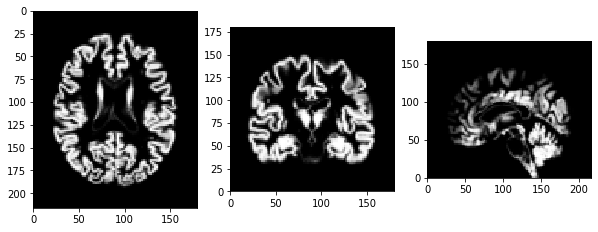

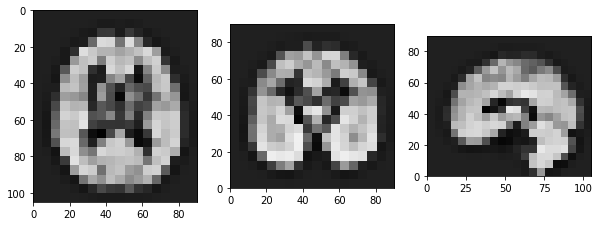

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.8326700085847686 set 2 0.7741591575268518 avg 0.8034145830558101
svm set 1 0.7148754129046665 set 2 0.6598243325395563 avg 0.6873498727221115
mlp set 1 0.7557049989766835 set 2 0.7300583482681198 avg 0.7428816736224017
Average set 1 0.7677501401553729 set 2 0.7213472794448427 total 0.7445487098001078
Visualisation of Preprocessing:


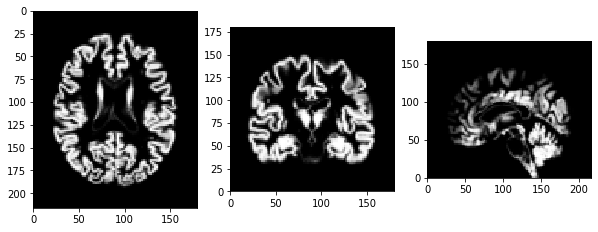

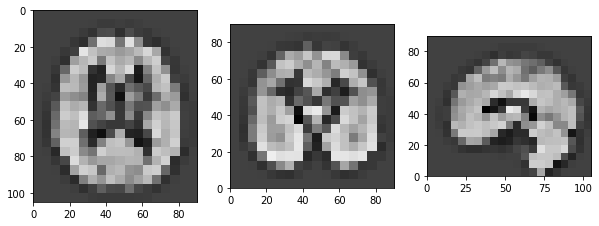

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.7007287111595408 set 2 0.757828651090047 avg 0.729278681124794
svm set 1 0.6887082311527917 set 2 0.6686241745125504 avg 0.6786662028326711
mlp set 1 0.6928077730392364 set 2 0.7228809785976567 avg 0.7078443758184465
Average set 1 0.6940815717838563 set 2 0.7164446014000848 total 0.7052630865919706
Visualisation of Preprocessing:


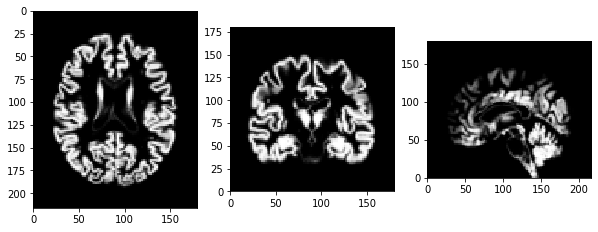

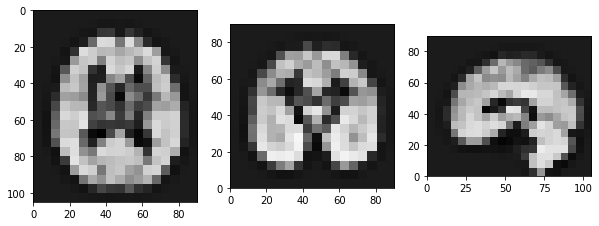

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.8075983060260324 set 2 0.7772060750047498 avg 0.7924021905153911
svm set 1 0.7146041464228152 set 2 0.6674378295424965 avg 0.6910209879826559


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.6932961832152329 set 2 0.6796641918609441 avg 0.6864801875380885
Average set 1 0.7384995452213602 set 2 0.7081026988027301 total 0.7233011220120451
Visualisation of Preprocessing:


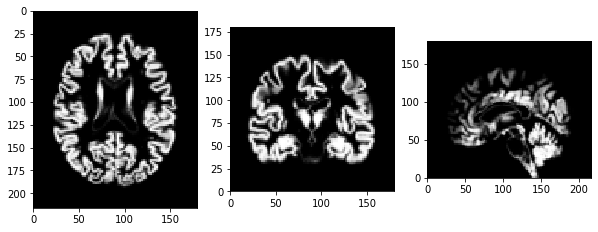

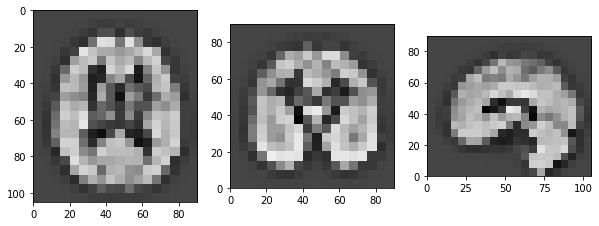

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8123170438976728 set 2 0.8518529387681423 avg 0.8320849913329076
svm set 1 0.6898293989153101 set 2 0.7057275544370301 avg 0.6977784766761701
mlp set 1 0.6540821458580679 set 2 0.7825689670758671 avg 0.7183255564669675
Average set 1 0.7187428628903504 set 2 0.7800498200936797 total 0.7493963414920151
Visualisation of Preprocessing:


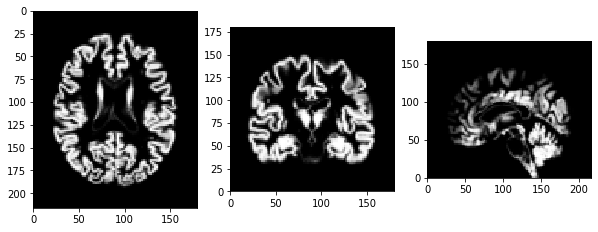

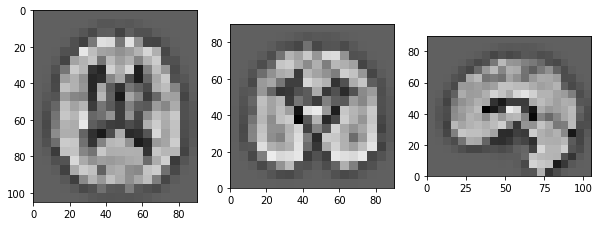

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.7744365338462109 set 2 0.7315025757099236 avg 0.7529695547780673
svm set 1 0.7199295992249871 set 2 0.6727020767761044 avg 0.6963158380005458
mlp set 1 0.7453253304126706 set 2 0.7053171092779527 avg 0.7253212198453116
Average set 1 0.7465638211612896 set 2 0.7031739205879936 total 0.7248688708746416
Visualisation of Preprocessing:


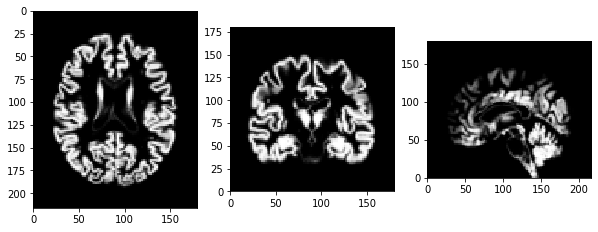

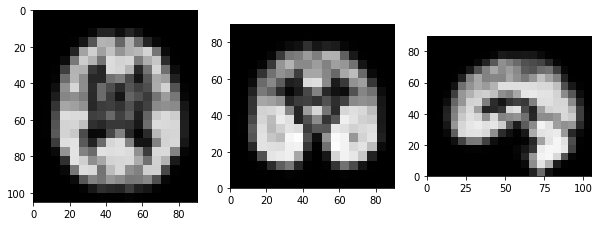

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.753005032511581 set 2 0.7537378034387604 avg 0.7533714179751707
svm set 1 0.71262624909157 set 2 0.6876357603314789 avg 0.7001310047115245
mlp set 1 0.7237098704132641 set 2 0.6973926183734984 avg 0.7105512443933812
Average set 1 0.7297803840054717 set 2 0.7129220607145793 total 0.7213512223600256
Visualisation of Preprocessing:


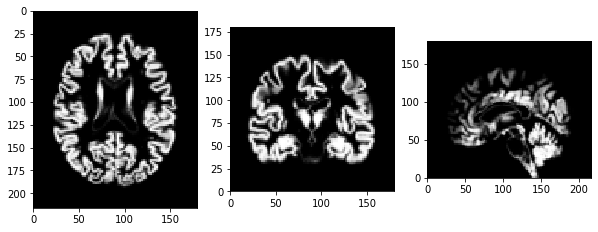

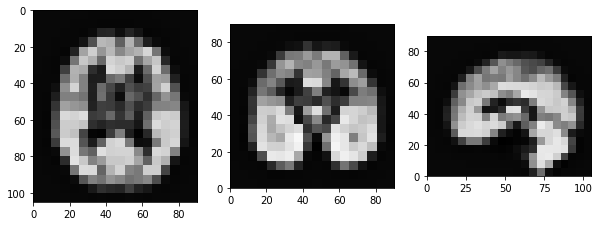

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.7174159151861093 set 2 0.7549799074936515 avg 0.7361979113398804
svm set 1 0.6845965425358727 set 2 0.6810760515023035 avg 0.6828362970190881
mlp set 1 0.7054873664819432 set 2 0.7662685968696141 avg 0.7358779816757787
Average set 1 0.7024999414013084 set 2 0.7341081852885232 total 0.7183040633449158
Visualisation of Preprocessing:


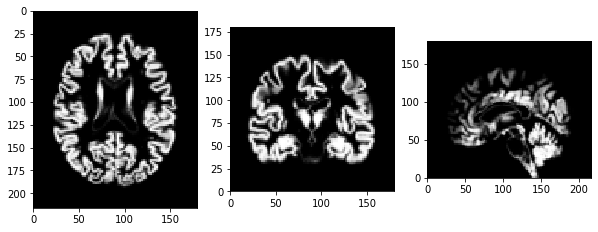

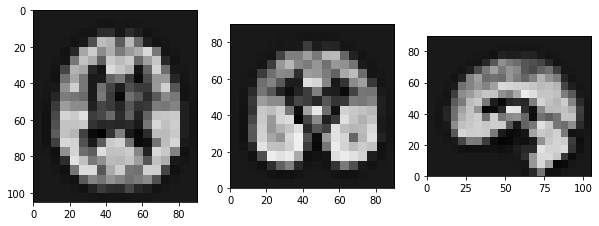

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.
reg set 1 0.72779815639724 set 2 0.7812832078665775 avg 0.7545406821319087
svm set 1 0.6878432060446558 set 2 0.7017573164018185 avg 0.6948002612232371
mlp set 1 0.7057393705360568 set 2 0.7614514394741841 avg 0.7335954050051205
Average set 1 0.7071269109926508 set 2 0.7481639879141934 total 0.7276454494534221
Visualisation of Preprocessing:


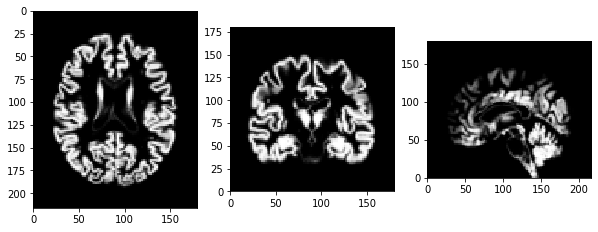

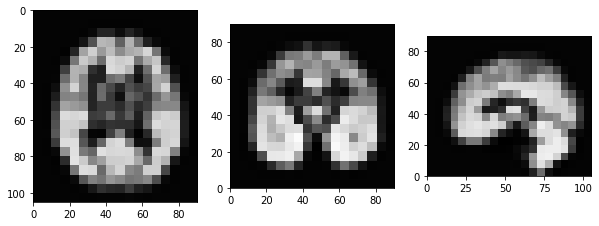

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=5) enabled=True.
reg set 1 0.774805980015706 set 2 0.7232928519832595 avg 0.7490494159994827
svm set 1 0.7079594566960036 set 2 0.679093220480772 avg 0.6935263385883879
mlp set 1 0.7563365816855522 set 2 0.6606162670274005 avg 0.7084764243564763
Average set 1 0.746367339465754 set 2 0.6876674464971441 total 0.717017392981449
Visualisation of Preprocessing:


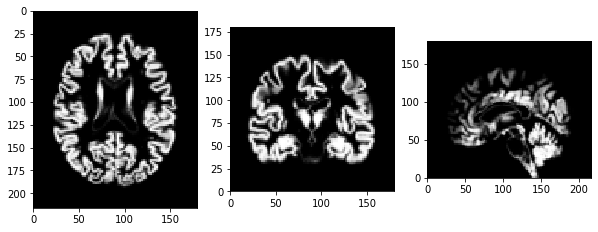

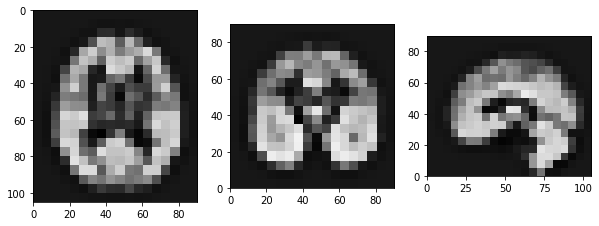

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=10) enabled=True.
reg set 1 0.7729431219867262 set 2 0.7586647026337159 avg 0.765803912310221
svm set 1 0.681174590850031 set 2 0.7189163043853974 avg 0.7000454476177143


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.70160056349561 set 2 0.7314834358474867 avg 0.7165419996715483
Average set 1 0.7185727587774556 set 2 0.7363548142888666 total 0.7274637865331611
Visualisation of Preprocessing:


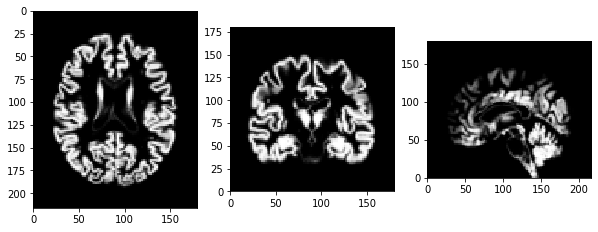

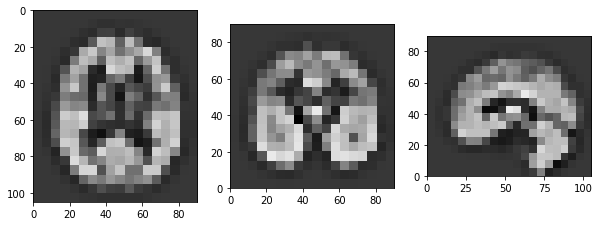

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=2) enabled=True.
reg set 1 0.7372363271325431 set 2 0.7704074495136167 avg 0.7538218883230798
svm set 1 0.6777312295521003 set 2 0.7095506086371213 avg 0.6936409190946108
mlp set 1 0.7006172270942135 set 2 0.7694600512425369 avg 0.7350386391683752
Average set 1 0.7051949279262857 set 2 0.7498060364644249 total 0.7275004821953552
Visualisation of Preprocessing:


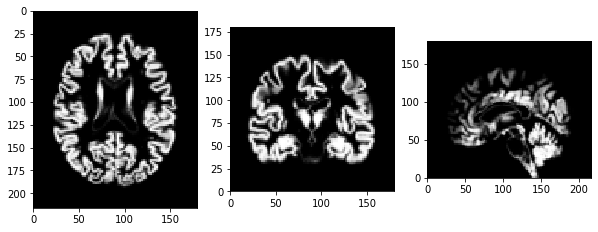

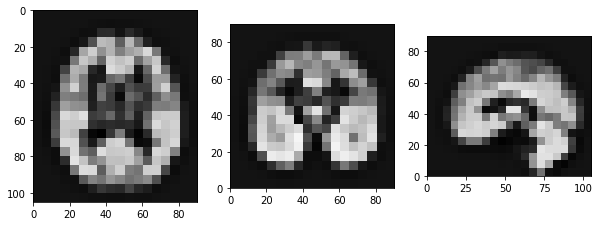

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=5) enabled=True.
reg set 1 0.701558274437824 set 2 0.8097944464486392 avg 0.7556763604432316
svm set 1 0.6980482766509539 set 2 0.6912710764843087 avg 0.6946596765676314
mlp set 1 0.6881953684372931 set 2 0.682600635210366 avg 0.6853980018238295
Average set 1 0.695933973175357 set 2 0.7278887193811047 total 0.7119113462782308
Visualisation of Preprocessing:


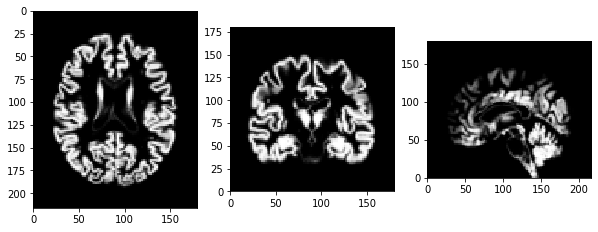

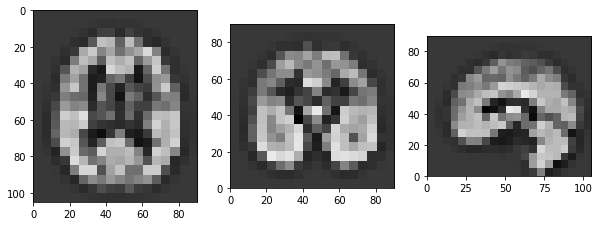

(operation 1) Gamma Corretion (gamma=3 c=5) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=5) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=5 strength=10) enabled=True.
reg set 1 0.8393916610353148 set 2 0.8246222494188317 avg 0.8320069552270732
svm set 1 0.7042211093681097 set 2 0.6988560152578693 avg 0.7015385623129895


/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/home/james/anaconda3/lib/python3.7/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


mlp set 1 0.7160382548423965 set 2 0.729776123482975 avg 0.7229071891626857
Average set 1 0.7532170084152737 set 2 0.7510847960532253 total 0.7521509022342495
Visualisation of Preprocessing:


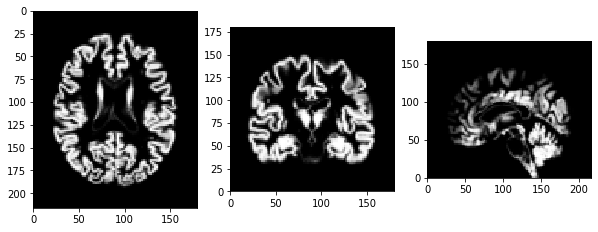

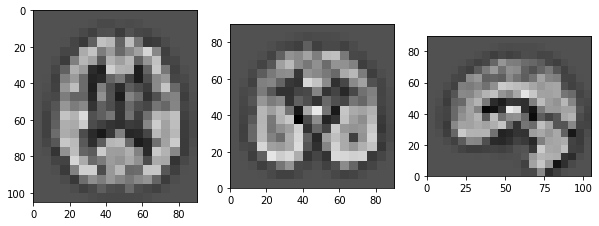

(operation 1) Gamma Corretion (gamma=3 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=2) enabled=True.
reg set 1 0.8492392028729987 set 2 0.8346948118106832 avg 0.8419670073418409
svm set 1 0.6576483627942252 set 2 0.6370751129077438 avg 0.6473617378509845
mlp set 1 -1.0326391948848137 set 2 -0.9781167402140611 avg -1.0053779675494374
Average set 1 0.15808279026080344 set 2 0.16455106150145524 total 0.16131692588112934
Visualisation of Preprocessing:


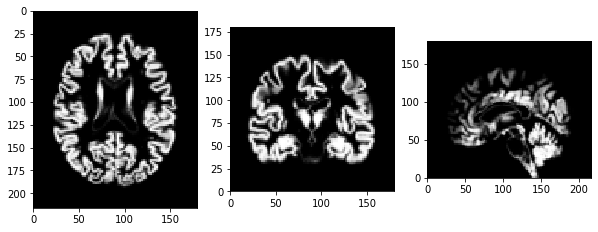

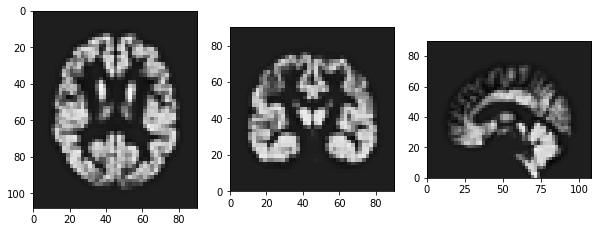

(operation 1) Gamma Corretion (gamma=3 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=5) enabled=True.
reg set 1 0.8414660540004625 set 2 0.8435173280996999 avg 0.8424916910500813
svm set 1 0.4820817714264284 set 2 0.5996157159438693 avg 0.5408487436851488
mlp set 1 -1.3098012918964406 set 2 -1.489243677052984 avg -1.3995224844747123
Average set 1 0.004582177843483433 set 2 -0.015370211003138253 total -0.00539401657982741
Visualisation of Preprocessing:


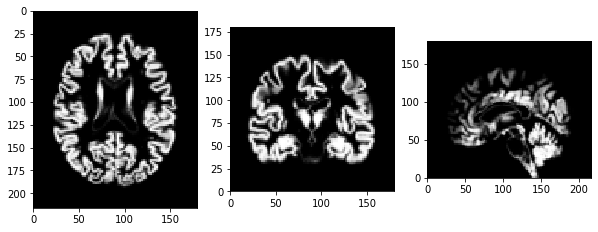

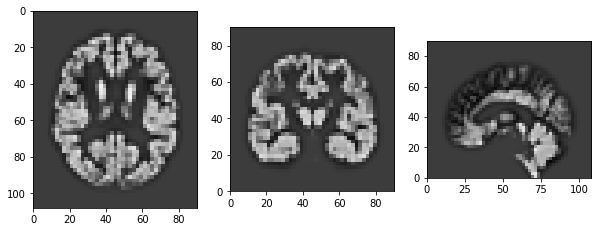

(operation 1) Gamma Corretion (gamma=3 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=1 strength=10) enabled=True.
reg set 1 0.8160848236539779 set 2 0.8291872228869354 avg 0.8226360232704566
svm set 1 0.35336272829265736 set 2 0.510450968157464 avg 0.4319068482250607
mlp set 1 -1.438192368866663 set 2 -2.0400916966428846 avg -1.7391420327547737
Average set 1 -0.08958160564000917 set 2 -0.23348450186616176 total -0.16153305375308546
Visualisation of Preprocessing:


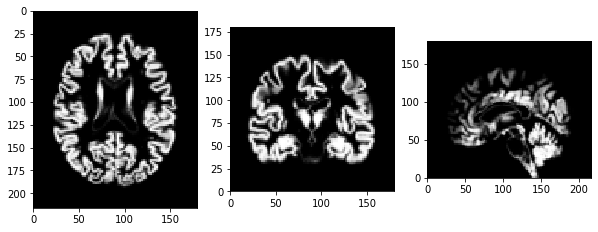

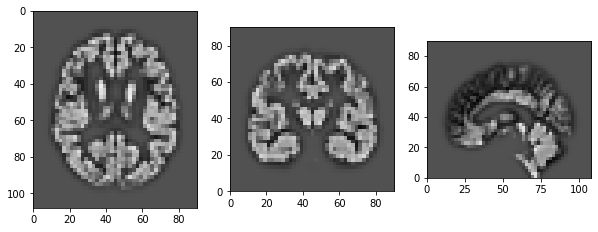

(operation 1) Gamma Corretion (gamma=3 c=10) enabled=True. (operation 2) zero_mean_unit_var enabled=False. (operation 3) downsampling (factor=2) enabled=True. (operation 4) GradientAnisotropicDiffusion enabled=False.(operation 5) Discrete Gaussian Filter enabled=True. (operation 6) Histogram Equalisation enabled=True. (operation 7) Soebl Edge Detection Filters enabled=False. (operation 8) Image Sharpening (scale=2 strength=2) enabled=True.


In [ ]:
import sklearn
from sklearn import linear_model
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR

train_ids = list(meta_data_reg_train['subject_id'])
unprocessed_images = [sitk.ReadImage(data_dir + 'greymatter/wc1sub-' + f + '_T1w.nii.gz') for f in train_ids]
boolarr = [True, False]
max_details_model = (0, '')
max_processed = (0, '')
count = 1
skip = True
# avgs = {'reg': [], 'svm': [], 'mlp': [], 'all': []}
# enabled_processing = {'gamma': [], 'downsample': [], 'GAD': [], 'gaussian': [], 'hist': [], 'sobel': [], 'sharpen': []}#, 'zeromean': []}
# parameters = {'gamma': [], 'c': [], 'factor': [], 'variance': [], 'scale': [], 'strength': []}
for gamma in boolarr:
  for zeromean in boolarr:
    for downsamplev in [True]:
      for GAD in boolarr:
        if (skip):
          skip = False
          continue
        for gaussian in boolarr:
          for hist in boolarr:
            for sobel in [False]:
                if (not (GAD or downsamplev or gamma or gaussian or hist or sobel or sharpenb)):# or zeromean)):
                  print('skipped', GAD, downsamplev, gamma, gaussian, hist, sobel, sharpenb)#, zeromean)
                  continue
                print('------ Processing #{} ------'.format(count))
                count += 1
                enabled = {'gamma': gamma, 'downsample': downsamplev, 'GAD': GAD, 'gaussian': gaussian, 'hist': hist, 'sobel': sobel, 'sharpen': sharpenb}#, 'zeromean': zeromean}
                gammarr = [1, 3, 5] if enabled['gamma'] else ['N/A']
                carr = [5, 10, 15] if enabled['gamma'] else ['N/A']
                factorarr = [2, 3, 5] if enabled['downsample'] else ['N/A']
                vararr = [0.5, 1, 2] if enabled['gaussian'] else ['N/A']
                for gammav in gammarr:
                  for cv in carr:
                    for factorv in factorarr:
                      for variance in vararr:
                        for scale in scalearr:
                          for strength in strengtharr:
                            options = {'c': cv, 'gamma': gammav, 'factor': factorv, 'variance': variance, 'scale': scale, 'strength': strength}
                            details = '(operation 1) Gamma Corretion (gamma={} c={}) enabled={}. (operation 2) zero_mean_unit_var enabled={}. (operation 3) downsampling (factor={}) enabled={}. (operation 4) GradientAnisotropicDiffusion enabled={}.'.format(options['gamma'], options['c'], enabled['gamma'], False, options['factor'], enabled['downsample'], enabled['GAD'])
                            details += '(operation 5) Discrete Gaussian Filter enabled={}. (operation 6) Histogram Equalisation enabled={}. (operation 7) Soebl Edge Detection Filters enabled={}. (operation 8) Image Sharpening (scale={} strength={}) enabled={}.'.format(enabled['gaussian'], enabled['hist'], enabled['sobel'], options['scale'], options['strength'], enabled['sharpen'])

                            print(details)
                            processed_images = process_images(train_ids, enabled, options, False, False)
                            img_data = convert_img_arr_to_numpy(processed_images)
                            X = img_data
                            y = meta_data_reg_train['age'].values.reshape(-1)
                            X_s, y_s = sklearn.utils.shuffle(X, y)
                            split = len(X_s)//2

                            X_sets = [X_s[0:split], X_s[split:len(X_s)]]
                            y_sets = [y_s[0:split], y_s[split:len(y_s)]]
                            train1, test1, pca = apply_PCA(X_sets[0], X_sets[1])
                            train2, test2, pca2 = apply_PCA(X_sets[1], X_sets[0])

                            models = [('reg', linear_model.LinearRegression), ('svm', SVR), ('mlp', lambda: MLPRegressor((100, 100, 50, 20), max_iter=600))]
                            av_set1 = 0
                            av_set2 = 0
                            for model in models:
                              m = model[1]()
                              m.fit(train1, y_sets[0])
                              ms = m.score(test1, y_sets[1])
                              m.fit(train2, y_sets[1])
                              ms2 = m.score(test2, y_sets[0])
                              av = (ms + ms2)/2
                              scores_output = model[0] + ' set 1 {} set 2 {} avg {}'.format(ms, ms2, av)
                              print(scores_output)
                              if av > max_details_model[0]:
                                max_details_model = (av, details + ' | ' + scores_output)
                              av_set1 += ms
                              av_set2 += ms2
                              avgs[model[0]].append(av)
                            set1 = av_set1/3
                            set2 = av_set2/3
                            av_set = (set1 + set2)/2
                            av_scores = 'Average set 1 {} set 2 {} total {}'.format(set1, set2, av_set)
                            print(av_scores)
                            print('Visualisation of Preprocessing:')
                            if av_set > max_processed[0]:
                              max_processed = (av_set, details + ' | ' + av_scores)
                            display_image(unprocessed_images[0])
                            display_image(processed_images[0])
                            avgs['all'].append(av_set)
                            for item in ['gamma', 'downsample', 'GAD', 'gaussian', 'hist', 'sobel', 'sharpen']:#, 'zeromean']:
                              enabled_processing[item].append(enabled[item])
                            for item in ['c', 'gamma', 'factor', 'variance', 'scale', 'strength']:
                              parameters[item].append(options[item])

print('--------------- DONE ----------------')
# print('Best Model:')
# print(max_details_model[1])
# print('Best Average Processing:')
# print(max_processed[1])
# dictionary = {}
# for key, value in avgs.items():
#   new_key = 'Average Value - ' + key
#   dictionary[new_key] = value
# for key, value in enabled_processing.items():
#   new_key = 'Enabled Preprocessing Methods - ' + key
#   dictionary[new_key] = value
# for key, value in parameters.items():
#   new_key = 'Preprocessing Parameters - ' + key
#   dictionary[new_key] = value

# df = pd.DataFrame(dictionary)
# df.to_csv('preprocessing.csv')
# df.head()
# Load data 

# Display images
# img_data = convert_img_arr_to_numpy(processed_images)
# gm = unprocessed_images[0]
# gmp = processed_images[0]
# display_image(gm)
# display_image(gmp)

# # TODO: use real folds
# X_s, y_s = sklearn.utils.shuffle(X, y)
# split = len(X_s)//2

# X_sets = [X_s[0:split], X_s[split:len(X_s)]]
# y_sets = [y_s[0:split], y_s[split:len(y_s)]]

# train, test, pca = apply_PCA(X_sets[0], X_sets[1])

# # Quick check of R^2 score to try optimise different preprocessing methods
# reg = linear_model.LinearRegression()
# reg.fit(train, y_sets[0])
# print(reg.score(test, y_sets[1]))

In [1]:
print('--------------- DONE ----------------')
print('Best Model:')
print(max_details_model[1])
print('Best Average Processing:')
print(max_processed[1])
dictionary = {}
for key, value in avgs.items():
  new_key = 'Average Value - ' + key
  dictionary[new_key] = value
for key, value in enabled_processing.items():
  new_key = 'Enabled Preprocessing Methods - ' + key
  dictionary[new_key] = value
for key, value in parameters.items():
  new_key = 'Preprocessing Parameters - ' + key
  dictionary[new_key] = value

df = pd.DataFrame(dictionary)
df.to_csv('preprocessing.csv')
df.head()


--------------- DONE ----------------
Best Model:


NameError: name 'max_details_model' is not defined

Error calculation and plotting

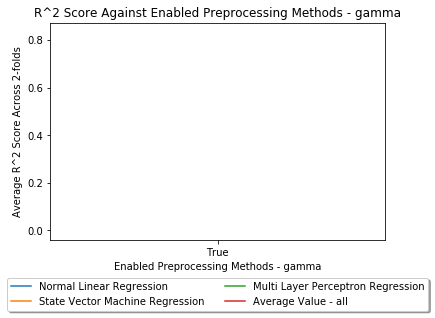

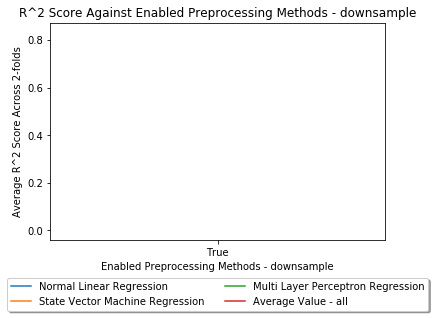

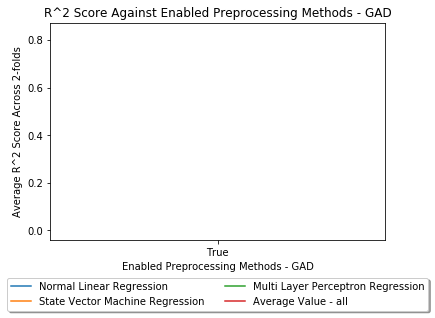

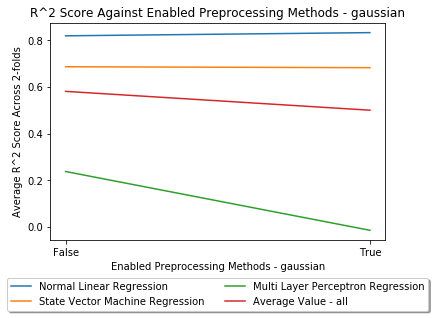

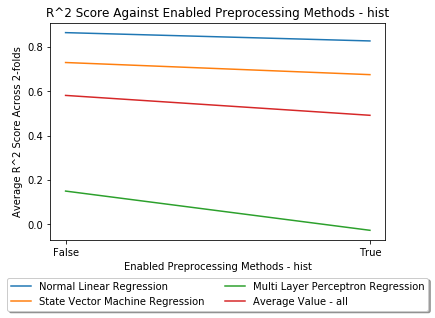

...

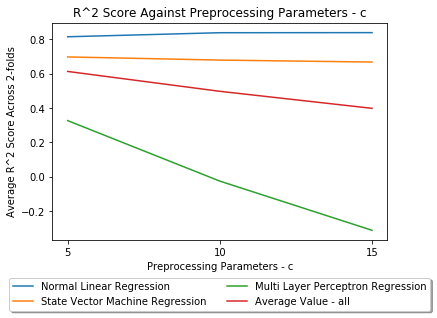

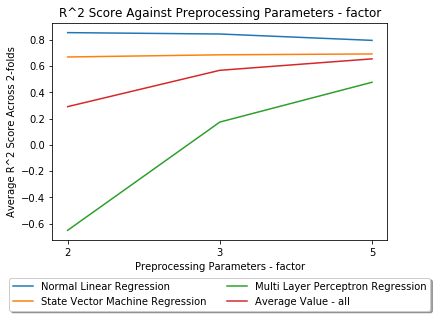

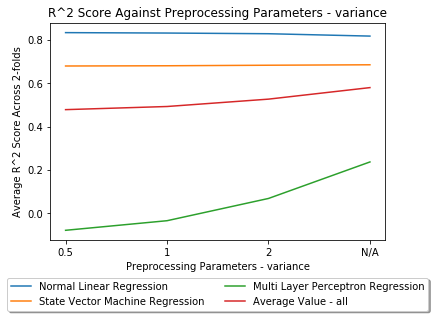

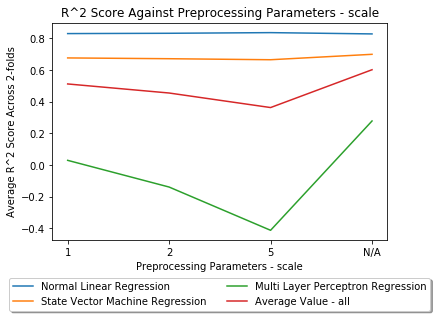

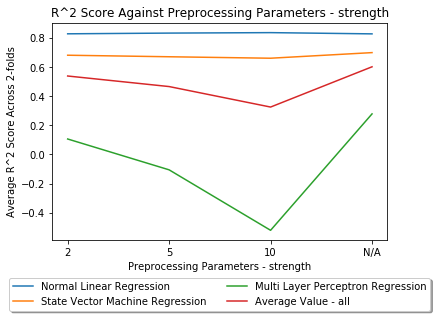

In [86]:
def graph_param(df, param_name):
  columns = ['Average Value - reg','Average Value - svm','Average Value - mlp','Average Value - all',param_name]
  aggregated = df[columns].groupby([param_name]).aggregate('mean')
  aggregated.index = aggregated.index.map(str)
  fig = plt.figure()
  ax = plt.subplot(111)
  for acc in ['Average Value - reg','Average Value - svm','Average Value - mlp','Average Value - all']:
    label = acc
    if 'reg' in acc:
      label = 'Normal Linear Regression'
    if 'svm' in acc:
      label = 'State Vector Machine Regression'
    if 'mlp' in acc:
      label = 'Multi Layer Perceptron Regression'
    ax.plot(aggregated.index.values, aggregated[acc], label=label)
  plt.title('R^2 Score Against ' + param_name)
  plt.xlabel(param_name)
  plt.ylabel('Average R^2 Score Across 2-folds')
  ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), shadow=True, ncol=2)
  plt.show()
  
for param in ['Enabled Preprocessing Methods - gamma','Enabled Preprocessing Methods - downsample','Enabled Preprocessing Methods - GAD','Enabled Preprocessing Methods - gaussian','Enabled Preprocessing Methods - hist','Enabled Preprocessing Methods - sobel','Enabled Preprocessing Methods - sharpen','Preprocessing Parameters - gamma','Preprocessing Parameters - c','Preprocessing Parameters - factor','Preprocessing Parameters - variance','Preprocessing Parameters - scale','Preprocessing Parameters - strength']:
  graph_param(df, param)
# a = df[['Average Value - reg','Average Value - svm','Average Value - mlp','Average Value - all','Enabled Preprocessing Methods - sharpen']].groupby(['Enabled Preprocessing Methods - sharpen']).aggregate('mean')
# a

In [0]:
print('mean absolute error: {0}'.format(mean_absolute_error(y,predicted)))
print('r2 score: {0}'.format(r2_score(y,predicted)))

fig, ax = plt.subplots()
ax.scatter(y, predicted, marker='.')
ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)
ax.set_xlabel('Real Age')
ax.set_ylabel('Predicted Age')
plt.show()

## Part C: CNN-based regression using grey matter maps

The third approach is similar in nature to the second approach in task B, but instead of using PCA for dimensionality reduction in order to use a more classical regression model, now we will use convolutional neural networks (CNNs) on the grey matter maps for predicting the subject's age directly.

You will need to implement a CNN model that takes a grey matter map as an input and maps it to a one-dimensional, real-valued output. A good starting point may be a LeNet-type architecture and adapt the last layers to convert the classification into a regression network. You should have all the necessary ingredients now from above tasks and the notebooks from the lab tutorials for how to set up a CNN model in PyTorch, how to implement a suitable training and testing routine, and how to run a two-fold cross-validation on the 500 subjects similar to tasks A and B.

*Note:* For part C, only the spatially normalised grey matter maps should be used. Similar to task A, you may want to set up a configuration for the CNN training that may also involve some resampling of the input data.

In [0]:
########################################
# ADD YOUR CODE HERE
########################################

Error calculation and plotting

In [0]:
print('mean absolute error: {0}'.format(mean_absolute_error(y,predicted)))
print('r2 score: {0}'.format(r2_score(y,predicted)))

fig, ax = plt.subplots()
ax.scatter(y, predicted, marker='.')
ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)
ax.set_xlabel('Real Age')
ax.set_ylabel('Predicted Age')
plt.show()